In [1]:
import pandas as pd
import math

# Load the data
file_path = 'WHO-COVID-19-global-data.csv'
covid_data = pd.read_csv(file_path)
covid_data

,Date_reported,Country_code,Country,WHO_region,New_cases,Cumulative_cases,New_deaths,Cumulative_deaths
0,03-01-2020,AF,Afghanistan,EMRO,0,0,0,0
1,04-01-2020,AF,Afghanistan,EMRO,0,0,0,0
2,05-01-2020,AF,Afghanistan,EMRO,0,0,0,0
3,06-01-2020,AF,Afghanistan,EMRO,0,0,0,0
4,07-01-2020,AF,Afghanistan,EMRO,0,0,0,0
...,...,...,...,...,...,...,...,...
308332,22-07-2023,ZW,Zimbabwe,AFRO,0,265666,0,5711
308333,23-07-2023,ZW,Zimbabwe,AFRO,0,265666,0,5711
308334,24-07-2023,ZW,Zimbabwe,AFRO,0,265666,0,5711
308335,25-07-2023,ZW,Zimbabwe,AFRO,0,265666,0,5711


# for gpt to give code and create ppt for major project

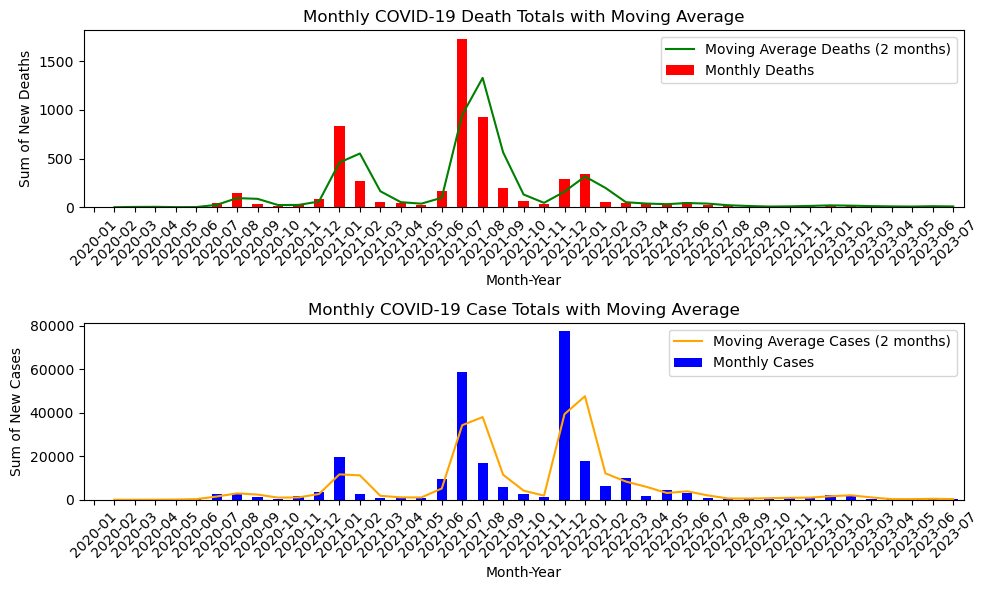

/var/folders/yq/fcrs98296732c0y0w4vz44q00000gn/T/ipykernel_1245/3748574730.py:69: RuntimeWarning: divide by zero encountered in scalar divide
  ratio_deaths = (abs(initial_deaths - current_deaths)/initial_deaths) * (abs(future_deaths - current_deaths)/current_deaths)
/var/folders/yq/fcrs98296732c0y0w4vz44q00000gn/T/ipykernel_1245/3748574730.py:90: RuntimeWarning: divide by zero encountered in scalar divide
  ratio_cases = (abs(initial_cases - current_cases)/initial_cases) * (abs(future_cases - current_cases)/current_cases)


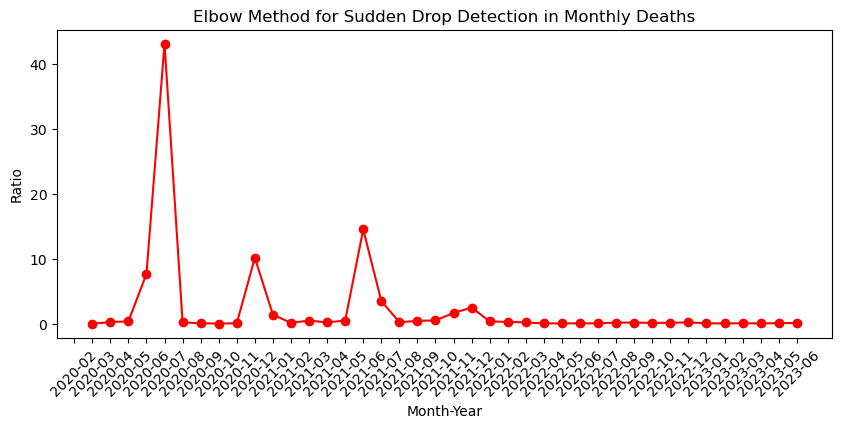

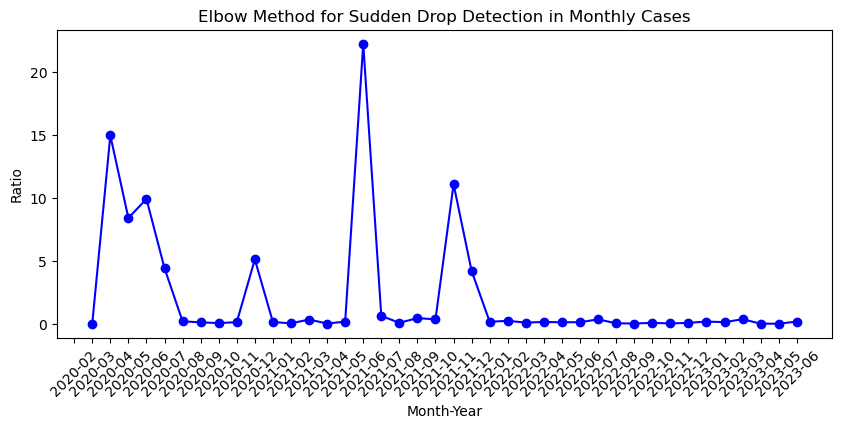

/var/folders/yq/fcrs98296732c0y0w4vz44q00000gn/T/ipykernel_1245/3748574730.py:128: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


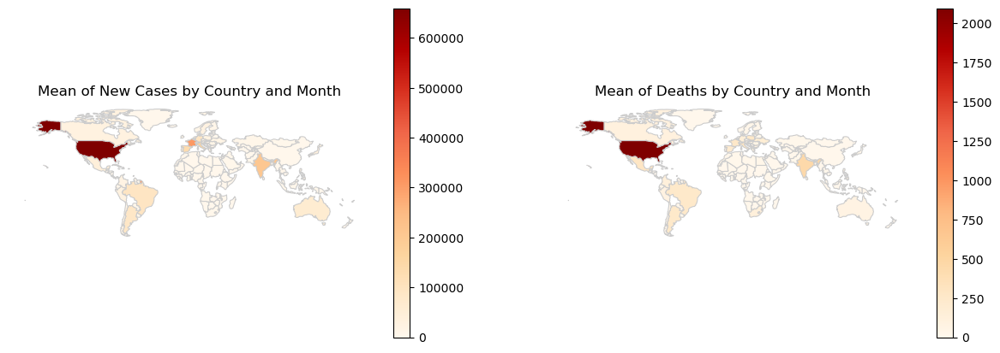

Epoch 1/50
22/22 - 1s - loss: 0.0305 - val_loss: 0.0243 - 504ms/epoch - 23ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0077 - val_loss: 0.0063 - 41ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0061 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0055 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0013 - val_loss: 0.0053 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0012 - val_loss: 0.0050 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0011 - val_loss: 0.0046 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 9.8341e-04 - val_loss: 0.0042 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 9.5059e-04 - val_loss: 0.0041 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 8.0005e-04 - val_loss: 0.0037 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 6.6560e-04 - val_loss: 0.0031 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 7.0823e-04 - val_loss: 0.0028 - 38ms/epoch - 2ms/step
Epoch 13/50
22/

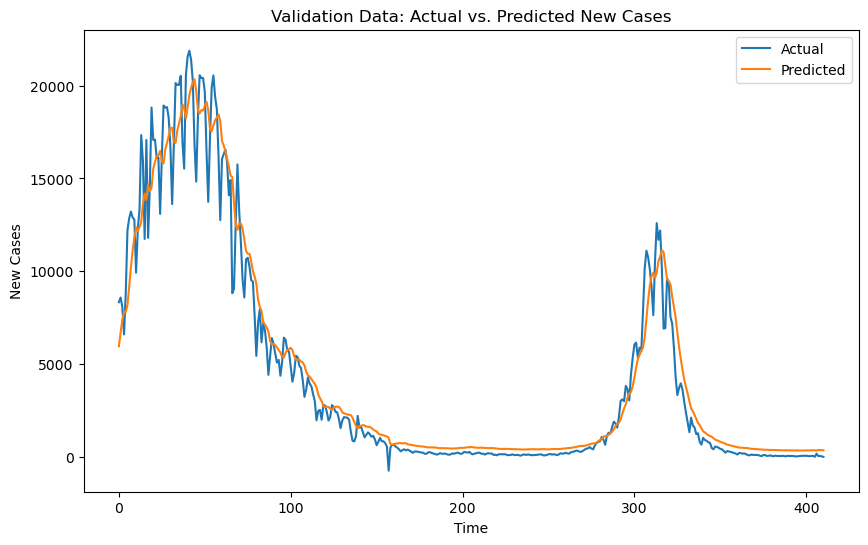

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from sklearn.metrics import mean_squared_error, mean_absolute_error
import geopandas as gpd
# from mpl_toolkits.axes_grid1 import make_axes_locatable

covid_data = pd.read_csv('WHO-COVID-19-global-data.csv')

covid_data = covid_data[['Country','Date_reported','New_cases','New_deaths']]
covid_data['Date_reported'] = pd.to_datetime(covid_data['Date_reported'], format='%d-%m-%Y')
covid_data['Month_Year'] = covid_data['Date_reported'].dt.strftime('%Y-%m')
covid_data = covid_data.drop('Date_reported', axis=1)
Select_country = "Zimbabwe"
monthly_deaths = covid_data[covid_data['Country'] == Select_country].groupby(['Month_Year'])['New_deaths'].sum()
monthly_new_cases = covid_data[covid_data['Country'] == Select_country].groupby(['Month_Year'])['New_cases'].sum()

# Define the window size for the moving average
window_size = 2  # Adjust this based on your preference

# Calculate the moving average for monthly deaths
moving_average_deaths = monthly_deaths.rolling(window=window_size).mean()

# Calculate the moving average for monthly new cases
moving_average_cases = monthly_new_cases.rolling(window=window_size).mean()

# Plotting both monthly deaths and new cases
plt.figure(figsize=(10, 6))

# Plotting monthly deaths
plt.subplot(2, 1, 1)
monthly_deaths.plot(kind='bar', color='red', label='Monthly Deaths')
moving_average_deaths.plot(kind='line', color='green', label=f'Moving Average Deaths ({window_size} months)')
plt.title('Monthly COVID-19 Death Totals with Moving Average')
plt.xlabel('Month-Year')
plt.ylabel('Sum of New Deaths')
plt.legend()
plt.xticks(rotation=45)

# Plotting monthly new cases
plt.subplot(2, 1, 2)
monthly_new_cases.plot(kind='bar', color='blue', label='Monthly Cases')
moving_average_cases.plot(kind='line', color='orange', label=f'Moving Average Cases ({window_size} months)')
plt.title('Monthly COVID-19 Case Totals with Moving Average')
plt.xlabel('Month-Year')
plt.ylabel('Sum of New Cases')
plt.legend()
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

# Find the point of sudden drop in monthly deaths
deaths_values = moving_average_deaths.values
ratio_threshold_deaths = 50  # Adjust this threshold as needed
ratios_deaths = []

for i in range(1, len(deaths_values) - 1):
    initial_deaths = deaths_values[i - 1]
    current_deaths = deaths_values[i]
    future_deaths = deaths_values[i + 1]

    # ratio_deaths = abs(initial_deaths - current_deaths) / abs(future_deaths - current_deaths)
    ratio_deaths = (abs(initial_deaths - current_deaths)/initial_deaths) * (abs(future_deaths - current_deaths)/current_deaths)
    if math.isinf(ratio_deaths):
        ratio_deaths = 0   
        
    ratios_deaths.append(ratio_deaths)

    if ratio_deaths > ratio_threshold_deaths:
        drop_point_deaths = monthly_deaths.index[i]
        print(f"Sudden drop detected in Monthly Deaths at Month_Year: {drop_point_deaths}, Ratio: {ratio_deaths}")

# Find the point of sudden drop in monthly new cases
cases_values = moving_average_cases.values
ratio_threshold_cases = 30  # Adjust this threshold as needed
ratios_cases = []

for i in range(1, len(cases_values) - 1):
    initial_cases = cases_values[i - 1]
    current_cases = cases_values[i]
    future_cases = cases_values[i + 1]

    # ratio_cases = abs(initial_cases - current_cases) / abs(future_cases - current_cases)
    ratio_cases = (abs(initial_cases - current_cases)/initial_cases) * (abs(future_cases - current_cases)/current_cases)
    if math.isinf(ratio_cases):
        ratio_cases = 0
    
    ratios_cases.append(ratio_cases)

    if ratio_cases > ratio_threshold_cases:
        drop_point_cases = monthly_new_cases.index[i]
        print(f"Sudden drop detected in Monthly Cases at Month_Year: {drop_point_cases}, Ratio: {ratio_cases}")

# Plotting the elbow method for deaths
plt.figure(figsize=(10, 4))
plt.plot(monthly_deaths.index[1:-1], ratios_deaths, marker='o', linestyle='-', color='red')
plt.title('Elbow Method for Sudden Drop Detection in Monthly Deaths')
plt.xlabel('Month-Year')
plt.ylabel('Ratio')
plt.xticks(rotation=45)
plt.show()

# Plotting the elbow method for new cases
plt.figure(figsize=(10, 4))
plt.plot(monthly_new_cases.index[1:-1], ratios_cases, marker='o', linestyle='-', color='blue')
plt.title('Elbow Method for Sudden Drop Detection in Monthly Cases')
plt.xlabel('Month-Year')
plt.ylabel('Ratio')
plt.xticks(rotation=45)
plt.show()



# Calculate the mean of new cases and deaths for each country and month
Select_month = '2022-01'
df = covid_data[covid_data['Month_Year'] == Select_month]

mean_new_cases = df.groupby(['Country'])['New_cases'].mean().reset_index()
mean_new_deaths = df.groupby(['Country'])['New_deaths'].mean().reset_index()

# Merge with a world map shapefile (e.g., Natural Earth shapefile)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
world = world.rename(columns={'name': 'Country'})

# Merge COVID-19 data with world map
merged_cases = pd.merge(world, mean_new_cases, how='left', on='Country')
merged_deaths = pd.merge(world, mean_new_deaths, how='left', on='Country')

# Plotting mean of new cases
fig, ax = plt.subplots(1, 2, figsize=(15, 5))

merged_cases.plot(column='New_cases', cmap='OrRd', linewidth=0.8, ax=ax[0], edgecolor='0.8', legend=True)
ax[0].set_title('Mean of New Cases by Country and Month')
ax[0].set_axis_off()

# Plotting mean of deaths
merged_deaths.plot(column='New_deaths', cmap='OrRd', linewidth=0.8, ax=ax[1], edgecolor='0.8', legend=True)
ax[1].set_title('Mean of Deaths by Country and Month')
ax[1].set_axis_off()

plt.show()


Select_country = "India"
train_test_data = covid_data[(covid_data['Month_Year'] < '2022-06') & (covid_data['Country']==Select_country)]

# Split the data into training and testing sets (80:20 ratio)
train_data, test_data = train_test_split(train_test_data, test_size=0.2, shuffle=False)

# 2nd) Filter data for validation (greater than or equal to '2023-06')
validation_data = covid_data[(covid_data['Month_Year'] >= '2022-06') & (covid_data['Country']==Select_country)]

# Normalize the data
scaler = MinMaxScaler()
train_data_normalized = scaler.fit_transform(train_data[['New_cases']])
test_data_normalized = scaler.transform(test_data[['New_cases']])
validation_data_normalized = scaler.transform(validation_data[['New_cases']])
# Create sequences for LSTM
def create_sequences(data, sequence_length):
    sequences, targets = [], []
    for i in range(len(data) - sequence_length):
        sequence = data[i:i+sequence_length]
        target = data[i+sequence_length:i+sequence_length+1]
        sequences.append(sequence)
        targets.append(target)
    return np.array(sequences), np.array(targets)

sequence_length = 10  # You can adjust this based on your data and model performance

X_train, y_train = create_sequences(train_data_normalized, sequence_length)
X_test, y_test = create_sequences(test_data_normalized, sequence_length)
X_validation, y_validation = create_sequences(validation_data_normalized, sequence_length)

# Build the LSTM model
model = Sequential()
model.add(LSTM(50, activation='relu', input_shape=(sequence_length, 1)))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mean_squared_error')

# Train the model
model.fit(X_train, y_train, epochs=50, batch_size=32, validation_data=(X_test, y_test), verbose=2)

# Evaluate the model on the validation data
validation_loss = model.evaluate(X_validation, y_validation, verbose=2)
print(f'Validation Loss: {validation_loss}')
# Make predictions using the trained model on the validation data
validation_predictions = model.predict(X_validation)

# Reshape y_validation to 2D array before inverse transform
y_validation_reshaped = y_validation.reshape(-1, 1)

# Inverse transform the predictions and the original data
validation_predictions = scaler.inverse_transform(validation_predictions)
y_validation_actual = scaler.inverse_transform(y_validation_reshaped)

# Calculate and print the mean absolute error (MAE) or any other metric you're interested in
from sklearn.metrics import mean_absolute_error

mae = mean_absolute_error(y_validation_actual, validation_predictions)
mse = mean_squared_error(y_validation_actual, validation_predictions)
rmse = mean_squared_error(y_validation_actual, validation_predictions, squared=False)
r_squared = r2_score(y_validation_actual, validation_predictions)

# Calculate the number of observations and predictors
n_observations = len(y_validation_actual)
n_predictors = X_validation.shape[1] 
adjusted_r_squared = 1 - (1 - r_squared) * (n_observations - 1) / (n_observations - n_predictors - 1)


print(f'Mean Squared Error on Validation Data: {mse}')
print(f'Root Mean Squared Error on Validation Data: {rmse}')
print(f'Mean Absolute Error on Validation Data: {mae}')
print(f'R-squared on Validation Data: {r_squared}')
print(f'Adjusted R-squared on Validation Data: {adjusted_r_squared}')

plt.figure(figsize=(10, 6))
plt.plot(y_validation_actual, label='Actual')
plt.plot(validation_predictions, label='Predicted')
plt.title('Validation Data: Actual vs. Predicted New Cases')
plt.xlabel('Time')
plt.ylabel('New Cases')
plt.legend()
plt.show()

# end of the part done 

In [31]:
covid_data = covid_data[['Country','Date_reported','New_cases','New_deaths']]
# covid_data.to_csv('covid_19.csv',index=False)

In [32]:
# Convert Date_reported to datetime
covid_data['Date_reported'] = pd.to_datetime(covid_data['Date_reported'], format='%d-%m-%Y')

# Check for missing values in the dataset
missing_values = covid_data.isnull().sum()

# Aggregate data by country and date. As we are interested in predicting new cases, 
# we'll focus on New_cases and neglect other columns like deaths for now.
# It's also assumed that the dataset is up to date and no further sorting is required.
covid_data_aggregated = covid_data.groupby(['Country', 'Date_reported']).agg({'New_cases':'sum'}).reset_index()

missing_values, covid_data_aggregated.head()


/var/folders/yq/fcrs98296732c0y0w4vz44q00000gn/T/ipykernel_7567/2468306250.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  covid_data['Date_reported'] = pd.to_datetime(covid_data['Date_reported'], format='%d-%m-%Y')


(Country          0
 Date_reported    0
 New_cases        0
 New_deaths       0
 dtype: int64,
        Country Date_reported  New_cases
 0  Afghanistan    2020-01-03          0
 1  Afghanistan    2020-01-04          0
 2  Afghanistan    2020-01-05          0
 3  Afghanistan    2020-01-06          0
 4  Afghanistan    2020-01-07          0)

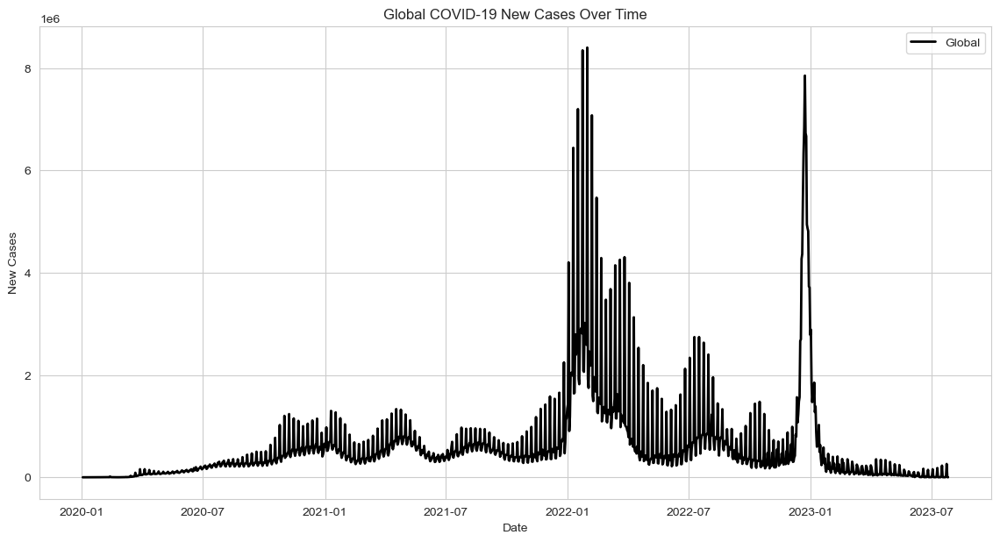

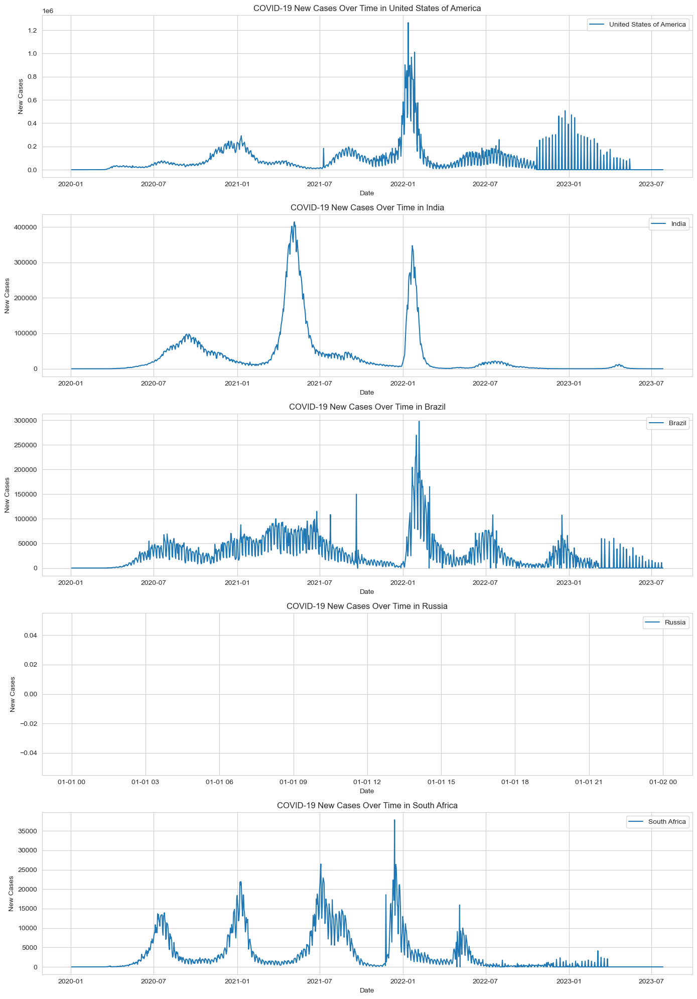

In [33]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the aesthetic style of the plots
sns.set_style("whitegrid")

# Function to plot new cases over time for a given country
def plot_country_cases(country, ax):
    country_data = covid_data_aggregated[covid_data_aggregated['Country'] == country]
    ax.plot(country_data['Date_reported'], country_data['New_cases'], label=country)
    ax.set_title(f'COVID-19 New Cases Over Time in {country}')
    ax.set_xlabel('Date')
    ax.set_ylabel('New Cases')
    ax.legend()

# Plot global trend
plt.figure(figsize=(14, 7))
global_trend = covid_data_aggregated.groupby('Date_reported')['New_cases'].sum().reset_index()
plt.plot(global_trend['Date_reported'], global_trend['New_cases'], label='Global', color='black', linewidth=2)
plt.title('Global COVID-19 New Cases Over Time')
plt.xlabel('Date')
plt.ylabel('New Cases')
plt.legend()
plt.show()

# Plot for a few individual countries
selected_countries = ['United States of America', 'India', 'Brazil', 'Russia', 'South Africa']
fig, axes = plt.subplots(nrows=len(selected_countries), ncols=1, figsize=(14, 20))

for i, country in enumerate(selected_countries):
    plot_country_cases(country, axes[i])

plt.tight_layout()
plt.show()


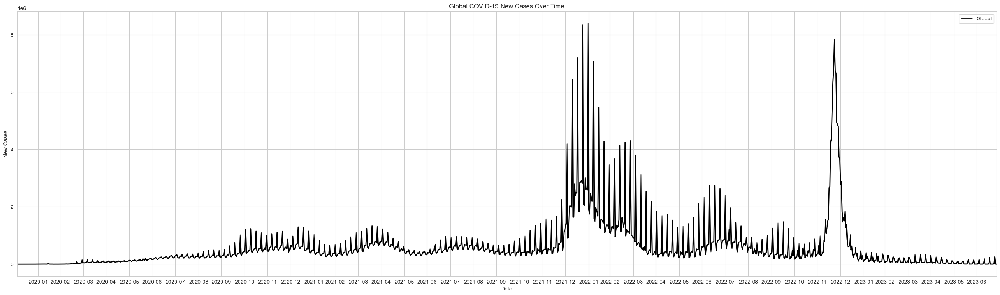

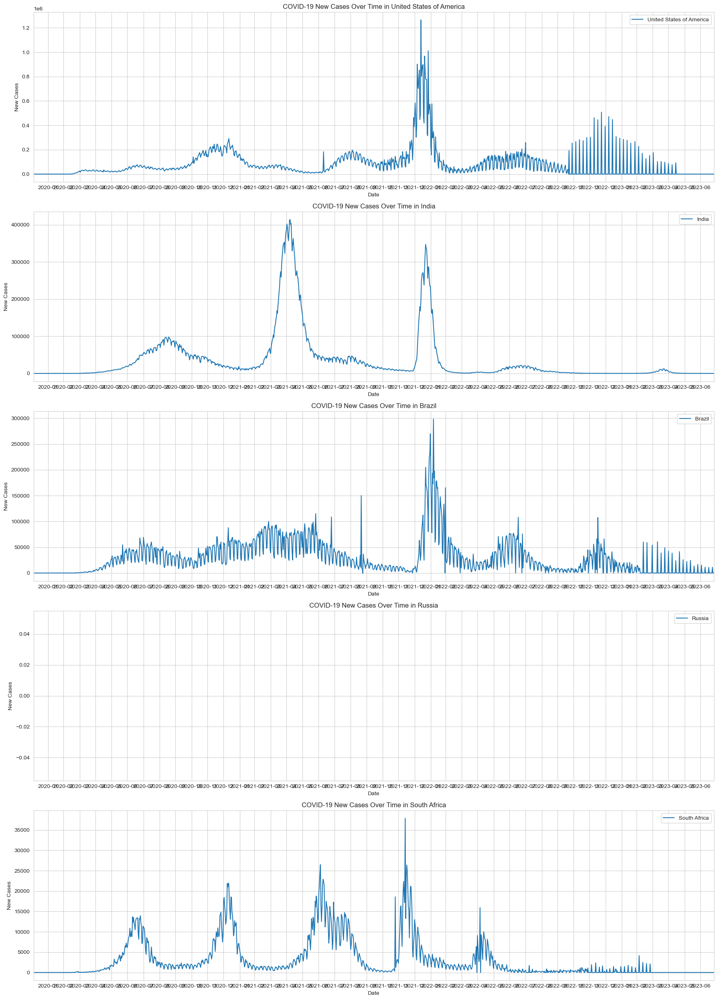

In [42]:
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.dates as mdates

# Set the aesthetic style of the plots
sns.set_style("whitegrid")

# Function to plot new cases over time for a given country
def plot_country_cases(country, ax):
    country_data = covid_data_aggregated[covid_data_aggregated['Country'] == country]
    ax.plot(country_data['Date_reported'], country_data['New_cases'], label=country)
    ax.set_title(f'COVID-19 New Cases Over Time in {country}')
    ax.set_xlabel('Date')
    ax.set_ylabel('New Cases')
    ax.legend()

# Plot global trend
plt.figure(figsize=(33, 9))  # Adjust the figsize for better visibility
global_trend = covid_data_aggregated.groupby('Date_reported')['New_cases'].sum().reset_index()
plt.plot(global_trend['Date_reported'], global_trend['New_cases'], label='Global', color='black', linewidth=2)
plt.title('Global COVID-19 New Cases Over Time')
plt.xlabel('Date')
plt.ylabel('New Cases')
plt.legend()

# Set x-axis limits for all months
plt.xlim(covid_data_aggregated['Date_reported'].min(), covid_data_aggregated['Date_reported'].max())

# Set the x-axis ticks to show all months with a larger gap
plt.gca().xaxis.set_major_locator(mdates.MonthLocator(bymonthday=-1))
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))  # Format as year-month

plt.show()

# Plot for a few individual countries
selected_countries = ['United States of America', 'India', 'Brazil', 'Russia', 'South Africa']
fig, axes = plt.subplots(nrows=len(selected_countries), ncols=1, figsize=(18, 25))  # Adjust the figsize

for i, country in enumerate(selected_countries):
    plot_country_cases(country, axes[i])

    # Set x-axis limits for all months
    axes[i].set_xlim(covid_data_aggregated['Date_reported'].min(), covid_data_aggregated['Date_reported'].max())

    # Set the x-axis ticks to show all months with a larger gap
    axes[i].xaxis.set_major_locator(mdates.MonthLocator(bymonthday=-1))
    axes[i].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))  # Format as year-month

plt.tight_layout()
plt.show()


In [23]:
# !pip install geopandas

In [22]:
import pandas as pd
import matplotlib.pyplot as plt
# !pip install geopandas
import geopandas as gpd
# from mpl_toolkits.axes_grid1 import make_axes_locatable

covid_data = pd.read_csv('WHO-COVID-19-global-data.csv')

covid_data = covid_data[['Country','Date_reported','New_cases','New_deaths']]
covid_data['Date_reported'] = pd.to_datetime(covid_data['Date_reported'], format='%d-%m-%Y')
covid_data['Month_Year'] = covid_data['Date_reported'].dt.strftime('%Y-%m')
covid_data = covid_data.drop('Date_reported', axis=1)
covid_data

,Country,New_cases,New_deaths,Month_Year
0,Afghanistan,0,0,2020-01
1,Afghanistan,0,0,2020-01
2,Afghanistan,0,0,2020-01
3,Afghanistan,0,0,2020-01
4,Afghanistan,0,0,2020-01
...,...,...,...,...
308332,Zimbabwe,0,0,2023-07
308333,Zimbabwe,0,0,2023-07
308334,Zimbabwe,0,0,2023-07
308335,Zimbabwe,0,0,2023-07


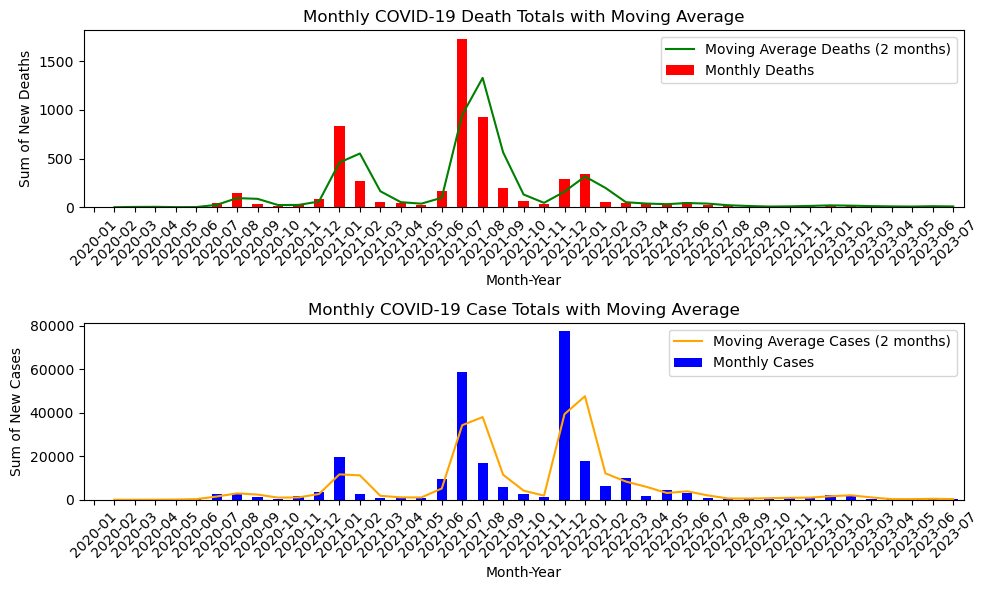

In [4]:
Select_country = "Zimbabwe"
monthly_deaths = covid_data[covid_data['Country'] == Select_country].groupby(['Month_Year'])['New_deaths'].sum()
monthly_new_cases = covid_data[covid_data['Country'] == Select_country].groupby(['Month_Year'])['New_cases'].sum()

# Define the window size for the moving average
window_size = 2  # Adjust this based on your preference

# Calculate the moving average for monthly deaths
moving_average_deaths = monthly_deaths.rolling(window=window_size).mean()

# Calculate the moving average for monthly new cases
moving_average_cases = monthly_new_cases.rolling(window=window_size).mean()

# Plotting both monthly deaths and new cases
plt.figure(figsize=(10, 6))

# Plotting monthly deaths
plt.subplot(2, 1, 1)
monthly_deaths.plot(kind='bar', color='red', label='Monthly Deaths')
moving_average_deaths.plot(kind='line', color='green', label=f'Moving Average Deaths ({window_size} months)')
plt.title('Monthly COVID-19 Death Totals with Moving Average')
plt.xlabel('Month-Year')
plt.ylabel('Sum of New Deaths')
plt.legend()
plt.xticks(rotation=45)

# Plotting monthly new cases
plt.subplot(2, 1, 2)
monthly_new_cases.plot(kind='bar', color='blue', label='Monthly Cases')
moving_average_cases.plot(kind='line', color='orange', label=f'Moving Average Cases ({window_size} months)')
plt.title('Monthly COVID-19 Case Totals with Moving Average')
plt.xlabel('Month-Year')
plt.ylabel('Sum of New Cases')
plt.legend()
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


/var/folders/yq/fcrs98296732c0y0w4vz44q00000gn/T/ipykernel_7567/922580244.py:12: RuntimeWarning: divide by zero encountered in scalar divide
  ratio_deaths = (abs(initial_deaths - current_deaths)/initial_deaths) * (abs(future_deaths - current_deaths)/current_deaths)
/var/folders/yq/fcrs98296732c0y0w4vz44q00000gn/T/ipykernel_7567/922580244.py:33: RuntimeWarning: divide by zero encountered in scalar divide
  ratio_cases = (abs(initial_cases - current_cases)/initial_cases) * (abs(future_cases - current_cases)/current_cases)


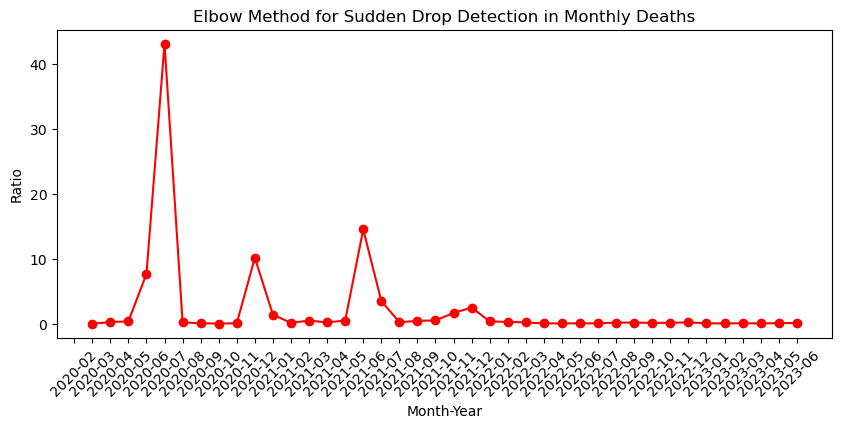

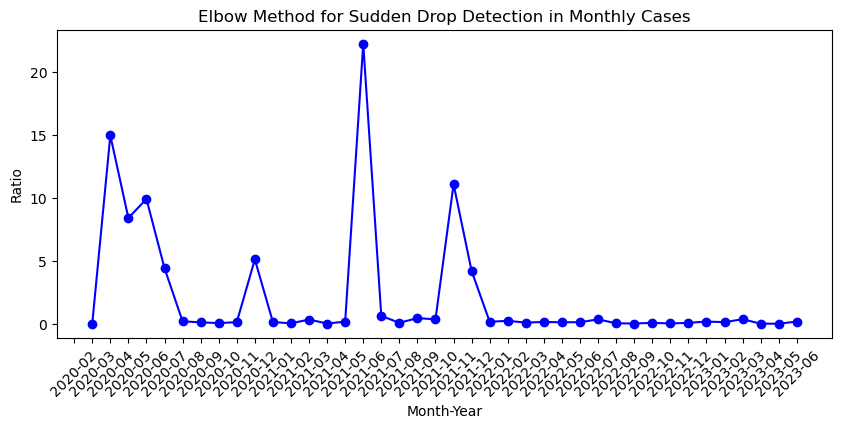

In [7]:
# Find the point of sudden drop in monthly deaths
deaths_values = moving_average_deaths.values
ratio_threshold_deaths = 50  # Adjust this threshold as needed
ratios_deaths = []

for i in range(1, len(deaths_values) - 1):
    initial_deaths = deaths_values[i - 1]
    current_deaths = deaths_values[i]
    future_deaths = deaths_values[i + 1]

    # ratio_deaths = abs(initial_deaths - current_deaths) / abs(future_deaths - current_deaths)
    ratio_deaths = (abs(initial_deaths - current_deaths)/initial_deaths) * (abs(future_deaths - current_deaths)/current_deaths)
    if math.isinf(ratio_deaths):
        ratio_deaths = 0   
        
    ratios_deaths.append(ratio_deaths)

    if ratio_deaths > ratio_threshold_deaths:
        drop_point_deaths = monthly_deaths.index[i]
        print(f"Sudden drop detected in Monthly Deaths at Month_Year: {drop_point_deaths}, Ratio: {ratio_deaths}")

# Find the point of sudden drop in monthly new cases
cases_values = moving_average_cases.values
ratio_threshold_cases = 30  # Adjust this threshold as needed
ratios_cases = []

for i in range(1, len(cases_values) - 1):
    initial_cases = cases_values[i - 1]
    current_cases = cases_values[i]
    future_cases = cases_values[i + 1]

    # ratio_cases = abs(initial_cases - current_cases) / abs(future_cases - current_cases)
    ratio_cases = (abs(initial_cases - current_cases)/initial_cases) * (abs(future_cases - current_cases)/current_cases)
    if math.isinf(ratio_cases):
        ratio_cases = 0
    
    ratios_cases.append(ratio_cases)

    if ratio_cases > ratio_threshold_cases:
        drop_point_cases = monthly_new_cases.index[i]
        print(f"Sudden drop detected in Monthly Cases at Month_Year: {drop_point_cases}, Ratio: {ratio_cases}")

# Plotting the elbow method for deaths
plt.figure(figsize=(10, 4))
plt.plot(monthly_deaths.index[1:-1], ratios_deaths, marker='o', linestyle='-', color='red')
plt.title('Elbow Method for Sudden Drop Detection in Monthly Deaths')
plt.xlabel('Month-Year')
plt.ylabel('Ratio')
plt.xticks(rotation=45)
plt.show()

# Plotting the elbow method for new cases
plt.figure(figsize=(10, 4))
plt.plot(monthly_new_cases.index[1:-1], ratios_cases, marker='o', linestyle='-', color='blue')
plt.title('Elbow Method for Sudden Drop Detection in Monthly Cases')
plt.xlabel('Month-Year')
plt.ylabel('Ratio')
plt.xticks(rotation=45)
plt.show()

/var/folders/yq/fcrs98296732c0y0w4vz44q00000gn/T/ipykernel_7567/3632462422.py:9: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


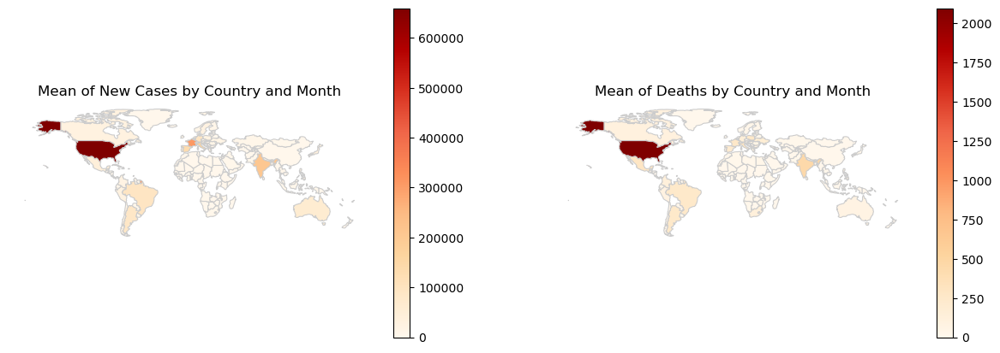

In [10]:
# Calculate the mean of new cases and deaths for each country and month
Select_month = '2022-01'
df = covid_data[covid_data['Month_Year'] == Select_month]

mean_new_cases = df.groupby(['Country'])['New_cases'].mean().reset_index()
mean_new_deaths = df.groupby(['Country'])['New_deaths'].mean().reset_index()

# Merge with a world map shapefile (e.g., Natural Earth shapefile)
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
world = world.rename(columns={'name': 'Country'})

# Merge COVID-19 data with world map
merged_cases = pd.merge(world, mean_new_cases, how='left', on='Country')
merged_deaths = pd.merge(world, mean_new_deaths, how='left', on='Country')

# Plotting mean of new cases
fig, ax = plt.subplots(1, 2, figsize=(15, 5))

merged_cases.plot(column='New_cases', cmap='OrRd', linewidth=0.8, ax=ax[0], edgecolor='0.8', legend=True)
ax[0].set_title('Mean of New Cases by Country and Month')
ax[0].set_axis_off()

# Plotting mean of deaths
merged_deaths.plot(column='New_deaths', cmap='OrRd', linewidth=0.8, ax=ax[1], edgecolor='0.8', legend=True)
ax[1].set_title('Mean of Deaths by Country and Month')
ax[1].set_axis_off()

plt.show()


## LSTM Model

In [14]:
import numpy as np
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from sklearn.metrics import mean_squared_error, mean_absolute_error

In [15]:
Select_month = input take via streamlit using view of new cases of each country 
train_test_data = covid_data[(covid_data['Month_Year'] < Select_month) & (covid_data['Country']==Select_country)]

# Split the data into training and testing sets (80:20 ratio)
train_data, test_data = train_test_split(train_test_data, test_size=0.2, shuffle=False)

# 2nd) Filter data for validation (greater than or equal to '2023-06')
validation_data = covid_data[(covid_data['Month_Year'] >= Select_month) & (covid_data['Country']==Select_country)]

# Normalize the data
scaler = MinMaxScaler()
train_data_normalized = scaler.fit_transform(train_data[['New_cases']])
test_data_normalized = scaler.transform(test_data[['New_cases']])
validation_data_normalized = scaler.transform(validation_data[['New_cases']])

In [16]:
# Create sequences for LSTM
def create_sequences(data, sequence_length):
    sequences, targets = [], []
    for i in range(len(data) - sequence_length):
        sequence = data[i:i+sequence_length]
        target = data[i+sequence_length:i+sequence_length+1]
        sequences.append(sequence)
        targets.append(target)
    return np.array(sequences), np.array(targets)

sequence_length = 10  # You can adjust this based on your data and model performance

X_train, y_train = create_sequences(train_data_normalized, sequence_length)
X_test, y_test = create_sequences(test_data_normalized, sequence_length)
X_validation, y_validation = create_sequences(validation_data_normalized, sequence_length)

In [17]:
# Build the LSTM model
model = Sequential()
model.add(LSTM(50, activation='relu', input_shape=(sequence_length, 1)))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mean_squared_error')

# Train the model
model.fit(X_train, y_train, epochs=50, batch_size=32, validation_data=(X_test, y_test), verbose=2)

# Evaluate the model on the validation data
validation_loss = model.evaluate(X_validation, y_validation, verbose=2)
print(f'Validation Loss: {validation_loss}')

Epoch 1/50
22/22 - 0s - loss: 0.0315 - val_loss: 0.0252 - 402ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0108 - val_loss: 0.0093 - 43ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0070 - 41ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0065 - 40ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0064 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0014 - val_loss: 0.0061 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0013 - val_loss: 0.0060 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0013 - val_loss: 0.0057 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0012 - val_loss: 0.0055 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0011 - val_loss: 0.0052 - 42ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0011 - val_loss: 0.0049 - 43ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0011 - val_loss: 0.0046 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 9.53

In [18]:
validation_loss = model.evaluate(X_validation, y_validation, verbose=2)
print(f'Validation Loss: {validation_loss}')

13/13 - 0s - loss: 1.1065e-05 - 13ms/epoch - 994us/step
Validation Loss: 1.1065349099226296e-05


13/13 [==============================] - 0s 680us/step
Mean Squared Error on Validation Data: 1898306.5856023815
Root Mean Squared Error on Validation Data: 1377.7904723151419
Mean Absolute Error on Validation Data: 831.0440986047696
R-squared on Validation Data: 0.9483550379685449
Adjusted R-squared on Validation Data: 0.9470639139177586


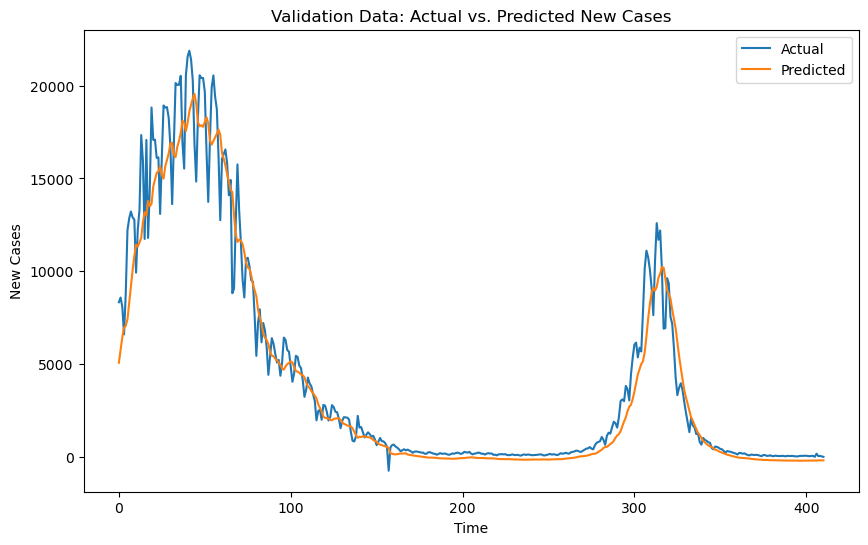

In [19]:
# Make predictions using the trained model on the validation data
validation_predictions = model.predict(X_validation)

# Reshape y_validation to 2D array before inverse transform
y_validation_reshaped = y_validation.reshape(-1, 1)

# Inverse transform the predictions and the original data
validation_predictions = scaler.inverse_transform(validation_predictions)
y_validation_actual = scaler.inverse_transform(y_validation_reshaped)

# Calculate and print the mean absolute error (MAE) or any other metric you're interested in
from sklearn.metrics import mean_absolute_error

mae = mean_absolute_error(y_validation_actual, validation_predictions)
mse = mean_squared_error(y_validation_actual, validation_predictions)
rmse = mean_squared_error(y_validation_actual, validation_predictions, squared=False)
r_squared = r2_score(y_validation_actual, validation_predictions)

# Calculate the number of observations and predictors
n_observations = len(y_validation_actual)
n_predictors = X_validation.shape[1] 
adjusted_r_squared = 1 - (1 - r_squared) * (n_observations - 1) / (n_observations - n_predictors - 1)


print(f'Mean Squared Error on Validation Data: {mse}')
print(f'Root Mean Squared Error on Validation Data: {rmse}')
print(f'Mean Absolute Error on Validation Data: {mae}')
print(f'R-squared on Validation Data: {r_squared}')
print(f'Adjusted R-squared on Validation Data: {adjusted_r_squared}')

plt.figure(figsize=(10, 6))
plt.plot(y_validation_actual, label='Actual')
plt.plot(validation_predictions, label='Predicted')
plt.title('Validation Data: Actual vs. Predicted New Cases')
plt.xlabel('Time')
plt.ylabel('New Cases')
plt.legend()
plt.show()

# All country run together

In [ ]:
import numpy as np
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from sklearn.metrics import mean_squared_error, mean_absolute_error
Select_country = "India"
train_test_data = covid_data[(covid_data['Month_Year'] < '2022-06') & (covid_data['Country']==Select_country)]

# Split the data into training and testing sets (80:20 ratio)
train_data, test_data = train_test_split(train_test_data, test_size=0.2, shuffle=False)

# 2nd) Filter data for validation (greater than or equal to '2023-06')
validation_data = covid_data[(covid_data['Month_Year'] >= '2022-06') & (covid_data['Country']==Select_country)]

# Normalize the data
scaler = MinMaxScaler()
train_data_normalized = scaler.fit_transform(train_data[['New_cases']])
test_data_normalized = scaler.transform(test_data[['New_cases']])
validation_data_normalized = scaler.transform(validation_data[['New_cases']])
# Create sequences for LSTM
def create_sequences(data, sequence_length):
    sequences, targets = [], []
    for i in range(len(data) - sequence_length):
        sequence = data[i:i+sequence_length]
        target = data[i+sequence_length:i+sequence_length+1]
        sequences.append(sequence)
        targets.append(target)
    return np.array(sequences), np.array(targets)

sequence_length = 10  # You can adjust this based on your data and model performance

X_train, y_train = create_sequences(train_data_normalized, sequence_length)
X_test, y_test = create_sequences(test_data_normalized, sequence_length)
X_validation, y_validation = create_sequences(validation_data_normalized, sequence_length)
# Create sequences for LSTM
def create_sequences(data, sequence_length):
    sequences, targets = [], []
    for i in range(len(data) - sequence_length):
        sequence = data[i:i+sequence_length]
        target = data[i+sequence_length:i+sequence_length+1]
        sequences.append(sequence)
        targets.append(target)
    return np.array(sequences), np.array(targets)

sequence_length = 10  # You can adjust this based on your data and model performance

X_train, y_train = create_sequences(train_data_normalized, sequence_length)
X_test, y_test = create_sequences(test_data_normalized, sequence_length)
X_validation, y_validation = create_sequences(validation_data_normalized, sequence_length)
# Build the LSTM model
model = Sequential()
model.add(LSTM(50, activation='relu', input_shape=(sequence_length, 1)))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mean_squared_error')

# Train the model
model.fit(X_train, y_train, epochs=50, batch_size=32, validation_data=(X_test, y_test), verbose=2)

# Evaluate the model on the validation data
validation_loss = model.evaluate(X_validation, y_validation, verbose=2)
print(f'Validation Loss: {validation_loss}')
# Make predictions using the trained model on the validation data
validation_predictions = model.predict(X_validation)

# Reshape y_validation to 2D array before inverse transform
y_validation_reshaped = y_validation.reshape(-1, 1)

# Inverse transform the predictions and the original data
validation_predictions = scaler.inverse_transform(validation_predictions)
y_validation_actual = scaler.inverse_transform(y_validation_reshaped)

# Calculate and print the mean absolute error (MAE) or any other metric you're interested in
from sklearn.metrics import mean_absolute_error

mae = mean_absolute_error(y_validation_actual, validation_predictions)
mse = mean_squared_error(y_validation_actual, validation_predictions)
rmse = mean_squared_error(y_validation_actual, validation_predictions, squared=False)
r_squared = r2_score(y_validation_actual, validation_predictions)

# Calculate the number of observations and predictors
n_observations = len(y_validation_actual)
n_predictors = X_validation.shape[1] 
adjusted_r_squared = 1 - (1 - r_squared) * (n_observations - 1) / (n_observations - n_predictors - 1)


print(f'Mean Squared Error on Validation Data: {mse}')
print(f'Root Mean Squared Error on Validation Data: {rmse}')
print(f'Mean Absolute Error on Validation Data: {mae}')
print(f'R-squared on Validation Data: {r_squared}')
print(f'Adjusted R-squared on Validation Data: {adjusted_r_squared}')

plt.figure(figsize=(10, 6))
plt.plot(y_validation_actual, label='Actual')
plt.plot(validation_predictions, label='Predicted')
plt.title('Validation Data: Actual vs. Predicted New Cases')
plt.xlabel('Time')
plt.ylabel('New Cases')
plt.legend()
plt.show()

Epoch 1/50
22/22 - 0s - loss: 0.0157 - val_loss: 0.0036 - 381ms/epoch - 17ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0083 - val_loss: 0.0020 - 37ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0015 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.0015 - 40ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.0016 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.0014 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0014 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0015 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.0014 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0014 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0014 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0014 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

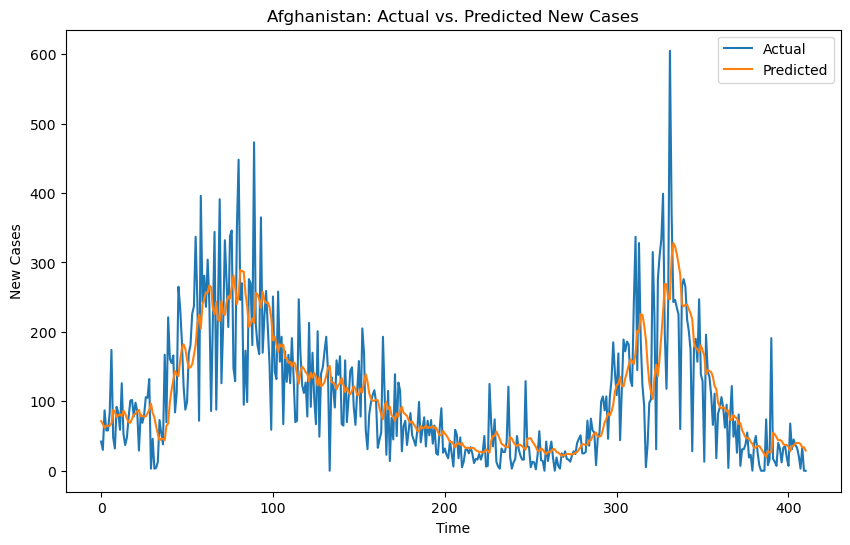

Epoch 1/50
22/22 - 0s - loss: 0.0669 - val_loss: 0.1107 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0133 - val_loss: 0.0712 - 37ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0072 - val_loss: 0.1347 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0066 - val_loss: 0.0859 - 36ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0064 - val_loss: 0.0885 - 38ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0062 - val_loss: 0.0740 - 38ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0680 - 38ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0748 - 38ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0630 - 38ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0663 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0642 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.0607 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

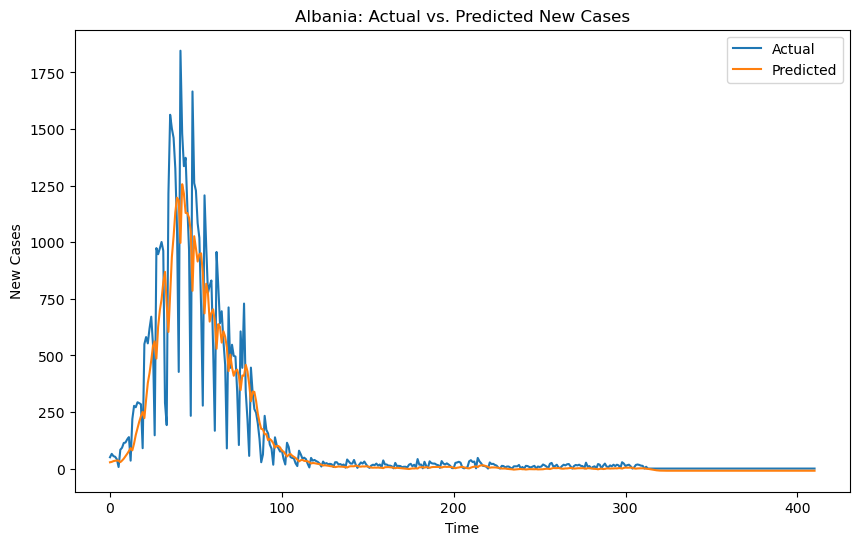

Epoch 1/50
22/22 - 0s - loss: 0.0298 - val_loss: 0.0499 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0084 - val_loss: 0.0205 - 37ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0208 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0020 - val_loss: 0.0187 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0020 - val_loss: 0.0185 - 38ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0182 - 38ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0172 - 38ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0163 - 38ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0163 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0144 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0140 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0133 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

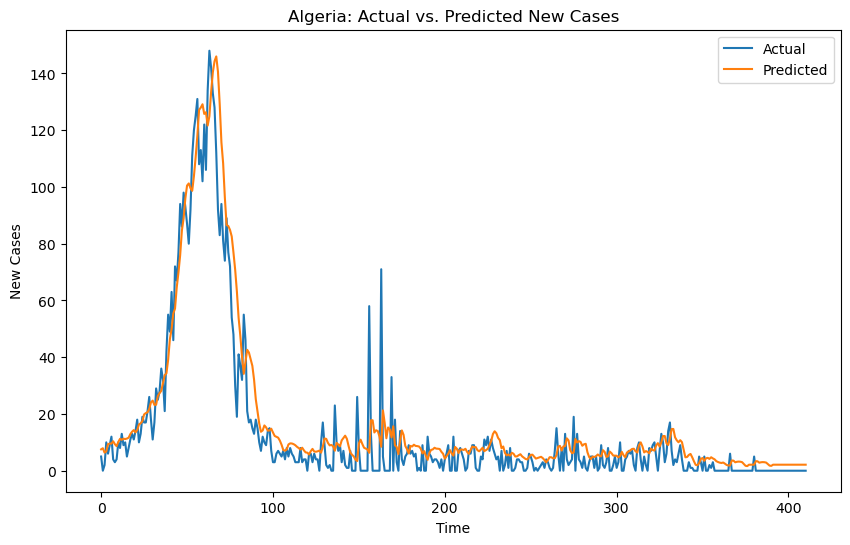

Epoch 1/50
22/22 - 0s - loss: 0.0018 - val_loss: 533.6841 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0019 - val_loss: 532.7104 - 37ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0018 - val_loss: 538.1938 - 36ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0018 - val_loss: 534.1965 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0018 - val_loss: 538.0661 - 38ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0018 - val_loss: 535.5203 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0018 - val_loss: 533.1777 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0018 - val_loss: 533.6783 - 38ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0018 - val_loss: 535.6808 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0018 - val_loss: 525.2811 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0018 - val_loss: 544.1964 - 38ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0018 - val_loss: 535.6263 - 40ms/epoch - 2ms/step
Epoch 13/50

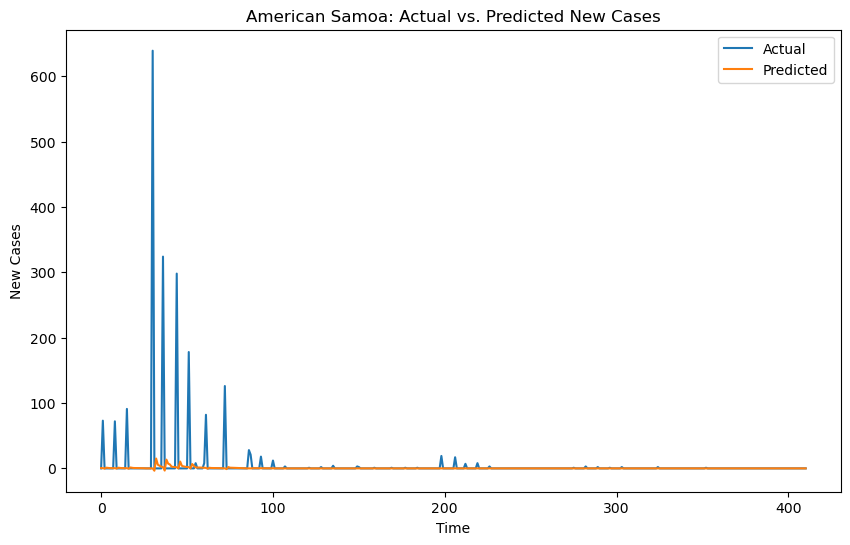

Epoch 1/50
22/22 - 0s - loss: 0.0128 - val_loss: 0.4729 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0103 - val_loss: 0.4351 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0092 - val_loss: 0.3940 - 36ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0084 - val_loss: 0.4844 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0081 - val_loss: 0.4662 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0081 - val_loss: 0.4437 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0080 - val_loss: 0.4867 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0080 - val_loss: 0.4340 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0081 - val_loss: 0.4970 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0079 - val_loss: 0.4284 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0078 - val_loss: 0.4253 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0078 - val_loss: 0.4169 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

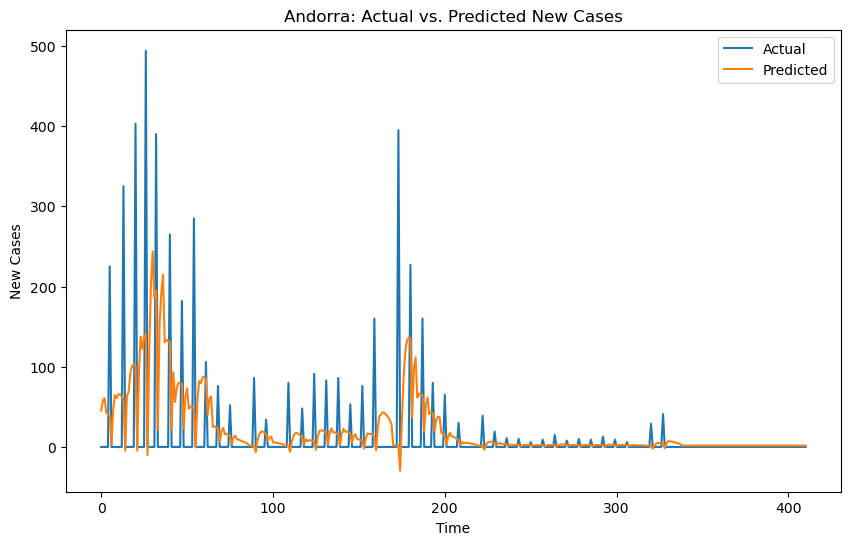

Epoch 1/50
22/22 - 0s - loss: 0.0126 - val_loss: 0.4002 - 391ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0067 - val_loss: 0.4603 - 37ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0050 - val_loss: 0.6562 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0048 - val_loss: 0.5361 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.4801 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0048 - val_loss: 0.4240 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.4223 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.4178 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.4189 - 38ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.4052 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.4101 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0047 - val_loss: 0.4113 - 38ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

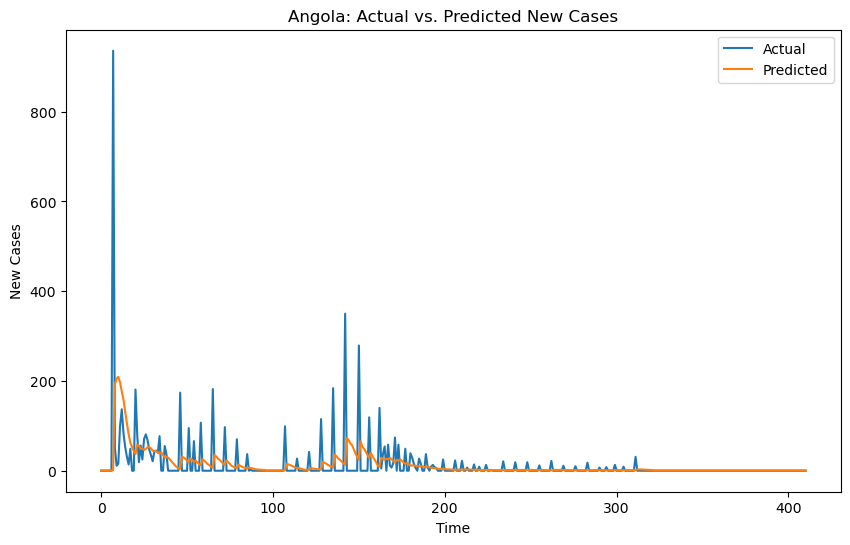

Epoch 1/50
22/22 - 0s - loss: 0.0085 - val_loss: 0.0996 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0077 - val_loss: 0.0970 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0071 - val_loss: 0.0966 - 36ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.0965 - 36ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0067 - val_loss: 0.0956 - 38ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0066 - val_loss: 0.0956 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0066 - val_loss: 0.0954 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0066 - val_loss: 0.0949 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0064 - val_loss: 0.0941 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0066 - val_loss: 0.0935 - 38ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0064 - val_loss: 0.0931 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0063 - val_loss: 0.0940 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

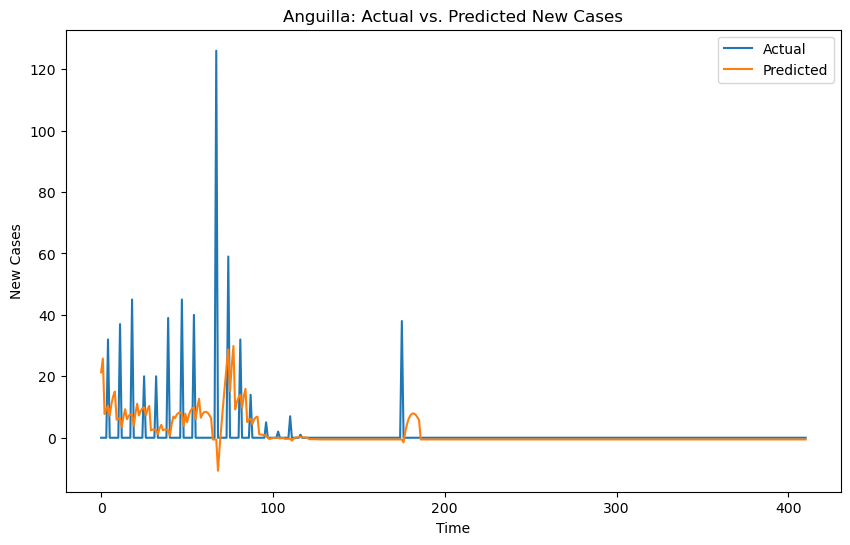

Epoch 1/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.0682 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0671 - 37ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0056 - val_loss: 0.0645 - 43ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0051 - val_loss: 0.0649 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0050 - val_loss: 0.0663 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.0659 - 38ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.0662 - 38ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0050 - val_loss: 0.0655 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.0657 - 38ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0050 - val_loss: 0.0653 - 38ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.0657 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0048 - val_loss: 0.0657 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

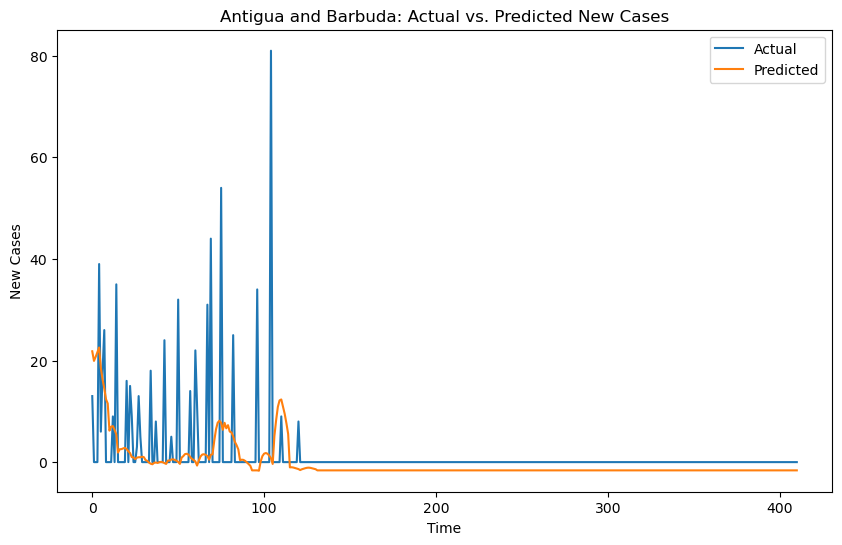

Epoch 1/50
22/22 - 0s - loss: 0.0303 - val_loss: 0.2319 - 391ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0096 - val_loss: 0.5312 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0073 - val_loss: 0.6722 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0073 - val_loss: 0.5326 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0071 - val_loss: 0.5000 - 44ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0070 - val_loss: 0.3588 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0072 - val_loss: 0.4390 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.3050 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.3779 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0070 - val_loss: 0.3206 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0069 - val_loss: 0.3156 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0071 - val_loss: 0.3158 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

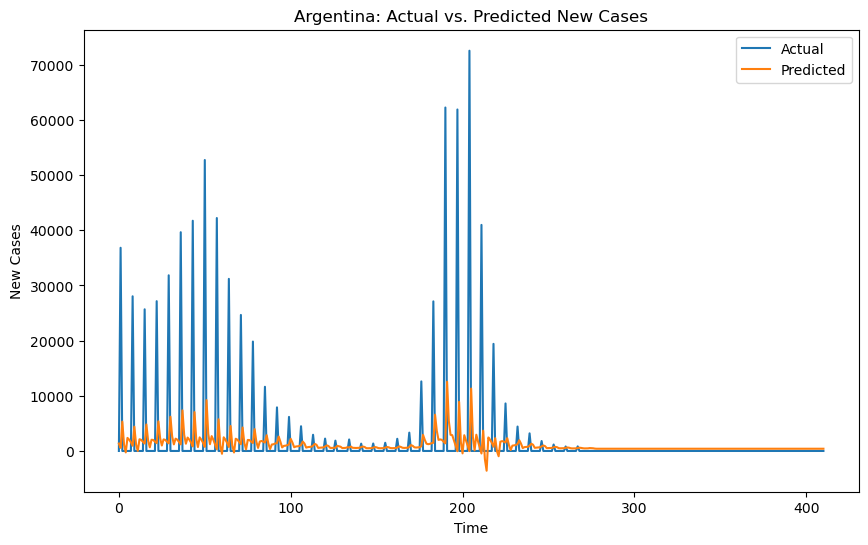

Epoch 1/50
22/22 - 0s - loss: 0.0364 - val_loss: 0.0482 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0126 - val_loss: 0.0395 - 41ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0091 - val_loss: 0.0472 - 42ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0092 - val_loss: 0.0433 - 42ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0087 - val_loss: 0.0382 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0091 - val_loss: 0.0359 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0088 - val_loss: 0.0381 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0086 - val_loss: 0.0353 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0085 - val_loss: 0.0338 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0084 - val_loss: 0.0350 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0082 - val_loss: 0.0335 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0084 - val_loss: 0.0330 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

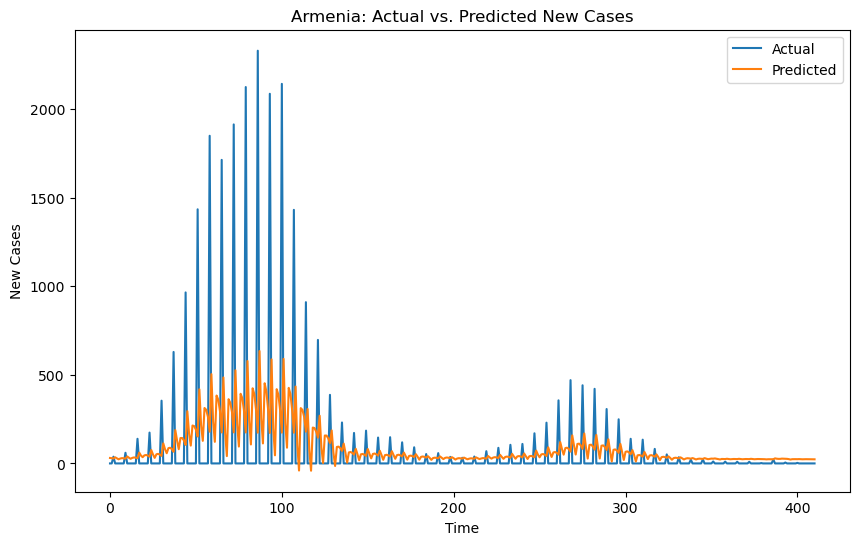

Epoch 1/50
22/22 - 0s - loss: 0.0195 - val_loss: 0.3462 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.3331 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0070 - val_loss: 0.3225 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0069 - val_loss: 0.3192 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.3337 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0066 - val_loss: 0.4322 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0066 - val_loss: 0.5411 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0066 - val_loss: 1.0421 - 38ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0065 - val_loss: 1.2914 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0065 - val_loss: 1.3051 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0065 - val_loss: 1.3323 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0064 - val_loss: 1.8310 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

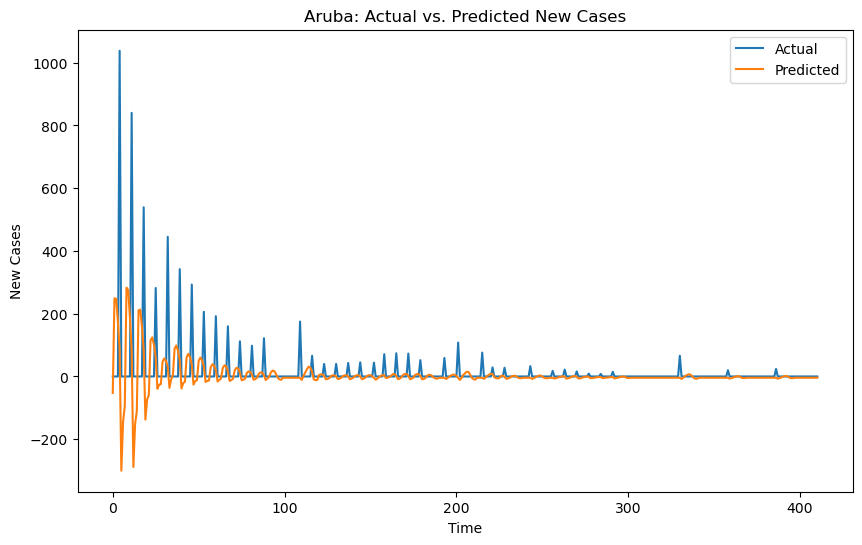

Epoch 1/50
22/22 - 0s - loss: 0.0129 - val_loss: 54.5060 - 391ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0125 - val_loss: 51.7496 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0122 - val_loss: 69.4898 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0118 - val_loss: 3993.0061 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0111 - val_loss: 25636.3223 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0108 - val_loss: 60874.9414 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0102 - val_loss: 49772.8438 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0095 - val_loss: 173235.8750 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0086 - val_loss: 39318.2891 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0079 - val_loss: 29181.4375 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0065 - val_loss: 1962925.6250 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0057 - val_loss: 1794611.5000 - 40ms/epoch - 2

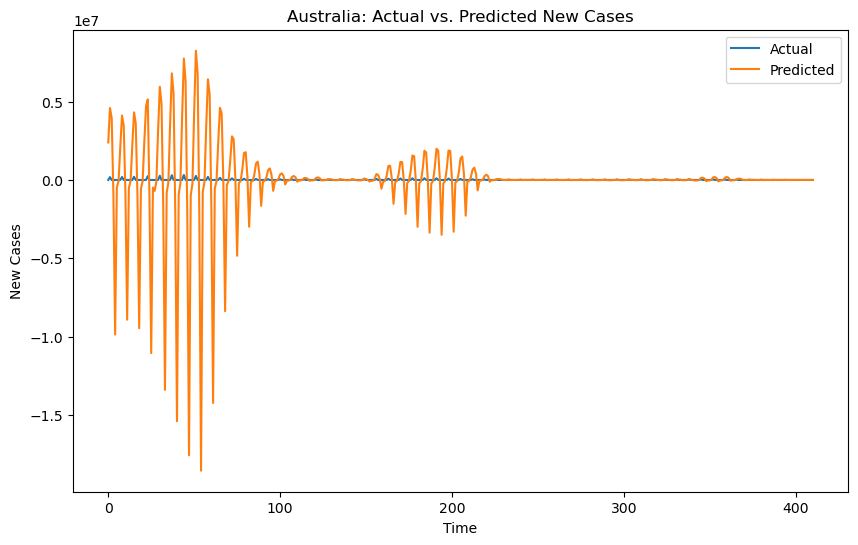

Epoch 1/50
22/22 - 0s - loss: 0.0269 - val_loss: 1.1808 - 391ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0111 - val_loss: 0.2692 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0030 - val_loss: 7.6940 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.8070 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0021 - val_loss: 1.0810 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0020 - val_loss: 0.5421 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.5395 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0020 - val_loss: 0.3393 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.3729 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.2317 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.2026 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.1483 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

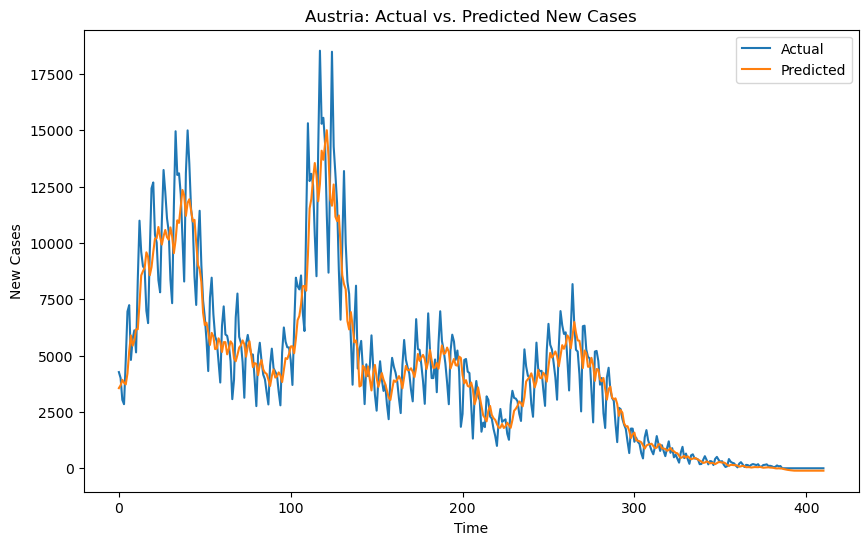

Epoch 1/50
22/22 - 0s - loss: 0.0462 - val_loss: 0.0666 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0131 - val_loss: 0.0370 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0079 - val_loss: 0.0686 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.0445 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0062 - val_loss: 0.0391 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0061 - val_loss: 0.0330 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0061 - val_loss: 0.0304 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0057 - val_loss: 0.0334 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0056 - val_loss: 0.0291 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.0280 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0052 - val_loss: 0.0237 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0051 - val_loss: 0.0221 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

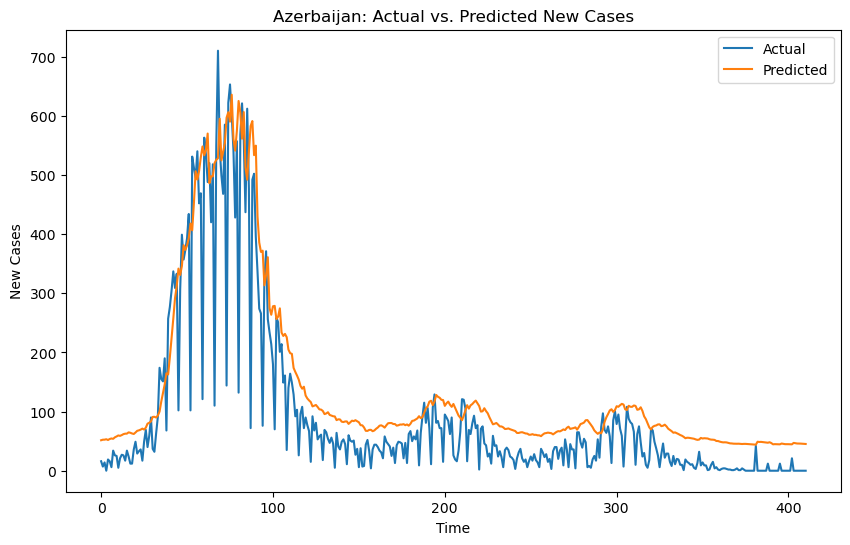

Epoch 1/50
22/22 - 0s - loss: 0.0355 - val_loss: 0.6584 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0162 - val_loss: 0.5992 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0103 - val_loss: 1.3313 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0101 - val_loss: 0.7049 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0100 - val_loss: 0.7209 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0099 - val_loss: 0.6577 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0099 - val_loss: 0.6616 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0100 - val_loss: 0.6356 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0100 - val_loss: 0.6288 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0100 - val_loss: 0.6231 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0100 - val_loss: 0.6152 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0098 - val_loss: 0.6164 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.01

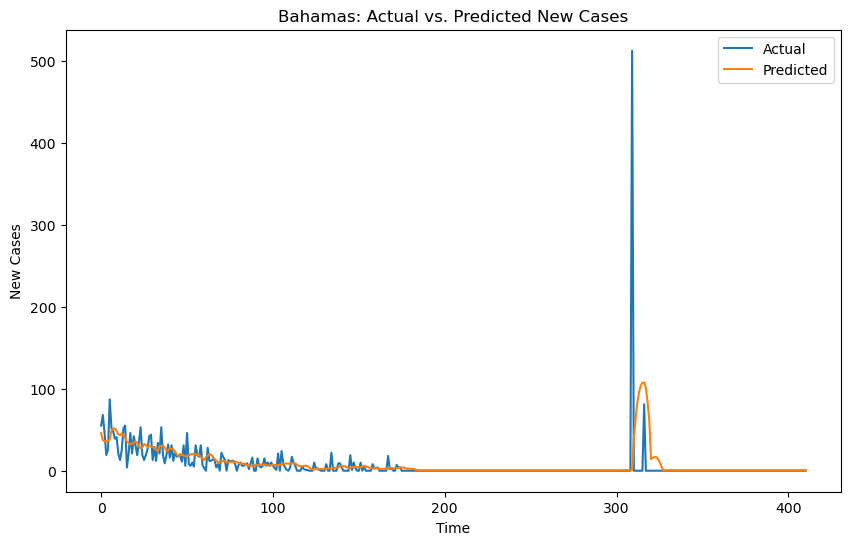

Epoch 1/50
22/22 - 0s - loss: 0.0184 - val_loss: 0.1247 - 425ms/epoch - 19ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0048 - val_loss: 0.3816 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.3542 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0021 - val_loss: 0.0778 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0021 - val_loss: 0.0575 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0273 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0014 - val_loss: 0.1393 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0013 - val_loss: 0.5146 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0010 - val_loss: 2.7456 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0011 - val_loss: 0.8835 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0010 - val_loss: 1.4619 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 9.9903e-04 - val_loss: 1.8651 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 

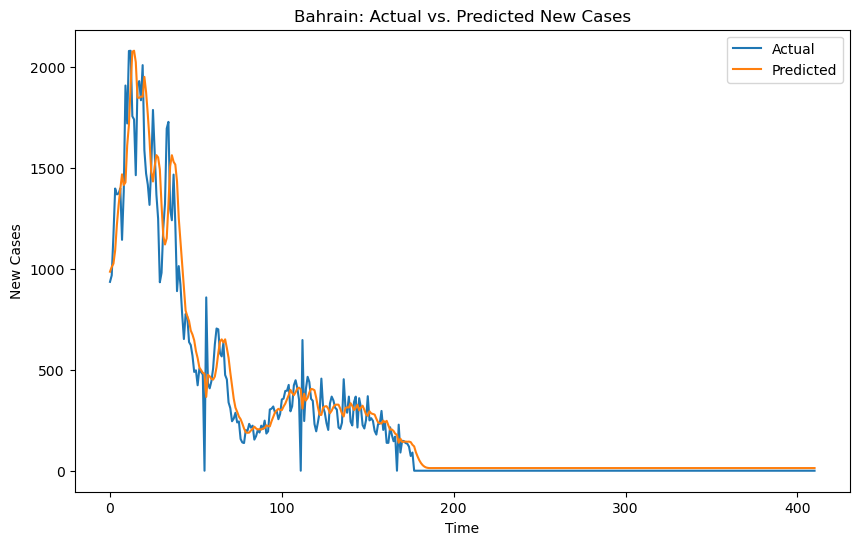

Epoch 1/50
22/22 - 0s - loss: 0.0282 - val_loss: 0.0285 - 393ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0100 - val_loss: 0.0123 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0044 - val_loss: 0.0112 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0099 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0090 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0084 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0033 - val_loss: 0.0080 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0033 - val_loss: 0.0069 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.0067 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.0060 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.0056 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.0051 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

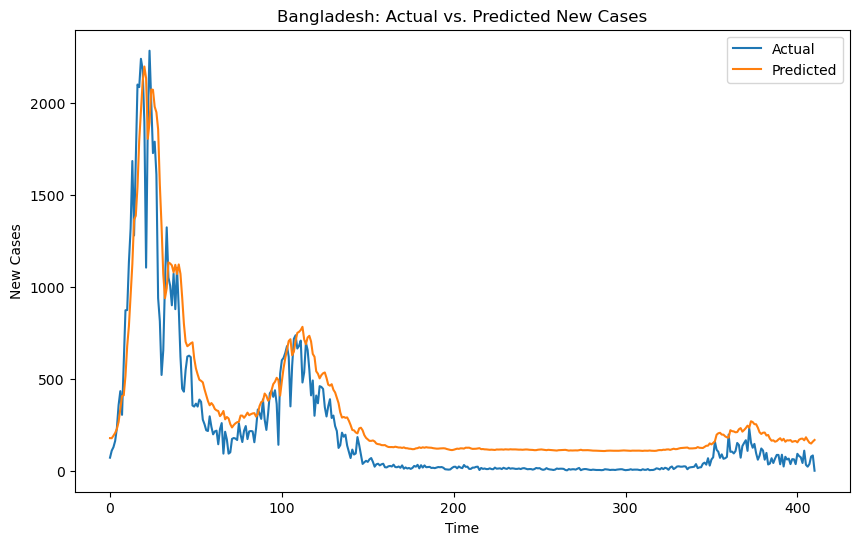

Epoch 1/50
22/22 - 0s - loss: 0.0110 - val_loss: 0.1464 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.1101 - 37ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.1062 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.1060 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.1063 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.1054 - 38ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.1047 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.1042 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0044 - val_loss: 0.1041 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.1041 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0044 - val_loss: 0.1045 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0044 - val_loss: 0.1034 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

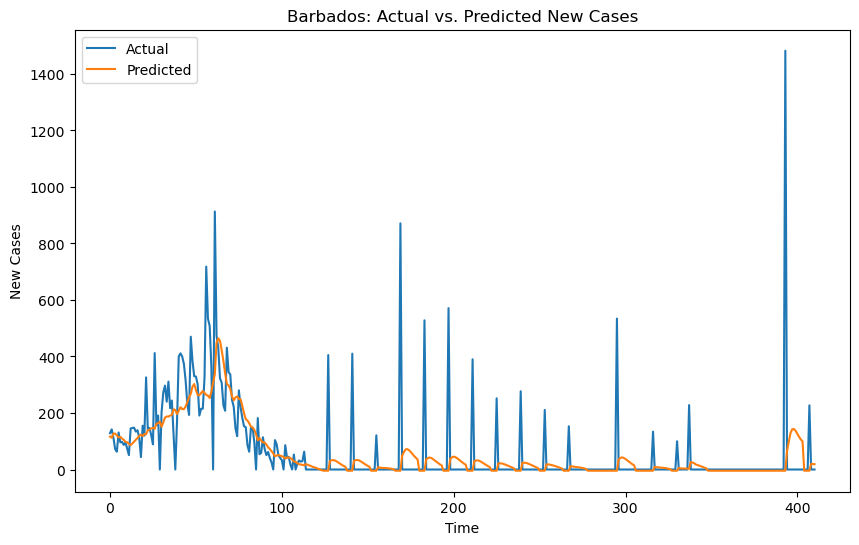

Epoch 1/50
22/22 - 0s - loss: 0.1845 - val_loss: 0.4371 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0328 - val_loss: 1.9068 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0200 - val_loss: 11.2719 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0160 - val_loss: 12.1961 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0150 - val_loss: 13.3626 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0144 - val_loss: 11.9098 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0142 - val_loss: 9.3265 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0141 - val_loss: 7.0113 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0140 - val_loss: 5.9753 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0139 - val_loss: 6.5349 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0139 - val_loss: 4.2044 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0138 - val_loss: 3.8603 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 

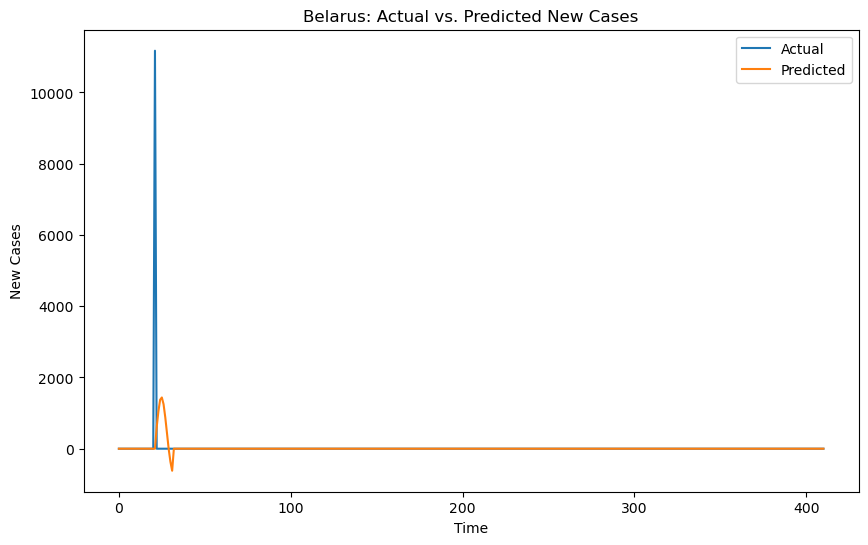

Epoch 1/50
22/22 - 0s - loss: 0.0244 - val_loss: 0.2710 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0113 - val_loss: 0.2030 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0066 - val_loss: 0.6582 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0063 - val_loss: 0.3077 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0063 - val_loss: 0.2311 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0062 - val_loss: 0.2393 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0061 - val_loss: 0.2452 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0061 - val_loss: 0.1905 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.2149 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.1922 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.1832 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.1467 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

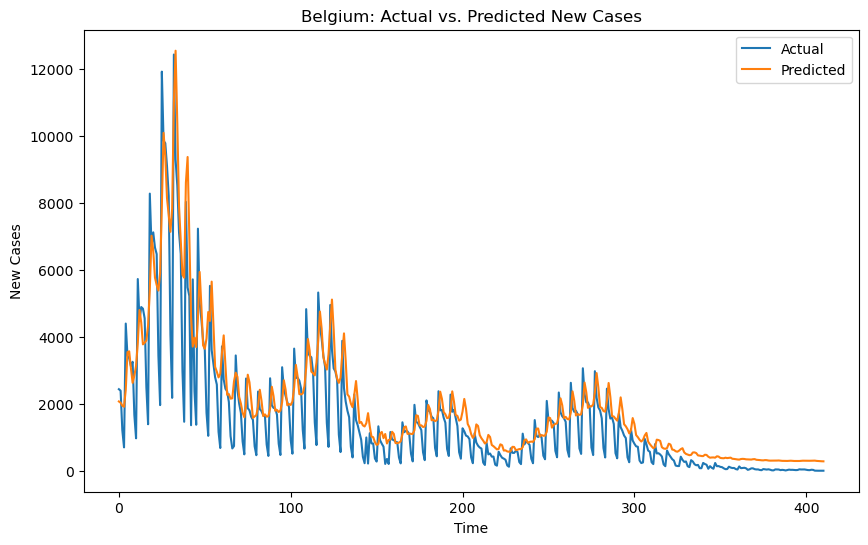

Epoch 1/50
22/22 - 0s - loss: 0.0050 - val_loss: 0.0578 - 392ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.0454 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0036 - val_loss: 0.0394 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0036 - val_loss: 0.0383 - 40ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0391 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0386 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0385 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0379 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0376 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0370 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0366 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0033 - val_loss: 0.0364 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

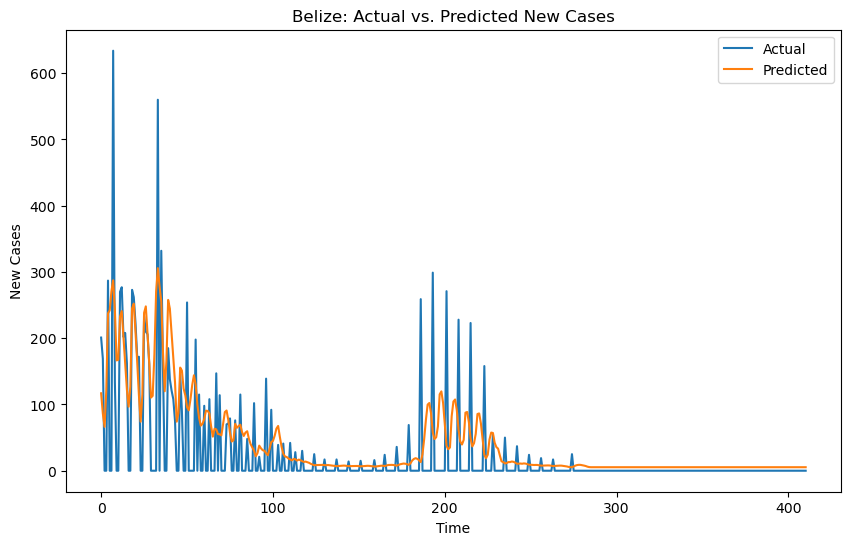

Epoch 1/50
22/22 - 0s - loss: 0.0040 - val_loss: 3.1033e-04 - 397ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0039 - val_loss: 3.8720e-04 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0039 - val_loss: 3.1549e-04 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0038 - val_loss: 3.0713e-04 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0038 - val_loss: 3.2865e-04 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0037 - val_loss: 4.0508e-04 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0038 - val_loss: 5.2183e-04 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0038 - val_loss: 3.1189e-04 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0038 - val_loss: 3.2066e-04 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0037 - val_loss: 3.5204e-04 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0036 - val_loss: 3.2239e-04 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0036 - val_loss: 3.0301e-04 - 41ms/epoc

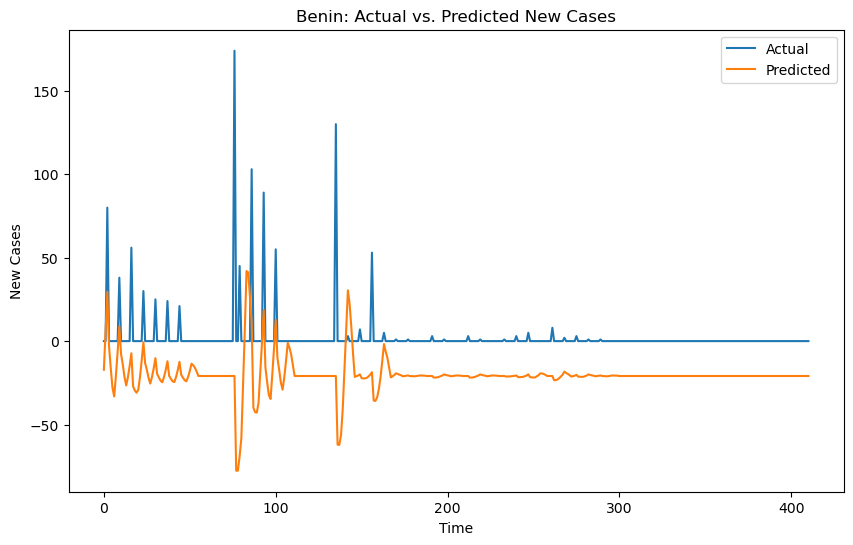

Epoch 1/50
22/22 - 0s - loss: 0.0100 - val_loss: 0.2318 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0084 - val_loss: 0.2205 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0071 - val_loss: 0.2132 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0067 - val_loss: 0.2137 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0067 - val_loss: 0.2132 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0067 - val_loss: 0.2128 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0067 - val_loss: 0.2128 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0066 - val_loss: 0.2127 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0067 - val_loss: 0.2127 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0067 - val_loss: 0.2110 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.2125 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.2109 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

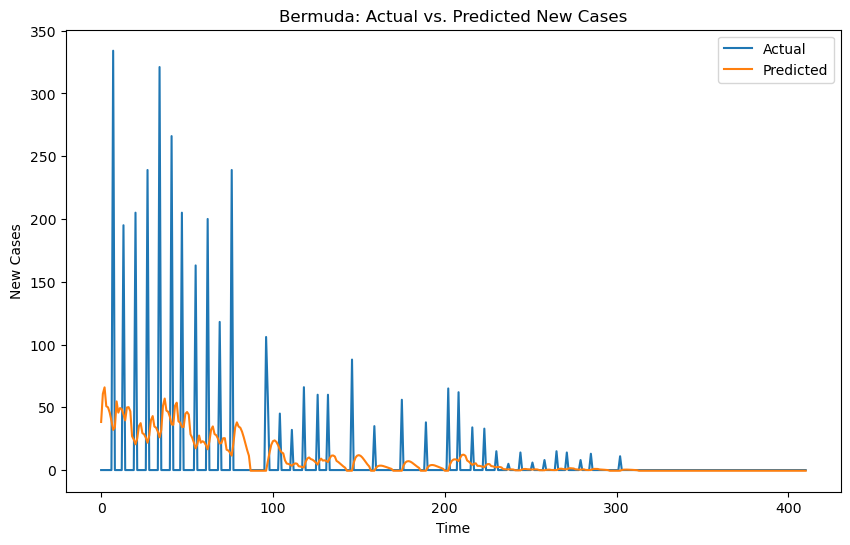

Epoch 1/50
22/22 - 0s - loss: 0.0064 - val_loss: 15.8448 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0050 - val_loss: 510.8460 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0044 - val_loss: 10960.1631 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0038 - val_loss: 53937.9883 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0037 - val_loss: 64951.7422 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0036 - val_loss: 34447.8203 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0036 - val_loss: 32465.4883 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0036 - val_loss: 31609.6660 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0036 - val_loss: 19821.0098 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0036 - val_loss: 21531.5156 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0036 - val_loss: 14061.0547 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0036 - val_loss: 5535.8496 - 41ms/epoch - 2m

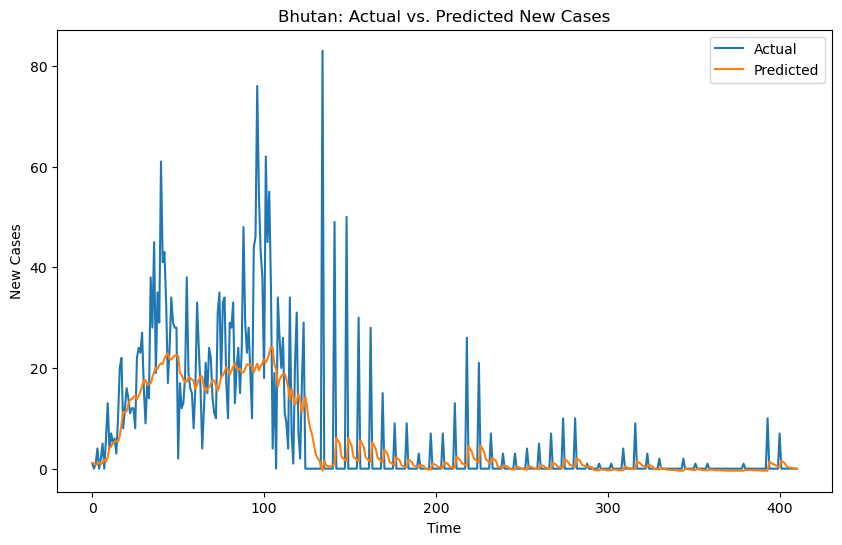

Epoch 1/50
22/22 - 0s - loss: 0.0413 - val_loss: 0.5953 - 391ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0135 - val_loss: 0.6188 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0088 - val_loss: 7.5472 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0074 - val_loss: 10.5762 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0071 - val_loss: 5.2417 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0070 - val_loss: 4.7153 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0068 - val_loss: 2.0776 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0068 - val_loss: 3.0710 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0067 - val_loss: 1.6230 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0066 - val_loss: 2.0803 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0066 - val_loss: 1.9420 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0065 - val_loss: 2.0651 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.0

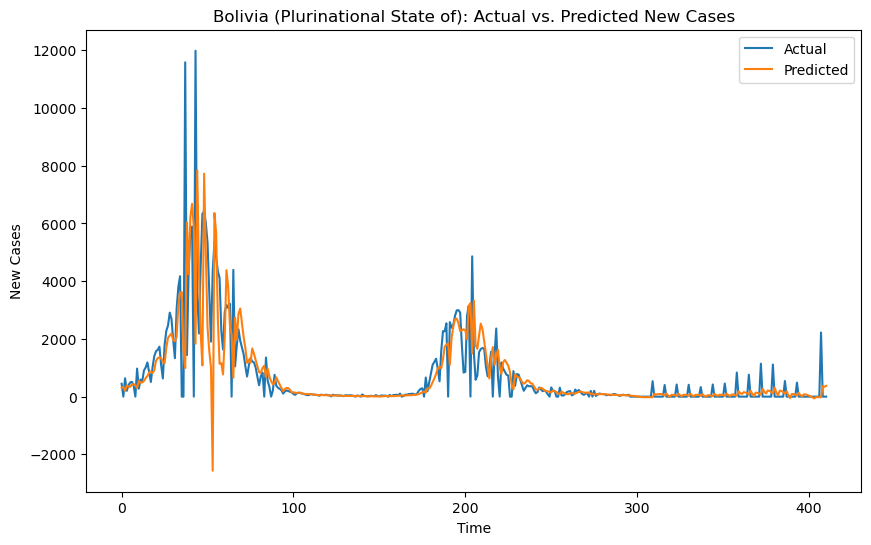

Epoch 1/50
22/22 - 0s - loss: 0.0088 - val_loss: 0.5965 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0084 - val_loss: 0.5938 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0082 - val_loss: 0.5934 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0080 - val_loss: 0.6013 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0079 - val_loss: 0.6019 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0079 - val_loss: 0.5971 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0078 - val_loss: 0.5981 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0077 - val_loss: 0.5976 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0077 - val_loss: 0.5917 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0077 - val_loss: 0.5608 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0076 - val_loss: 0.5571 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0076 - val_loss: 0.5455 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

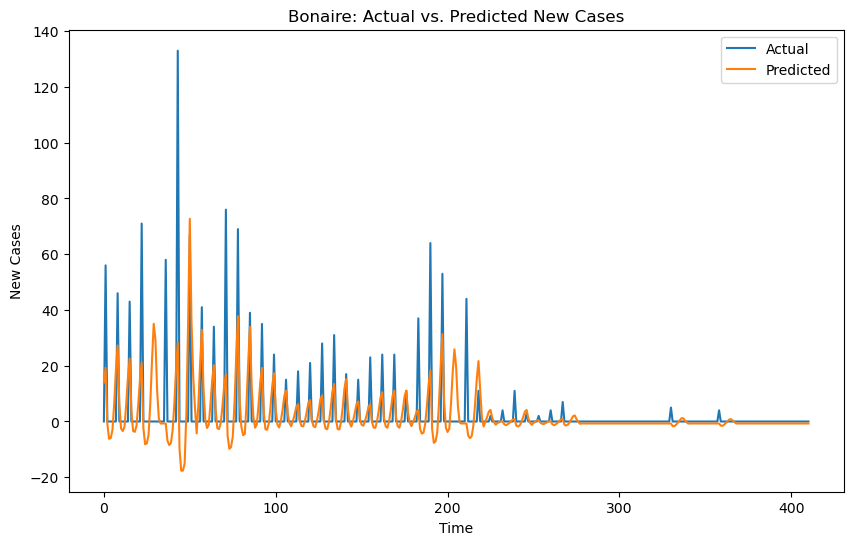

Epoch 1/50
22/22 - 0s - loss: 0.0696 - val_loss: 0.1256 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0233 - val_loss: 0.0451 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0114 - val_loss: 0.0498 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0105 - val_loss: 0.0441 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0102 - val_loss: 0.0395 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0102 - val_loss: 0.0409 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0099 - val_loss: 0.0386 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0101 - val_loss: 0.0398 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0099 - val_loss: 0.0379 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0096 - val_loss: 0.0385 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0098 - val_loss: 0.0374 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0098 - val_loss: 0.0379 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

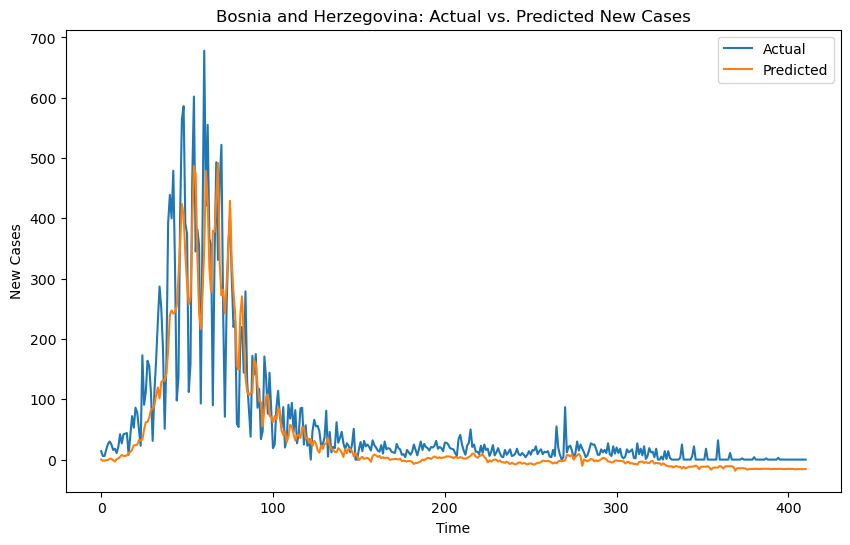

Epoch 1/50
22/22 - 0s - loss: 0.0123 - val_loss: 0.1534 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0117 - val_loss: 0.1554 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0113 - val_loss: 0.1600 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0111 - val_loss: 0.1625 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0108 - val_loss: 0.1669 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0108 - val_loss: 0.1717 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0104 - val_loss: 0.1868 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0102 - val_loss: 0.1948 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0100 - val_loss: 0.2138 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0101 - val_loss: 0.2349 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0100 - val_loss: 0.2779 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0096 - val_loss: 0.2860 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

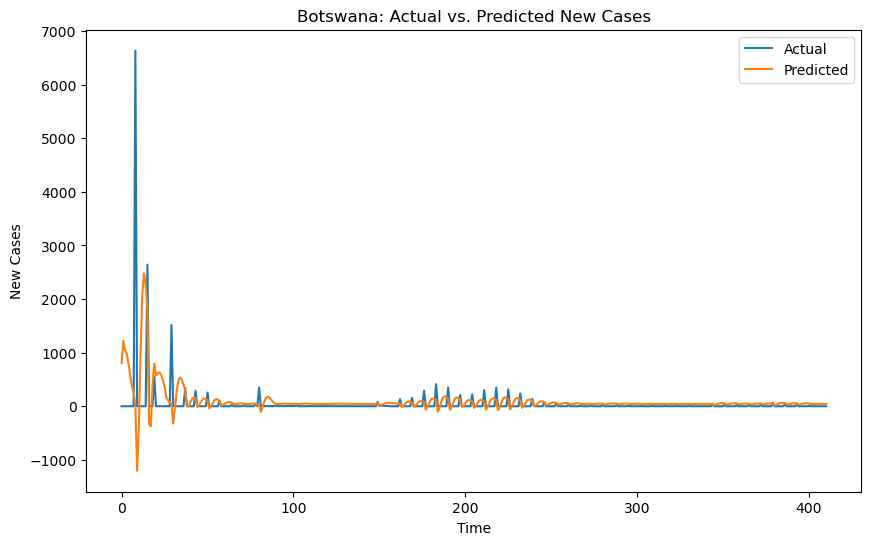

Epoch 1/50
22/22 - 0s - loss: 0.0628 - val_loss: 0.2138 - 394ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0301 - val_loss: 0.1113 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0140 - val_loss: 0.0583 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0099 - val_loss: 0.0654 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0099 - val_loss: 0.0590 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0099 - val_loss: 0.0591 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0098 - val_loss: 0.0584 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0098 - val_loss: 0.0584 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0099 - val_loss: 0.0592 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0096 - val_loss: 0.0594 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0095 - val_loss: 0.0606 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0095 - val_loss: 0.0596 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

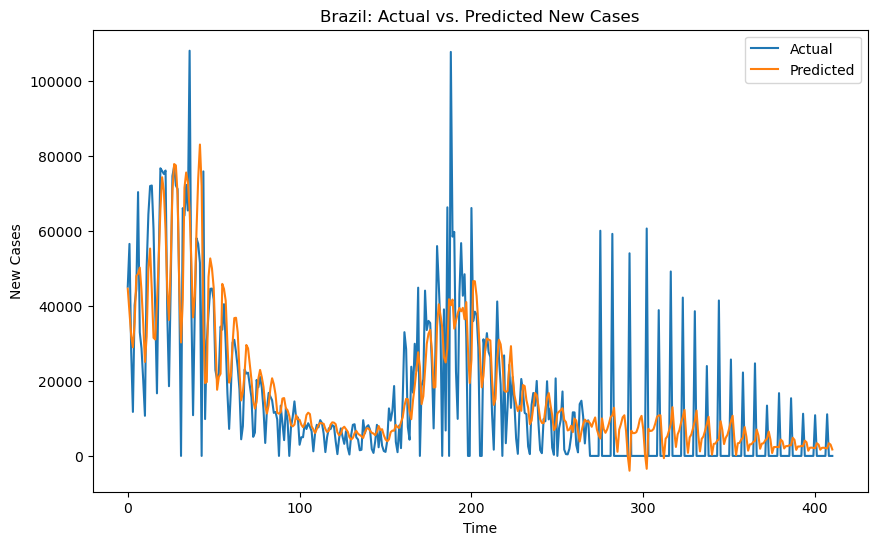

Epoch 1/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0087 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0084 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0082 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0084 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0021 - val_loss: 0.0079 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0021 - val_loss: 0.0077 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0021 - val_loss: 0.0080 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0078 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0021 - val_loss: 0.0075 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0020 - val_loss: 0.0075 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0021 - val_loss: 0.0074 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0020 - val_loss: 0.0073 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

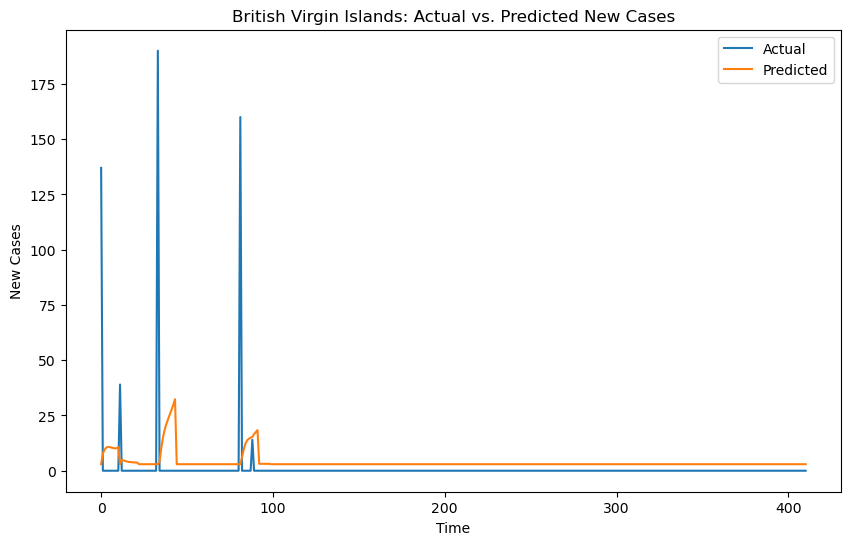

Epoch 1/50
22/22 - 0s - loss: 0.0129 - val_loss: 3.7351 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0069 - val_loss: 57.5126 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0035 - val_loss: 2682.5535 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0031 - val_loss: 1194.8979 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0030 - val_loss: 1055.0111 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0030 - val_loss: 843.2693 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0029 - val_loss: 971.7273 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0030 - val_loss: 616.3854 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0029 - val_loss: 469.4110 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0030 - val_loss: 352.2588 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0029 - val_loss: 436.6295 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0030 - val_loss: 298.2350 - 41ms/epoch - 2ms/step
Epoch 13/50

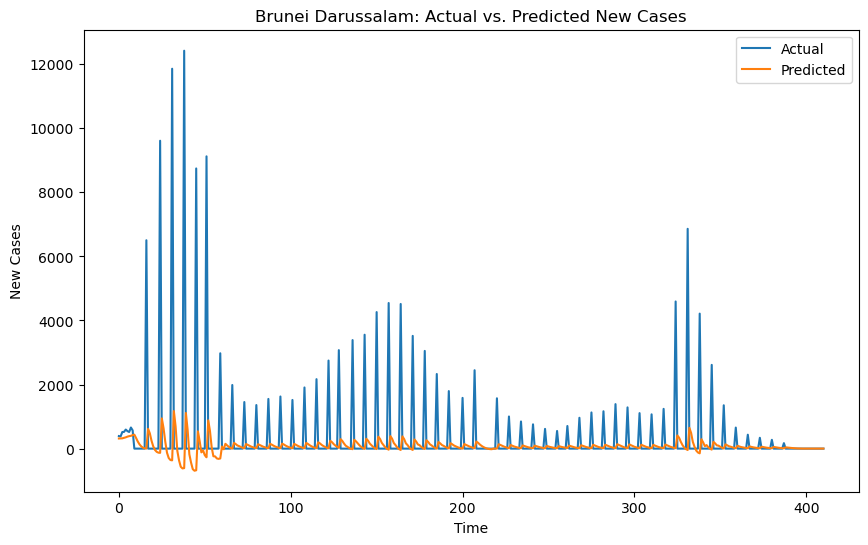

Epoch 1/50
22/22 - 0s - loss: 0.0152 - val_loss: 0.0871 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0152 - val_loss: 0.0869 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0148 - val_loss: 0.0860 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0146 - val_loss: 0.0819 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0141 - val_loss: 0.0783 - 44ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0133 - val_loss: 0.0734 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0125 - val_loss: 0.0697 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0115 - val_loss: 0.0767 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0111 - val_loss: 0.0612 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0106 - val_loss: 0.0536 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0091 - val_loss: 0.0727 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0079 - val_loss: 0.1831 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

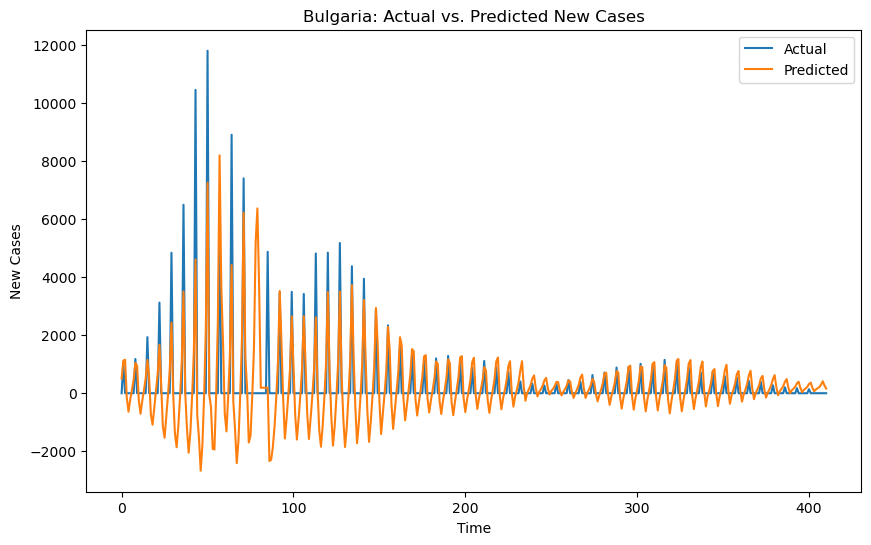

Epoch 1/50
22/22 - 0s - loss: 0.0181 - val_loss: 0.0922 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0135 - val_loss: 0.0894 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0107 - val_loss: 0.0886 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0089 - val_loss: 0.0940 - 36ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0097 - val_loss: 0.0906 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0094 - val_loss: 0.0895 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0091 - val_loss: 0.0913 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0092 - val_loss: 0.0911 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0090 - val_loss: 0.0900 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0090 - val_loss: 0.0899 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0089 - val_loss: 0.0894 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0091 - val_loss: 0.0909 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

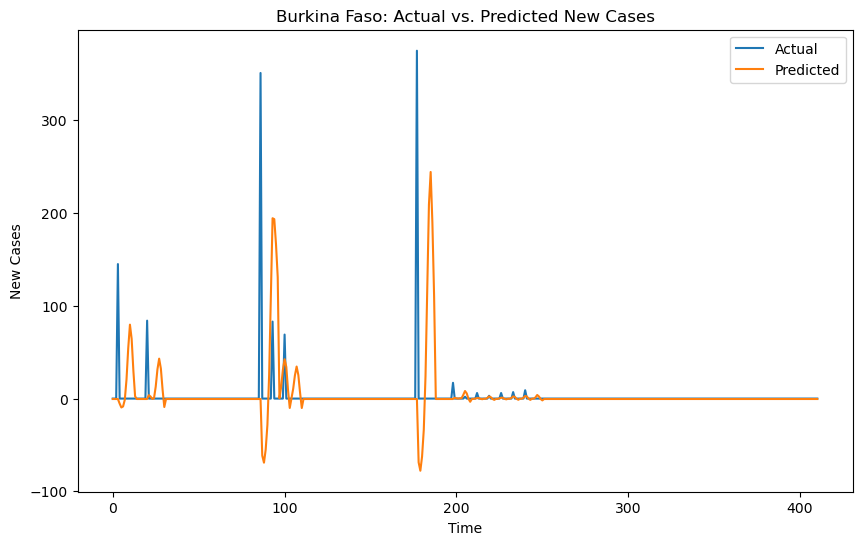

Epoch 1/50
22/22 - 0s - loss: 0.0088 - val_loss: 0.1452 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0055 - val_loss: 0.1355 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.1951 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0043 - val_loss: 0.1447 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.1518 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.1432 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.1338 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.1289 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.1248 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.1253 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.1233 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.1231 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

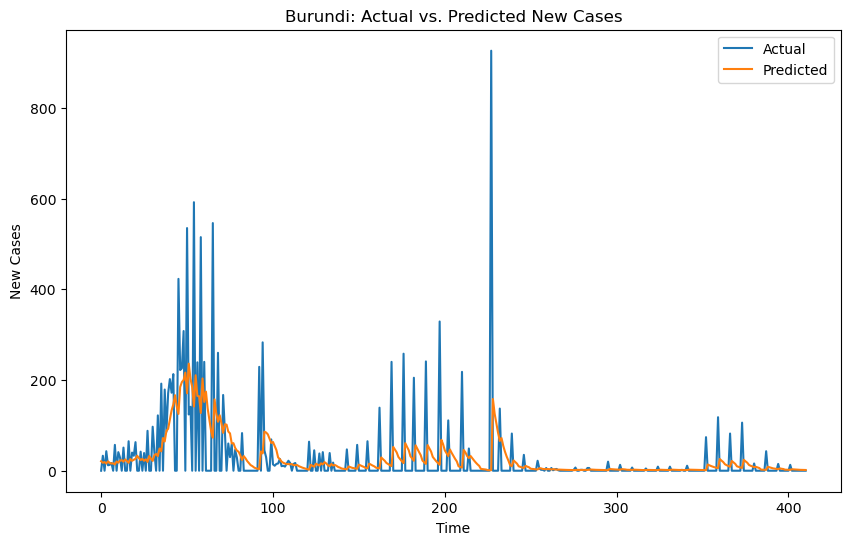

Epoch 1/50
22/22 - 0s - loss: 0.0193 - val_loss: 0.1965 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0087 - val_loss: 0.3911 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0059 - val_loss: 3.4875 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0062 - val_loss: 1.1829 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.7953 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.8907 - 38ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.8607 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.5254 - 38ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.5235 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.5143 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0057 - val_loss: 0.4045 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0057 - val_loss: 0.5351 - 38ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

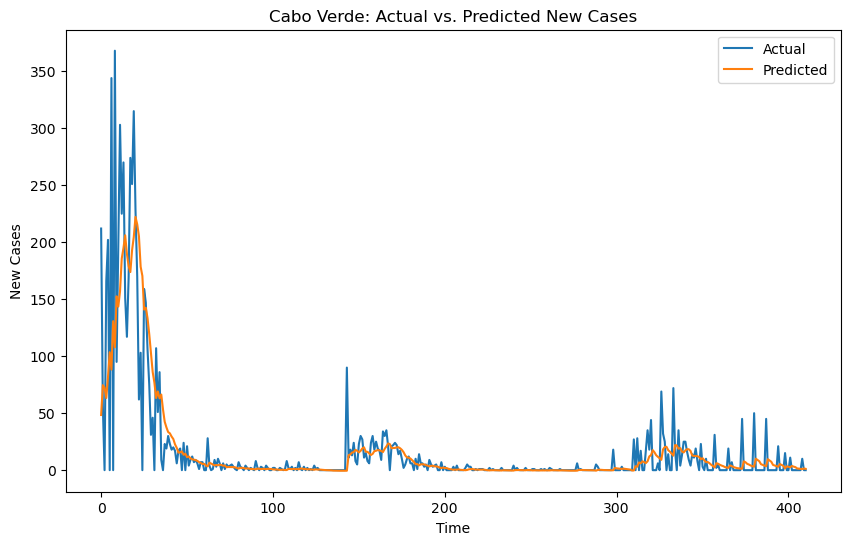

Epoch 1/50
22/22 - 0s - loss: 0.0291 - val_loss: 0.0085 - 385ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0081 - val_loss: 0.0038 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0057 - val_loss: 0.0035 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.0033 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0053 - val_loss: 0.0032 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0050 - val_loss: 0.0032 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.0031 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0047 - val_loss: 0.0030 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0048 - val_loss: 0.0031 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.0030 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.0030 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0044 - val_loss: 0.0027 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

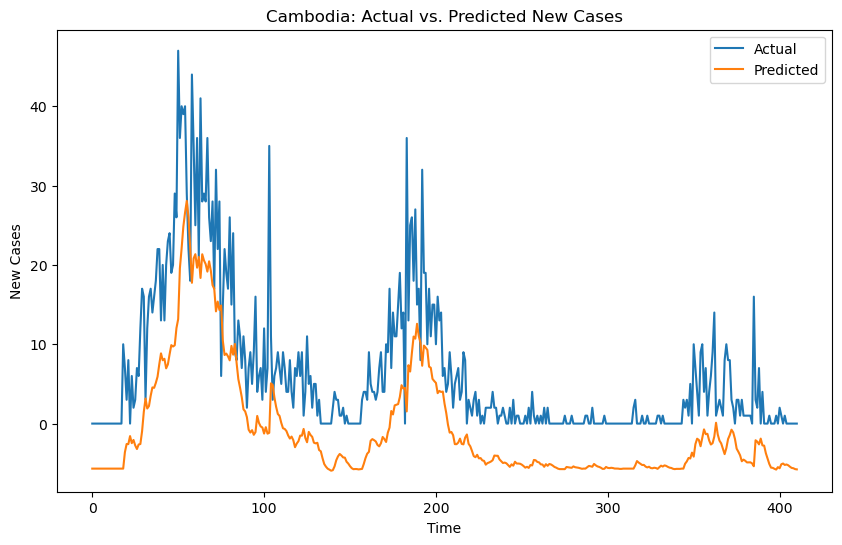

Epoch 1/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.0017 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.0018 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0055 - val_loss: 0.0015 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.0015 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.0016 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0053 - val_loss: 0.0016 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0052 - val_loss: 0.0015 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0051 - val_loss: 0.0015 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0050 - val_loss: 0.0014 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0050 - val_loss: 0.0014 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0051 - val_loss: 0.0018 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.0014 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

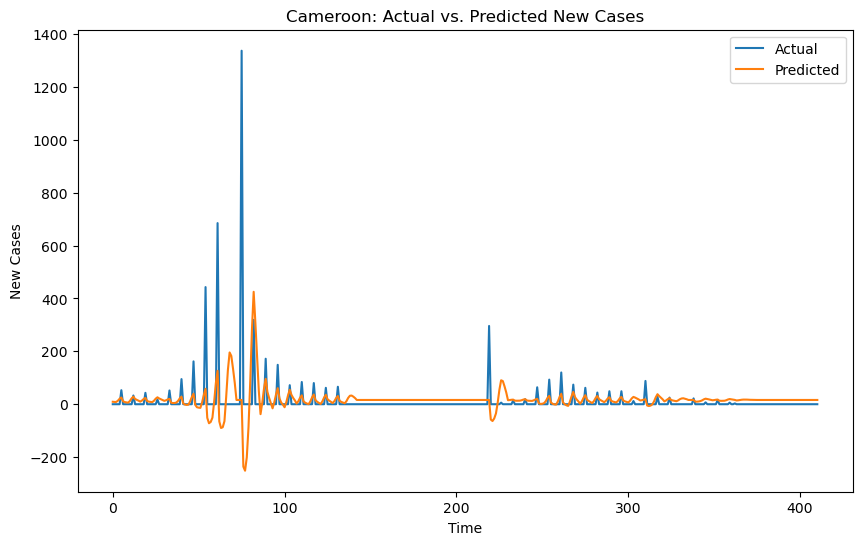

Epoch 1/50
22/22 - 0s - loss: 0.0925 - val_loss: 1.2925 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0195 - val_loss: 35.6221 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0038 - val_loss: 24.4121 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0032 - val_loss: 16.1083 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0030 - val_loss: 9.8314 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0029 - val_loss: 7.8659 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0029 - val_loss: 4.4160 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0028 - val_loss: 2.1580 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0028 - val_loss: 1.1801 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0028 - val_loss: 1.2849 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.8955 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.6852 - 38ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0

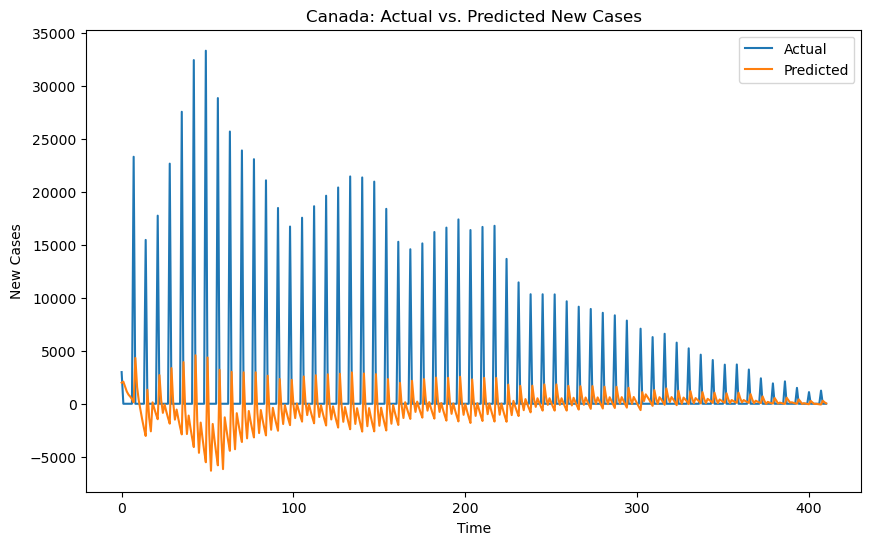

Epoch 1/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.1449 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0061 - val_loss: 0.1396 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0056 - val_loss: 0.1383 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0051 - val_loss: 0.1392 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.1400 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.1421 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.1405 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0048 - val_loss: 0.1414 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0047 - val_loss: 0.1426 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0047 - val_loss: 0.1455 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0047 - val_loss: 0.1415 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.1461 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

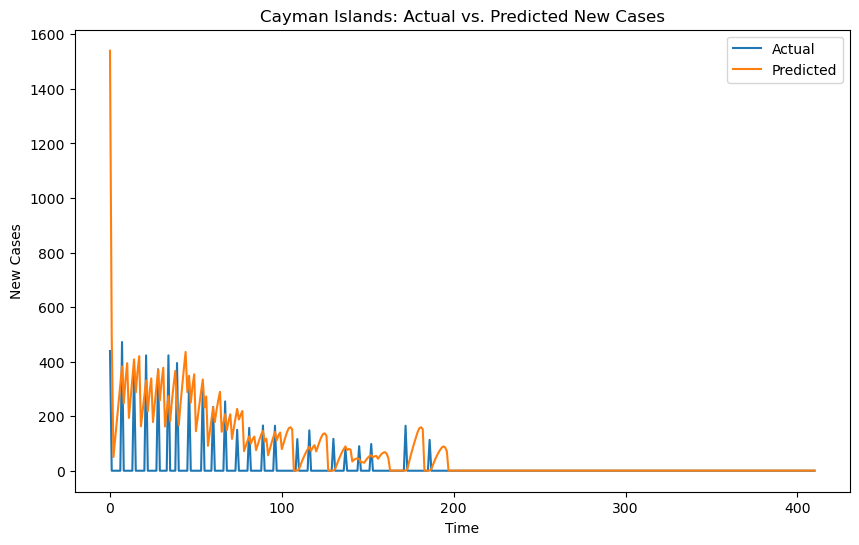

Epoch 1/50
22/22 - 0s - loss: 0.0166 - val_loss: 0.0238 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0109 - val_loss: 0.0228 - 40ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0081 - val_loss: 0.0228 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0078 - val_loss: 0.0228 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0075 - val_loss: 0.0226 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0075 - val_loss: 0.0224 - 38ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0075 - val_loss: 0.0225 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.0226 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.0225 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.0225 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0073 - val_loss: 0.0226 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0072 - val_loss: 0.0226 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

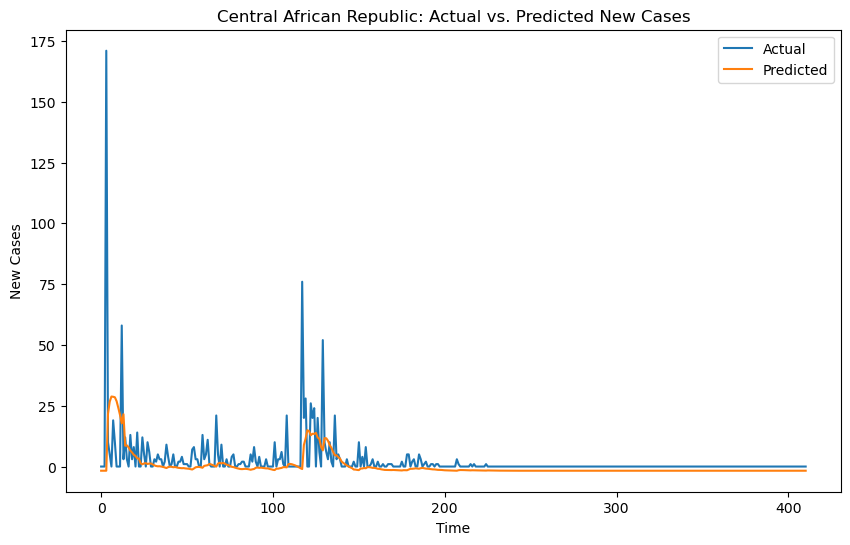

Epoch 1/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0087 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0087 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0087 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0087 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0087 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0088 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0087 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0087 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0088 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0088 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0089 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0090 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

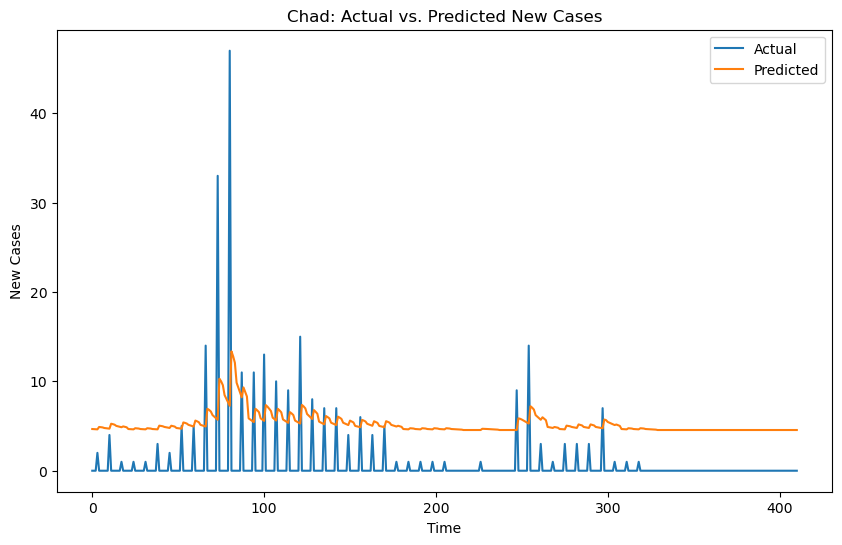

Epoch 1/50
22/22 - 0s - loss: 0.0033 - val_loss: 0.0436 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0166 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0127 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0134 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0147 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0184 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0182 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0194 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0207 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0207 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0245 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0272 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

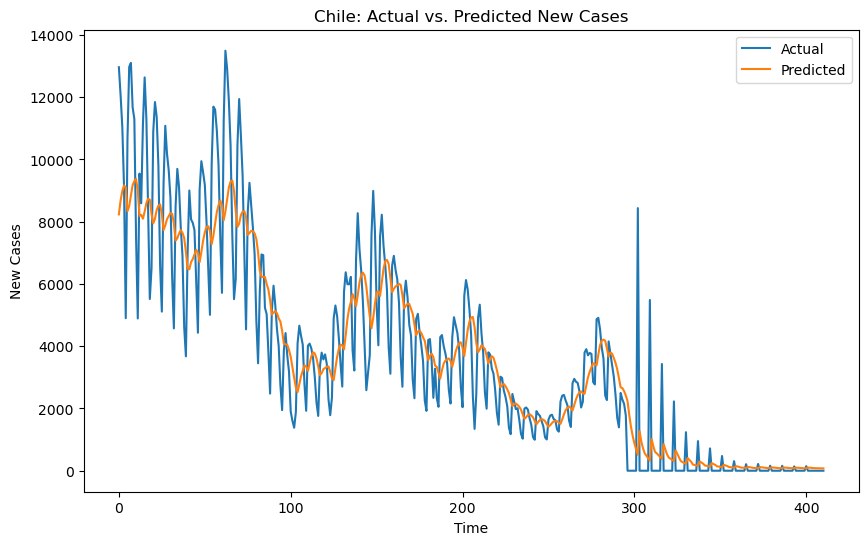

Epoch 1/50
22/22 - 0s - loss: 0.0019 - val_loss: 2.3072 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0016 - val_loss: 1.0943 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0014 - val_loss: 0.6268 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0013 - val_loss: 0.7643 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0013 - val_loss: 2.5887 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0013 - val_loss: 0.6282 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0013 - val_loss: 0.5519 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0012 - val_loss: 0.5625 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0012 - val_loss: 1.7671 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0013 - val_loss: 0.7211 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0012 - val_loss: 2.2272 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0012 - val_loss: 3.4264 - 38ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

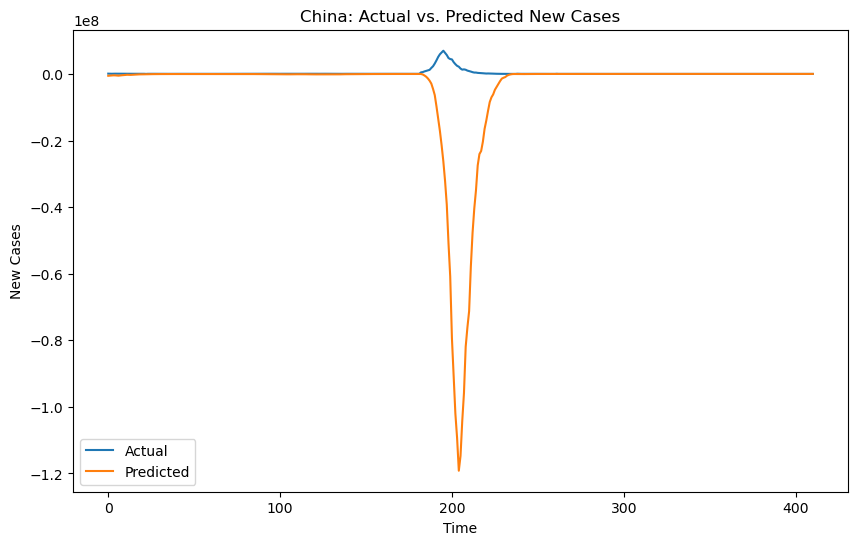

Epoch 1/50
22/22 - 0s - loss: 0.0818 - val_loss: 0.0577 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0195 - val_loss: 0.0155 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0124 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.0103 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0101 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0097 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0097 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0093 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0090 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0088 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0087 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0084 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

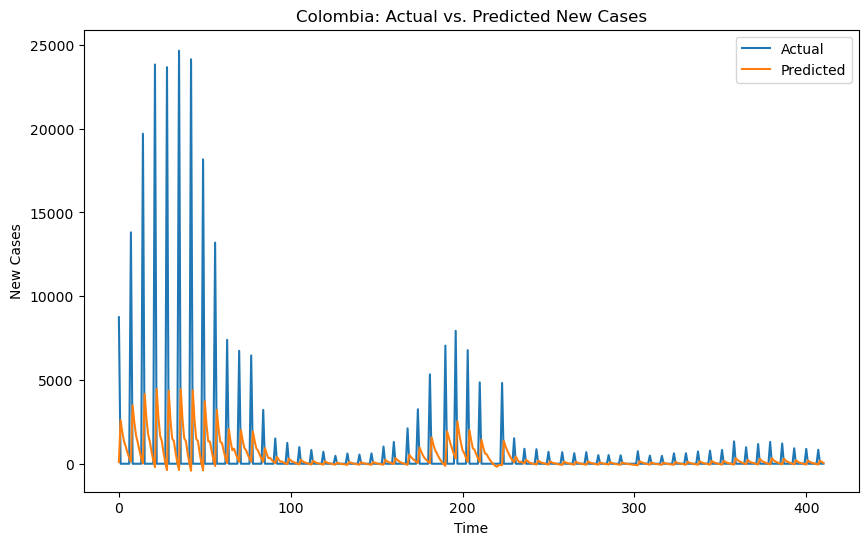

Epoch 1/50
22/22 - 0s - loss: 0.0080 - val_loss: 0.0466 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0064 - val_loss: 0.0324 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.0376 - 36ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.0342 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0053 - val_loss: 0.0348 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0053 - val_loss: 0.0359 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0052 - val_loss: 0.0324 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0052 - val_loss: 0.0335 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0053 - val_loss: 0.0330 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0053 - val_loss: 0.0334 - 38ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0053 - val_loss: 0.0332 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0053 - val_loss: 0.0335 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

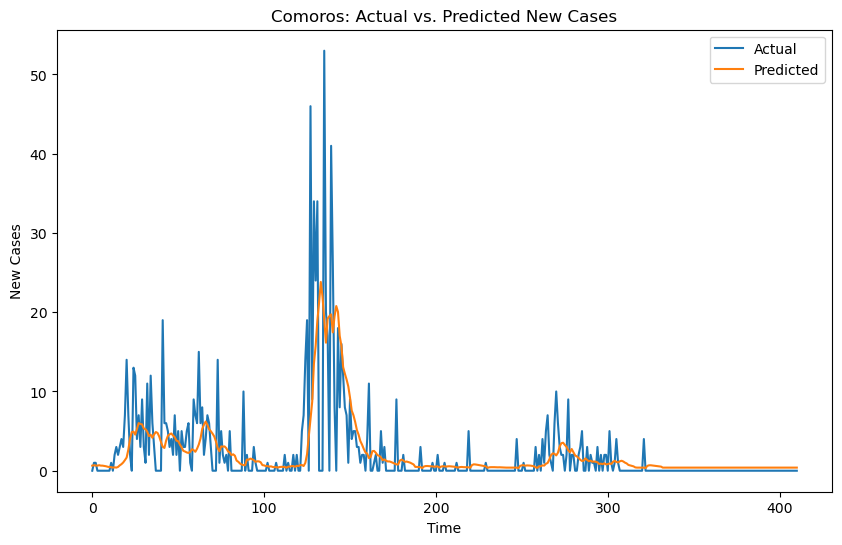

Epoch 1/50
22/22 - 0s - loss: 0.0125 - val_loss: 0.0252 - 392ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0125 - val_loss: 0.0249 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0123 - val_loss: 0.0244 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0122 - val_loss: 0.0238 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0122 - val_loss: 0.0237 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0120 - val_loss: 0.0230 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0118 - val_loss: 0.0226 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0119 - val_loss: 0.0223 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0118 - val_loss: 0.0221 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0117 - val_loss: 0.0218 - 38ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0116 - val_loss: 0.0216 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0117 - val_loss: 0.0216 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.01

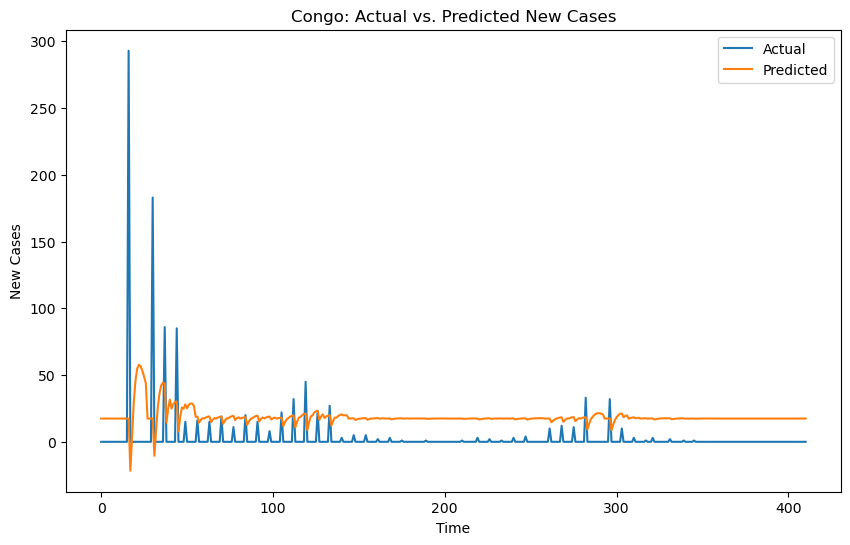

Epoch 1/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 9151.2354 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 9151.2354 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 9151.2354 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 9151.2354 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 9151.2354 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 9151.2354 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 9151.2354 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 9151.2354 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 9151.2354 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 9151.2354 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 9151.2354 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0000e+

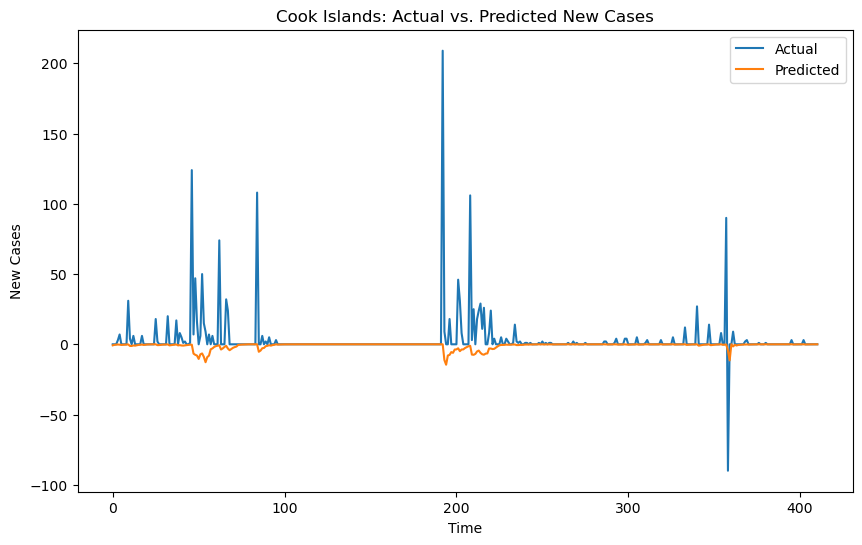

Epoch 1/50
22/22 - 0s - loss: 0.1021 - val_loss: 0.5681 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0243 - val_loss: 0.5794 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0111 - val_loss: 1.3413 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0104 - val_loss: 0.6912 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0099 - val_loss: 0.5217 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0096 - val_loss: 0.5183 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0095 - val_loss: 0.4834 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0093 - val_loss: 0.4440 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0094 - val_loss: 0.4066 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0095 - val_loss: 0.4098 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0093 - val_loss: 0.4152 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0093 - val_loss: 0.3910 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

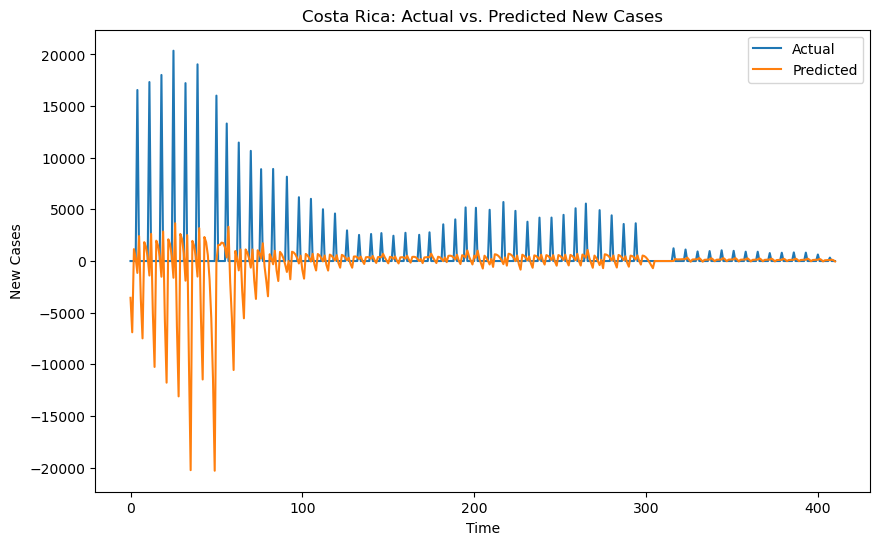

Epoch 1/50
22/22 - 0s - loss: 0.0254 - val_loss: 0.1579 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0153 - val_loss: 0.1385 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0127 - val_loss: 0.2001 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0110 - val_loss: 0.2927 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0111 - val_loss: 0.2262 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0113 - val_loss: 0.1999 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0108 - val_loss: 0.1921 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0108 - val_loss: 0.1836 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0108 - val_loss: 0.1664 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0109 - val_loss: 0.1574 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0109 - val_loss: 0.1492 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0107 - val_loss: 0.1607 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.01

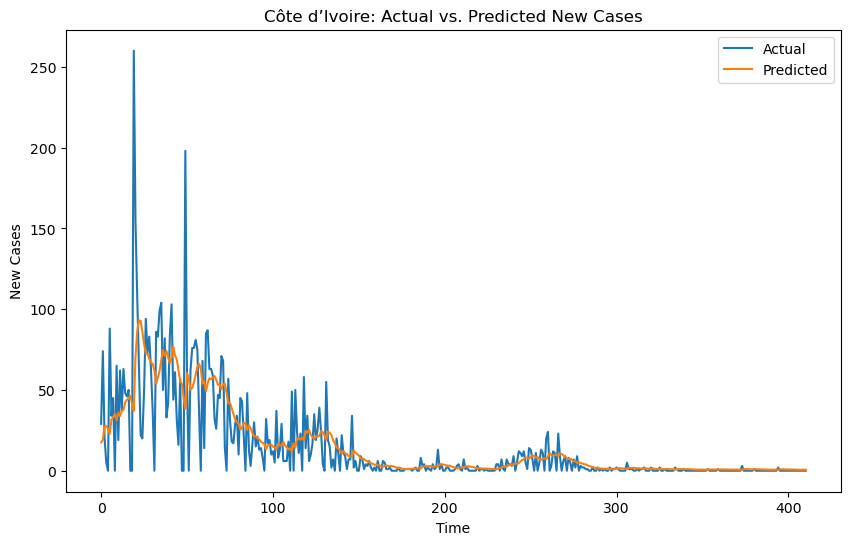

Epoch 1/50
22/22 - 0s - loss: 0.0247 - val_loss: 0.0938 - 385ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0124 - val_loss: 0.0667 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0099 - val_loss: 0.0833 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0090 - val_loss: 0.0813 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0086 - val_loss: 0.0700 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0086 - val_loss: 0.0708 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0085 - val_loss: 0.0702 - 42ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0084 - val_loss: 0.0652 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0087 - val_loss: 0.0643 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0087 - val_loss: 0.0642 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0086 - val_loss: 0.0644 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0086 - val_loss: 0.0672 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

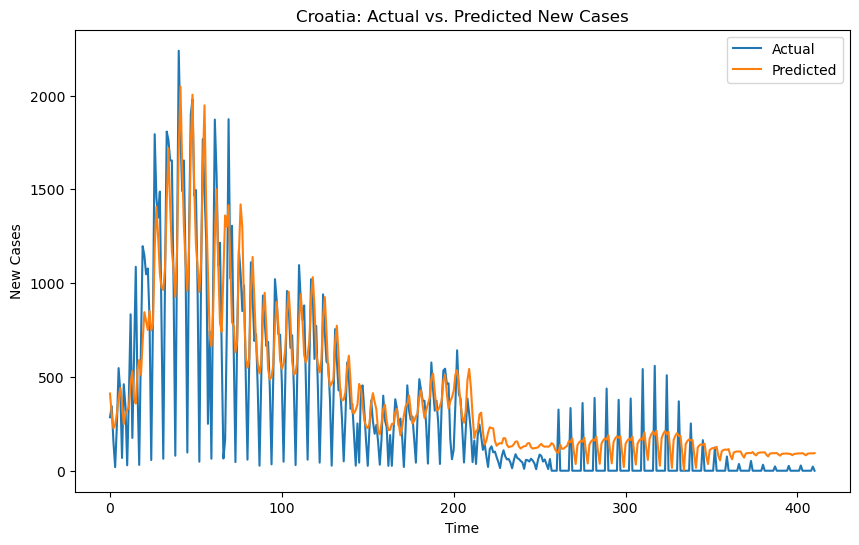

Epoch 1/50
22/22 - 0s - loss: 0.0432 - val_loss: 0.0086 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0076 - val_loss: 0.0047 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.0042 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0040 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0041 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0021 - val_loss: 0.0039 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0039 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0039 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0037 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0037 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0036 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0040 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

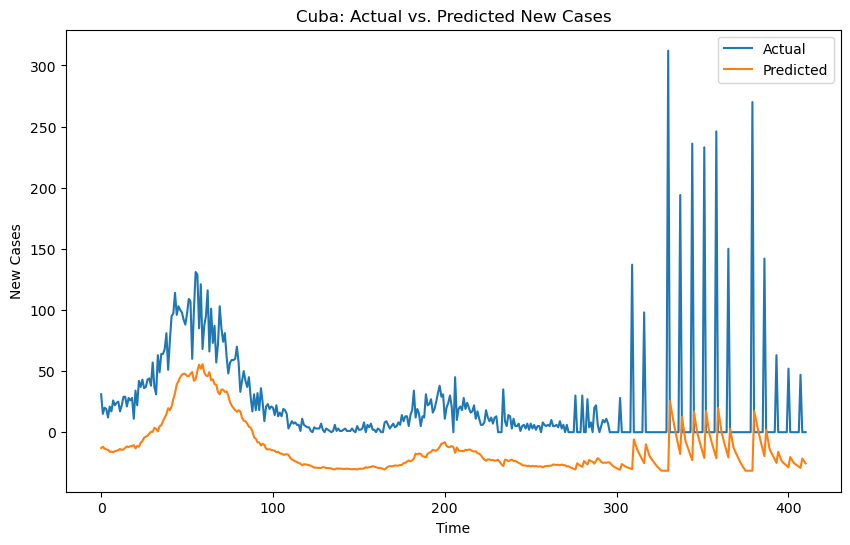

Epoch 1/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.0798 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0708 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0036 - val_loss: 0.0676 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0664 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0663 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0658 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0651 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0655 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0033 - val_loss: 0.0651 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0641 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0033 - val_loss: 0.0640 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0033 - val_loss: 0.0636 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

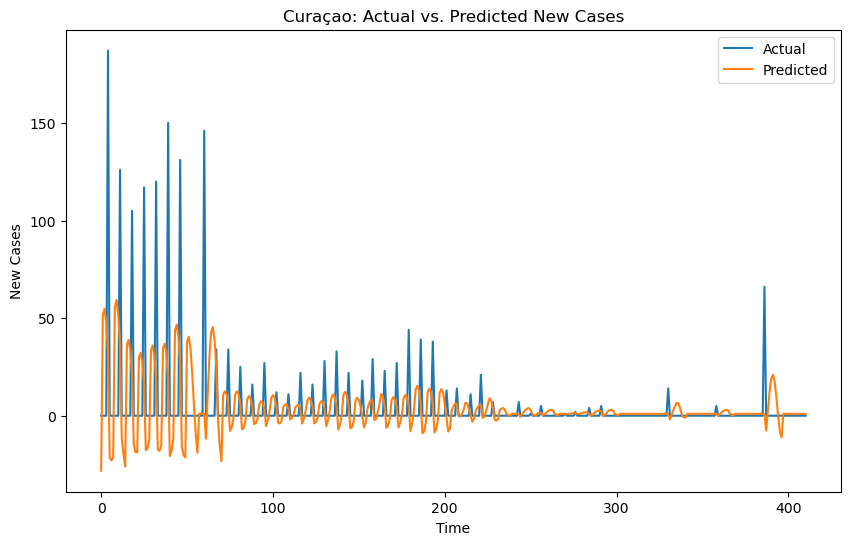

Epoch 1/50
22/22 - 0s - loss: 0.0661 - val_loss: 3.7821 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0278 - val_loss: 2.4689 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0156 - val_loss: 95.9535 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0101 - val_loss: 244.6983 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0092 - val_loss: 99.8240 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0084 - val_loss: 70.6568 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0078 - val_loss: 79.9183 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0074 - val_loss: 33.2035 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0071 - val_loss: 29.6083 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0071 - val_loss: 17.7165 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0068 - val_loss: 5.9743 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0066 - val_loss: 5.9858 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - l

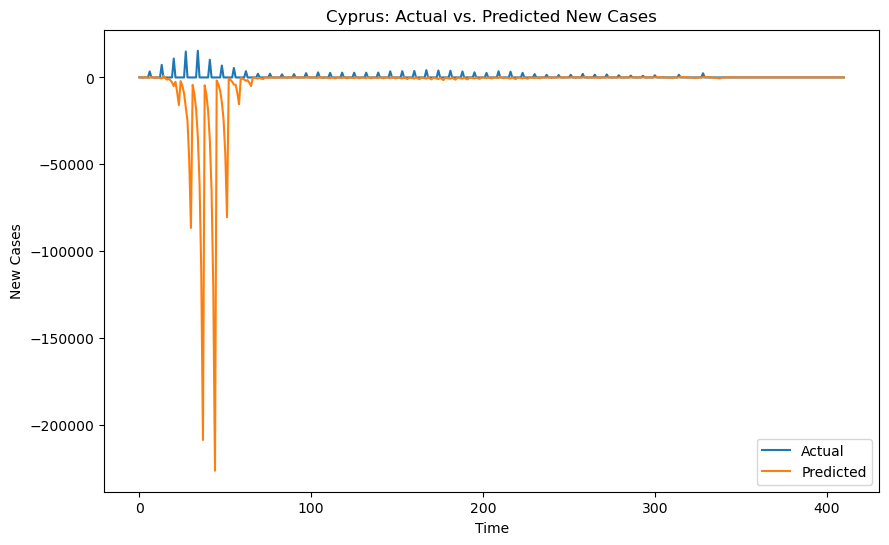

Epoch 1/50
22/22 - 0s - loss: 0.0240 - val_loss: 0.1213 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0098 - val_loss: 0.1011 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0067 - val_loss: 0.0917 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0066 - val_loss: 0.0780 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0065 - val_loss: 0.0802 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0067 - val_loss: 0.0875 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.0748 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0065 - val_loss: 0.0671 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0064 - val_loss: 0.0661 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0063 - val_loss: 0.0689 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0062 - val_loss: 0.0654 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0062 - val_loss: 0.0649 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

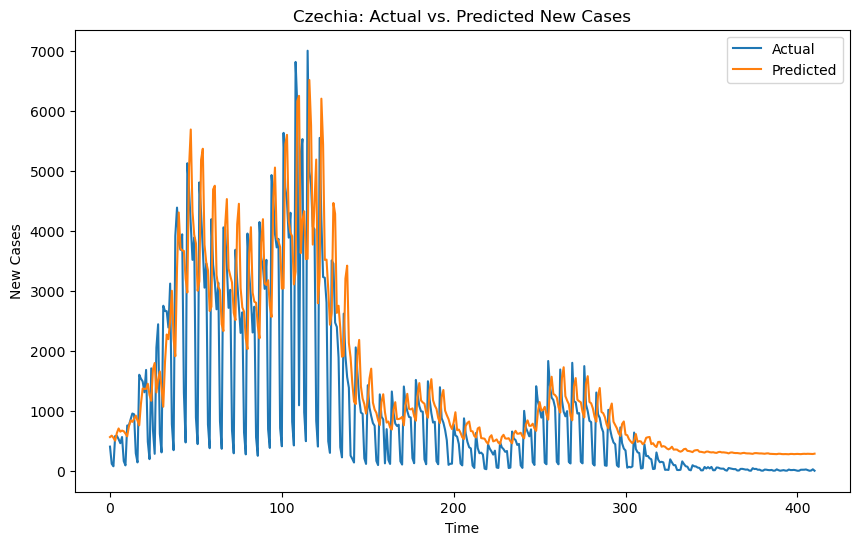

Epoch 1/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 42ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - los

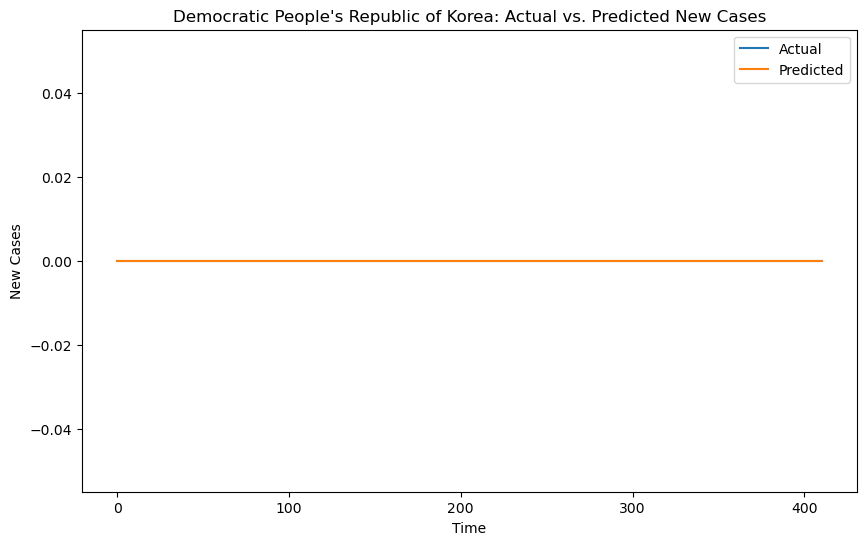

Epoch 1/50
22/22 - 0s - loss: 0.0359 - val_loss: 0.1064 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0190 - val_loss: 0.0571 - 40ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0148 - val_loss: 0.2336 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0133 - val_loss: 0.6520 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0130 - val_loss: 0.3328 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0131 - val_loss: 0.2802 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0131 - val_loss: 0.3522 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0132 - val_loss: 0.2139 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0130 - val_loss: 0.2611 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0130 - val_loss: 0.3187 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0130 - val_loss: 0.1955 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0128 - val_loss: 0.1910 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.01

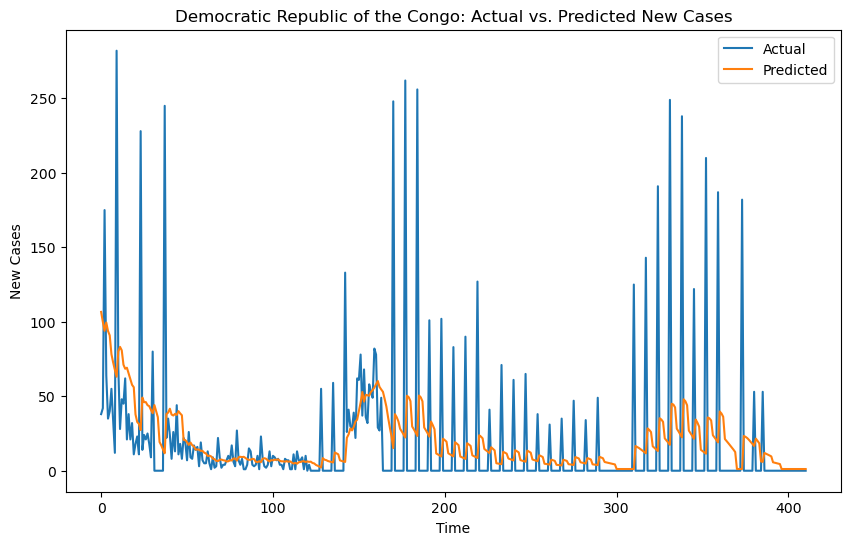

Epoch 1/50
22/22 - 0s - loss: 0.0260 - val_loss: 76.9405 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0055 - val_loss: 5348.6357 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0035 - val_loss: 4663.5635 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0030 - val_loss: 3450.1326 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0028 - val_loss: 2099.1567 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0027 - val_loss: 1240.9048 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0026 - val_loss: 842.6495 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0026 - val_loss: 423.7010 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0026 - val_loss: 261.2440 - 38ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0026 - val_loss: 129.5689 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0025 - val_loss: 95.4124 - 45ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0024 - val_loss: 63.8807 - 40ms/epoch - 2ms/step
Epoch 13/

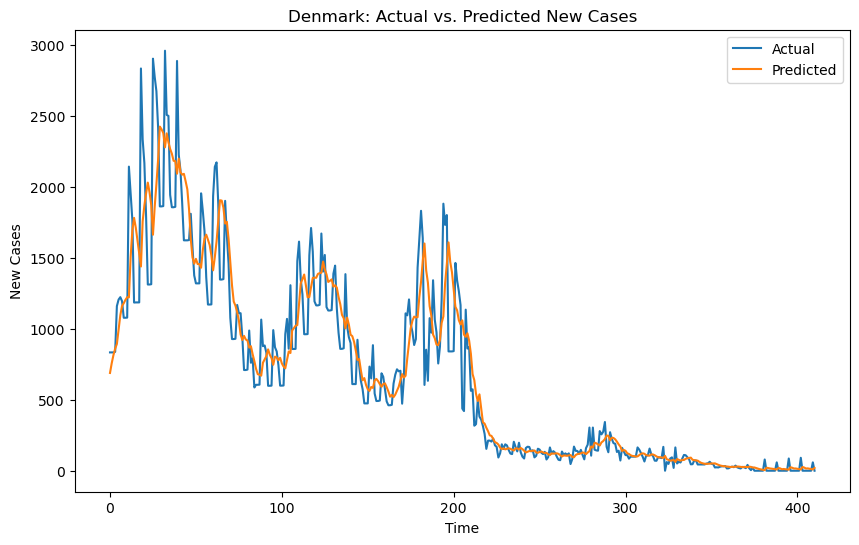

Epoch 1/50
22/22 - 0s - loss: 0.0206 - val_loss: 0.0065 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0131 - val_loss: 0.0039 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0096 - val_loss: 0.0038 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0093 - val_loss: 0.0033 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0093 - val_loss: 0.0032 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0090 - val_loss: 0.0032 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0089 - val_loss: 0.0032 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0088 - val_loss: 0.0030 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0086 - val_loss: 0.0031 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0087 - val_loss: 0.0030 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0088 - val_loss: 0.0031 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0086 - val_loss: 0.0031 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

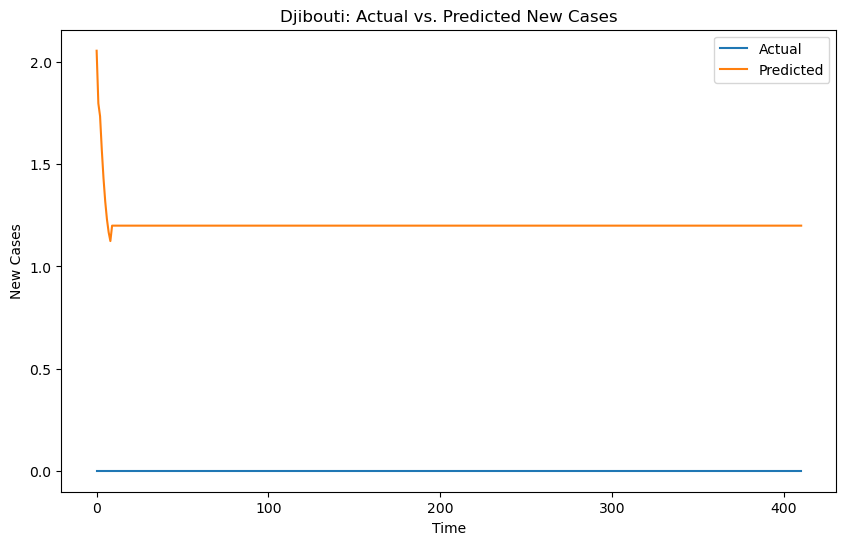

Epoch 1/50
22/22 - 0s - loss: 0.0081 - val_loss: 0.0701 - 385ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0076 - val_loss: 0.0680 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.0674 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0073 - val_loss: 0.0663 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0072 - val_loss: 0.0658 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0072 - val_loss: 0.0652 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0071 - val_loss: 0.0646 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0071 - val_loss: 0.0646 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0072 - val_loss: 0.0655 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0071 - val_loss: 0.0643 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0071 - val_loss: 0.0637 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0070 - val_loss: 0.0636 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

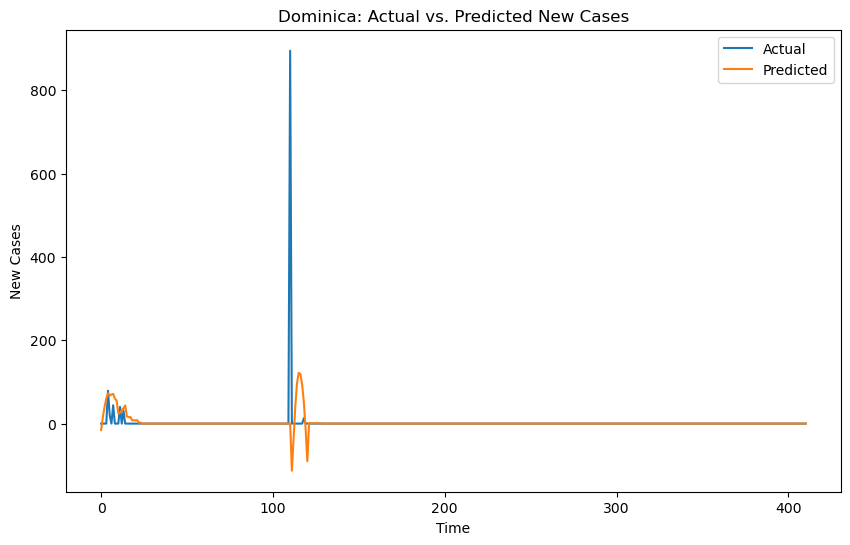

Epoch 1/50
22/22 - 0s - loss: 0.0359 - val_loss: 0.1683 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0139 - val_loss: 0.1642 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0116 - val_loss: 0.6217 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0106 - val_loss: 1.0520 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0105 - val_loss: 1.4255 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0105 - val_loss: 0.8990 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0103 - val_loss: 0.4978 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0104 - val_loss: 0.6044 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0102 - val_loss: 0.5505 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0106 - val_loss: 0.3819 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0101 - val_loss: 0.4377 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0103 - val_loss: 0.4128 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.01

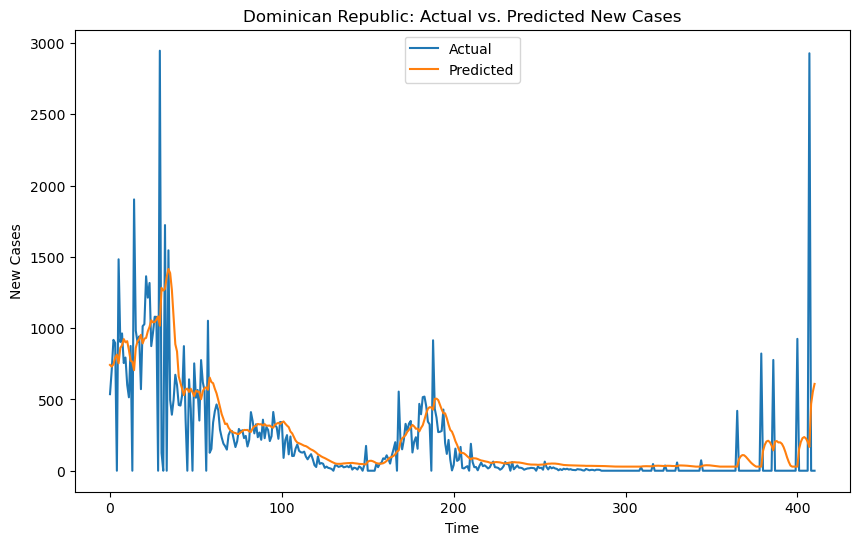

Epoch 1/50
22/22 - 0s - loss: 0.1286 - val_loss: 0.0747 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0126 - val_loss: 0.0076 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0079 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0079 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0075 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0077 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0077 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0076 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0075 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0074 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0076 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0078 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

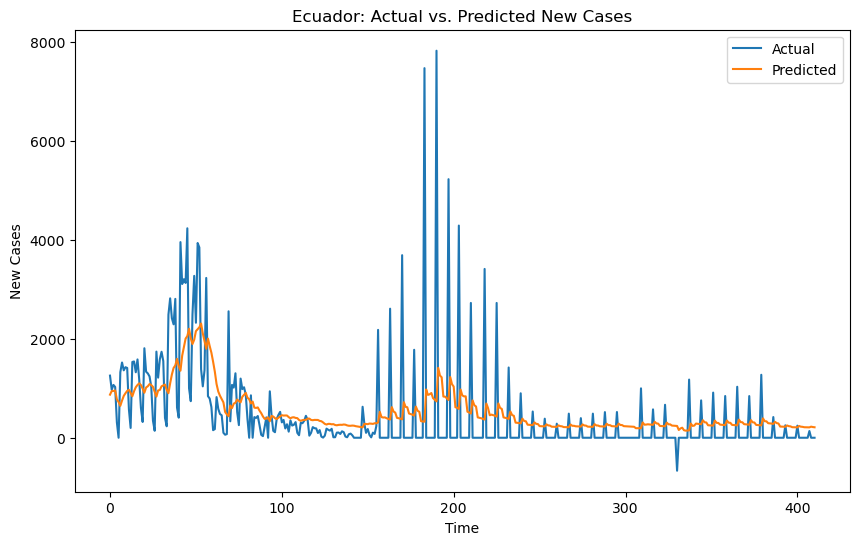

Epoch 1/50
22/22 - 0s - loss: 0.0985 - val_loss: 0.2802 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0180 - val_loss: 0.1532 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.1581 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0033 - val_loss: 0.1503 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.1506 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.1507 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.1496 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.1508 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.1515 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0021 - val_loss: 0.1518 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0021 - val_loss: 0.1520 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.1533 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

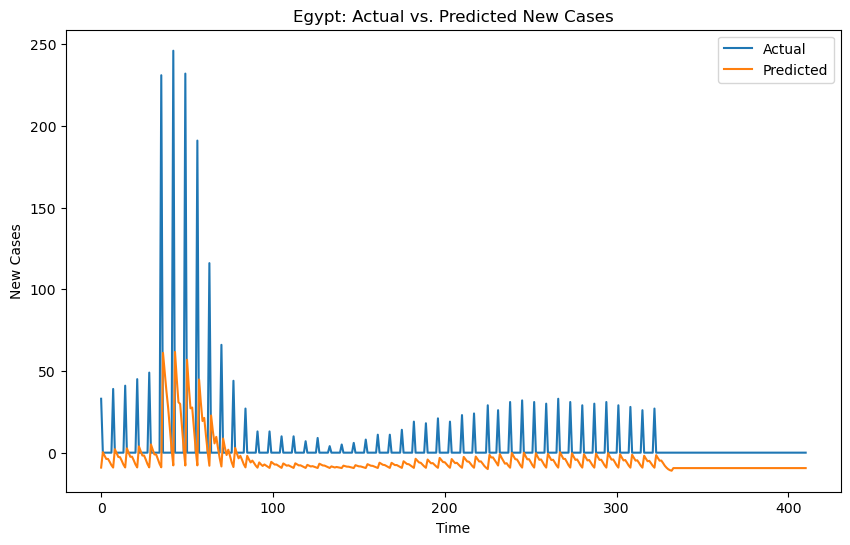

Epoch 1/50
22/22 - 0s - loss: 0.0141 - val_loss: 0.2031 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0131 - val_loss: 0.2036 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0130 - val_loss: 0.2039 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0129 - val_loss: 0.2046 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0129 - val_loss: 0.2054 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0127 - val_loss: 0.2072 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0126 - val_loss: 0.2094 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0126 - val_loss: 0.2126 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0125 - val_loss: 0.2129 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0124 - val_loss: 0.2132 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0123 - val_loss: 0.2183 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0123 - val_loss: 0.2169 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.01

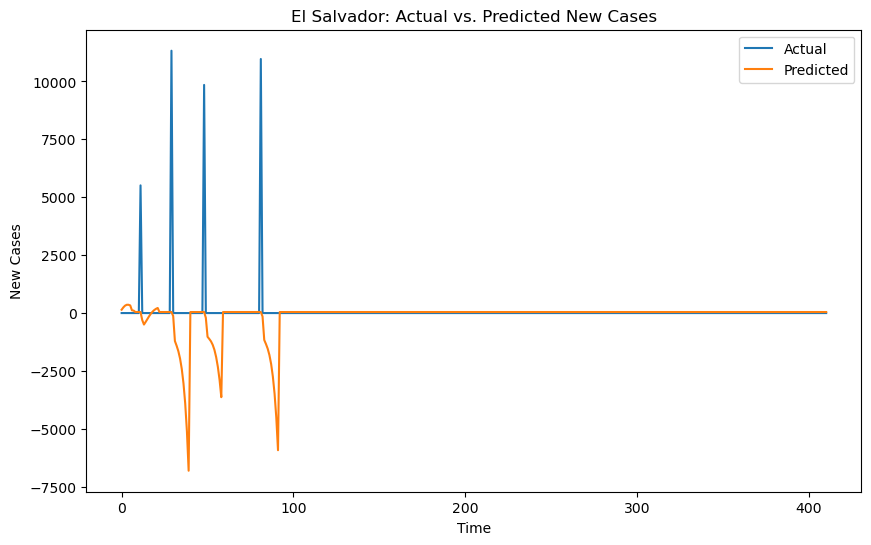

Epoch 1/50
22/22 - 0s - loss: 0.0051 - val_loss: 0.0079 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0047 - val_loss: 0.0078 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0047 - val_loss: 0.0077 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0047 - val_loss: 0.0076 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.0077 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.0076 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.0075 - 45ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.0075 - 49ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.0075 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.0074 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.0075 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0044 - val_loss: 0.0074 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

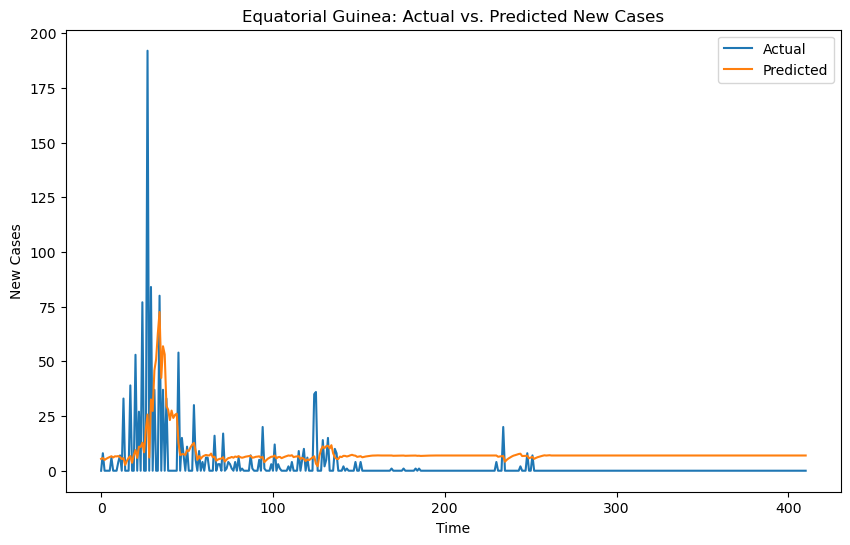

Epoch 1/50
22/22 - 0s - loss: 0.0089 - val_loss: 0.0059 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0078 - val_loss: 0.0046 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0073 - val_loss: 0.0036 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0070 - val_loss: 0.0036 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0070 - val_loss: 0.0034 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0070 - val_loss: 0.0034 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0070 - val_loss: 0.0036 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0072 - val_loss: 0.0035 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0070 - val_loss: 0.0034 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0069 - val_loss: 0.0034 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0069 - val_loss: 0.0034 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0069 - val_loss: 0.0035 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

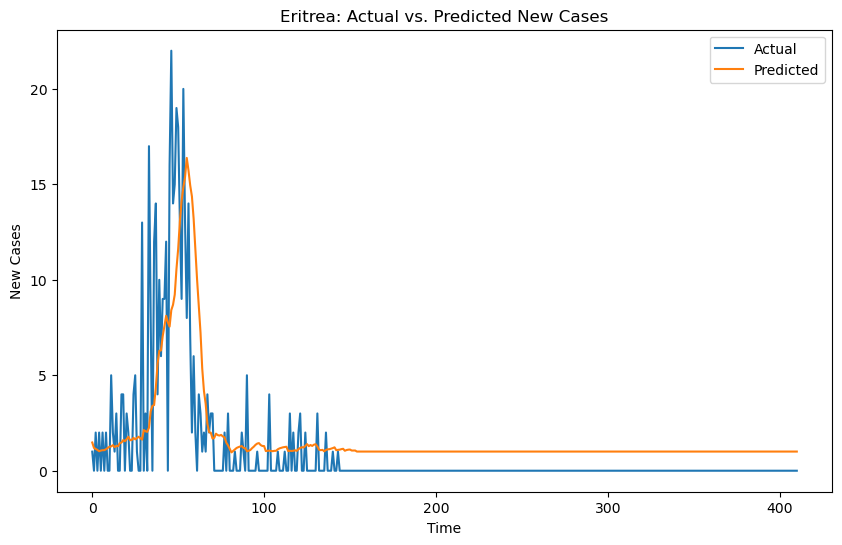

Epoch 1/50
22/22 - 0s - loss: 0.0118 - val_loss: 0.4028 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0116 - val_loss: 0.3986 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0114 - val_loss: 0.3980 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0112 - val_loss: 0.3869 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0110 - val_loss: 0.3752 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0108 - val_loss: 0.3587 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0105 - val_loss: 0.3364 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0103 - val_loss: 0.3141 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0099 - val_loss: 0.3183 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0097 - val_loss: 0.3767 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0095 - val_loss: 0.5299 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0091 - val_loss: 0.5605 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

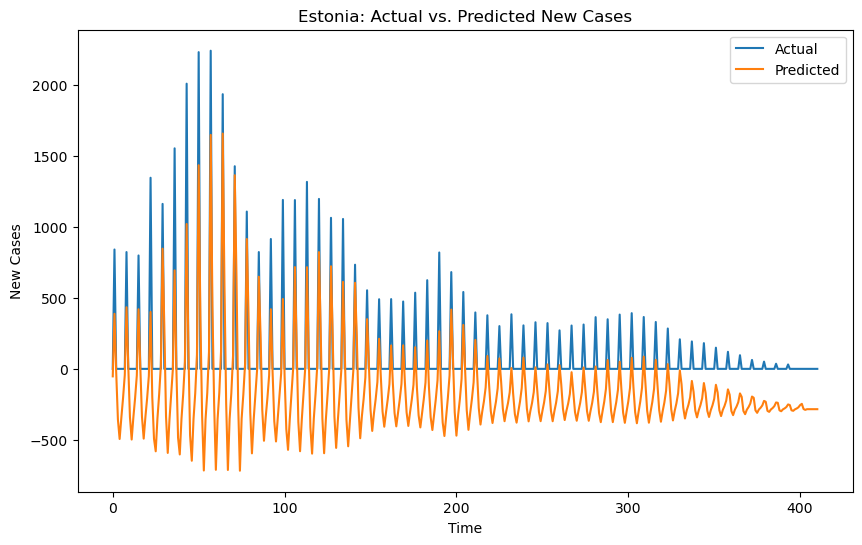

Epoch 1/50
22/22 - 0s - loss: 0.0142 - val_loss: 0.0158 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0072 - val_loss: 0.0191 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0202 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0055 - val_loss: 0.0118 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0150 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0057 - val_loss: 0.0132 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0057 - val_loss: 0.0128 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.0141 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0057 - val_loss: 0.0127 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0056 - val_loss: 0.0135 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.0116 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0056 - val_loss: 0.0121 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

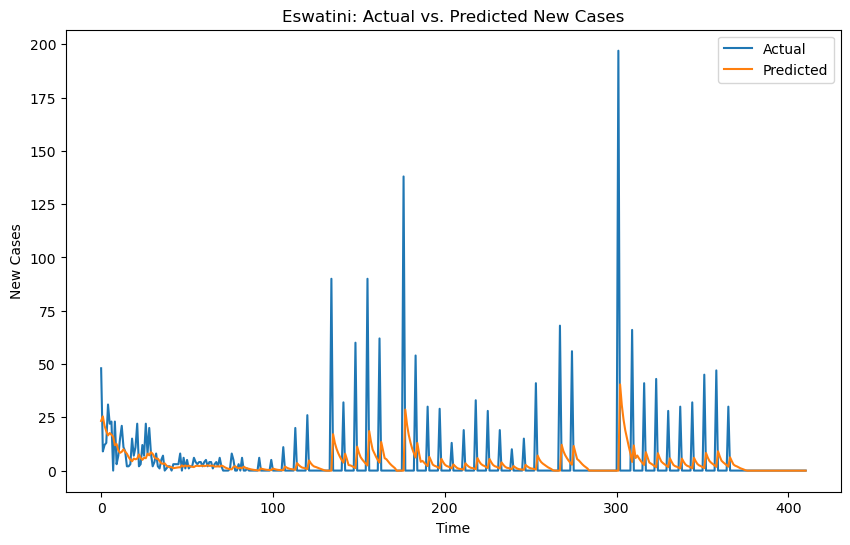

Epoch 1/50
22/22 - 0s - loss: 0.0537 - val_loss: 0.1108 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0096 - val_loss: 0.0894 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.0956 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0064 - val_loss: 0.0793 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0062 - val_loss: 0.0759 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0063 - val_loss: 0.0771 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0746 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0738 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.0705 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.0717 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.0687 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0057 - val_loss: 0.0689 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

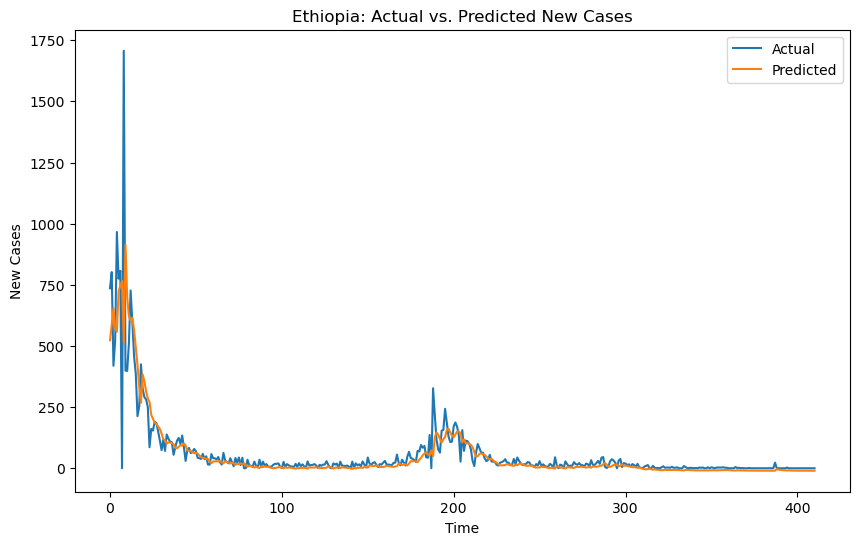

Epoch 1/50
22/22 - 0s - loss: 0.0058 - val_loss: 60.3408 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0058 - val_loss: 60.3613 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0057 - val_loss: 60.3293 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0057 - val_loss: 60.3370 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0057 - val_loss: 60.3268 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0057 - val_loss: 60.4726 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0057 - val_loss: 60.6461 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0057 - val_loss: 60.8280 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0057 - val_loss: 61.2386 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0057 - val_loss: 61.4571 - 38ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0057 - val_loss: 62.3018 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0057 - val_loss: 63.2185 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s 

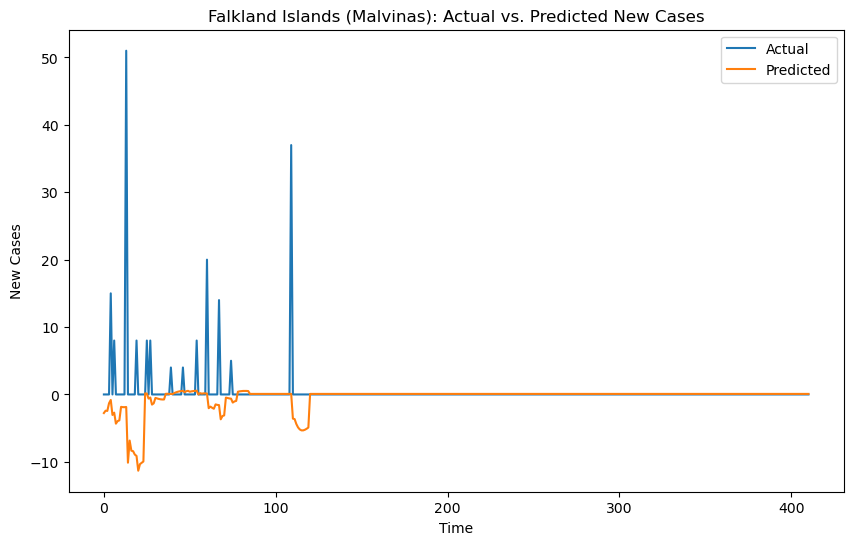

Epoch 1/50
22/22 - 0s - loss: 0.0135 - val_loss: 2.2627 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0090 - val_loss: 505.3766 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0051 - val_loss: 9298.7520 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0044 - val_loss: 3295.1960 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0041 - val_loss: 2269.0715 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0040 - val_loss: 1204.9537 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0042 - val_loss: 609.9863 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0038 - val_loss: 450.3148 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0036 - val_loss: 203.5007 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0035 - val_loss: 129.5237 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0036 - val_loss: 29.3198 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0034 - val_loss: 20.4809 - 40ms/epoch - 2ms/step
Epoch 13/50

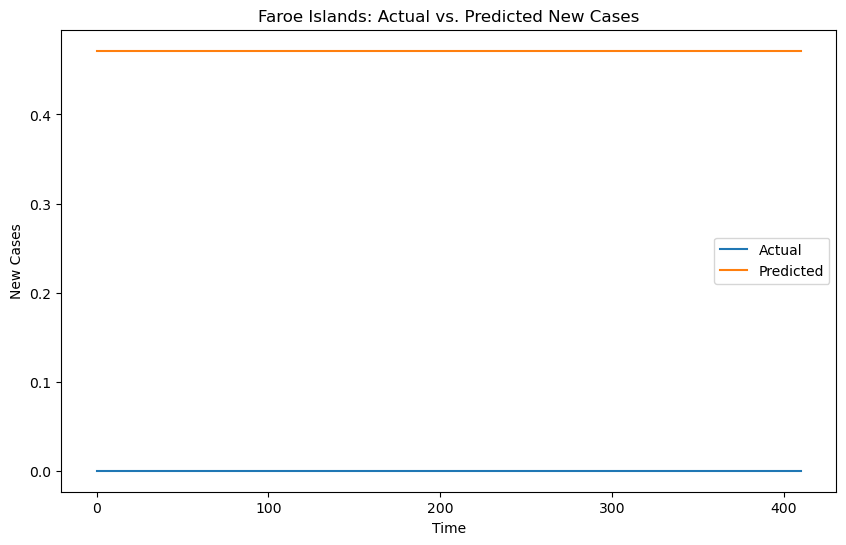

Epoch 1/50
22/22 - 0s - loss: 0.0227 - val_loss: 0.0118 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0107 - val_loss: 0.0090 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.0095 - 43ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.0092 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0033 - val_loss: 0.0094 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.0093 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.0094 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.0094 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.0094 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.0095 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.0094 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.0094 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

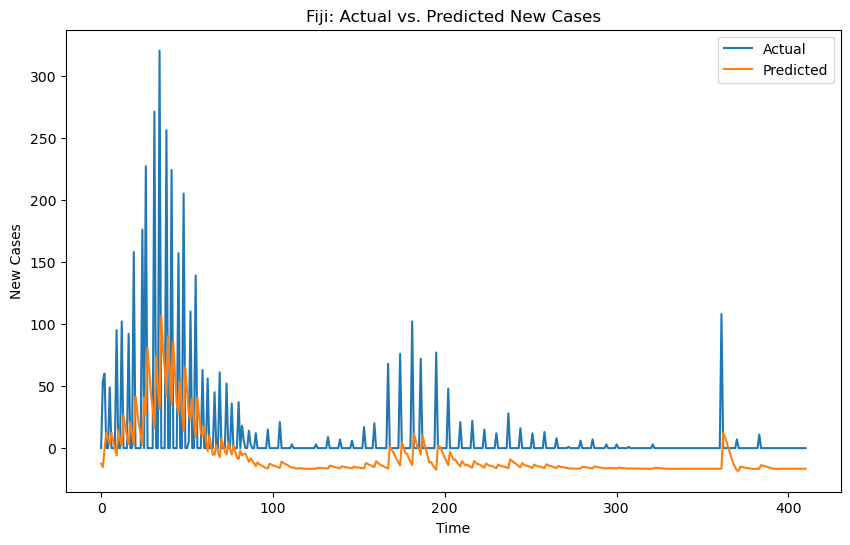

Epoch 1/50
22/22 - 0s - loss: 0.0385 - val_loss: 3.2173 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0113 - val_loss: 74.8745 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0060 - val_loss: 1510.8682 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0046 - val_loss: 1388.3948 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0044 - val_loss: 1022.9474 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0044 - val_loss: 984.2108 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0045 - val_loss: 854.6260 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0044 - val_loss: 660.4932 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0043 - val_loss: 729.3526 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0043 - val_loss: 547.5901 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0043 - val_loss: 558.1619 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0044 - val_loss: 586.4160 - 41ms/epoch - 2ms/step
Epoch 13/50

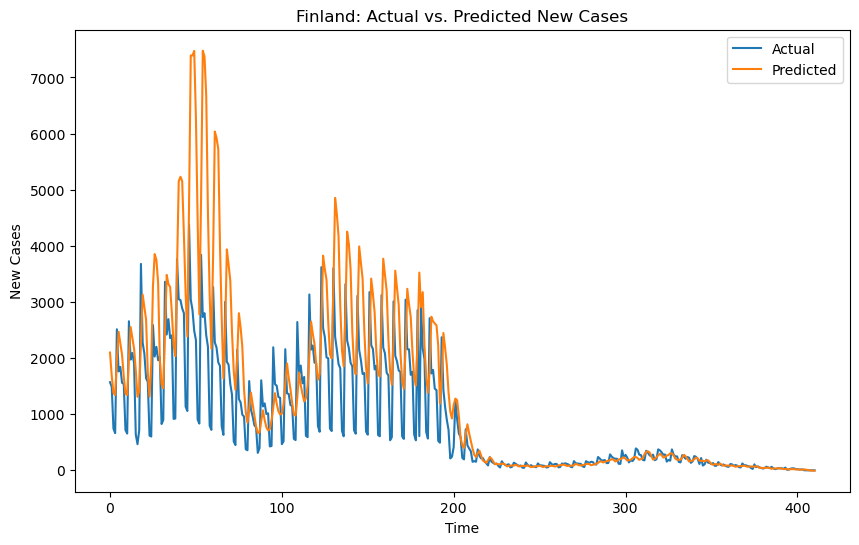

Epoch 1/50
22/22 - 0s - loss: 0.0142 - val_loss: 1.5108 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0139 - val_loss: 1.5057 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0137 - val_loss: 1.4655 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0133 - val_loss: 1.3970 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0129 - val_loss: 1.2840 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0122 - val_loss: 63.9668 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0116 - val_loss: 376.1399 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0107 - val_loss: 1799.4919 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0097 - val_loss: 3597.9646 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0089 - val_loss: 5311.6587 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0082 - val_loss: 4542.7671 - 38ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0082 - val_loss: 3087.5454 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22

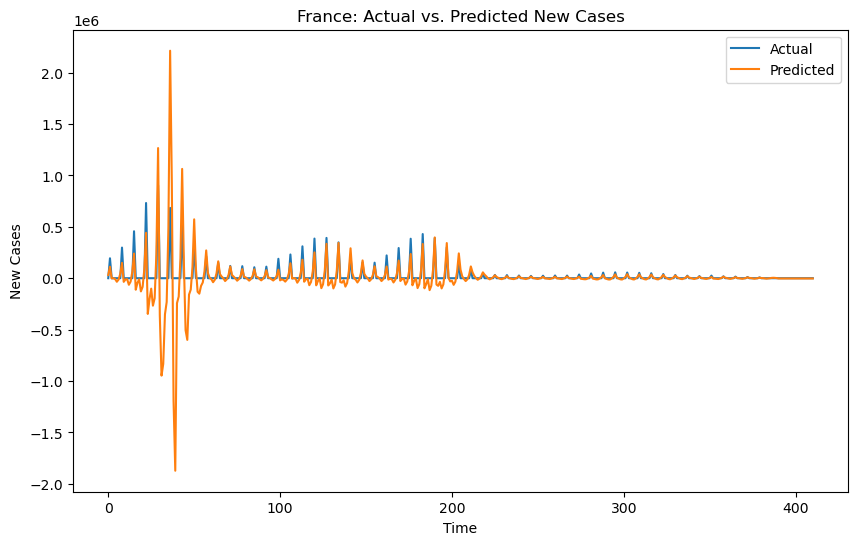

Epoch 1/50
22/22 - 0s - loss: 0.0156 - val_loss: 0.5222 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0116 - val_loss: 0.4747 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0104 - val_loss: 0.4972 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0096 - val_loss: 2.5299 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0092 - val_loss: 3.1961 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0093 - val_loss: 3.3128 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0091 - val_loss: 2.0207 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0091 - val_loss: 2.0302 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0089 - val_loss: 2.1418 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0089 - val_loss: 2.3854 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0089 - val_loss: 2.1463 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0087 - val_loss: 2.4254 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

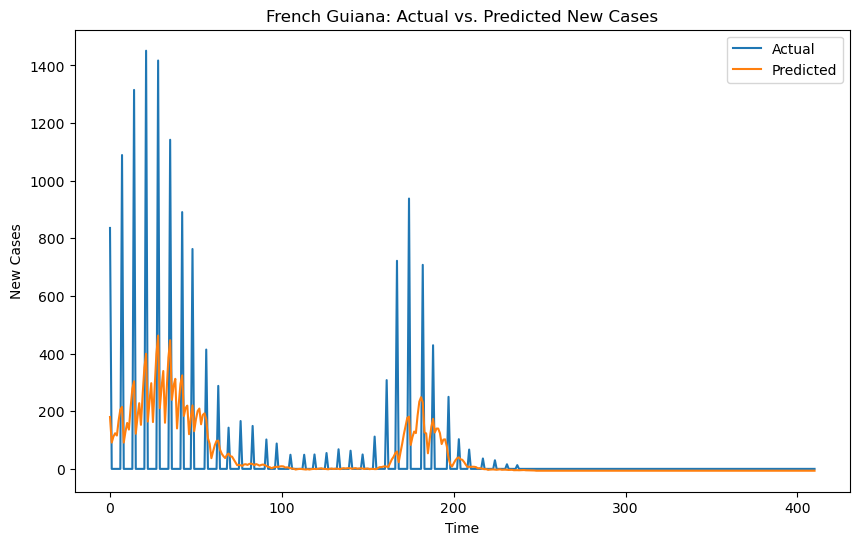

Epoch 1/50
22/22 - 0s - loss: 0.0078 - val_loss: 0.0245 - 385ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0071 - val_loss: 0.0231 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0065 - val_loss: 0.0212 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0062 - val_loss: 0.0207 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0206 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0207 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0208 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0204 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0208 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0204 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0205 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0061 - val_loss: 0.0208 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

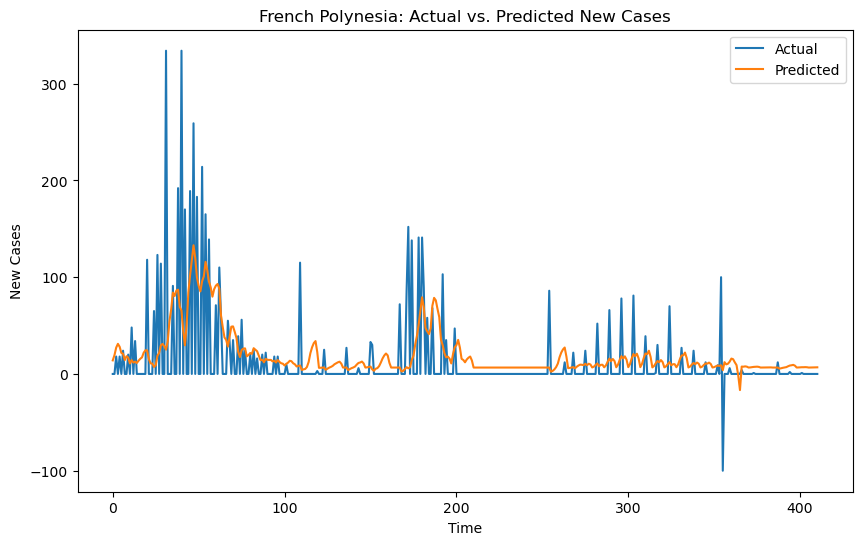

Epoch 1/50
22/22 - 0s - loss: 0.0298 - val_loss: 0.0732 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0268 - val_loss: 0.0674 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0250 - val_loss: 0.0651 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0245 - val_loss: 0.0644 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0236 - val_loss: 0.0640 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0233 - val_loss: 0.0624 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0232 - val_loss: 0.0617 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0224 - val_loss: 0.0608 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0222 - val_loss: 0.0613 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0216 - val_loss: 0.0598 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0213 - val_loss: 0.0564 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0205 - val_loss: 0.0645 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.02

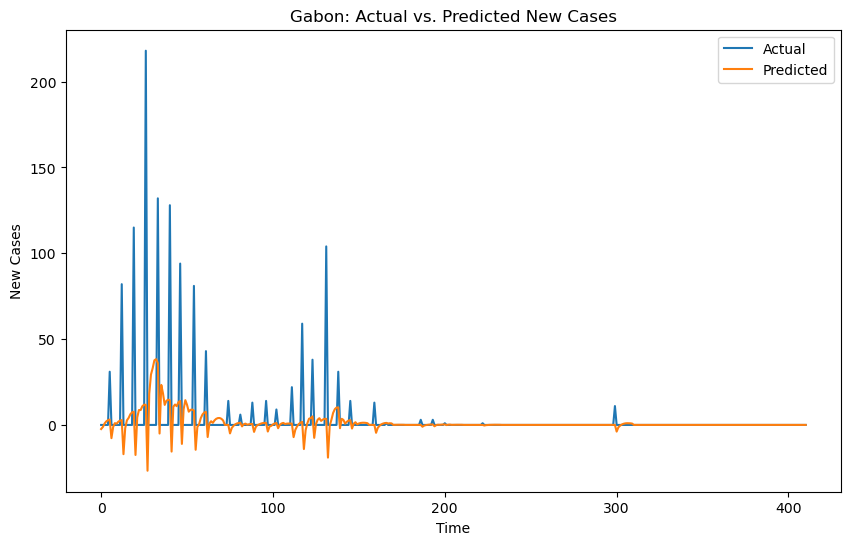

Epoch 1/50
22/22 - 0s - loss: 0.0101 - val_loss: 0.0087 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0092 - val_loss: 0.0079 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0082 - val_loss: 0.0077 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0077 - val_loss: 0.0081 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0077 - val_loss: 0.0086 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0075 - val_loss: 0.0082 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0075 - val_loss: 0.0082 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0075 - val_loss: 0.0082 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0075 - val_loss: 0.0084 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0076 - val_loss: 0.0083 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0076 - val_loss: 0.0091 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0075 - val_loss: 0.0087 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

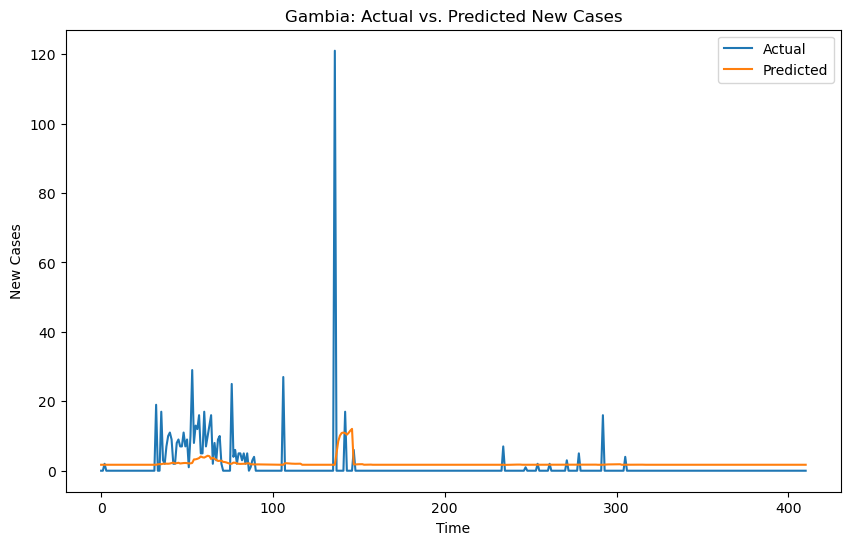

Epoch 1/50
22/22 - 0s - loss: 0.0831 - val_loss: 0.9119 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0279 - val_loss: 3.1308 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0122 - val_loss: 56.4339 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0104 - val_loss: 31.5898 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0097 - val_loss: 13.0432 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0094 - val_loss: 9.5832 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0095 - val_loss: 4.0802 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0093 - val_loss: 4.0518 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0092 - val_loss: 3.1175 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0092 - val_loss: 3.0519 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0089 - val_loss: 1.8921 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0088 - val_loss: 1.4623 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0

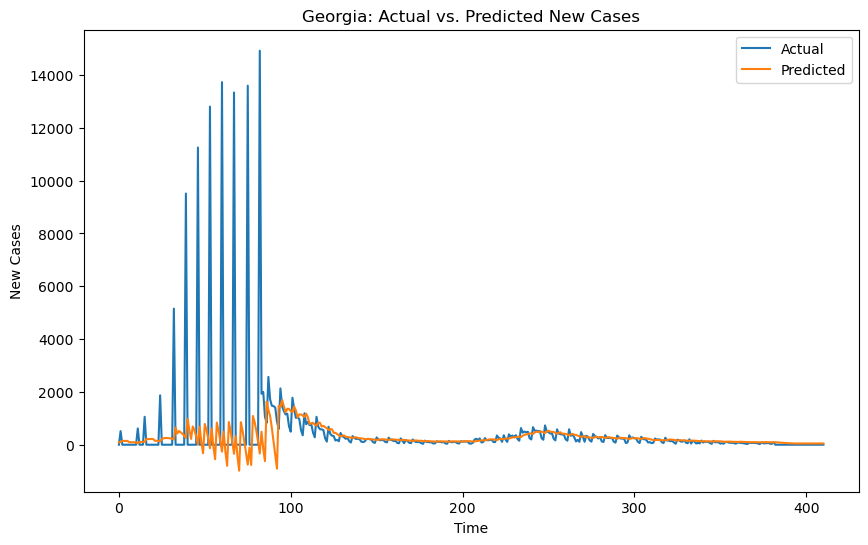

Epoch 1/50
22/22 - 0s - loss: 0.0083 - val_loss: 0.7618 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0082 - val_loss: 0.7516 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0081 - val_loss: 0.7381 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0079 - val_loss: 0.7056 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0076 - val_loss: 0.6592 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.6367 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0069 - val_loss: 1.0089 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0065 - val_loss: 2.2677 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0060 - val_loss: 48.7929 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0053 - val_loss: 432.7463 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0049 - val_loss: 1689.6975 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0045 - val_loss: 1677.2854 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - l

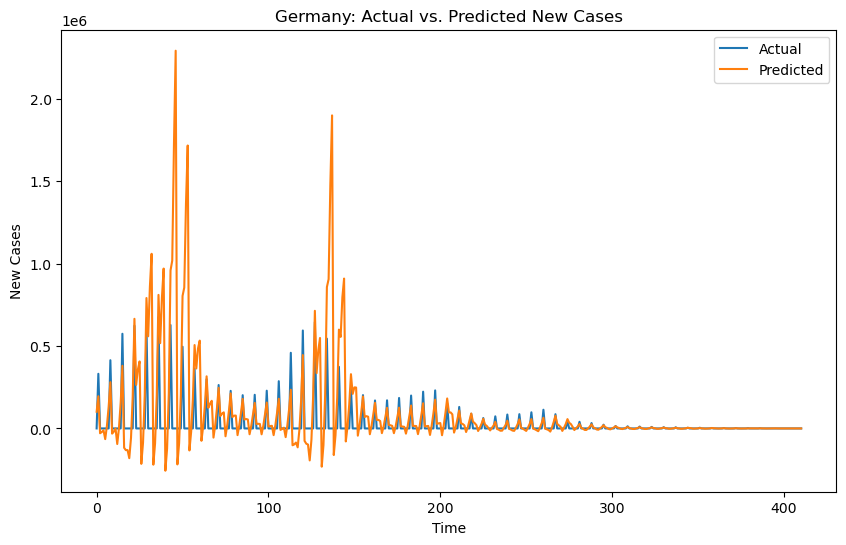

Epoch 1/50
22/22 - 0s - loss: 0.0177 - val_loss: 0.0390 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0118 - val_loss: 0.0341 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0098 - val_loss: 0.0331 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0097 - val_loss: 0.0329 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0096 - val_loss: 0.0326 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0098 - val_loss: 0.0325 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0096 - val_loss: 0.0324 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0094 - val_loss: 0.0324 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0094 - val_loss: 0.0322 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0094 - val_loss: 0.0321 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0094 - val_loss: 0.0321 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0093 - val_loss: 0.0319 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

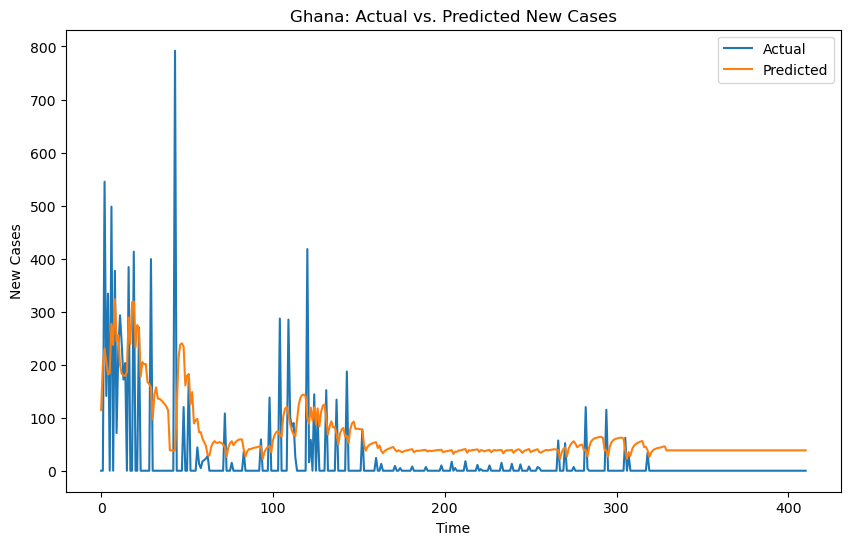

Epoch 1/50
22/22 - 0s - loss: 0.0133 - val_loss: 0.1614 - 391ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0082 - val_loss: 0.1143 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.0804 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0783 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0775 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0774 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0779 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0036 - val_loss: 0.0783 - 38ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0776 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0775 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0033 - val_loss: 0.0772 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.0784 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

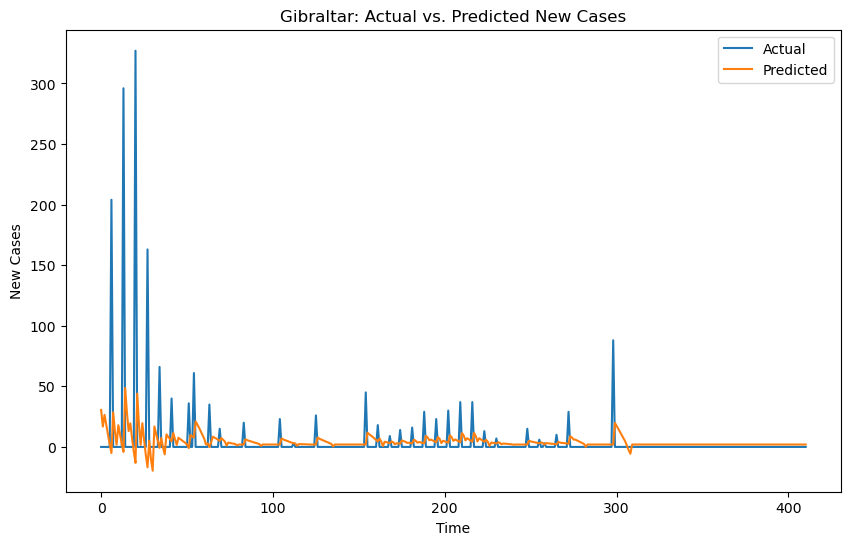

Epoch 1/50
22/22 - 0s - loss: 0.0132 - val_loss: 0.8442 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0130 - val_loss: 0.8371 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0128 - val_loss: 0.8066 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0124 - val_loss: 0.7628 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0118 - val_loss: 0.7196 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0113 - val_loss: 1.0401 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0105 - val_loss: 43.7457 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0098 - val_loss: 196.2681 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0088 - val_loss: 760.0215 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0075 - val_loss: 2859.7175 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0085 - val_loss: 1113.2803 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0067 - val_loss: 2008.7909 - 38ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0

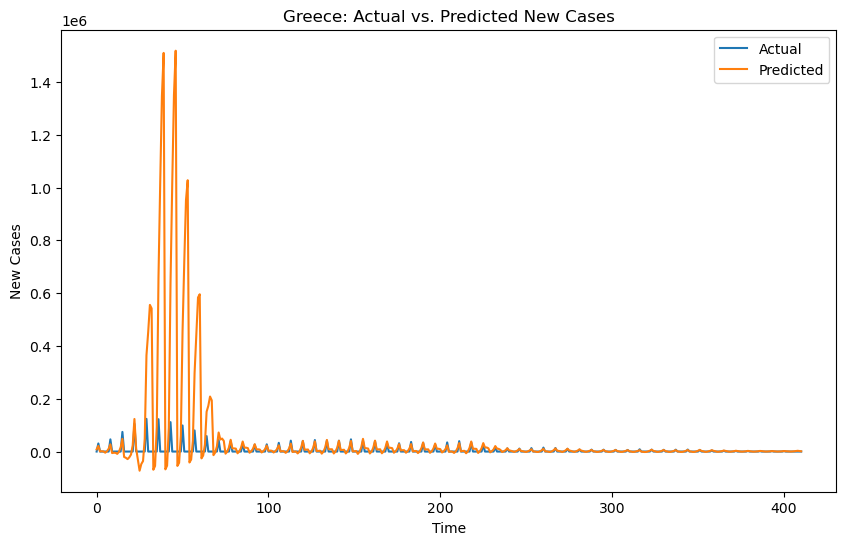

Epoch 1/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.9517 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.6940 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.7597 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0031 - val_loss: 1.1745 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.9482 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0032 - val_loss: 1.2532 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0031 - val_loss: 1.2436 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.9121 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.9209 - 38ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.7753 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.7640 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.7262 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

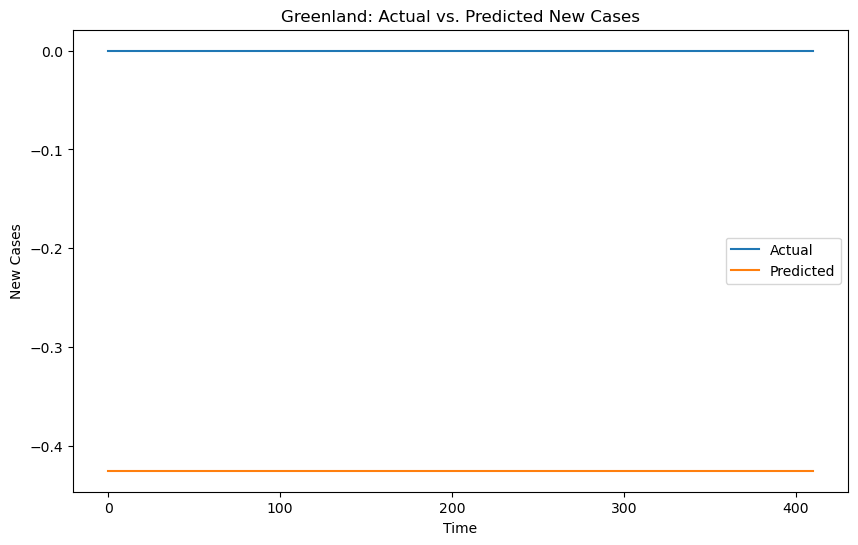

Epoch 1/50
22/22 - 0s - loss: 0.0090 - val_loss: 0.1017 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0056 - val_loss: 0.0736 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0697 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0698 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0695 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0033 - val_loss: 0.0693 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0033 - val_loss: 0.0691 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.0689 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.0694 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.0683 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.0685 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.0685 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

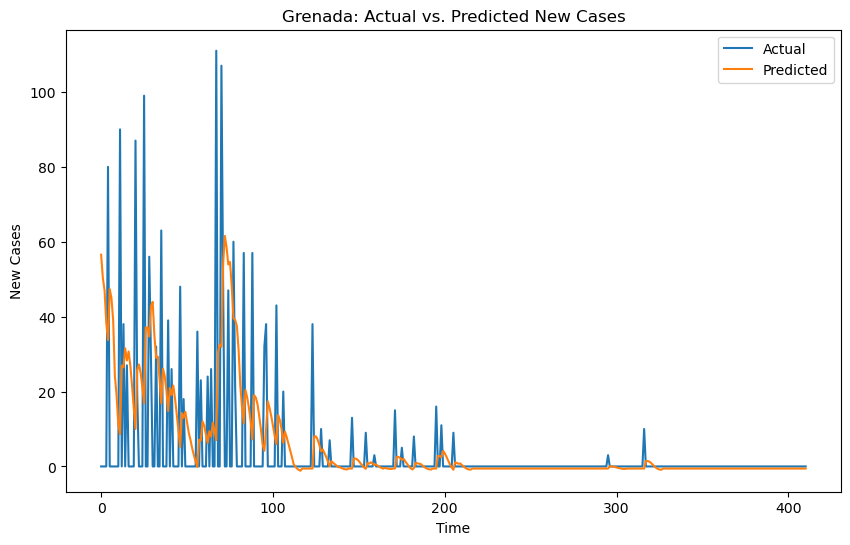

Epoch 1/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.0938 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0921 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0921 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0907 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0890 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0879 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0874 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0868 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0865 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0852 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0036 - val_loss: 0.0848 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0036 - val_loss: 0.0836 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

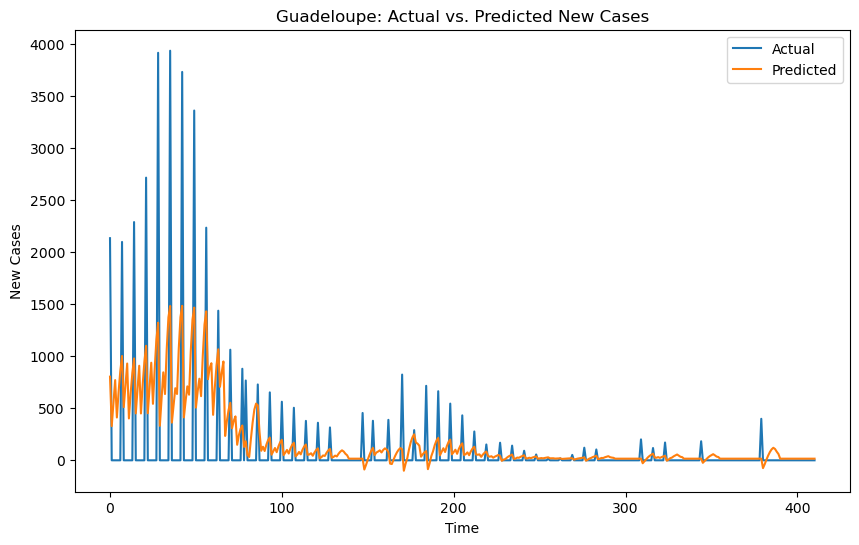

Epoch 1/50
22/22 - 0s - loss: 0.0145 - val_loss: 1.1656 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0108 - val_loss: 1.0556 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0090 - val_loss: 1.7404 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0083 - val_loss: 4.8856 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0081 - val_loss: 2.8644 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0081 - val_loss: 1.8799 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0080 - val_loss: 1.9100 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0080 - val_loss: 1.9152 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0080 - val_loss: 1.7604 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0079 - val_loss: 1.6317 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0080 - val_loss: 1.3499 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0079 - val_loss: 1.5757 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

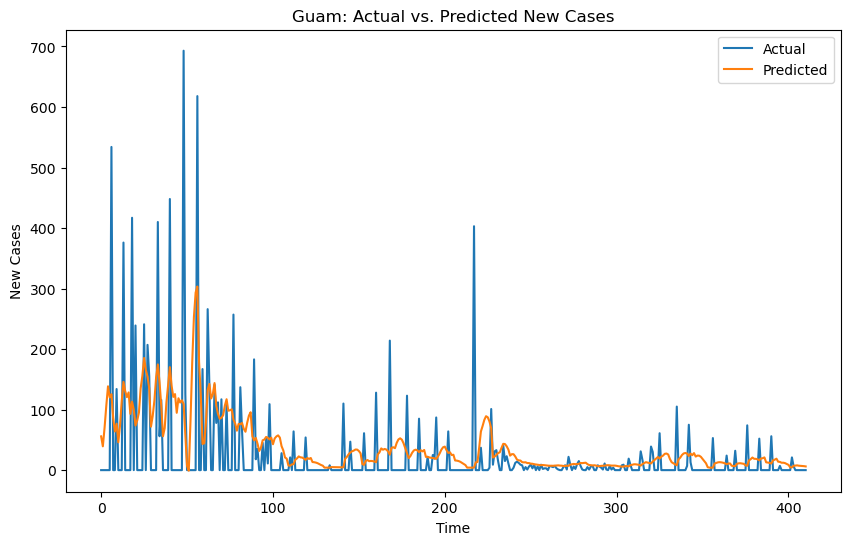

Epoch 1/50
22/22 - 0s - loss: 0.0182 - val_loss: 0.0205 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0111 - val_loss: 0.0142 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0082 - val_loss: 0.0111 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0073 - val_loss: 0.0110 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0073 - val_loss: 0.0110 - 38ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.0112 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.0109 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0073 - val_loss: 0.0108 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0073 - val_loss: 0.0109 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0073 - val_loss: 0.0110 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0071 - val_loss: 0.0107 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0072 - val_loss: 0.0110 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

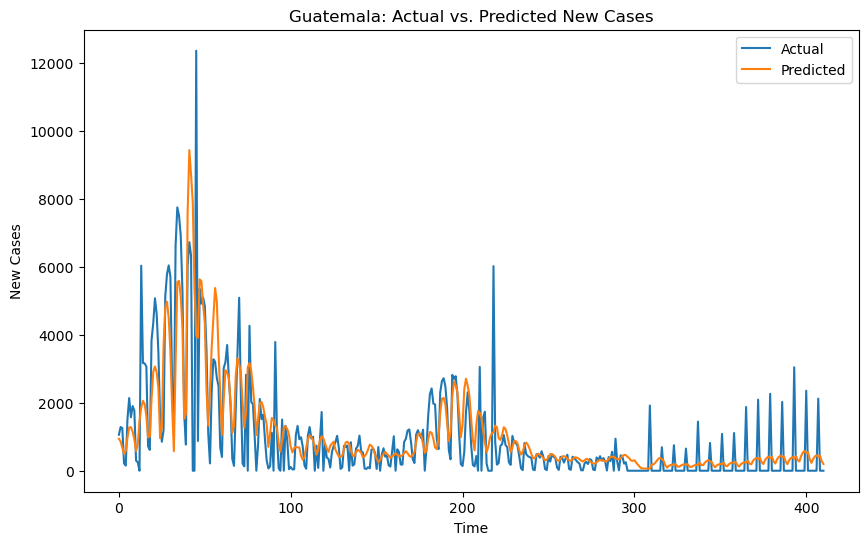

Epoch 1/50
22/22 - 0s - loss: 0.0115 - val_loss: 4.4287 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0064 - val_loss: 4.4656 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0033 - val_loss: 46.2752 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0026 - val_loss: 15.2929 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0025 - val_loss: 11.3971 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0026 - val_loss: 13.5320 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0026 - val_loss: 15.3915 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0026 - val_loss: 9.1427 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0026 - val_loss: 10.5989 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0026 - val_loss: 7.0862 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0025 - val_loss: 9.9871 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0025 - val_loss: 7.9931 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss

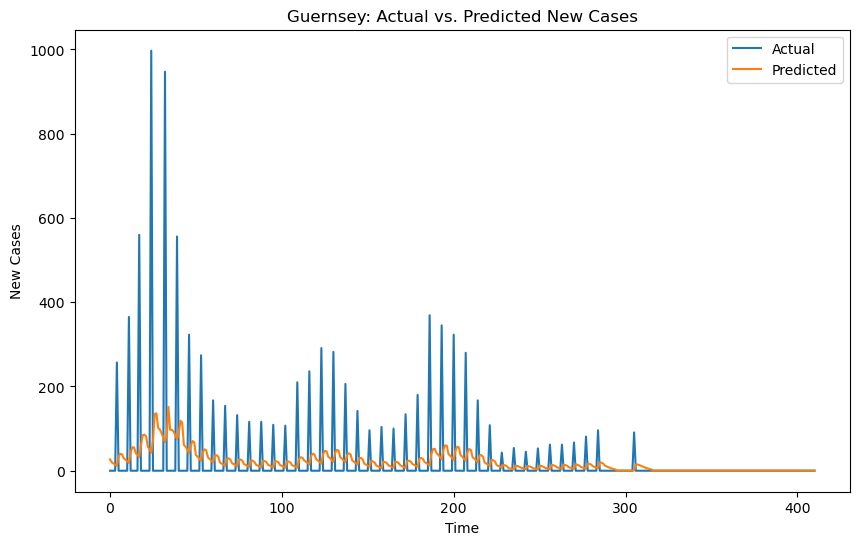

Epoch 1/50
22/22 - 0s - loss: 0.0270 - val_loss: 0.0499 - 385ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0181 - val_loss: 0.0439 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0165 - val_loss: 0.0441 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0158 - val_loss: 0.0459 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0160 - val_loss: 0.0496 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0156 - val_loss: 0.0458 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0155 - val_loss: 0.0452 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0155 - val_loss: 0.0457 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0158 - val_loss: 0.0469 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0155 - val_loss: 0.0440 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0154 - val_loss: 0.0442 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0155 - val_loss: 0.0433 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.01

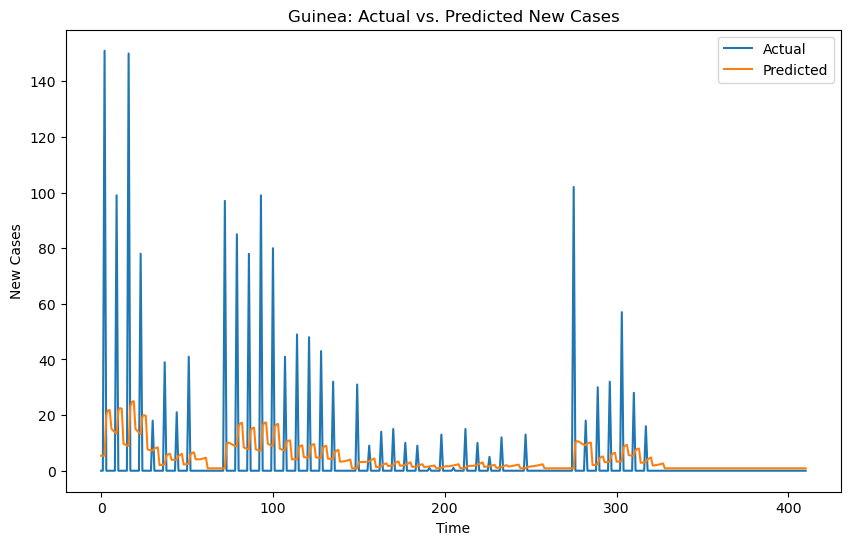

Epoch 1/50
22/22 - 0s - loss: 0.0085 - val_loss: 0.0084 - 385ms/epoch - 17ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0075 - val_loss: 0.0076 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0070 - val_loss: 0.0070 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0069 - val_loss: 0.0070 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0069 - val_loss: 0.0070 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0069 - val_loss: 0.0070 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.0070 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.0070 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.0069 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0069 - val_loss: 0.0070 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.0070 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.0069 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

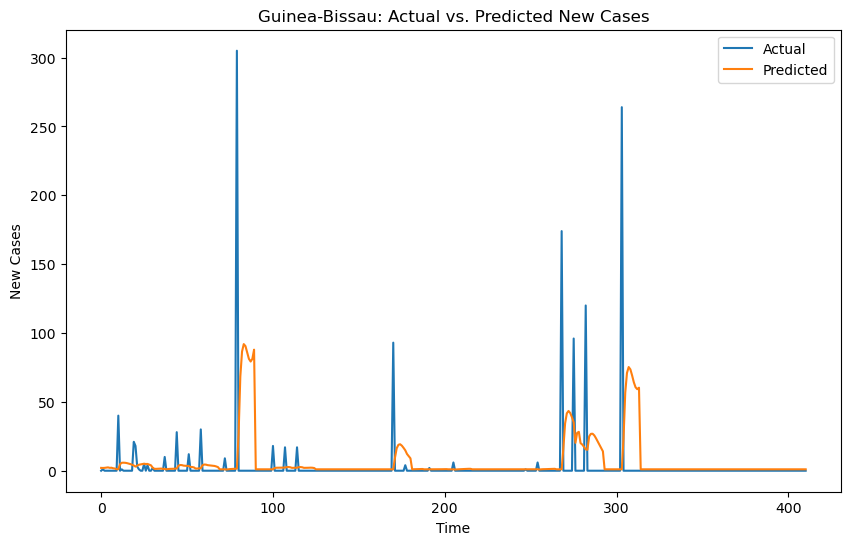

Epoch 1/50
22/22 - 0s - loss: 0.0308 - val_loss: 0.6178 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0160 - val_loss: 0.4436 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0117 - val_loss: 2.5080 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0104 - val_loss: 5.8384 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0104 - val_loss: 1.5817 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0100 - val_loss: 1.5344 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0100 - val_loss: 1.2137 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0100 - val_loss: 0.9503 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0100 - val_loss: 0.7544 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0098 - val_loss: 0.9056 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0099 - val_loss: 0.7506 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0099 - val_loss: 0.6680 - 45ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

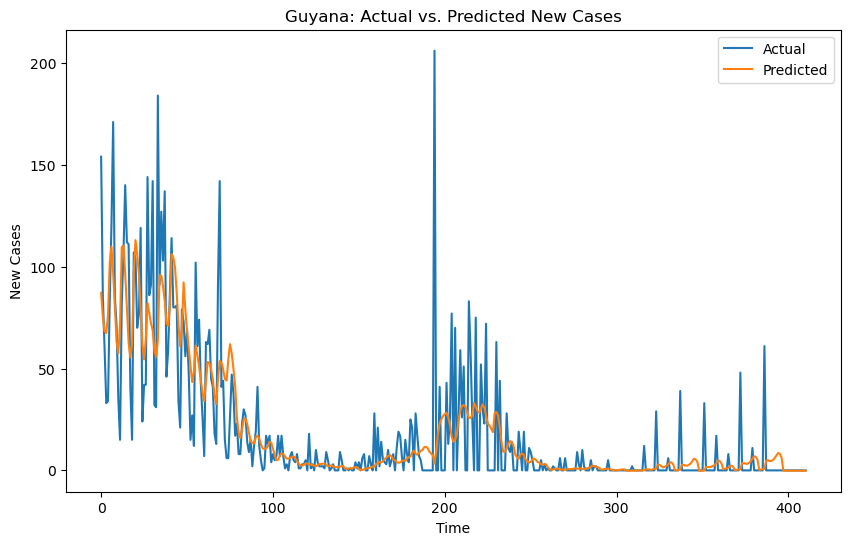

Epoch 1/50
22/22 - 0s - loss: 0.0277 - val_loss: 0.0203 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0163 - val_loss: 0.0167 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0132 - val_loss: 0.0145 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0120 - val_loss: 0.0137 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0120 - val_loss: 0.0135 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0117 - val_loss: 0.0137 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0117 - val_loss: 0.0137 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0122 - val_loss: 0.0136 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0118 - val_loss: 0.0133 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0116 - val_loss: 0.0133 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0114 - val_loss: 0.0131 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0115 - val_loss: 0.0130 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.01

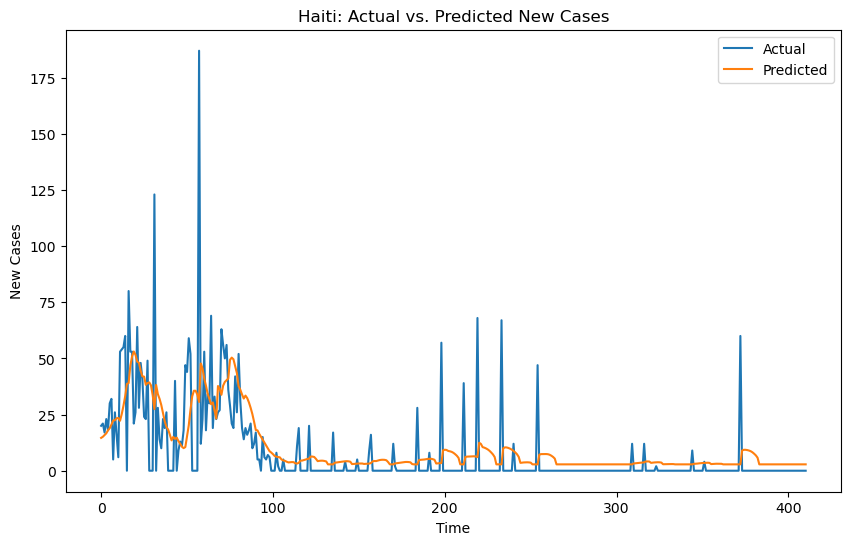

Epoch 1/50
22/22 - 0s - loss: 0.0035 - val_loss: 4.2757e-07 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0034 - val_loss: 4.3659e-05 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0034 - val_loss: 2.2530e-05 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0034 - val_loss: 8.0527e-07 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0034 - val_loss: 1.5038e-05 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0034 - val_loss: 2.2350e-05 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0034 - val_loss: 3.9026e-05 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0034 - val_loss: 1.8423e-05 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0034 - val_loss: 9.2653e-06 - 46ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0034 - val_loss: 2.2934e-05 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0034 - val_loss: 1.7597e-05 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0034 - val_loss: 1.8441e-05 - 40ms/epoc

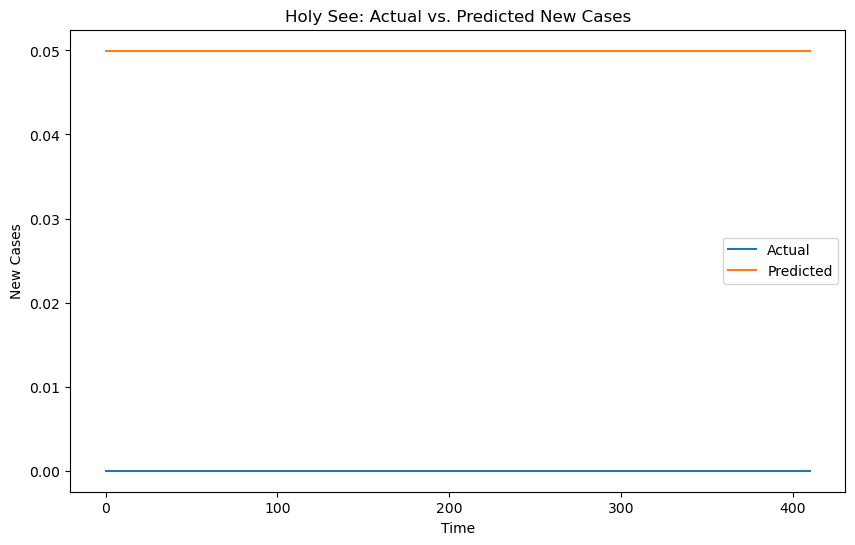

Epoch 1/50
22/22 - 0s - loss: 0.0148 - val_loss: 0.0238 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0117 - val_loss: 0.0218 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0113 - val_loss: 0.0215 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0114 - val_loss: 0.0219 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0111 - val_loss: 0.0215 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0110 - val_loss: 0.0214 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0110 - val_loss: 0.0215 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0109 - val_loss: 0.0213 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0112 - val_loss: 0.0214 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0108 - val_loss: 0.0212 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0108 - val_loss: 0.0212 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0106 - val_loss: 0.0211 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.01

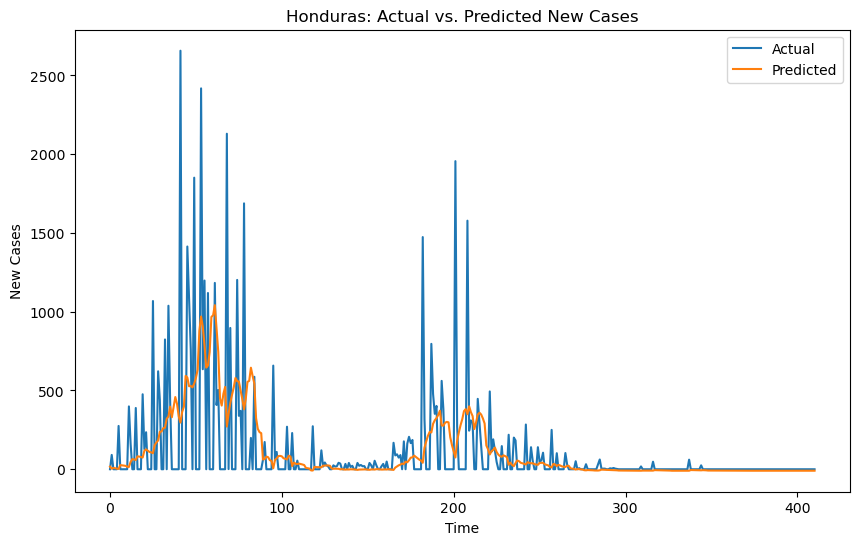

Epoch 1/50
22/22 - 0s - loss: 0.0124 - val_loss: 0.0567 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0087 - val_loss: 0.0511 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0067 - val_loss: 0.0446 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0055 - val_loss: 0.0549 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.0492 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.0465 - 45ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0055 - val_loss: 0.0462 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0053 - val_loss: 0.0471 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0052 - val_loss: 0.0476 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0051 - val_loss: 0.0451 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0052 - val_loss: 0.0458 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0051 - val_loss: 0.0441 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

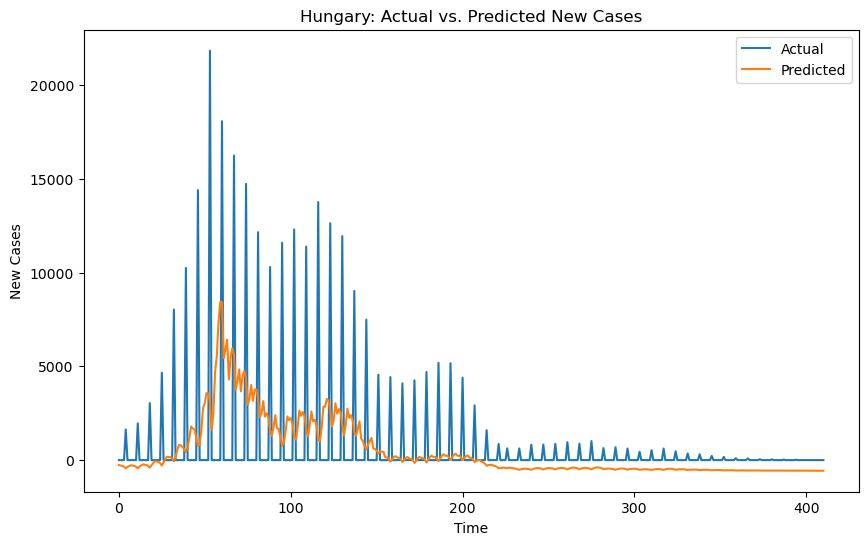

Epoch 1/50
22/22 - 0s - loss: 0.0109 - val_loss: 8.5539 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0106 - val_loss: 8.4366 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0104 - val_loss: 8.2274 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0103 - val_loss: 7.8601 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0101 - val_loss: 7.2938 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0099 - val_loss: 79.1389 - 38ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0094 - val_loss: 3437.5195 - 38ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0089 - val_loss: 13378.6914 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0083 - val_loss: 48988.0781 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0076 - val_loss: 81759.7891 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0071 - val_loss: 88250.5703 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0061 - val_loss: 144732.4688 - 40ms/epoch - 2ms/step
Epoch 13/5

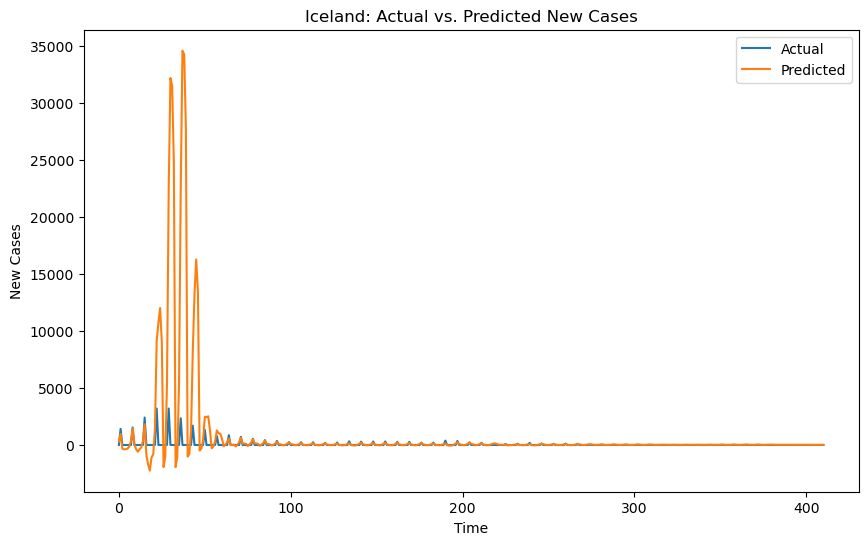

Epoch 1/50
22/22 - 0s - loss: 0.0385 - val_loss: 0.0304 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0099 - val_loss: 0.0063 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0056 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0014 - val_loss: 0.0052 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0012 - val_loss: 0.0048 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0012 - val_loss: 0.0047 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 9.5932e-04 - val_loss: 0.0043 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 8.7529e-04 - val_loss: 0.0042 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 9.3563e-04 - val_loss: 0.0036 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 7.6956e-04 - val_loss: 0.0033 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 7.3325e-04 - val_loss: 0.0029 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 6.8148e-04 - val_loss: 0.0028 - 40ms/epoch - 2ms/step
Epoch 13/50

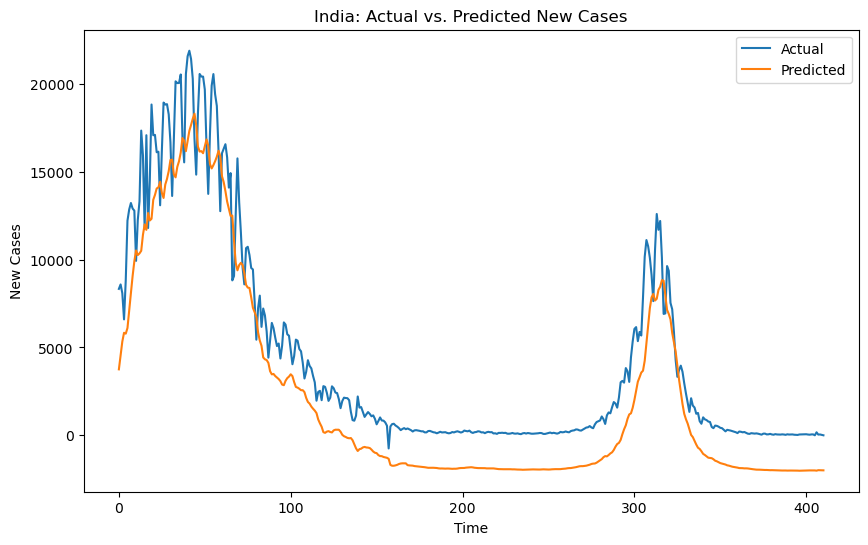

Epoch 1/50
22/22 - 0s - loss: 0.0299 - val_loss: 0.0831 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0167 - val_loss: 0.0442 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0063 - val_loss: 0.0170 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0147 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0151 - 38ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0021 - val_loss: 0.0142 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0021 - val_loss: 0.0141 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0021 - val_loss: 0.0141 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0020 - val_loss: 0.0134 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0021 - val_loss: 0.0131 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0020 - val_loss: 0.0130 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0127 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

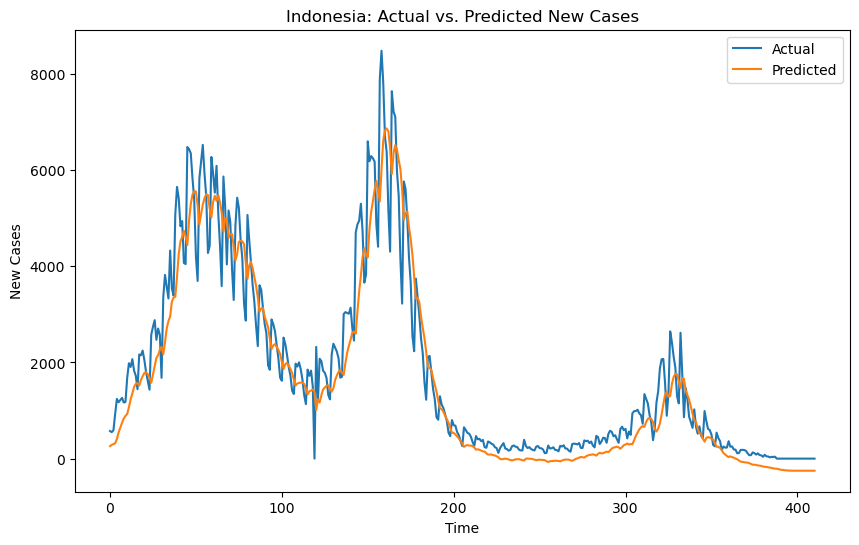

Epoch 1/50
22/22 - 0s - loss: 0.0342 - val_loss: 0.0155 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0062 - val_loss: 0.0090 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.0086 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0085 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0081 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0080 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0080 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0078 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0074 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0075 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0071 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0073 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

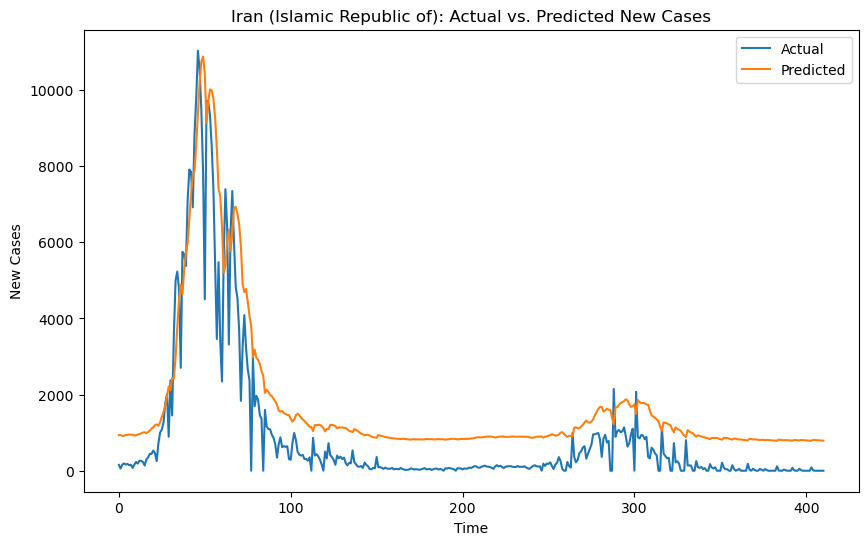

Epoch 1/50
22/22 - 0s - loss: 0.0302 - val_loss: 0.0075 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0043 - val_loss: 0.0043 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.0042 - 40ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.0041 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.0039 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0038 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0037 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0037 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0036 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0036 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0036 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0034 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

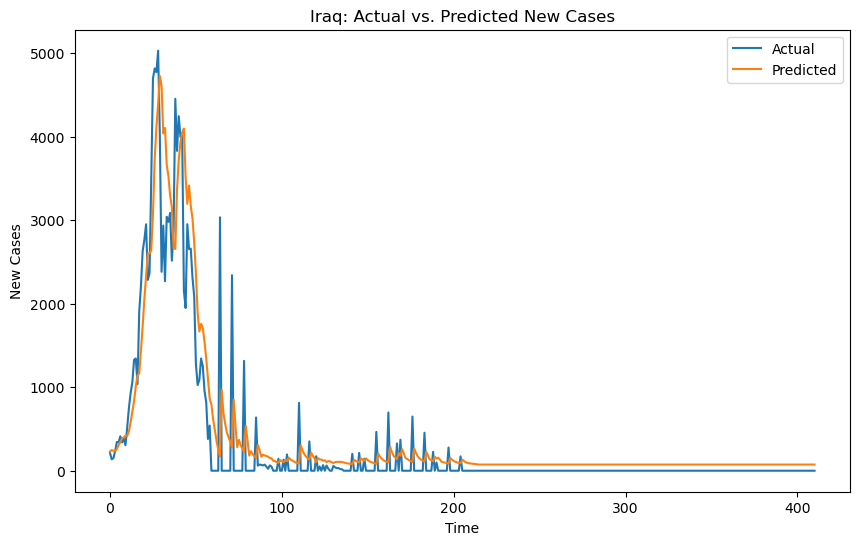

Epoch 1/50
22/22 - 0s - loss: 0.0170 - val_loss: 0.2213 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0059 - val_loss: 2.0295 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0043 - val_loss: 1.5904 - 40ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.6089 - 40ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0036 - val_loss: 0.4867 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.2855 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.1369 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.1087 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.0737 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.0613 - 42ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0582 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0833 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

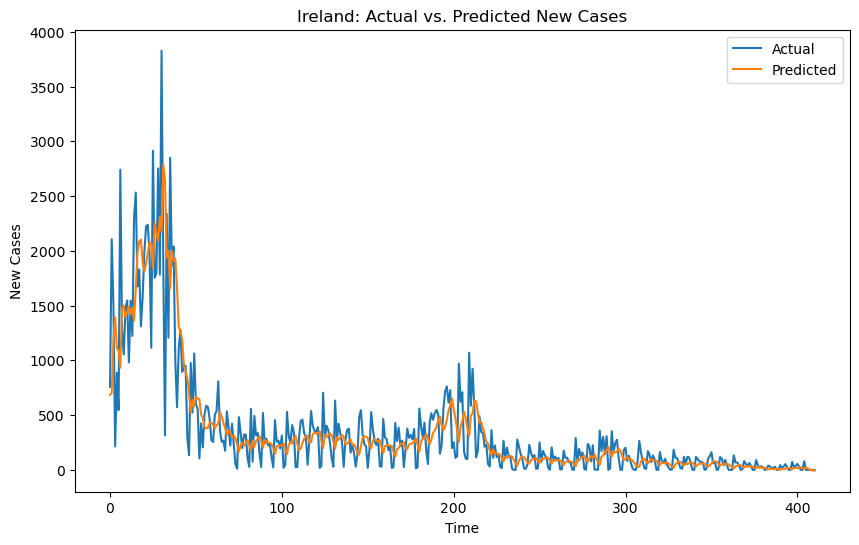

Epoch 1/50
22/22 - 0s - loss: 0.0102 - val_loss: 0.3769 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.3496 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.3425 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0042 - val_loss: 0.3419 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.3424 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.3435 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.3412 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.3406 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0033 - val_loss: 0.3405 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.3426 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.3463 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.3497 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

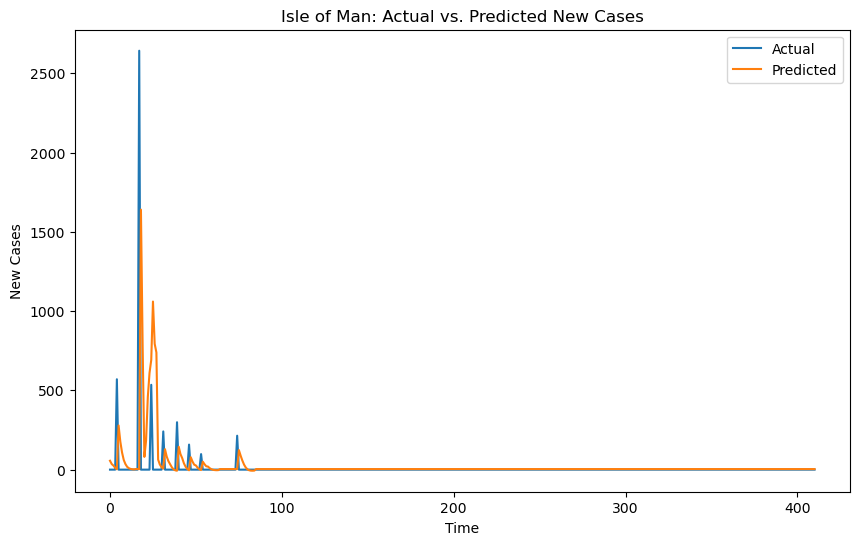

Epoch 1/50
22/22 - 0s - loss: 0.0436 - val_loss: 1.1065 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0120 - val_loss: 187.7581 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0084 - val_loss: 69.5772 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0082 - val_loss: 72.3968 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0080 - val_loss: 60.1218 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0080 - val_loss: 43.4944 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0079 - val_loss: 33.1156 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0081 - val_loss: 39.4361 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0080 - val_loss: 26.5060 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0079 - val_loss: 34.7922 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0079 - val_loss: 21.1157 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0077 - val_loss: 14.9401 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s 

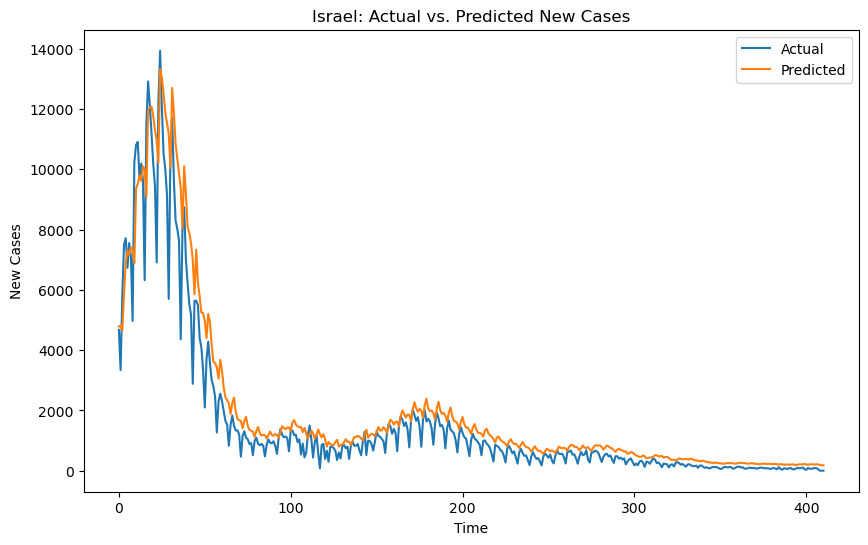

Epoch 1/50
22/22 - 0s - loss: 0.0505 - val_loss: 1.5234 - 391ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0136 - val_loss: 90.3154 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0062 - val_loss: 339.3211 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0049 - val_loss: 168.4792 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0040 - val_loss: 83.0414 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0039 - val_loss: 82.0282 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0037 - val_loss: 64.8692 - 42ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0036 - val_loss: 47.0943 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0035 - val_loss: 31.7307 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0035 - val_loss: 22.7089 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0035 - val_loss: 21.0758 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0035 - val_loss: 28.6788 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s

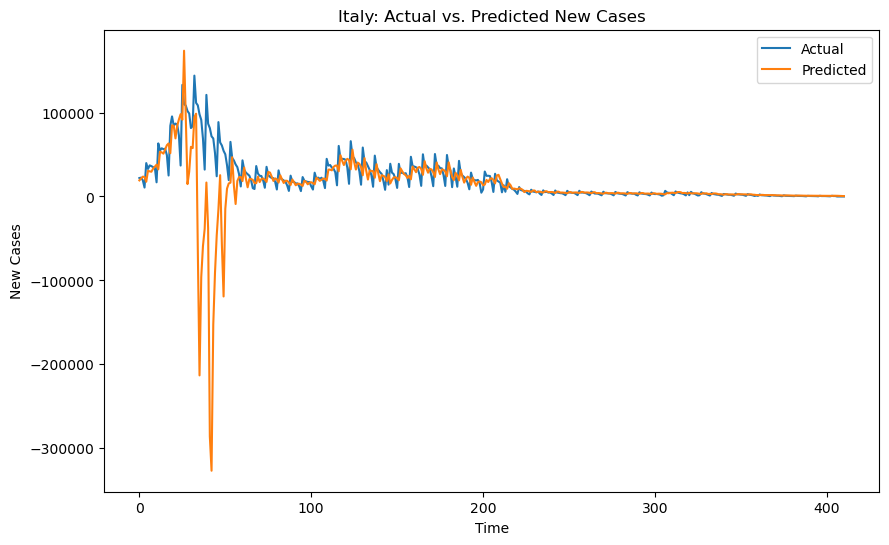

Epoch 1/50
22/22 - 0s - loss: 0.0563 - val_loss: 0.2139 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0264 - val_loss: 0.0865 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0081 - val_loss: 0.0869 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0063 - val_loss: 0.0571 - 36ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0620 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0548 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0582 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0535 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0538 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.0511 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.0534 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.0506 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

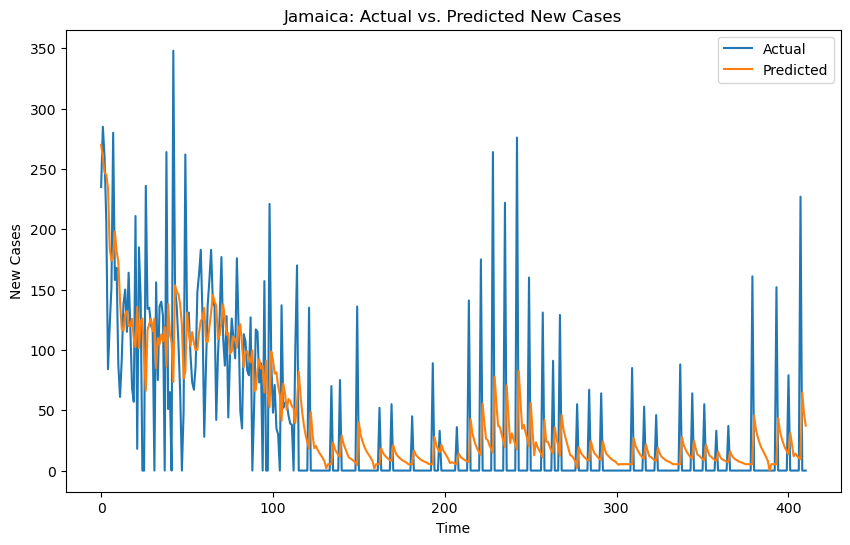

Epoch 1/50
22/22 - 0s - loss: 0.0263 - val_loss: 1.8832 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0113 - val_loss: 1.1868 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0032 - val_loss: 22.7263 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0024 - val_loss: 7.1669 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0022 - val_loss: 7.0888 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0024 - val_loss: 2.8023 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0021 - val_loss: 3.8567 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0021 - val_loss: 1.6394 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0020 - val_loss: 0.9175 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.5441 - 42ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.4778 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.7267 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.0

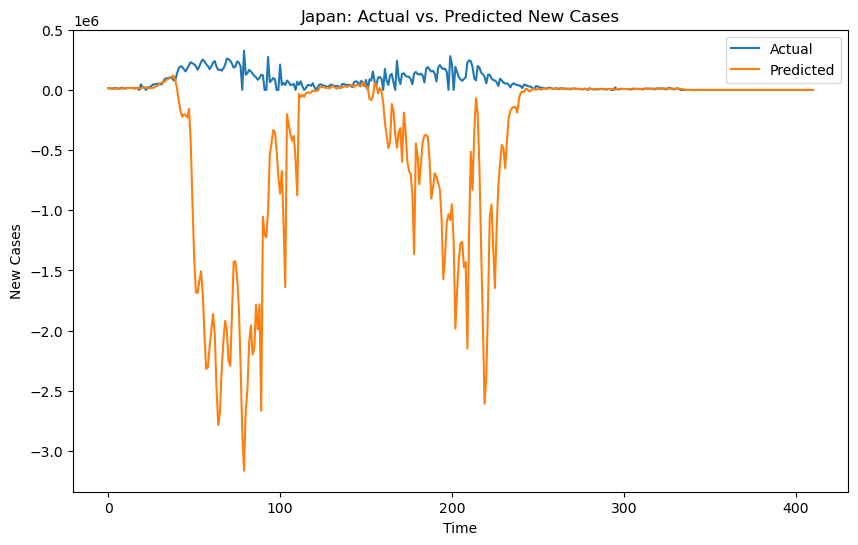

Epoch 1/50
22/22 - 0s - loss: 0.0118 - val_loss: 0.2654 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0078 - val_loss: 0.1777 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0050 - val_loss: 0.0763 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0422 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0357 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0344 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0332 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0021 - val_loss: 0.0339 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0020 - val_loss: 0.0338 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0020 - val_loss: 0.0302 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0303 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0286 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

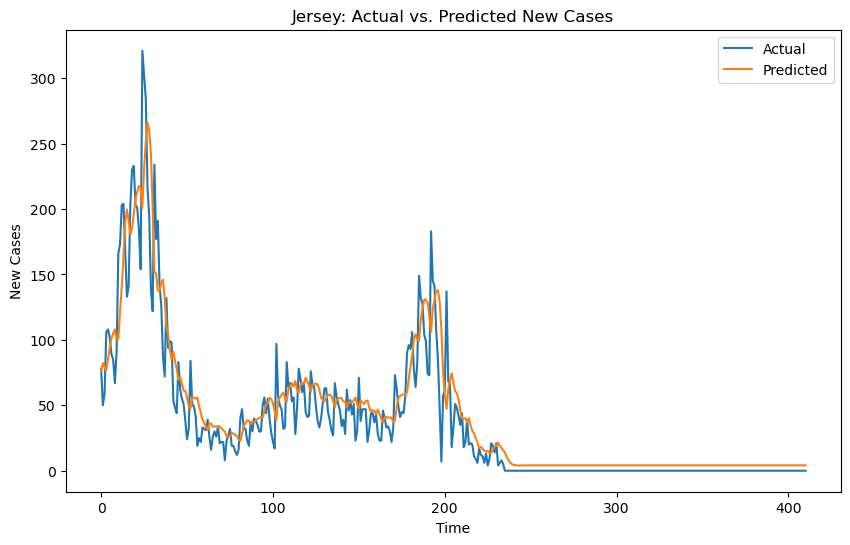

Epoch 1/50
22/22 - 0s - loss: 0.0242 - val_loss: 0.1445 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0081 - val_loss: 0.4101 - 40ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.2731 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0051 - val_loss: 0.2497 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0048 - val_loss: 0.2415 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.1841 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.1983 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.1465 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0044 - val_loss: 0.1461 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0044 - val_loss: 0.1338 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0043 - val_loss: 0.1354 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0042 - val_loss: 0.1272 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

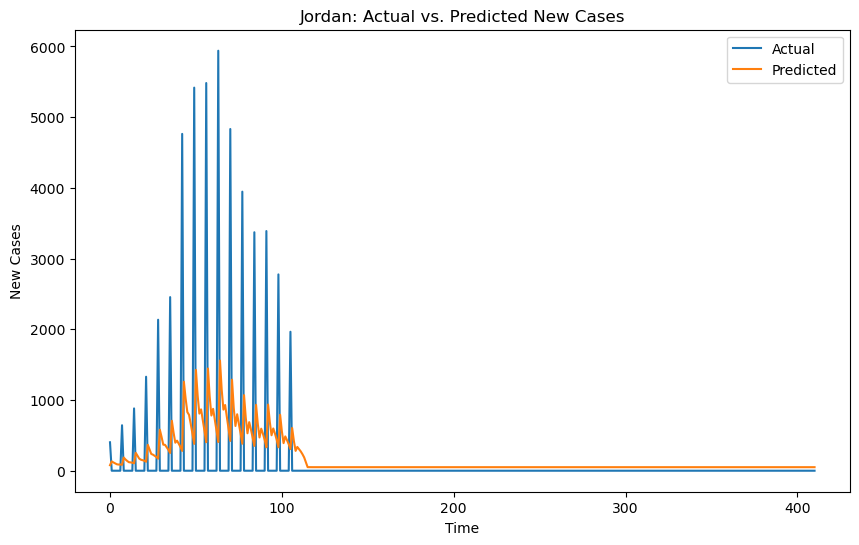

Epoch 1/50
22/22 - 0s - loss: 0.0277 - val_loss: 0.0570 - 393ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0071 - val_loss: 0.0381 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0033 - val_loss: 0.0537 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.0414 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.0430 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.0406 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.0384 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0377 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0343 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0321 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.0322 - 42ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0319 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

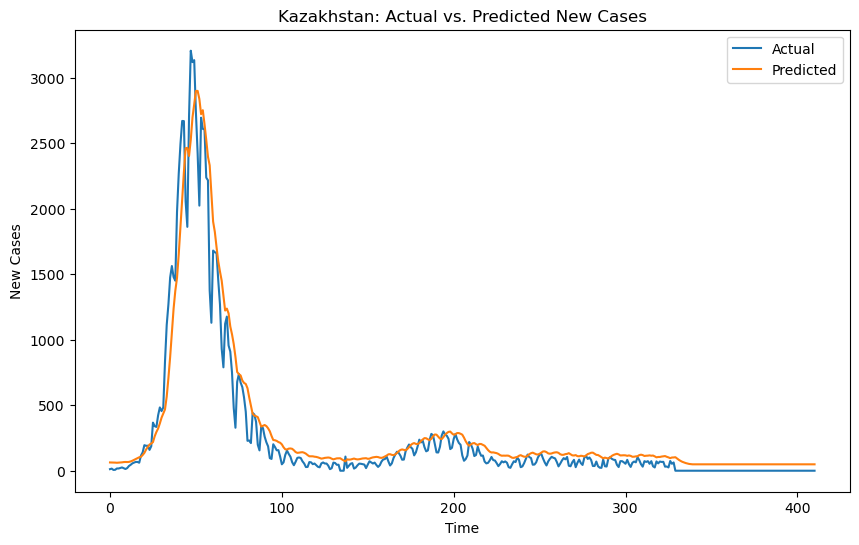

Epoch 1/50
22/22 - 0s - loss: 0.0406 - val_loss: 0.0811 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0115 - val_loss: 0.0605 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0097 - val_loss: 0.0684 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0096 - val_loss: 0.0585 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0096 - val_loss: 0.0545 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0100 - val_loss: 0.0534 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0096 - val_loss: 0.0530 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0093 - val_loss: 0.0556 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0092 - val_loss: 0.0533 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0092 - val_loss: 0.0529 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0093 - val_loss: 0.0533 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0092 - val_loss: 0.0532 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

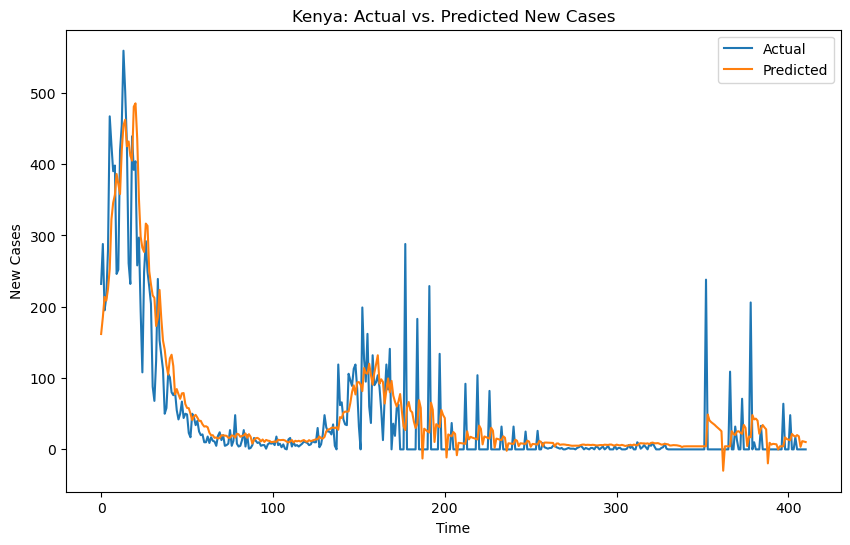

Epoch 1/50
22/22 - 2s - loss: 0.0000e+00 - val_loss: 4417.7251 - 2s/epoch - 84ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 4417.7251 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 4417.7251 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 4417.7251 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 4417.7251 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 4417.7251 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 4417.7251 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 4417.7251 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 4417.7251 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 4417.7251 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 4417.7251 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0000e+00 

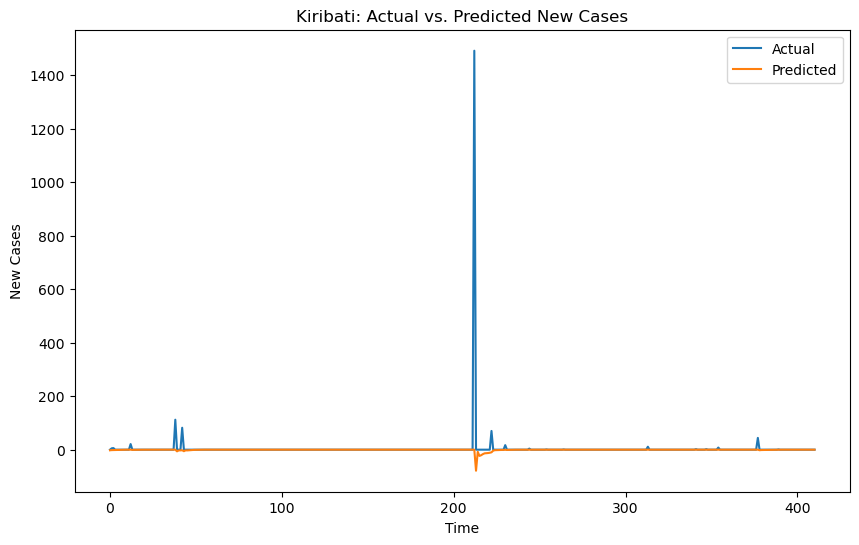

Epoch 1/50
22/22 - 0s - loss: 0.0123 - val_loss: 0.0490 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0051 - val_loss: 0.0356 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0033 - val_loss: 0.0336 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.0313 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.0293 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.0268 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.0248 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0241 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0222 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0205 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0193 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0179 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

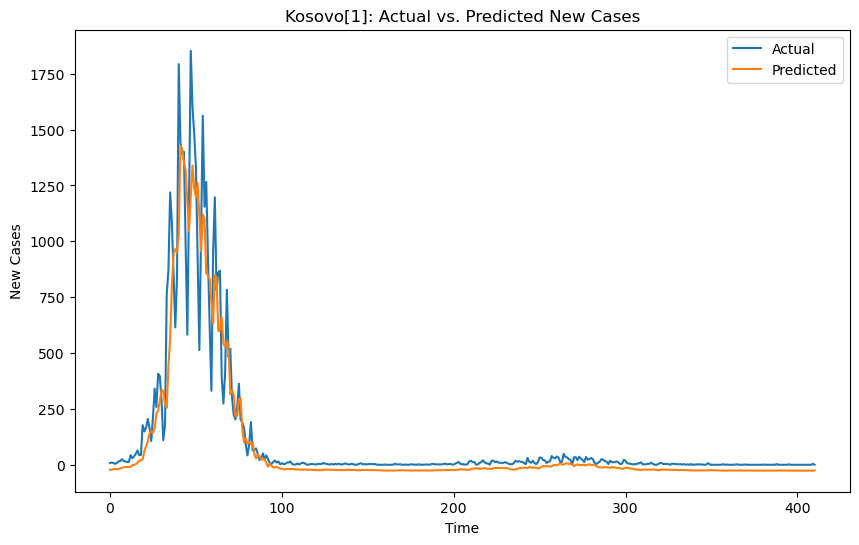

Epoch 1/50
22/22 - 0s - loss: 0.0576 - val_loss: 0.1596 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0087 - val_loss: 0.3479 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0045 - val_loss: 2.0129 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.8246 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.6404 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.6215 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.4728 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.3069 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0036 - val_loss: 0.3689 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.3221 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0036 - val_loss: 0.2448 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.2605 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

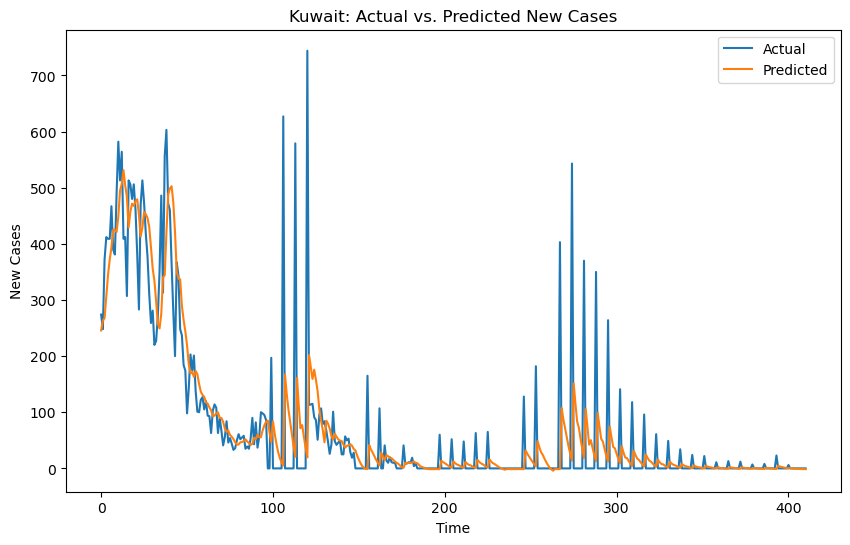

Epoch 1/50
22/22 - 0s - loss: 0.0062 - val_loss: 0.0030 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0062 - val_loss: 0.0029 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0029 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0029 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0057 - val_loss: 0.0029 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0055 - val_loss: 0.0029 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0053 - val_loss: 0.0030 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0053 - val_loss: 0.0030 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0051 - val_loss: 0.0030 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0050 - val_loss: 0.0031 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0050 - val_loss: 0.0032 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0047 - val_loss: 0.0031 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

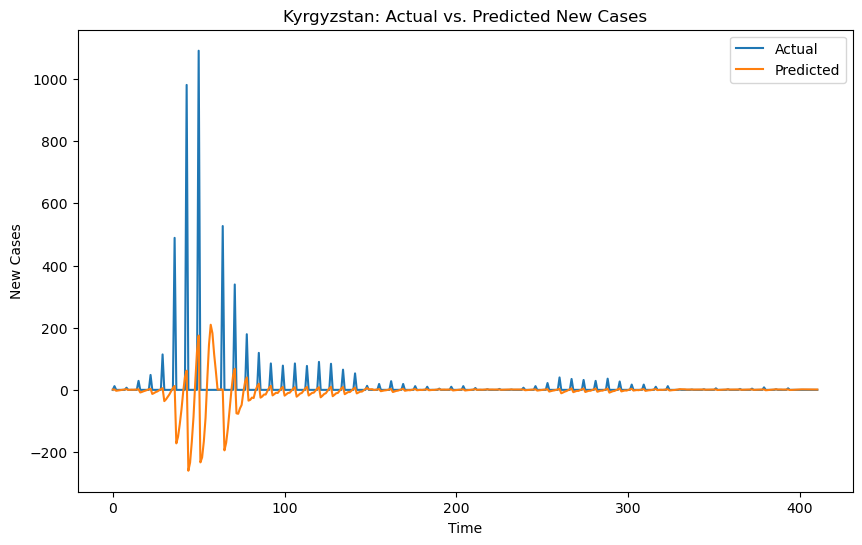

Epoch 1/50
22/22 - 0s - loss: 0.0265 - val_loss: 0.1523 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0072 - val_loss: 0.1277 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0979 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.1006 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.1029 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0947 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0873 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0913 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0875 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0911 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0852 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0843 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

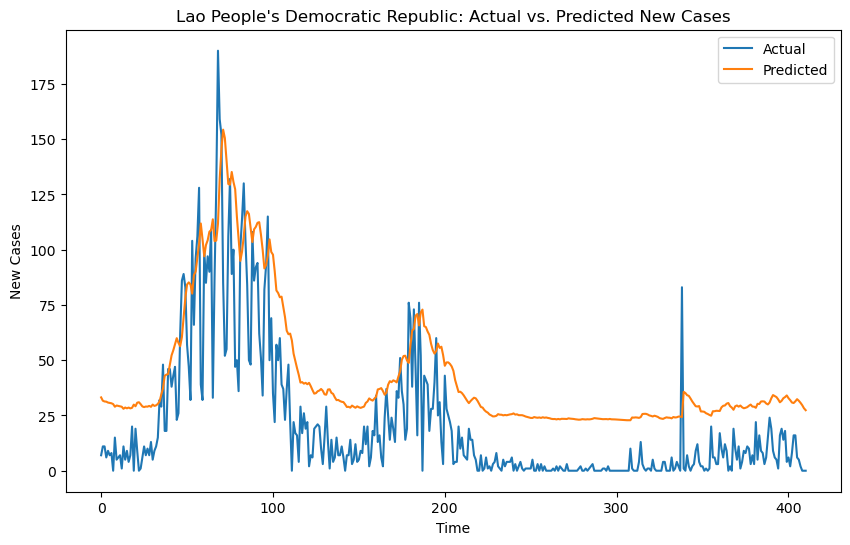

Epoch 1/50
22/22 - 0s - loss: 0.0090 - val_loss: 0.5505 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0087 - val_loss: 0.5436 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0086 - val_loss: 0.5291 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0085 - val_loss: 0.5000 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0081 - val_loss: 0.4656 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0077 - val_loss: 0.4364 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.4089 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0069 - val_loss: 0.7833 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0064 - val_loss: 8.9254 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0060 - val_loss: 42.3212 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0057 - val_loss: 108.8917 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0052 - val_loss: 192.4337 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss:

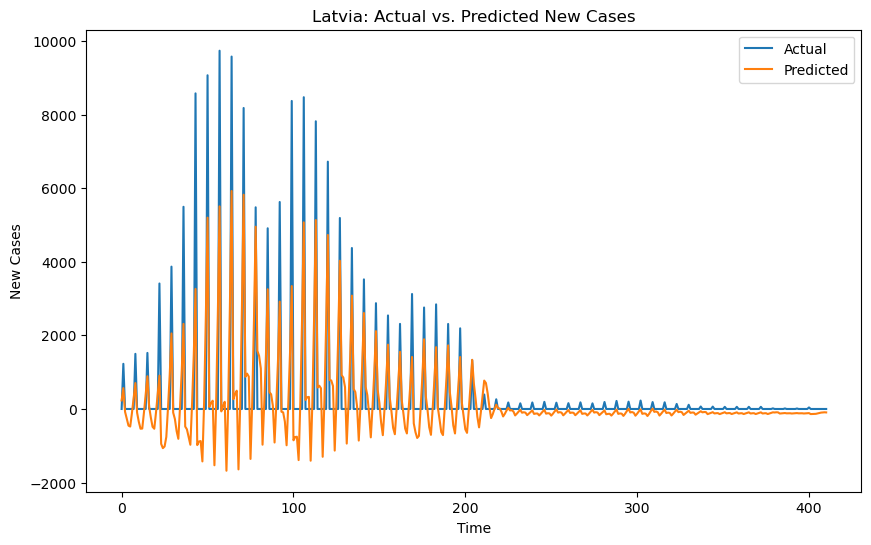

Epoch 1/50
22/22 - 0s - loss: 0.0477 - val_loss: 0.2077 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0124 - val_loss: 0.0387 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.0412 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0042 - val_loss: 0.0332 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0042 - val_loss: 0.0336 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0325 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0334 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0320 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0317 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.0320 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0313 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0311 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

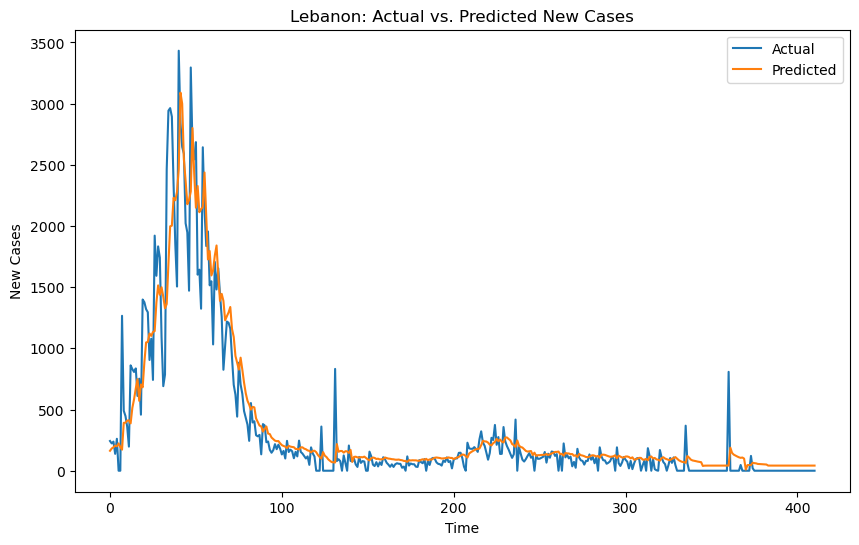

Epoch 1/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0101 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0095 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0092 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0091 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0089 - 46ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0088 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0088 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0087 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0087 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0088 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0088 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0087 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

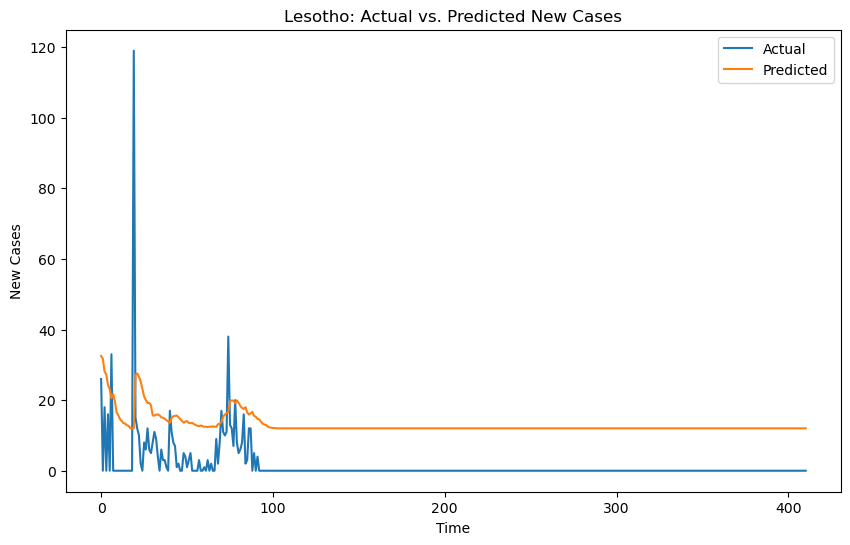

Epoch 1/50
22/22 - 0s - loss: 0.0086 - val_loss: 0.0070 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0057 - val_loss: 0.0057 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0047 - val_loss: 0.0054 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0043 - val_loss: 0.0052 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0042 - val_loss: 0.0052 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.0052 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.0052 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0052 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0051 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0050 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0051 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0050 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

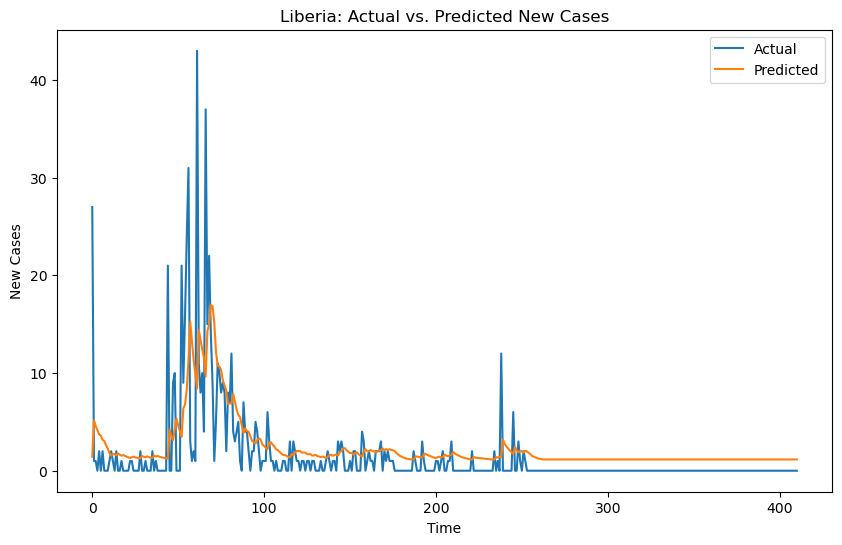

Epoch 1/50
22/22 - 0s - loss: 0.0329 - val_loss: 0.0696 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0168 - val_loss: 0.0404 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0128 - val_loss: 0.0310 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0105 - val_loss: 0.0305 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0100 - val_loss: 0.0297 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0097 - val_loss: 0.0290 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0095 - val_loss: 0.0309 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0097 - val_loss: 0.0299 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0095 - val_loss: 0.0285 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0093 - val_loss: 0.0290 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0095 - val_loss: 0.0284 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0093 - val_loss: 0.0286 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

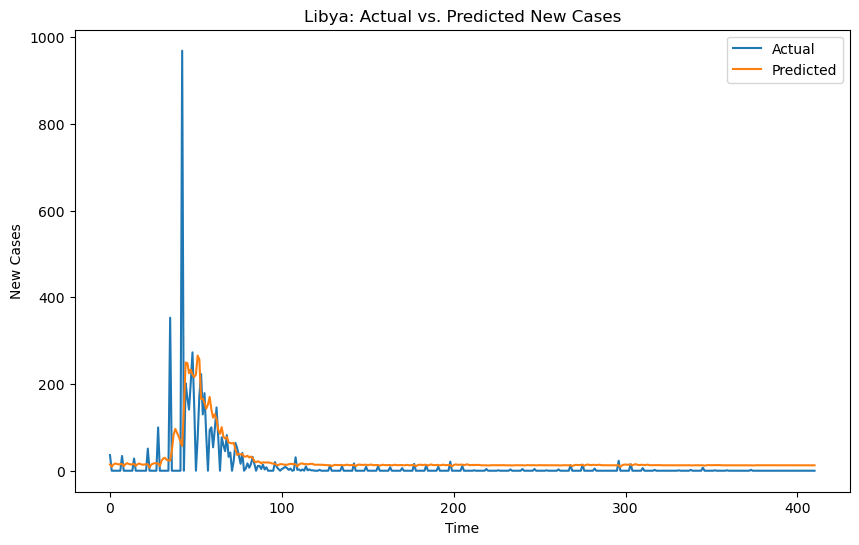

Epoch 1/50
22/22 - 0s - loss: 0.0181 - val_loss: 0.1961 - 396ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0073 - val_loss: 5.4213 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0060 - val_loss: 1.1282 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.9579 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.3031 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0053 - val_loss: 0.4990 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0052 - val_loss: 0.4200 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0052 - val_loss: 0.2289 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.2637 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.2037 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0048 - val_loss: 0.1657 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0050 - val_loss: 0.1514 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

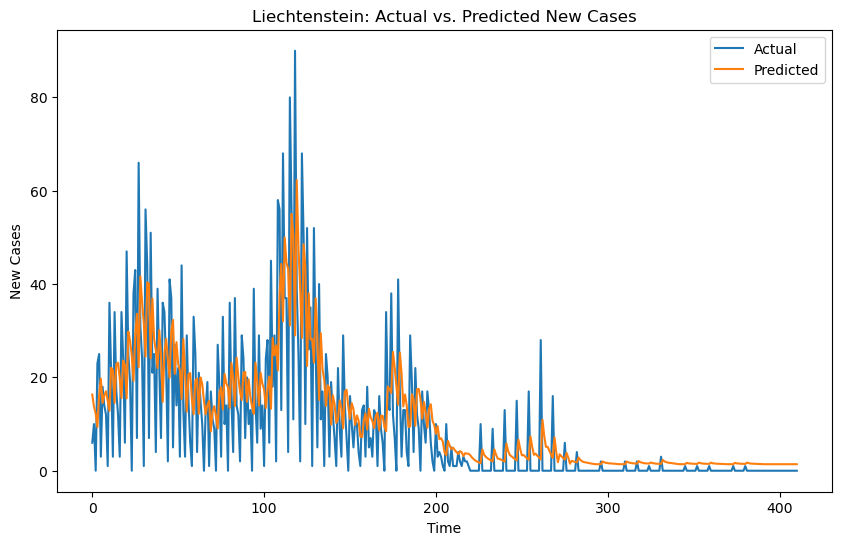

Epoch 1/50
22/22 - 0s - loss: 0.0413 - val_loss: 0.2656 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0107 - val_loss: 3.5961 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0076 - val_loss: 4.0259 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0072 - val_loss: 2.0694 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0071 - val_loss: 1.6078 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0071 - val_loss: 0.8987 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.6758 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.4697 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.5165 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.4798 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0066 - val_loss: 0.4757 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0067 - val_loss: 0.3778 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

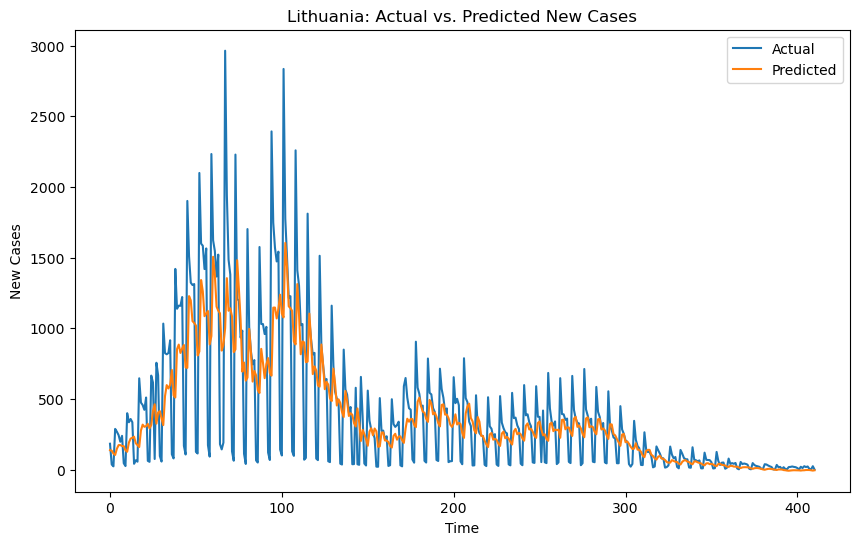

Epoch 1/50
22/22 - 0s - loss: 0.0160 - val_loss: 0.8338 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0156 - val_loss: 0.8283 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0155 - val_loss: 0.8189 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0151 - val_loss: 0.7886 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0147 - val_loss: 0.7304 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0139 - val_loss: 0.8169 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0130 - val_loss: 23.2797 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0125 - val_loss: 145.4347 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0108 - val_loss: 746.1150 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0094 - val_loss: 1616.0145 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0089 - val_loss: 632.7679 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0084 - val_loss: 1126.8041 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s

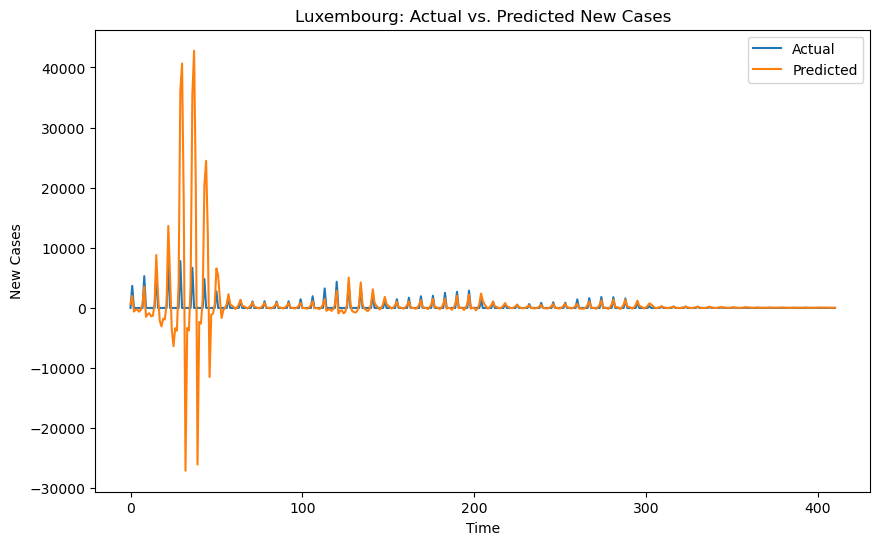

Epoch 1/50
22/22 - 0s - loss: 0.0165 - val_loss: 0.2700 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0099 - val_loss: 0.2779 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0096 - val_loss: 0.2763 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0092 - val_loss: 0.2767 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0092 - val_loss: 0.2777 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0093 - val_loss: 0.2772 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0091 - val_loss: 0.2780 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0092 - val_loss: 0.2780 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0091 - val_loss: 0.2786 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0090 - val_loss: 0.2791 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0089 - val_loss: 0.2794 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0089 - val_loss: 0.2797 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

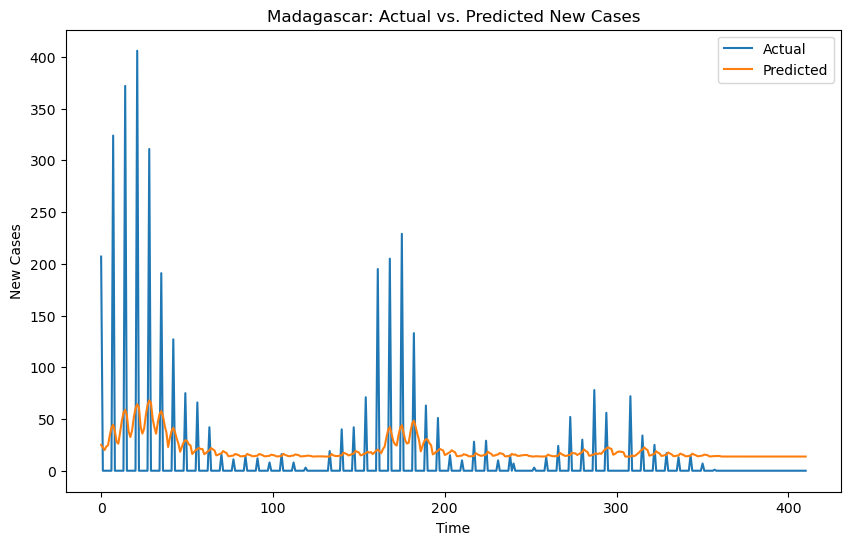

Epoch 1/50
22/22 - 0s - loss: 0.0200 - val_loss: 0.0288 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0080 - val_loss: 0.0145 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0043 - val_loss: 0.0135 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0131 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0126 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0123 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0124 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0119 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0118 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.0114 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.0111 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.0111 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

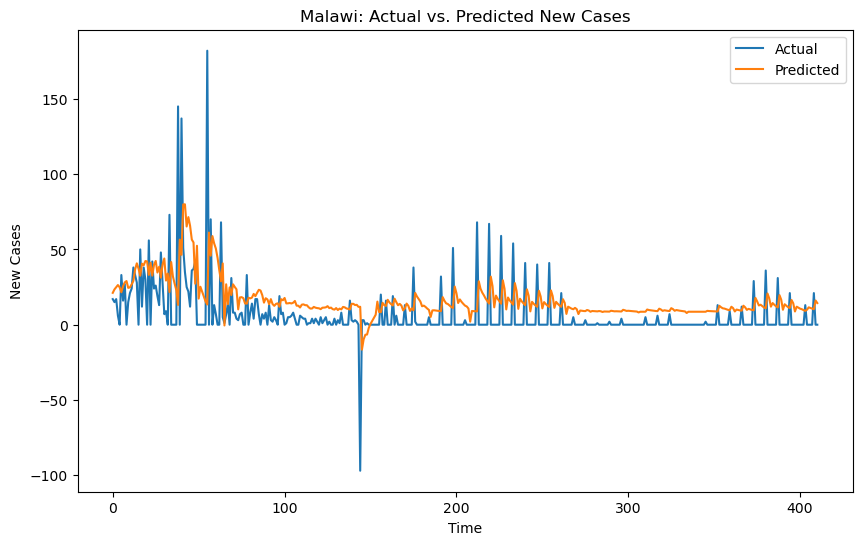

Epoch 1/50
22/22 - 0s - loss: 0.0495 - val_loss: 0.1406 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0147 - val_loss: 0.0188 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0323 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0241 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0171 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0191 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0014 - val_loss: 0.0179 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0014 - val_loss: 0.0193 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0014 - val_loss: 0.0177 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0013 - val_loss: 0.0158 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0014 - val_loss: 0.0182 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0013 - val_loss: 0.0170 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

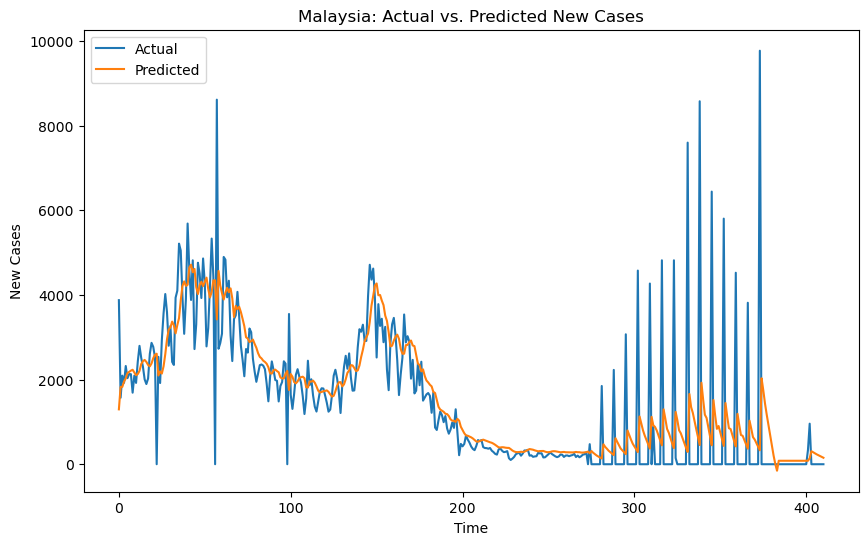

Epoch 1/50
22/22 - 0s - loss: 0.0092 - val_loss: 0.0604 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.0212 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0267 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0181 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0186 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0020 - val_loss: 0.0167 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0164 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0153 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0145 - 38ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0133 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0121 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0112 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

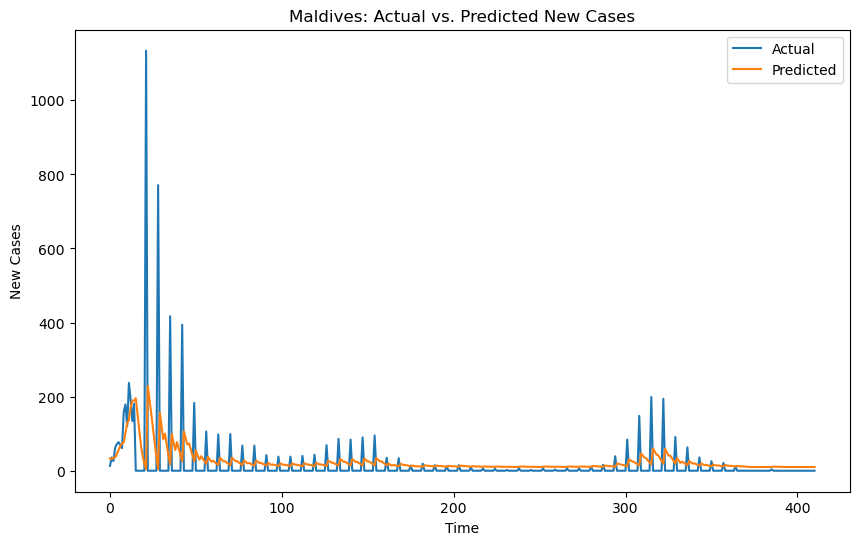

Epoch 1/50
22/22 - 0s - loss: 0.0070 - val_loss: 0.0919 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.0664 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0717 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0727 - 36ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0647 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0631 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0584 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0575 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0560 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0546 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0536 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0526 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

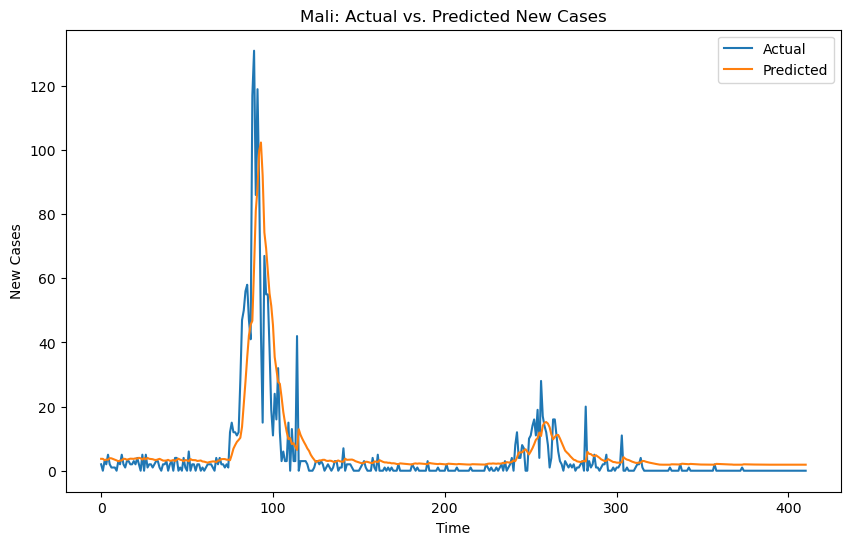

Epoch 1/50
22/22 - 0s - loss: 0.0118 - val_loss: 0.2766 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0114 - val_loss: 0.2729 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0111 - val_loss: 0.2647 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0107 - val_loss: 0.2490 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0101 - val_loss: 0.2371 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0095 - val_loss: 0.2397 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0090 - val_loss: 0.3718 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0086 - val_loss: 1.7825 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0078 - val_loss: 28.5489 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0073 - val_loss: 43.7887 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0074 - val_loss: 41.7755 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0074 - val_loss: 22.9330 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 

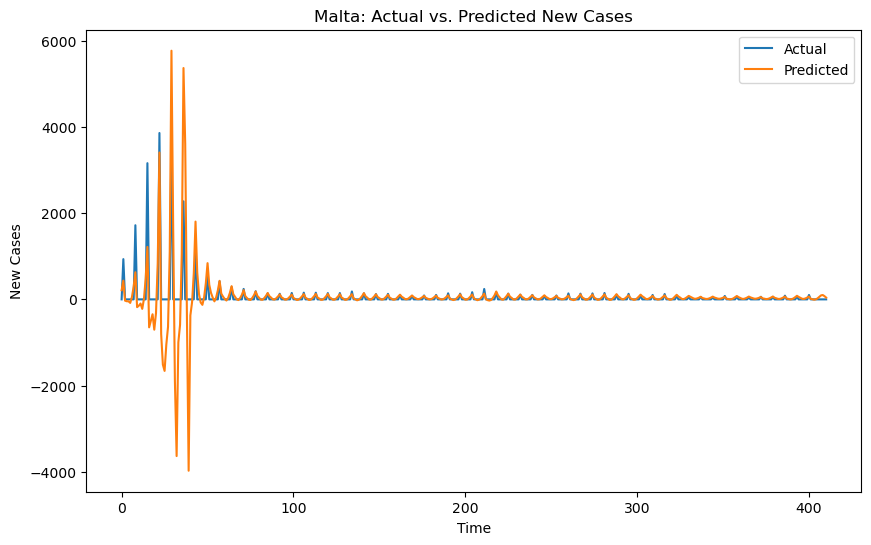

Epoch 1/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0424 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0424 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0422 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0423 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0423 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0422 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0422 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0422 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0420 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0422 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0420 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0422 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

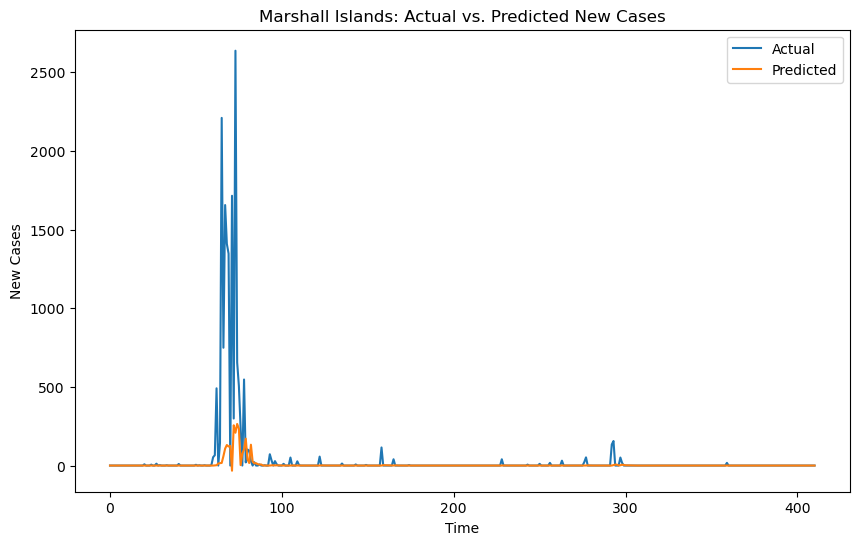

Epoch 1/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.1262 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.1172 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0036 - val_loss: 0.1102 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.1081 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.1084 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.1097 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.1080 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.1078 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.1081 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.1076 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.1082 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.1083 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

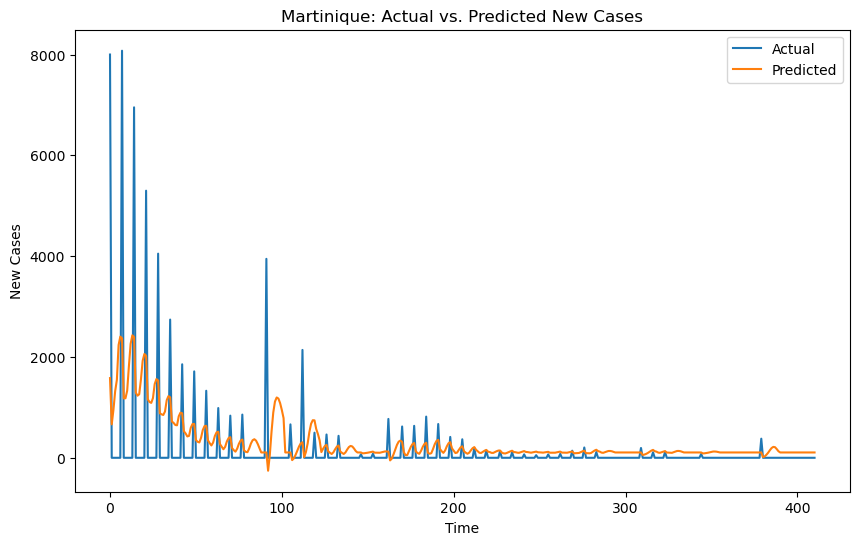

Epoch 1/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0076 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0021 - val_loss: 0.0059 - 40ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0020 - val_loss: 0.0045 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0020 - val_loss: 0.0040 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0040 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0037 - 43ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0038 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0041 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0049 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0040 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0042 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0046 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

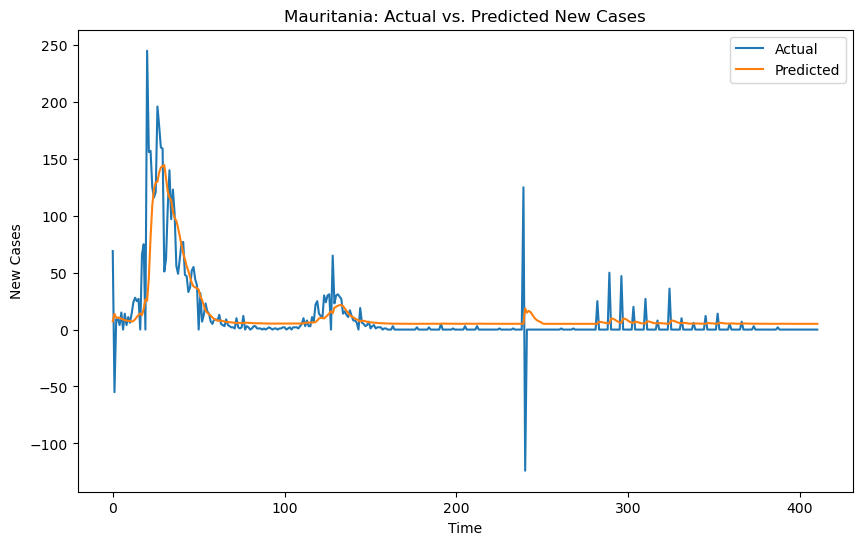

Epoch 1/50
22/22 - 0s - loss: 0.0134 - val_loss: 0.0615 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.0377 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0348 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0317 - 40ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0284 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.0239 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.0235 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.0221 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.0215 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.0212 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.0215 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.0207 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

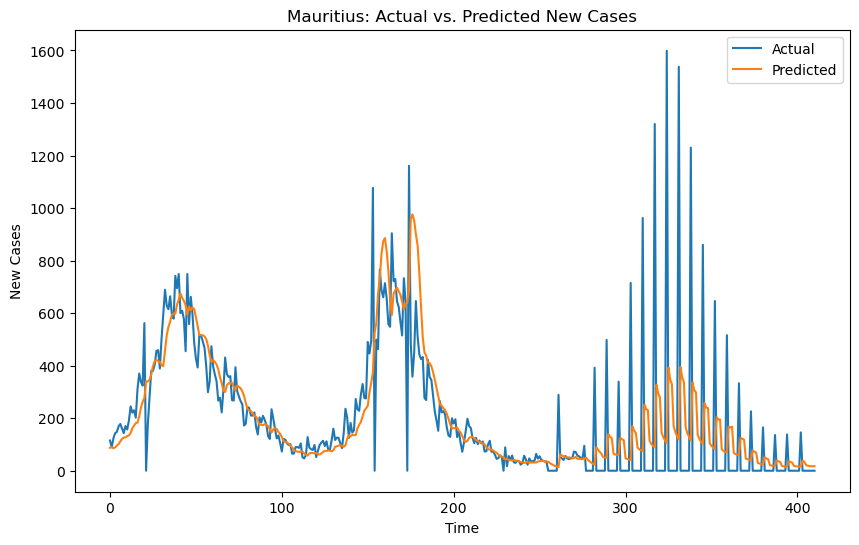

Epoch 1/50
22/22 - 0s - loss: 0.0969 - val_loss: 0.1032 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0100 - val_loss: 0.0646 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0637 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0637 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0638 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0638 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0638 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0638 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0638 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0639 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0639 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0640 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

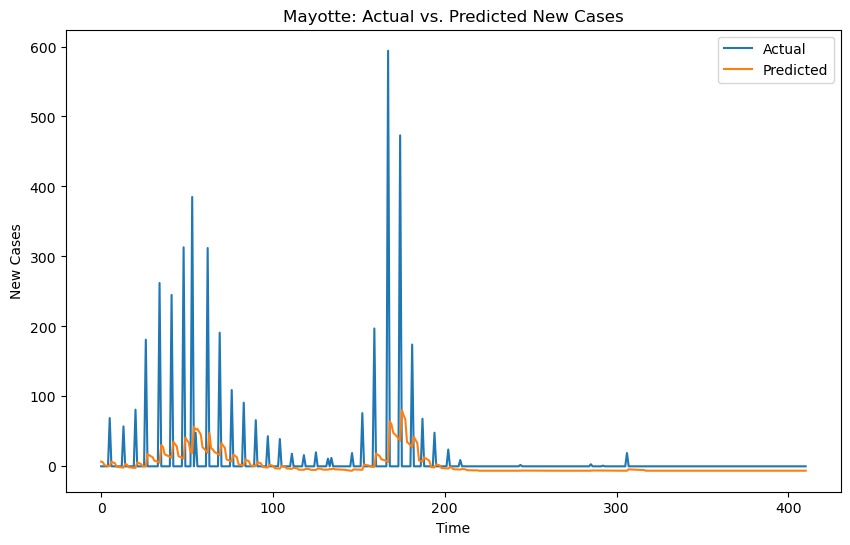

Epoch 1/50
22/22 - 0s - loss: 0.0586 - val_loss: 0.2247 - 394ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0174 - val_loss: 0.3580 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0140 - val_loss: 0.9123 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0136 - val_loss: 0.7524 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0134 - val_loss: 0.7064 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0131 - val_loss: 0.5931 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0133 - val_loss: 0.4685 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0132 - val_loss: 0.4982 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0132 - val_loss: 0.2990 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0133 - val_loss: 0.6402 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0128 - val_loss: 0.5086 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0130 - val_loss: 0.5915 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.01

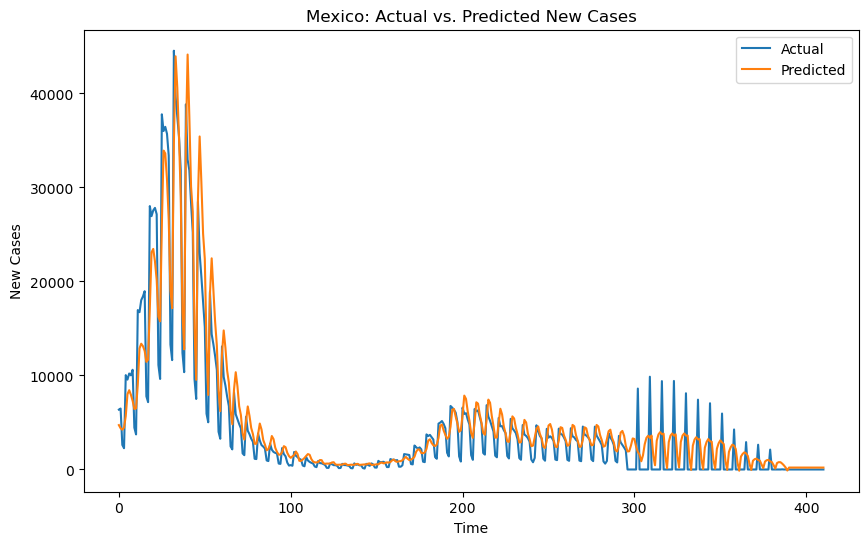

Epoch 1/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 3.2962 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 3.2962 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 3.2962 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 3.2962 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 3.2962 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 3.2962 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 3.2962 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 3.2962 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 3.2962 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 3.2962 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 3.2962 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 3.2962 - 40ms/epoc

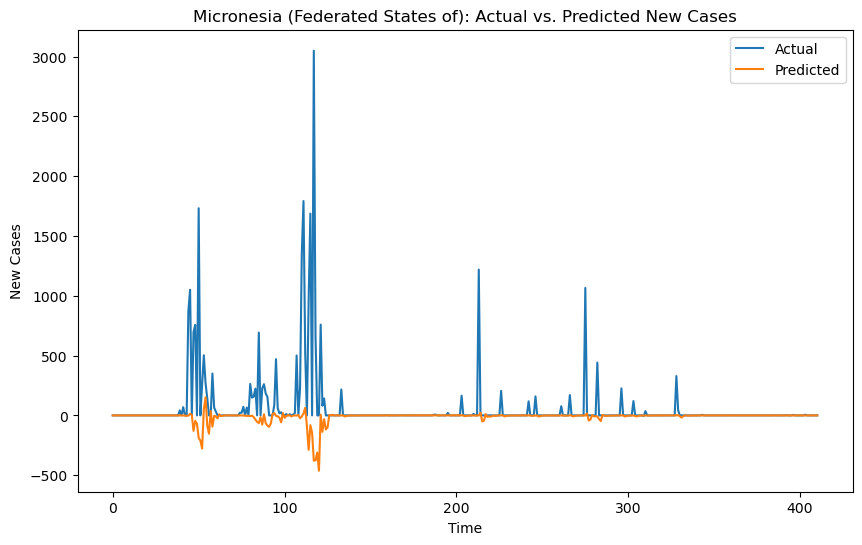

Epoch 1/50
22/22 - 0s - loss: 0.0255 - val_loss: 1.2940 - 385ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0168 - val_loss: 0.7065 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0128 - val_loss: 6.2815 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0111 - val_loss: 28.7358 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0107 - val_loss: 18.0565 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0111 - val_loss: 21.8146 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0109 - val_loss: 15.6069 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0108 - val_loss: 8.9819 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0108 - val_loss: 13.1028 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0106 - val_loss: 16.3362 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0105 - val_loss: 9.7671 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0108 - val_loss: 11.3777 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - los

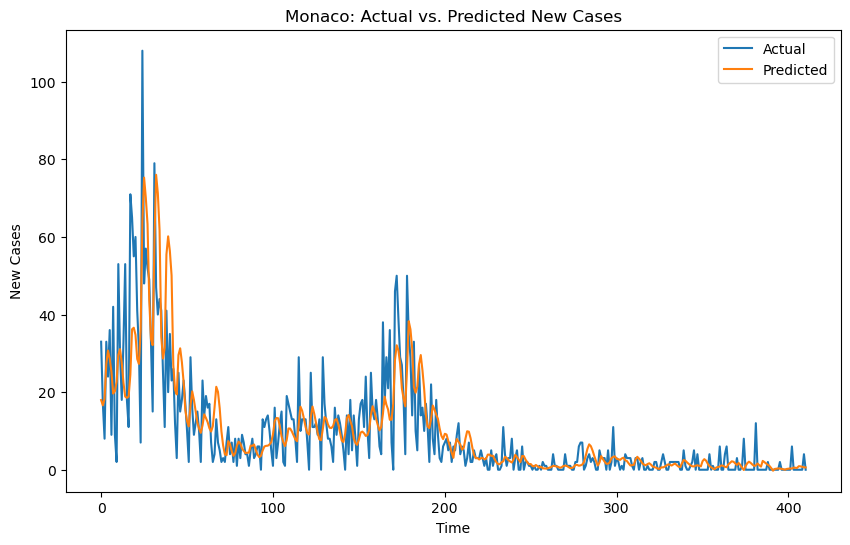

Epoch 1/50
22/22 - 0s - loss: 0.0066 - val_loss: 0.0068 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0047 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0031 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0033 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0030 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0031 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0030 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0030 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0031 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0030 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0029 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0029 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

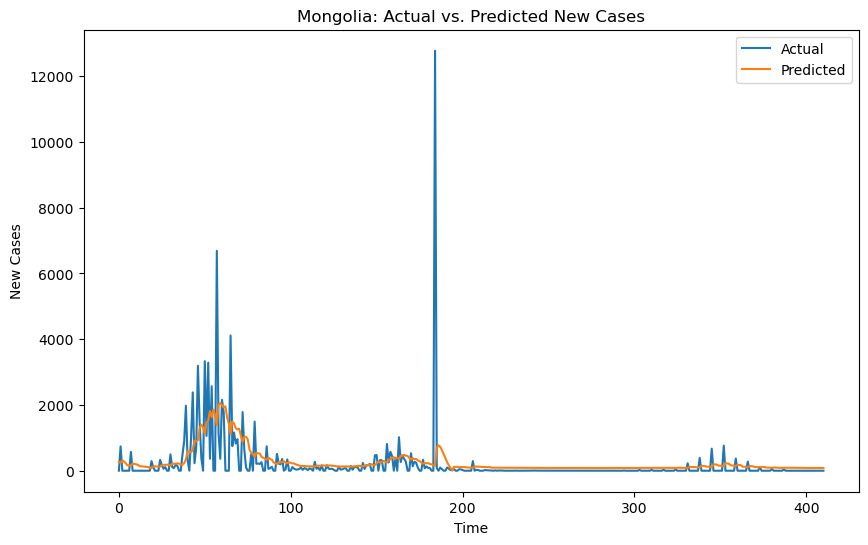

Epoch 1/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.0178 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.0178 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.0177 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0048 - val_loss: 0.0176 - 36ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0048 - val_loss: 0.0177 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0048 - val_loss: 0.0174 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0047 - val_loss: 0.0172 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.0171 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0047 - val_loss: 0.0173 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0044 - val_loss: 0.0170 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.0171 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0044 - val_loss: 0.0169 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

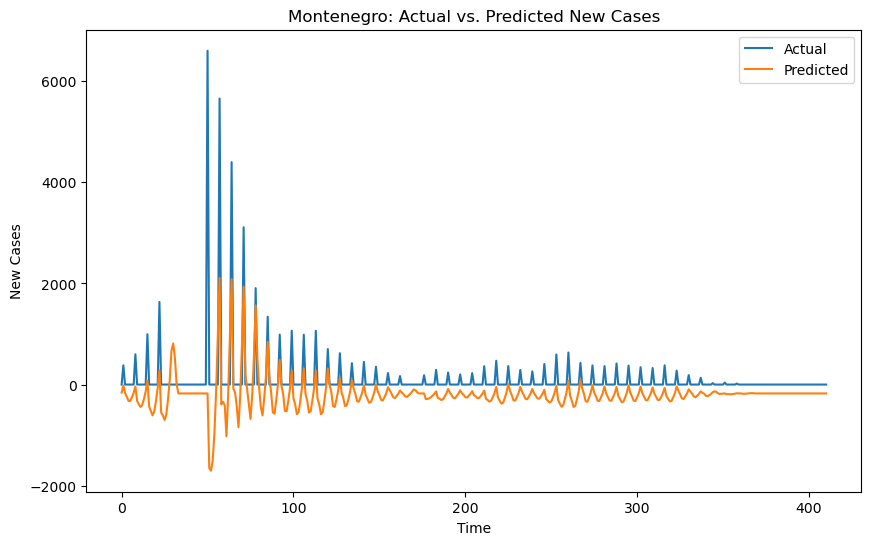

Epoch 1/50
22/22 - 0s - loss: 0.0040 - val_loss: 13.7110 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0040 - val_loss: 13.5911 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0040 - val_loss: 13.4236 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0040 - val_loss: 13.4552 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0040 - val_loss: 13.3100 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0040 - val_loss: 13.3805 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0040 - val_loss: 13.2604 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0041 - val_loss: 13.4988 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0040 - val_loss: 13.2795 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0040 - val_loss: 13.4382 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0040 - val_loss: 13.4198 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0040 - val_loss: 13.4433 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s 

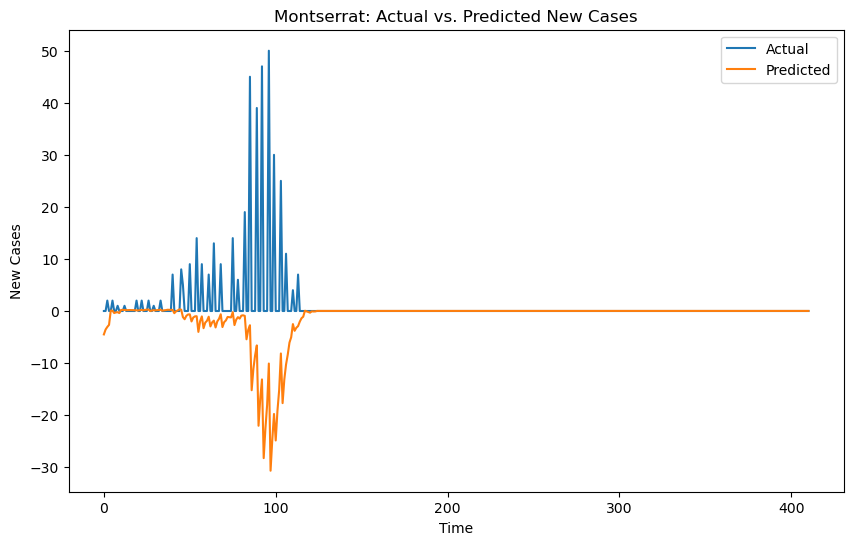

Epoch 1/50
22/22 - 0s - loss: 0.0260 - val_loss: 0.0226 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0125 - val_loss: 0.0125 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0096 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.0093 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0047 - val_loss: 0.0089 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.0089 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0044 - val_loss: 0.0088 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.0087 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0044 - val_loss: 0.0086 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0044 - val_loss: 0.0086 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0044 - val_loss: 0.0084 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0044 - val_loss: 0.0084 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

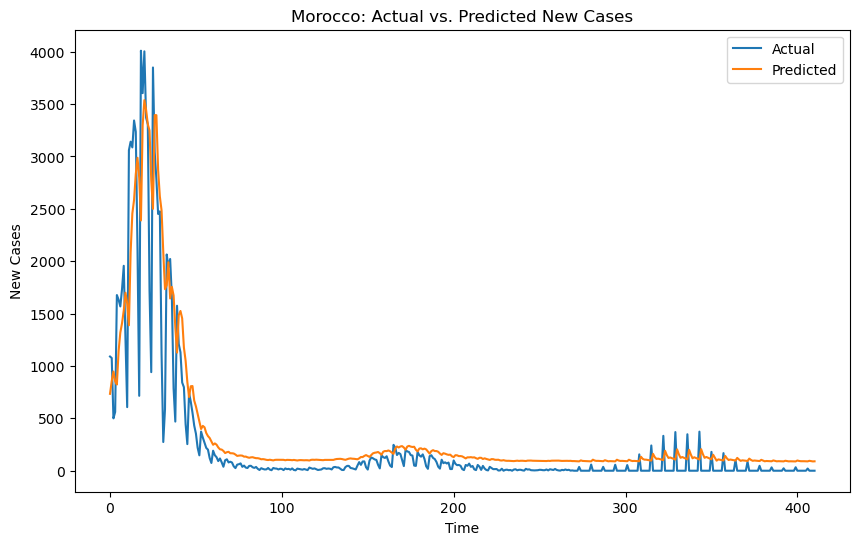

Epoch 1/50
22/22 - 0s - loss: 0.0194 - val_loss: 0.1158 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0063 - val_loss: 0.1052 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0036 - val_loss: 0.1046 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0993 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0970 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0035 - val_loss: 0.0975 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0966 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0033 - val_loss: 0.0948 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0946 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.0941 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.0939 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.0935 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

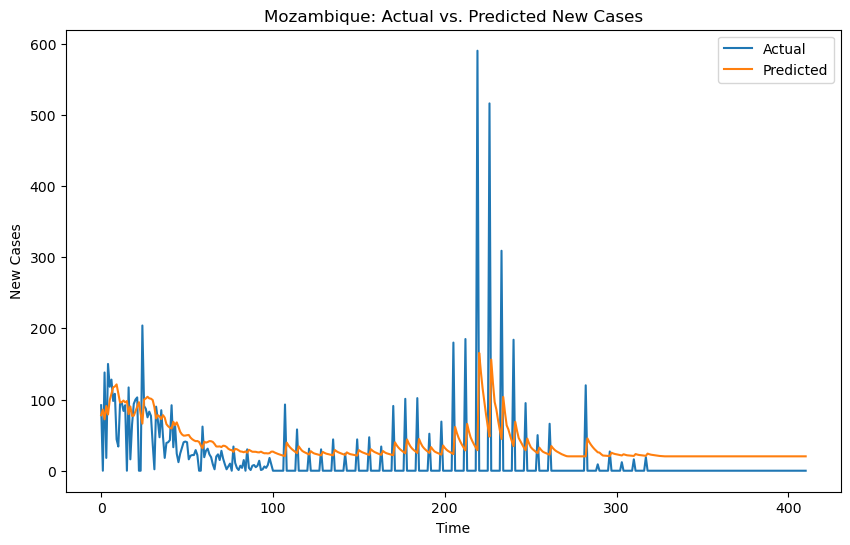

Epoch 1/50
22/22 - 0s - loss: 0.0238 - val_loss: 0.0069 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.0035 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.0032 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0028 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0029 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0026 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0020 - val_loss: 0.0025 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0020 - val_loss: 0.0025 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0025 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0027 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0023 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0022 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

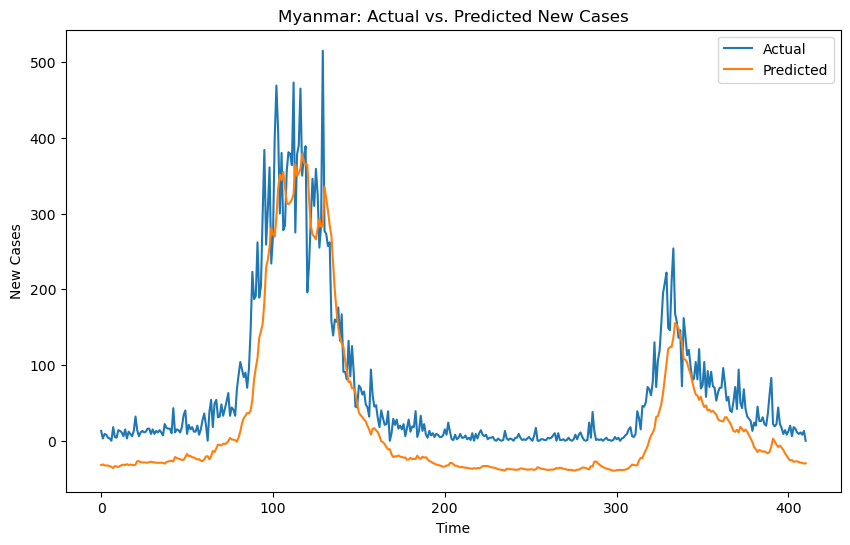

Epoch 1/50
22/22 - 0s - loss: 0.0142 - val_loss: 0.0069 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.0036 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.0035 - 40ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.0032 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.0031 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.0032 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.0033 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0031 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0031 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.0031 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.0030 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0031 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

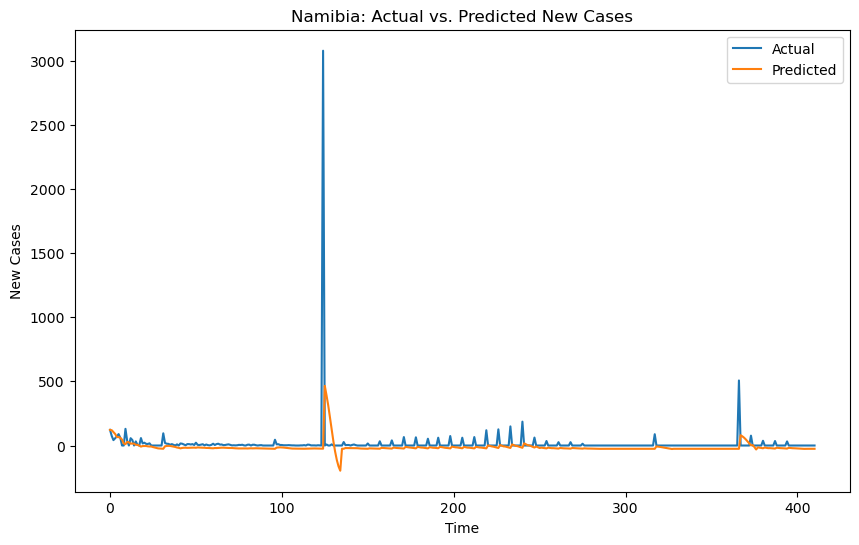

Epoch 1/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0311 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0311 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0311 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0311 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0311 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0311 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0311 - 42ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0311 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0311 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0311 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0311 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0311 - 40ms/epoc

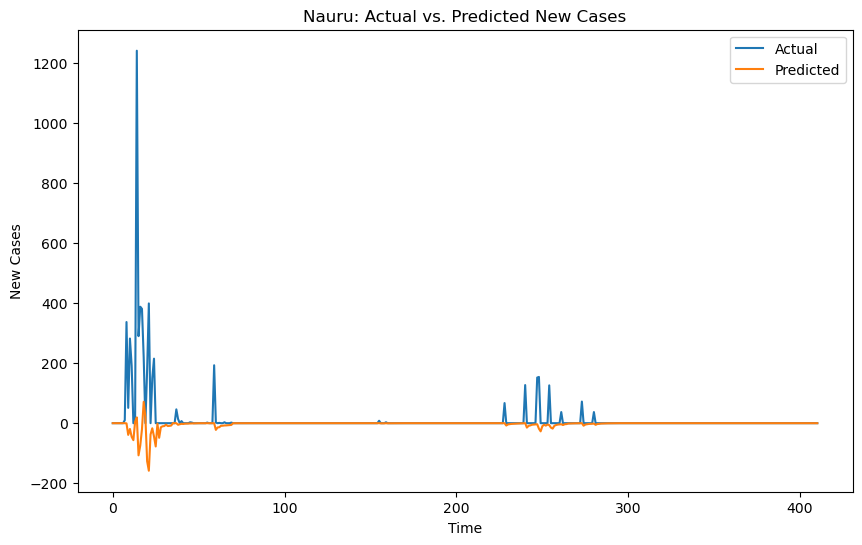

Epoch 1/50
22/22 - 0s - loss: 0.0391 - val_loss: 0.0337 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0109 - val_loss: 0.0170 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0043 - val_loss: 0.0139 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0131 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.0121 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.0108 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.0099 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0094 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0083 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0076 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0071 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0070 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

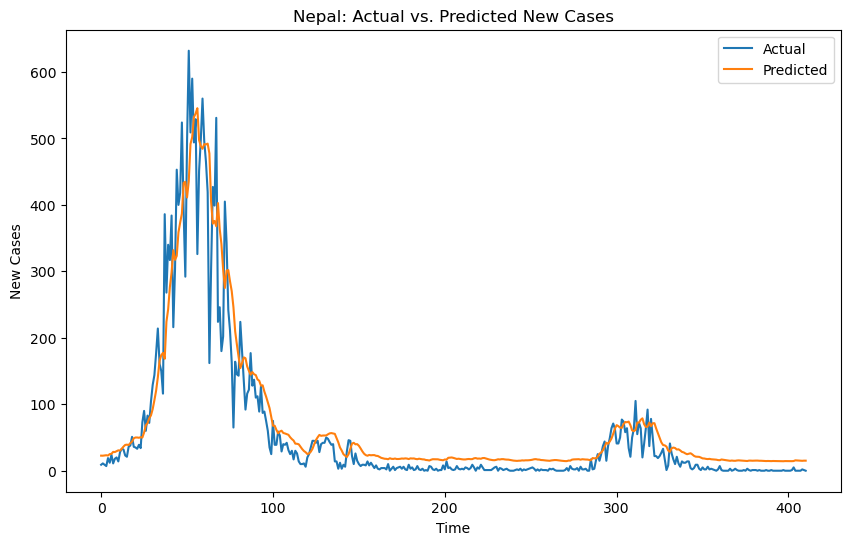

Epoch 1/50
22/22 - 0s - loss: 0.0101 - val_loss: 0.4936 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0101 - val_loss: 0.4912 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0099 - val_loss: 0.4946 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0099 - val_loss: 0.4786 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0098 - val_loss: 0.4756 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0095 - val_loss: 0.4530 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0092 - val_loss: 0.4212 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0085 - val_loss: 1.2758 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0078 - val_loss: 43.2372 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0074 - val_loss: 29.8161 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0072 - val_loss: 151.0998 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0061 - val_loss: 418.5252 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss

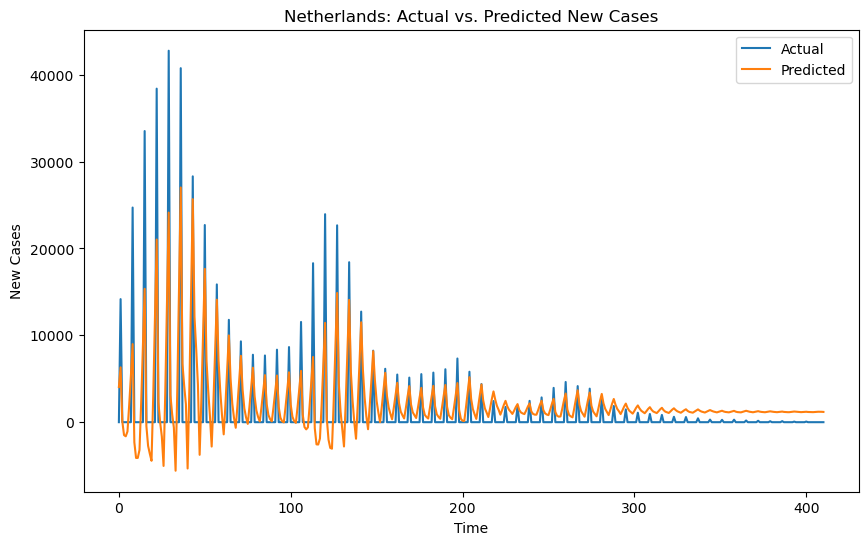

Epoch 1/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.2731 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.2145 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0042 - val_loss: 0.2037 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0042 - val_loss: 0.2042 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.2038 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.2052 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0042 - val_loss: 0.2088 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.2076 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.2055 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.2049 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.2047 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.2041 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

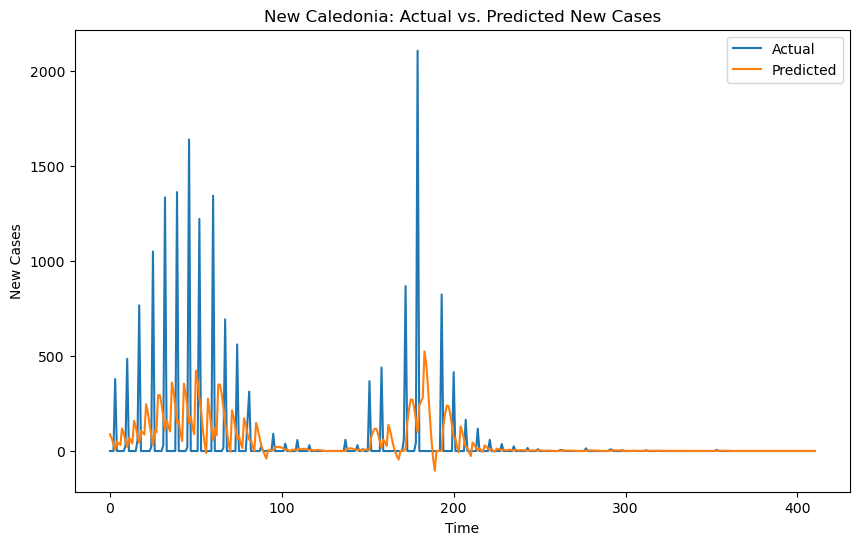

Epoch 1/50
22/22 - 0s - loss: 0.0267 - val_loss: 2356.2234 - 385ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0121 - val_loss: 120991.3281 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0039 - val_loss: 650026.3125 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0034 - val_loss: 336787.9375 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0031 - val_loss: 414885.8438 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0030 - val_loss: 257975.2500 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0030 - val_loss: 240275.6875 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0030 - val_loss: 171699.5469 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0030 - val_loss: 178367.8594 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0028 - val_loss: 162177.3906 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0029 - val_loss: 168406.8750 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0029 - val_loss: 44586.9414 - 

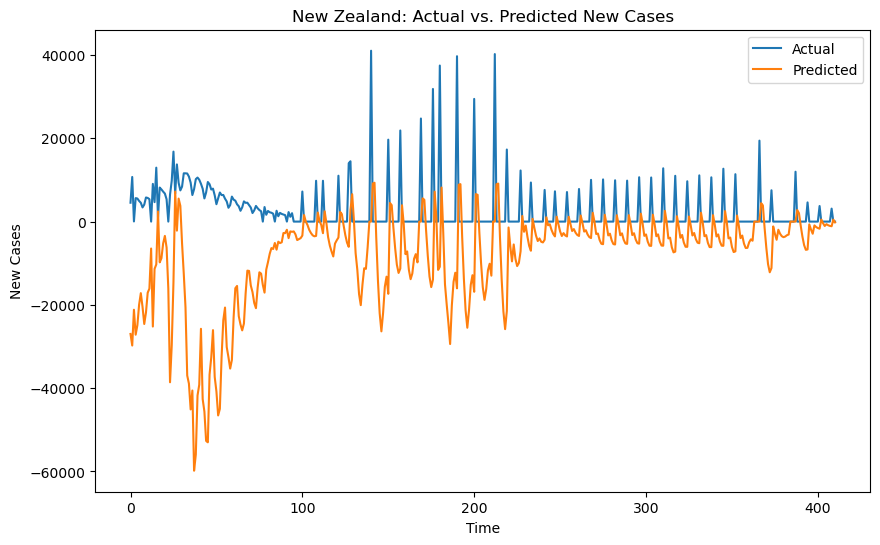

Epoch 1/50
22/22 - 0s - loss: 0.0198 - val_loss: 0.0019 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0191 - val_loss: 0.0015 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0189 - val_loss: 0.0015 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0186 - val_loss: 0.0014 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0181 - val_loss: 0.0016 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0173 - val_loss: 0.0014 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0164 - val_loss: 0.0012 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0155 - val_loss: 0.0041 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0153 - val_loss: 7.8568e-04 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0134 - val_loss: 7.4214e-04 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0119 - val_loss: 6.8432e-04 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0116 - val_loss: 0.0011 - 44ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s 

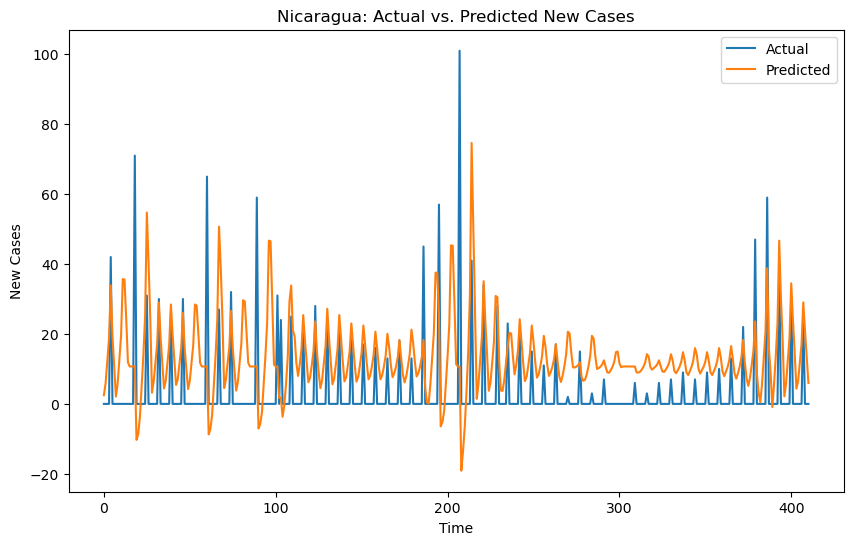

Epoch 1/50
22/22 - 0s - loss: 0.0176 - val_loss: 0.0397 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0104 - val_loss: 0.0354 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0076 - val_loss: 0.0370 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0077 - val_loss: 0.0358 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0077 - val_loss: 0.0349 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0076 - val_loss: 0.0351 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0075 - val_loss: 0.0352 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.0354 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.0346 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.0346 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.0349 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0072 - val_loss: 0.0345 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

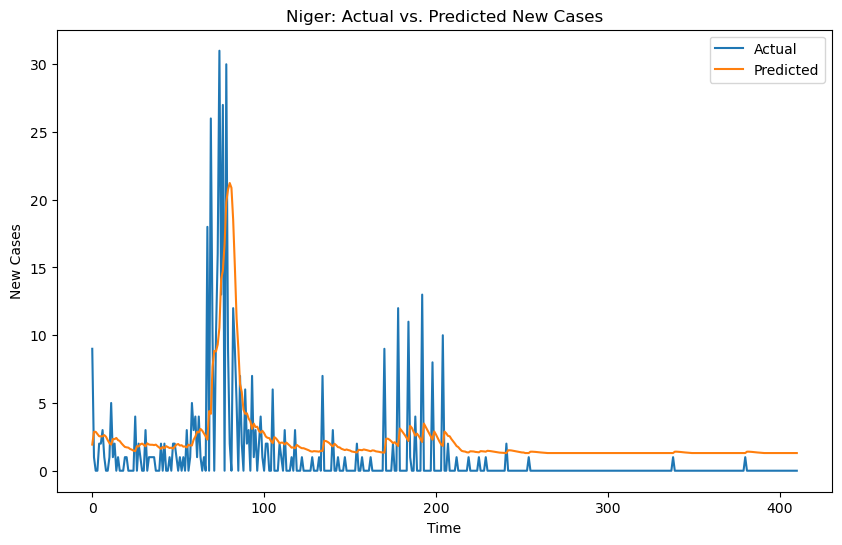

Epoch 1/50
22/22 - 0s - loss: 0.0137 - val_loss: 0.0199 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0050 - val_loss: 0.0170 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0168 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0159 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0158 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0159 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0155 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0154 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0158 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0154 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0153 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0151 - 42ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

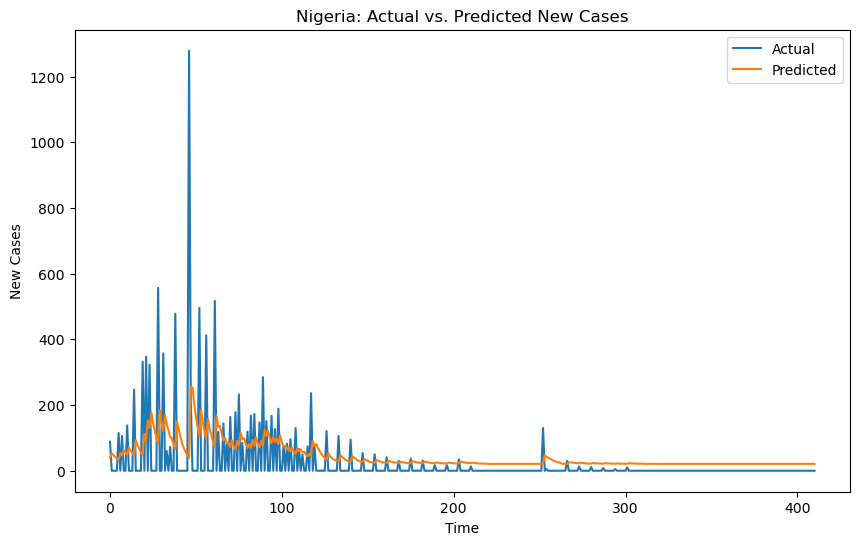

Epoch 1/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.1387 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.1387 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.1387 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.1387 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.1387 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.1387 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.1387 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.1387 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.1387 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.1387 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.1387 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.1387 - 41ms/epoc

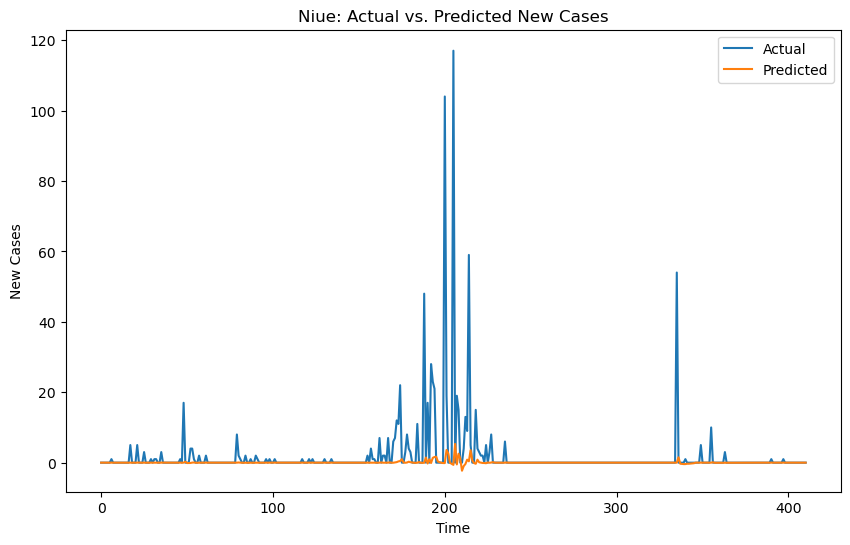

Epoch 1/50
22/22 - 0s - loss: 0.0210 - val_loss: 0.0640 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0206 - val_loss: 0.0633 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0200 - val_loss: 0.0608 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0191 - val_loss: 0.0570 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0185 - val_loss: 0.0529 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0168 - val_loss: 0.0477 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0155 - val_loss: 0.0414 - 42ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0128 - val_loss: 0.0422 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0117 - val_loss: 0.0330 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0105 - val_loss: 0.0380 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0105 - val_loss: 0.0315 - 42ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0125 - val_loss: 0.0346 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.01

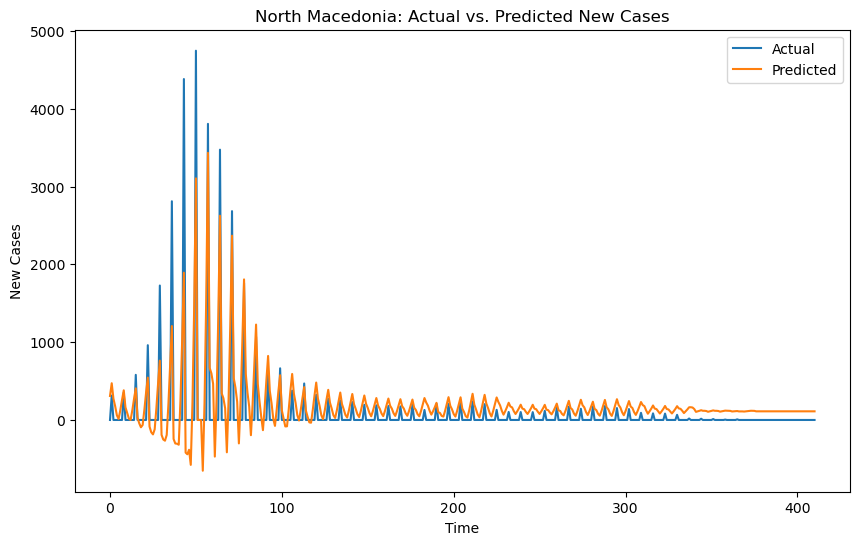

Epoch 1/50
22/22 - 0s - loss: 0.0069 - val_loss: 0.5049 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0057 - val_loss: 0.3178 - 41ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0048 - val_loss: 0.1817 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.5447 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0041 - val_loss: 1.0906 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0043 - val_loss: 0.6377 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.2652 - 43ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0042 - val_loss: 0.2629 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.5174 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.2839 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.2394 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.2774 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

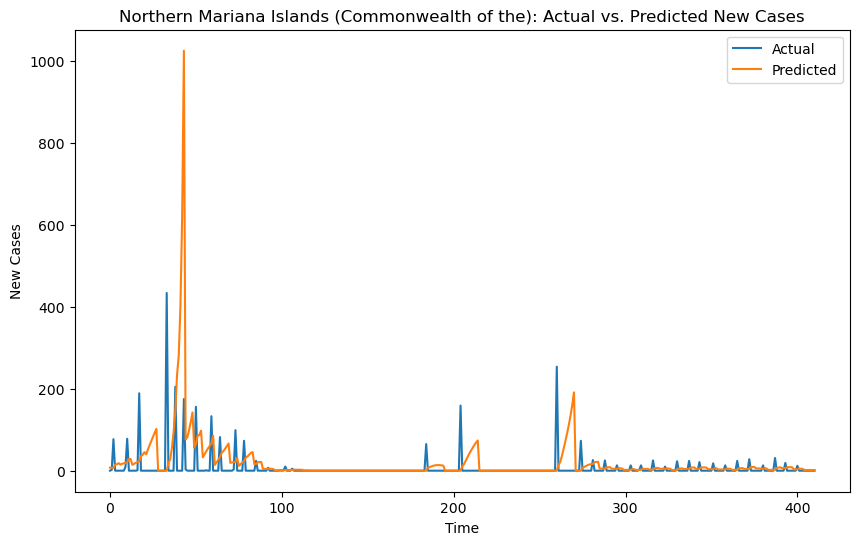

Epoch 1/50
22/22 - 0s - loss: 0.0115 - val_loss: 0.8740 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0047 - val_loss: 47.8198 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0023 - val_loss: 342.4103 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0025 - val_loss: 157.3536 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0023 - val_loss: 170.4333 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0023 - val_loss: 134.9726 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0022 - val_loss: 125.3327 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0023 - val_loss: 158.7258 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0022 - val_loss: 115.0425 - 42ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0022 - val_loss: 145.8488 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0022 - val_loss: 128.5498 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0023 - val_loss: 169.5693 - 41ms/epoch - 2ms/step
Epoch 13/50
22

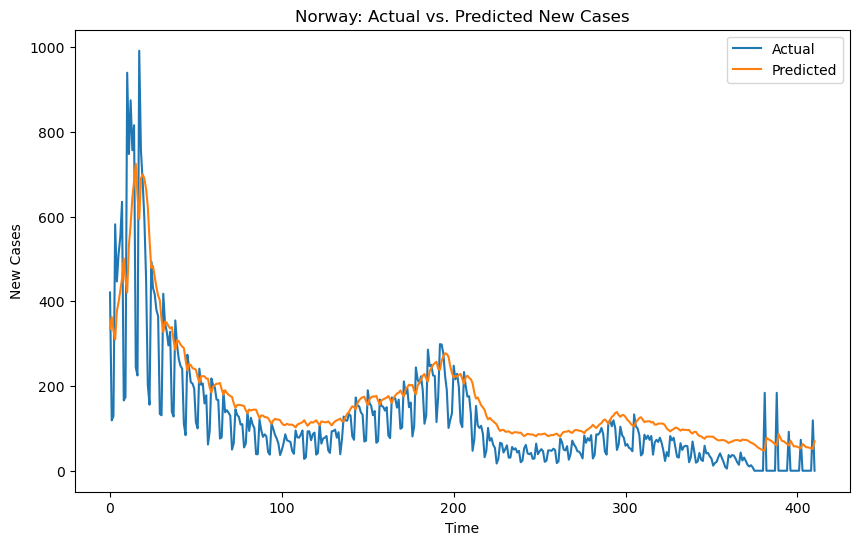

Epoch 1/50
22/22 - 0s - loss: 0.1007 - val_loss: 0.5540 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0485 - val_loss: 0.2423 - 40ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0136 - val_loss: 1.0943 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0086 - val_loss: 1.0535 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.7687 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0073 - val_loss: 0.5469 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0070 - val_loss: 0.3650 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0073 - val_loss: 0.2801 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0070 - val_loss: 0.2793 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0069 - val_loss: 0.2764 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0069 - val_loss: 0.2729 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0067 - val_loss: 0.2528 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

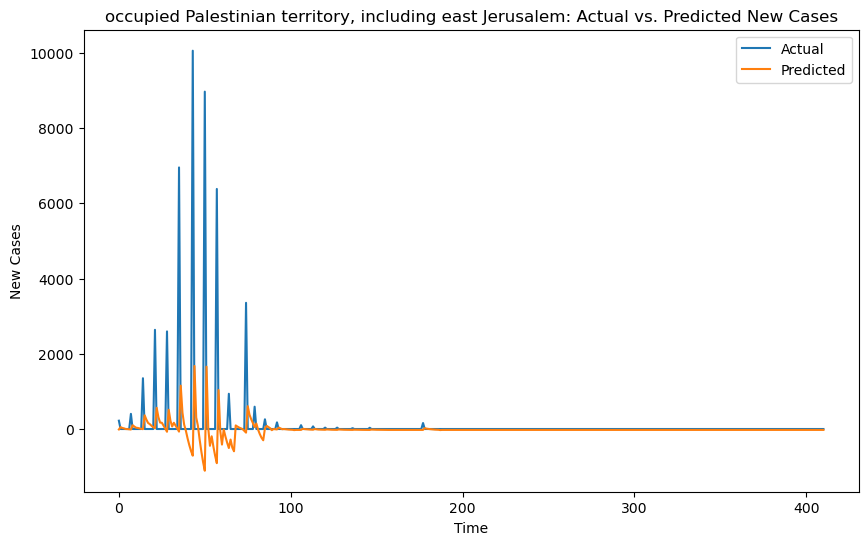

Epoch 1/50
22/22 - 0s - loss: 0.0281 - val_loss: 0.0213 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0163 - val_loss: 0.0113 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0119 - val_loss: 0.0069 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0111 - val_loss: 0.0069 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0109 - val_loss: 0.0064 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0108 - val_loss: 0.0064 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0109 - val_loss: 0.0063 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0109 - val_loss: 0.0071 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0110 - val_loss: 0.0061 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0108 - val_loss: 0.0061 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0111 - val_loss: 0.0061 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0108 - val_loss: 0.0061 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.01

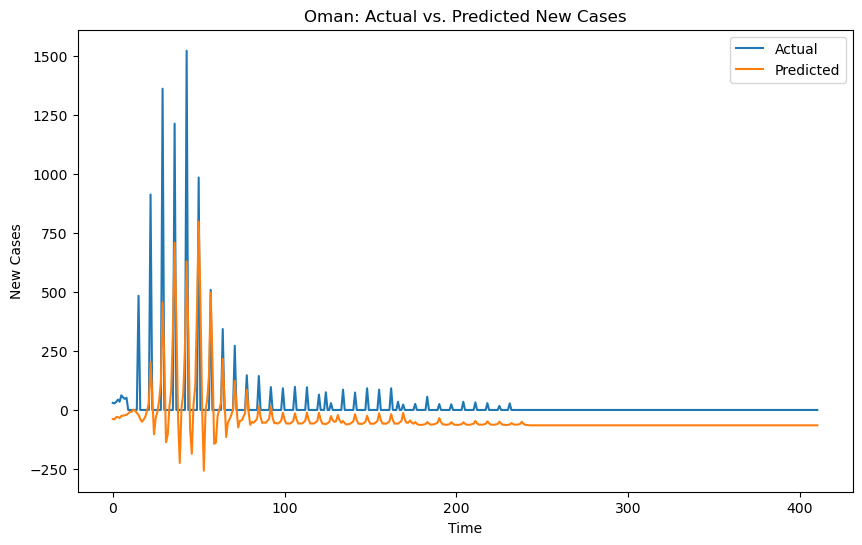

Epoch 1/50
22/22 - 0s - loss: 0.0063 - val_loss: 6.7021e-05 - 395ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0054 - val_loss: 3.1025e-06 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0049 - val_loss: 6.3268e-05 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0046 - val_loss: 2.8735e-05 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0045 - val_loss: 7.8347e-05 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0044 - val_loss: 2.1169e-05 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0043 - val_loss: 5.4875e-05 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0043 - val_loss: 1.7672e-04 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0042 - val_loss: 3.1002e-05 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0042 - val_loss: 1.1604e-06 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0041 - val_loss: 1.6292e-05 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0041 - val_loss: 1.8714e-05 - 41ms/epoc

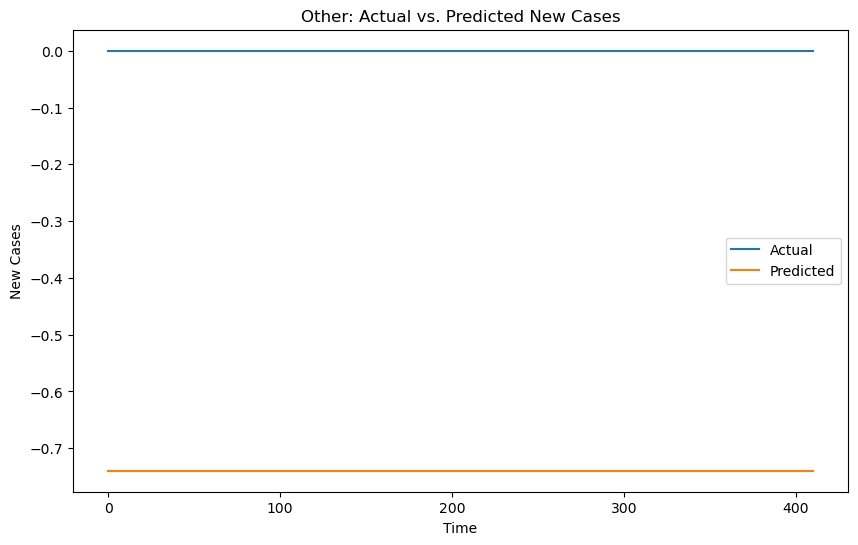

Epoch 1/50
22/22 - 0s - loss: 0.0807 - val_loss: 0.0522 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0153 - val_loss: 0.0208 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0071 - val_loss: 0.0184 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0064 - val_loss: 0.0168 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0056 - val_loss: 0.0152 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.0132 - 42ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0052 - val_loss: 0.0137 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0052 - val_loss: 0.0125 - 42ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.0113 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0047 - val_loss: 0.0113 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0048 - val_loss: 0.0099 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.0094 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

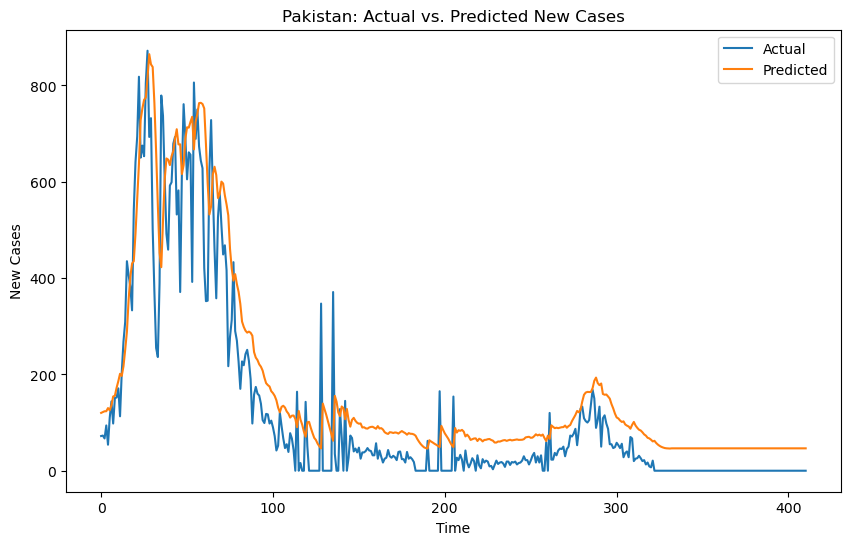

Epoch 1/50
22/22 - 0s - loss: 0.0029 - val_loss: 401.1559 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0029 - val_loss: 389.3134 - 40ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0029 - val_loss: 387.3232 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0029 - val_loss: 390.3396 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0029 - val_loss: 388.8627 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0029 - val_loss: 393.4062 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0029 - val_loss: 399.1508 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0029 - val_loss: 401.0705 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0029 - val_loss: 407.9156 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0029 - val_loss: 412.4039 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0029 - val_loss: 417.6487 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0029 - val_loss: 431.2914 - 41ms/epoch - 2ms/step
Epoch 13/50

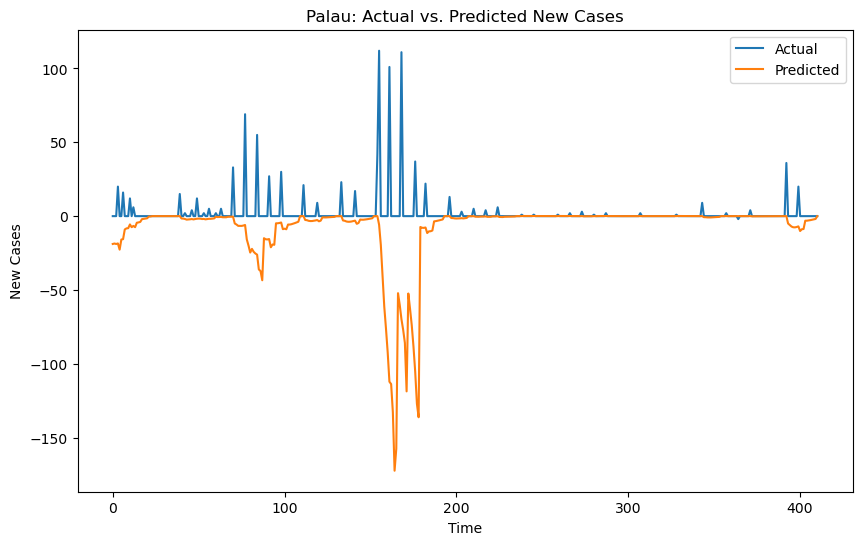

Epoch 1/50
22/22 - 0s - loss: 0.0242 - val_loss: 0.3343 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0094 - val_loss: 0.1911 - 40ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0042 - val_loss: 1.2902 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.5327 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.4004 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.4701 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.3943 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.3469 - 45ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.3600 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.2660 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.2719 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.2835 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

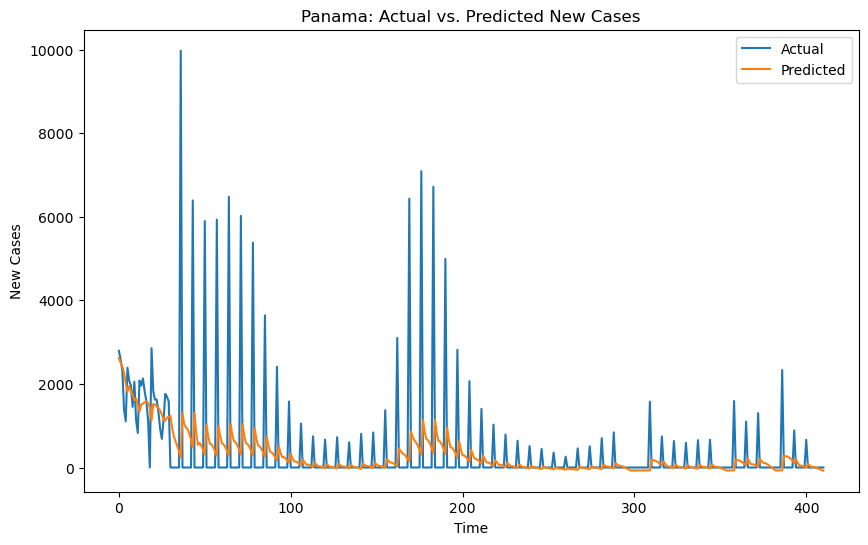

Epoch 1/50
22/22 - 0s - loss: 0.0187 - val_loss: 0.0082 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0127 - val_loss: 0.0070 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0087 - val_loss: 0.0061 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0070 - val_loss: 0.0061 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0069 - val_loss: 0.0063 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0069 - val_loss: 0.0061 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0067 - val_loss: 0.0062 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0067 - val_loss: 0.0062 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.0061 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0066 - val_loss: 0.0062 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0065 - val_loss: 0.0061 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0065 - val_loss: 0.0061 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

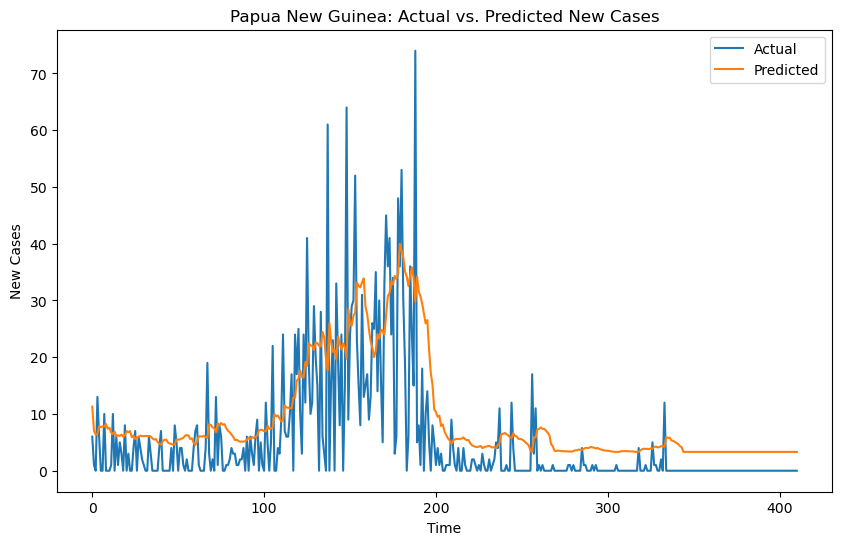

Epoch 1/50
22/22 - 0s - loss: 0.0578 - val_loss: 0.1185 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0135 - val_loss: 0.1132 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0061 - val_loss: 0.3457 - 40ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.1758 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.1217 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0043 - val_loss: 0.1071 - 42ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0042 - val_loss: 0.1076 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0042 - val_loss: 0.0754 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.0664 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.0680 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.0618 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.0742 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

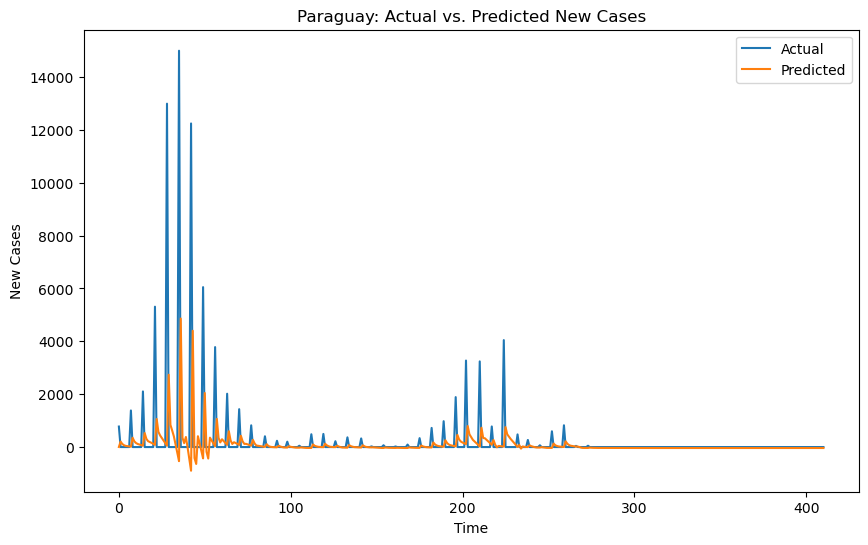

Epoch 1/50
22/22 - 0s - loss: 0.0568 - val_loss: 0.4953 - 392ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0142 - val_loss: 11.0531 - 40ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0078 - val_loss: 73.5138 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0077 - val_loss: 38.2597 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0074 - val_loss: 24.9621 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0075 - val_loss: 15.7682 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0077 - val_loss: 9.4549 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0075 - val_loss: 11.1262 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0074 - val_loss: 16.0101 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0074 - val_loss: 11.2392 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0072 - val_loss: 8.4540 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0071 - val_loss: 10.0291 - 46ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - l

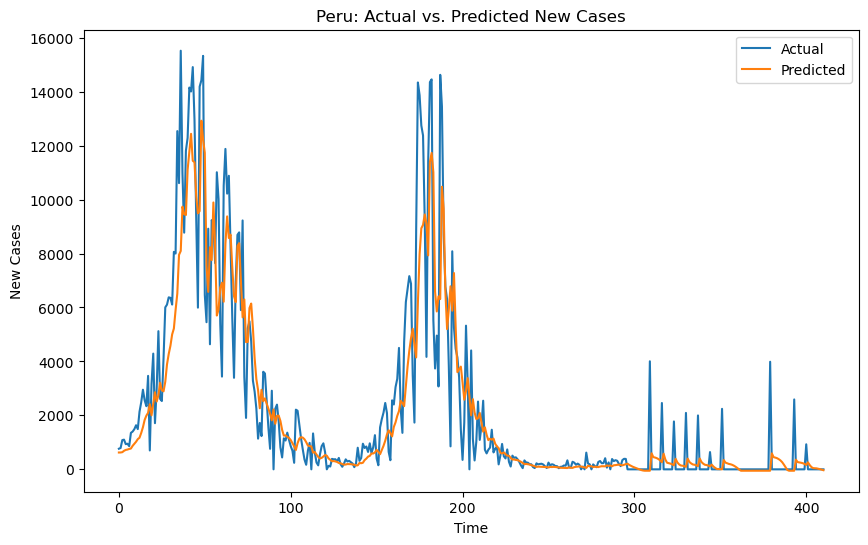

Epoch 1/50
22/22 - 0s - loss: 0.0288 - val_loss: 0.0520 - 395ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0051 - val_loss: 0.0357 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0299 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0295 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0284 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0298 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0283 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0278 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0273 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0264 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0280 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0266 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

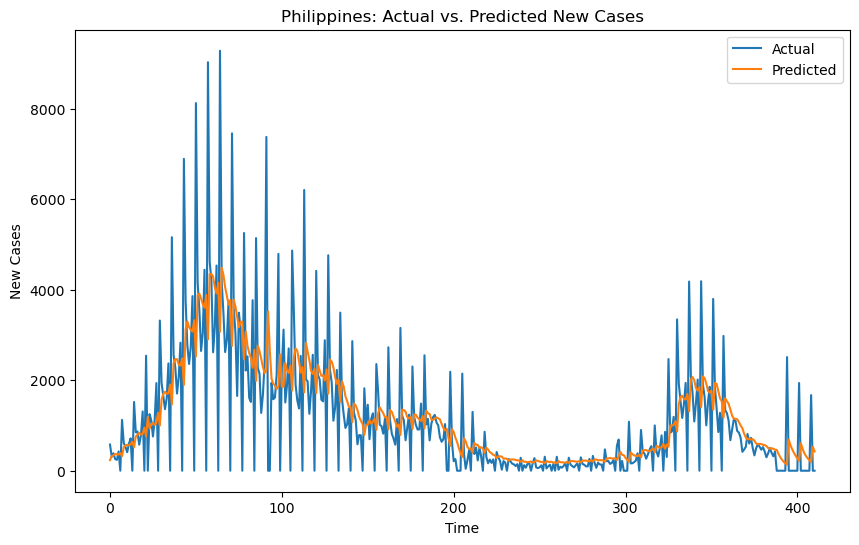

Epoch 1/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 391ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 46ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 42ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 42ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - los

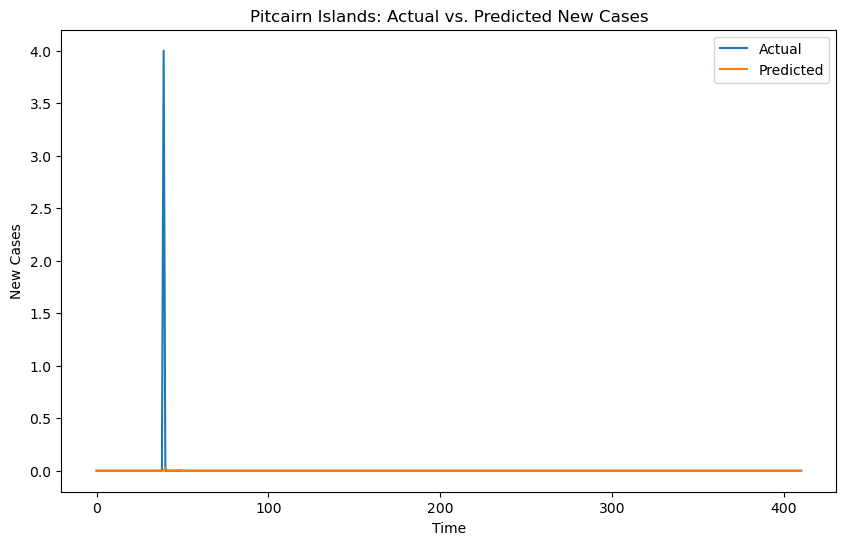

Epoch 1/50
22/22 - 0s - loss: 0.0278 - val_loss: 0.0381 - 391ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0085 - val_loss: 0.0477 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0072 - val_loss: 0.0355 - 40ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0070 - val_loss: 0.0327 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0069 - val_loss: 0.0314 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0067 - val_loss: 0.0296 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0070 - val_loss: 0.0289 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0069 - val_loss: 0.0284 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0064 - val_loss: 0.0278 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0065 - val_loss: 0.0275 - 42ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0064 - val_loss: 0.0267 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0064 - val_loss: 0.0270 - 42ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

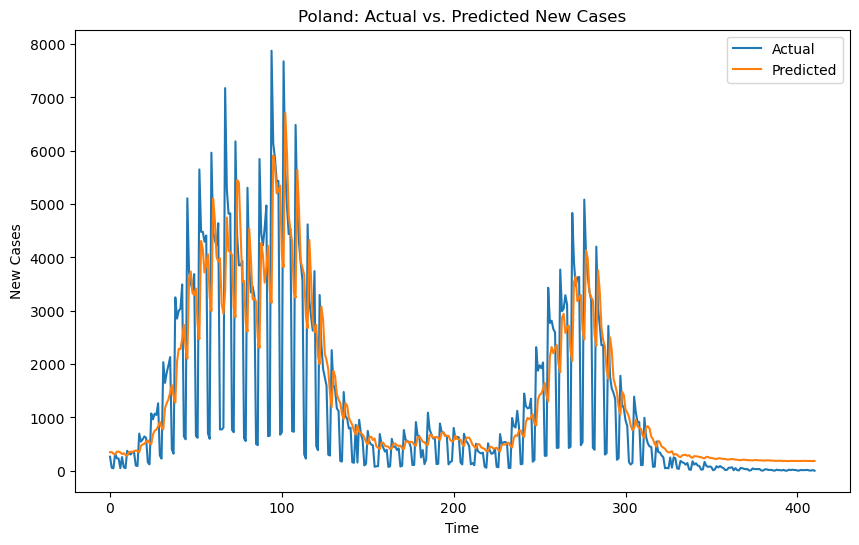

Epoch 1/50
22/22 - 0s - loss: 0.0077 - val_loss: 0.6527 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0076 - val_loss: 0.6436 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0075 - val_loss: 0.6392 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0074 - val_loss: 0.6225 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0073 - val_loss: 0.6032 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0071 - val_loss: 0.5812 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.5429 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0067 - val_loss: 0.5464 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0068 - val_loss: 0.5054 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0066 - val_loss: 0.5566 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0062 - val_loss: 4.9377 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0058 - val_loss: 33.8097 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.0

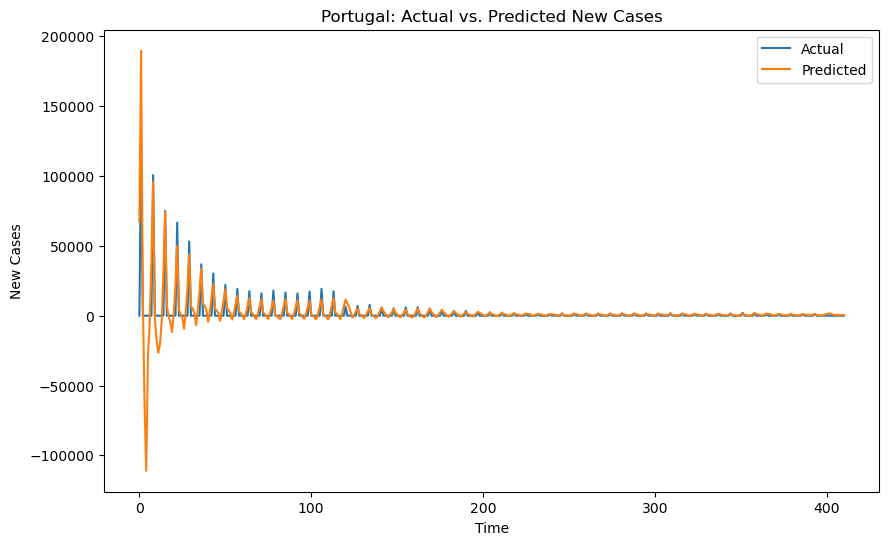

Epoch 1/50
22/22 - 0s - loss: 0.0535 - val_loss: 4.4072 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0250 - val_loss: 110.8247 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0185 - val_loss: 1183.7192 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0171 - val_loss: 702.0293 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0177 - val_loss: 415.4379 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0173 - val_loss: 391.8659 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0169 - val_loss: 253.1814 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0165 - val_loss: 355.5746 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0165 - val_loss: 284.8486 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0162 - val_loss: 208.9785 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0160 - val_loss: 141.0089 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0160 - val_loss: 143.1724 - 41ms/epoch - 2ms/step
Epoch 13/50


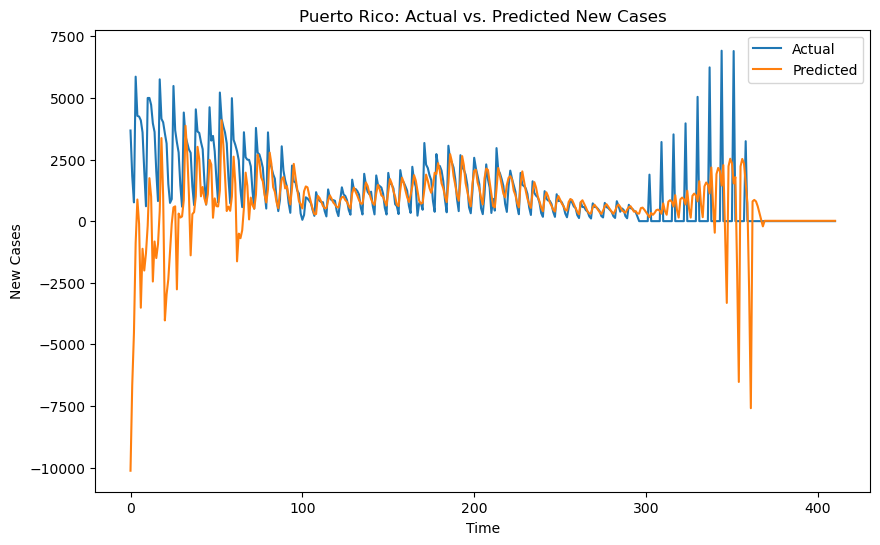

Epoch 1/50
22/22 - 0s - loss: 0.0233 - val_loss: 0.0828 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.0724 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.1479 - 40ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0021 - val_loss: 0.0974 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0020 - val_loss: 0.1088 - 42ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0884 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0941 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0640 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0597 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0626 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0587 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0655 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

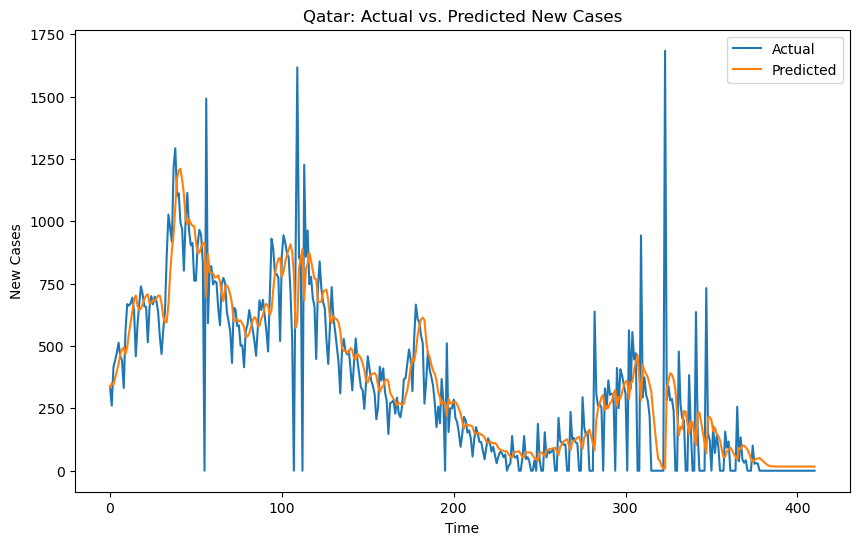

Epoch 1/50
22/22 - 0s - loss: 0.0330 - val_loss: 3167.6133 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0135 - val_loss: 480398.3750 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0042 - val_loss: 2693628.7500 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0021 - val_loss: 2707609.5000 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0018 - val_loss: 2543544.0000 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0017 - val_loss: 2764938.7500 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0017 - val_loss: 2442999.2500 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0017 - val_loss: 2326859.2500 - 39ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0017 - val_loss: 2543645.7500 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0017 - val_loss: 2526528.2500 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0017 - val_loss: 2179555.0000 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0019 - val_loss: 1826

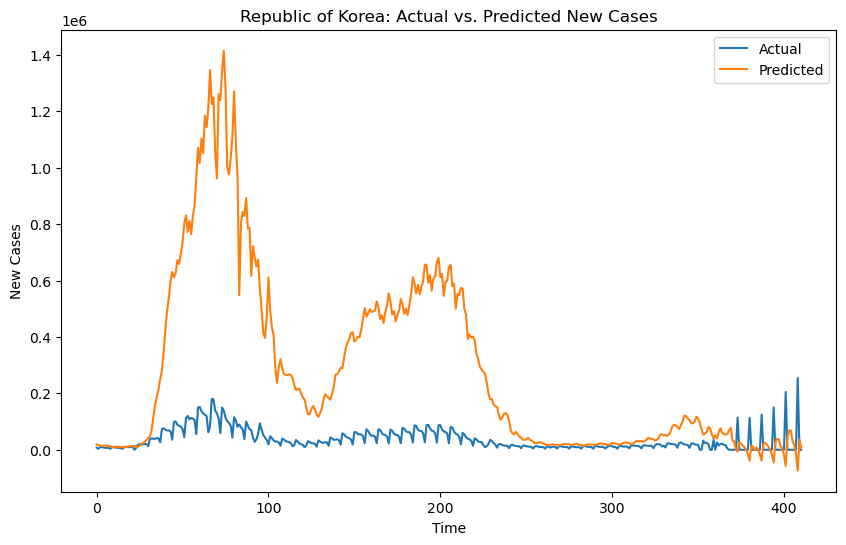

Epoch 1/50
22/22 - 0s - loss: 0.0955 - val_loss: 0.3470 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0378 - val_loss: 0.1085 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0178 - val_loss: 0.3958 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0125 - val_loss: 1.2277 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0127 - val_loss: 0.4760 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0125 - val_loss: 0.6664 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0124 - val_loss: 0.4102 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0121 - val_loss: 0.5196 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0121 - val_loss: 0.3688 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0118 - val_loss: 0.3433 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0118 - val_loss: 0.4801 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0117 - val_loss: 0.3044 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.01

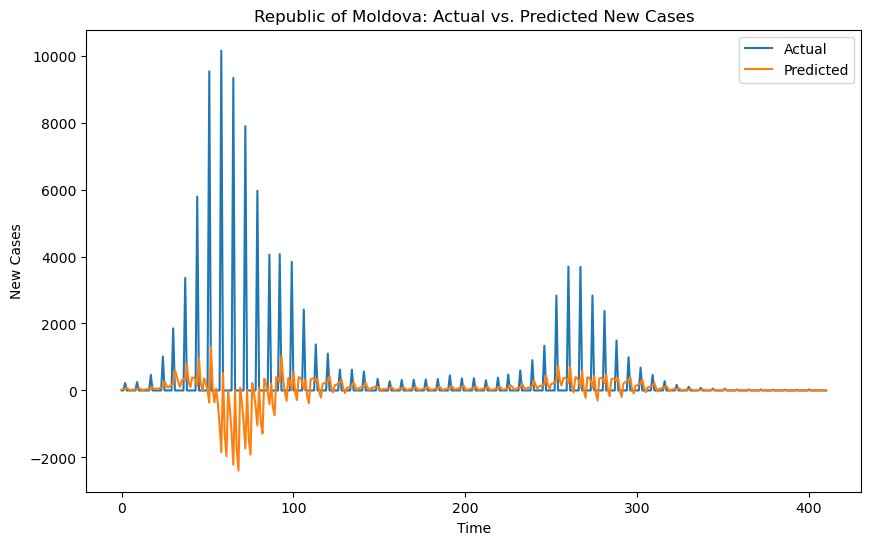

Epoch 1/50
22/22 - 0s - loss: 0.0091 - val_loss: 3.9197 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0089 - val_loss: 3.8957 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0088 - val_loss: 3.8367 - 40ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0087 - val_loss: 3.7427 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0086 - val_loss: 3.6302 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0084 - val_loss: 3.3054 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0082 - val_loss: 10.3367 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0080 - val_loss: 137.6353 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0075 - val_loss: 582.4178 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0073 - val_loss: 972.5012 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0071 - val_loss: 3798.1077 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0068 - val_loss: 1045.3435 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s

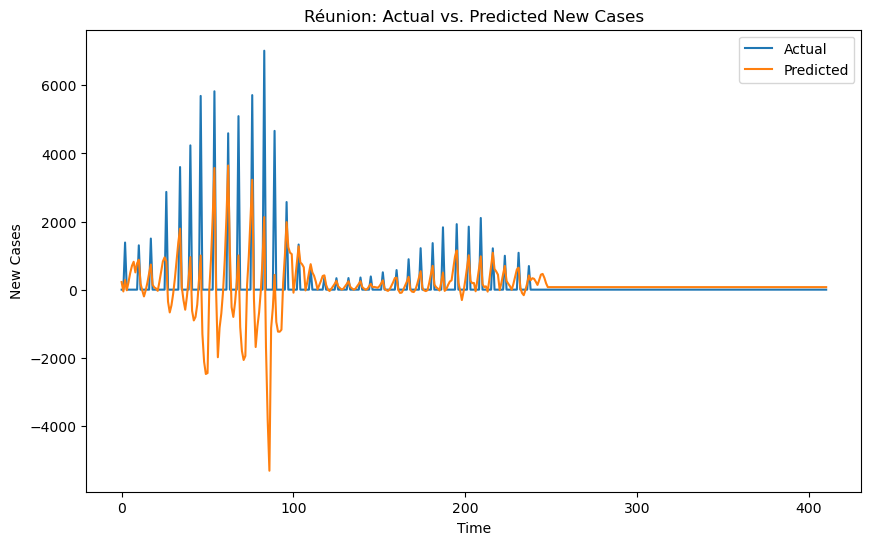

Epoch 1/50
22/22 - 0s - loss: 0.0201 - val_loss: 0.0605 - 393ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.1017 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.0515 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0540 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0521 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0511 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0454 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0444 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0036 - val_loss: 0.0453 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0465 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0036 - val_loss: 0.0430 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0426 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

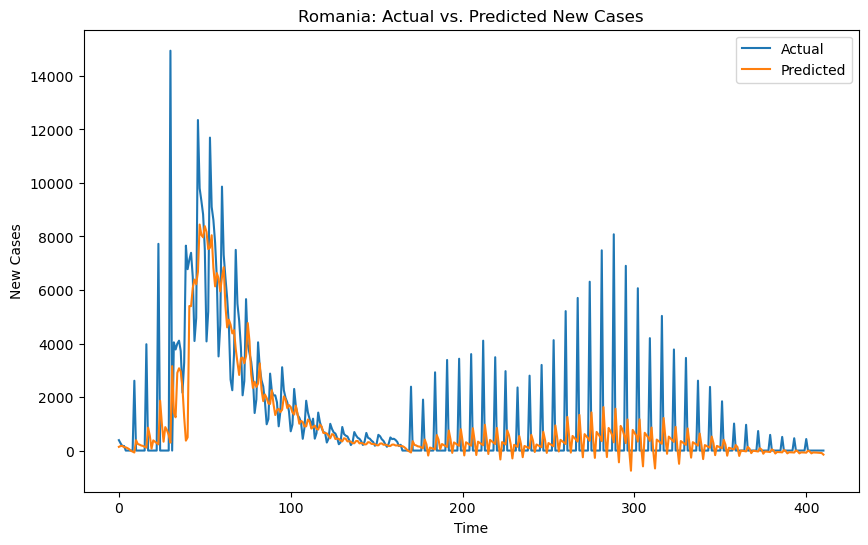

Epoch 1/50
22/22 - 0s - loss: 0.0859 - val_loss: 1.1227 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0060 - val_loss: 8.8934 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0015 - val_loss: 31.9632 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 9.9185e-04 - val_loss: 20.0527 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 8.7779e-04 - val_loss: 13.5864 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 8.4531e-04 - val_loss: 7.9599 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 7.6088e-04 - val_loss: 6.1070 - 44ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 7.4094e-04 - val_loss: 4.2881 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 7.1057e-04 - val_loss: 2.9044 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 7.0443e-04 - val_loss: 2.2798 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 6.7878e-04 - val_loss: 1.5265 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 6.7751e-04 - val_loss: 0.8335 - 41ms/epoch - 2ms/s

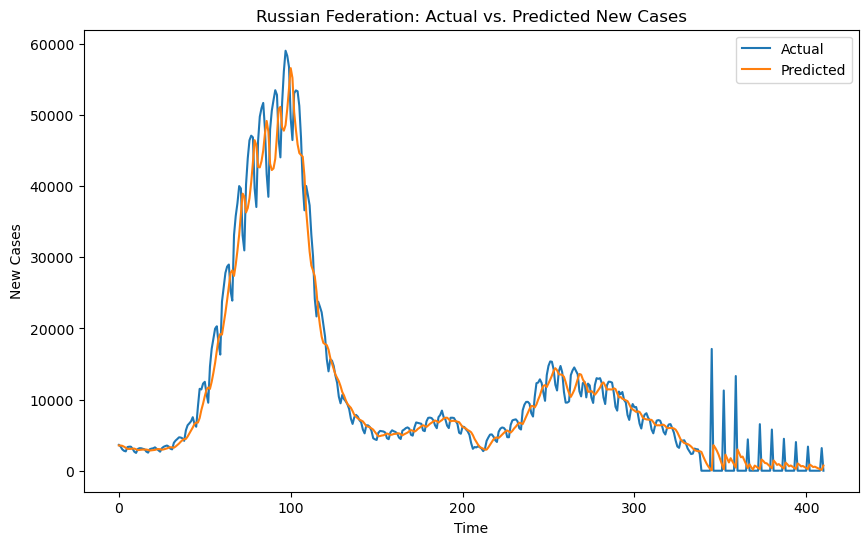

Epoch 1/50
22/22 - 0s - loss: 0.0061 - val_loss: 0.0069 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0046 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0046 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0044 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0047 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0044 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0045 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0043 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0043 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0042 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0042 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0042 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

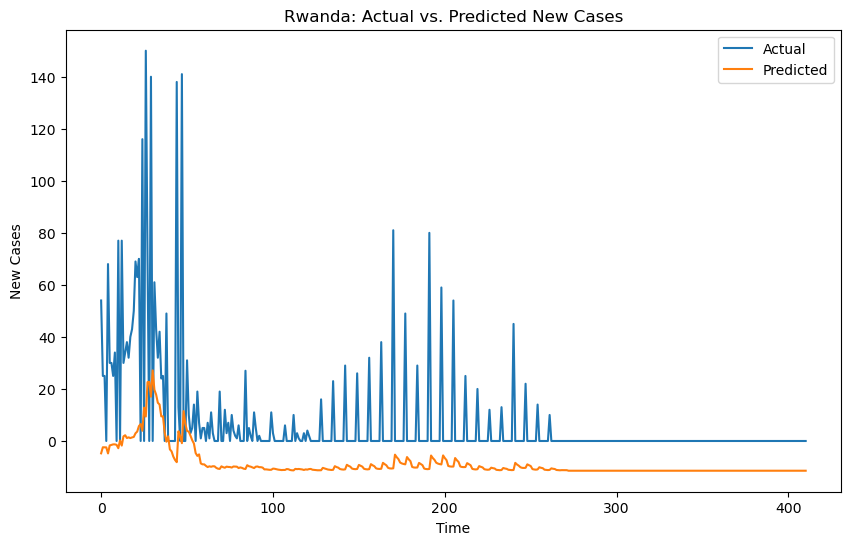

Epoch 1/50
22/22 - 0s - loss: 0.1690 - val_loss: 0.4637 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0464 - val_loss: 0.3062 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.3052 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0010 - val_loss: 0.3042 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 8.5550e-04 - val_loss: 0.3043 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 8.2160e-04 - val_loss: 0.3043 - 39ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 8.1741e-04 - val_loss: 0.3042 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 8.1825e-04 - val_loss: 0.3042 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 8.3783e-04 - val_loss: 0.3043 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 8.1560e-04 - val_loss: 0.3041 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 8.1947e-04 - val_loss: 0.3041 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 8.2569e-04 - val_loss: 0.3041 - 41ms/epoch - 2ms/step
Epo

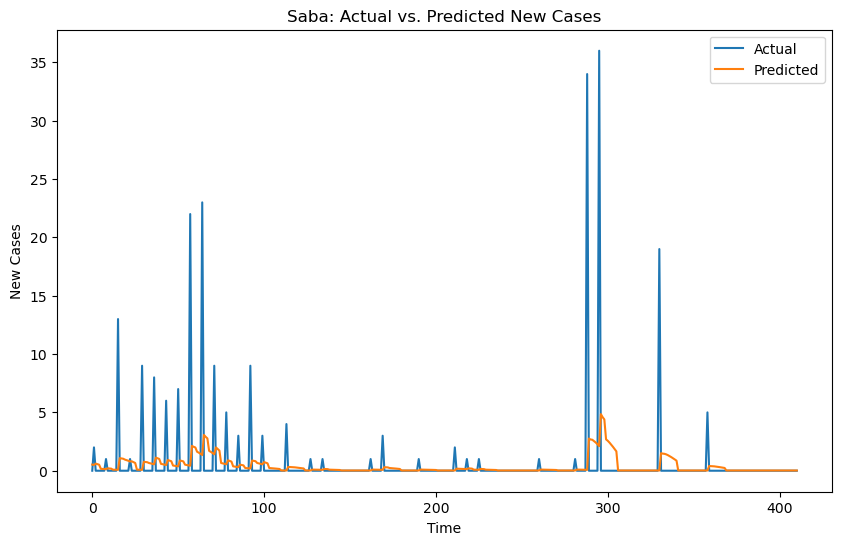

Epoch 1/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0631 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0628 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0629 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0626 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0612 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0609 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0604 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0605 - 38ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0586 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0596 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0587 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0581 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

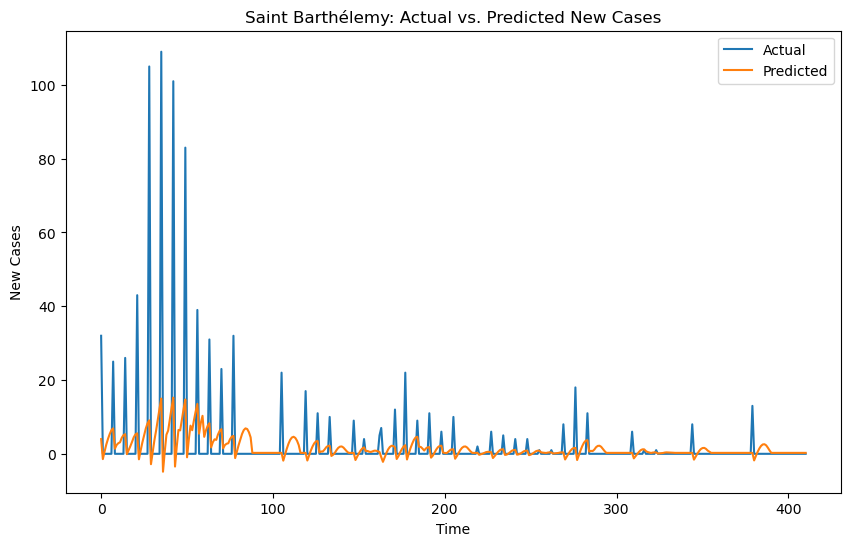

Epoch 1/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - los

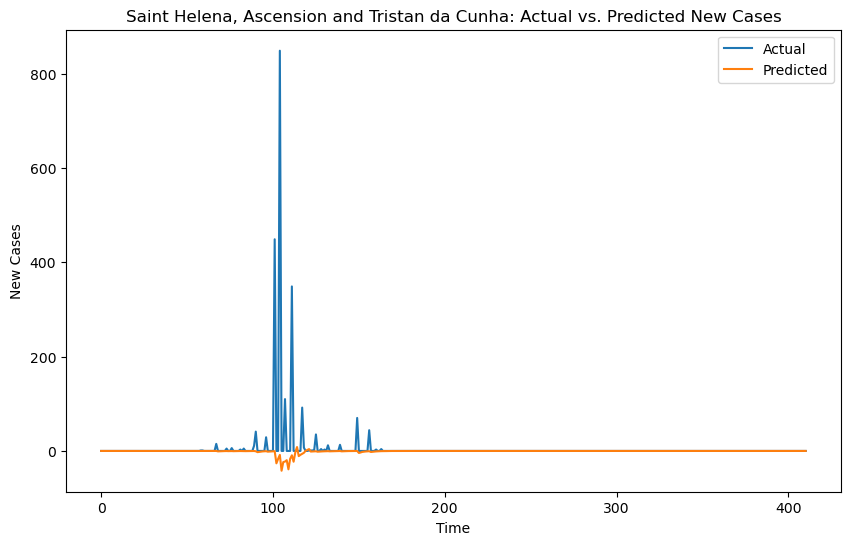

Epoch 1/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0306 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.0206 - 41ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0206 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0197 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0195 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0197 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0193 - 42ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0193 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0194 - 42ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0202 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0195 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0185 - 42ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

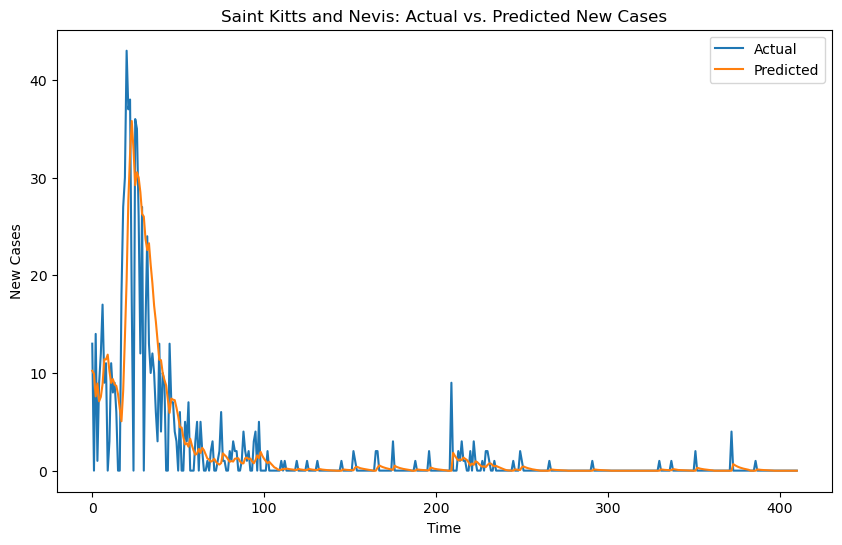

Epoch 1/50
22/22 - 0s - loss: 0.0150 - val_loss: 0.1103 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0115 - val_loss: 0.0812 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0089 - val_loss: 0.0817 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0080 - val_loss: 0.2129 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0079 - val_loss: 0.1144 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0077 - val_loss: 0.0909 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0075 - val_loss: 0.1172 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0077 - val_loss: 0.0956 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0077 - val_loss: 0.0806 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0076 - val_loss: 0.0830 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0075 - val_loss: 0.0825 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0077 - val_loss: 0.0820 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

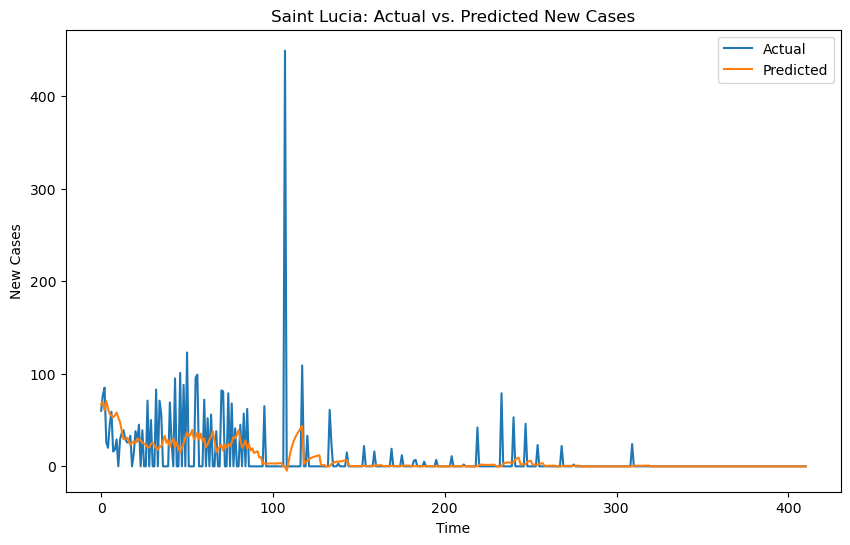

Epoch 1/50
22/22 - 0s - loss: 0.0098 - val_loss: 1.1490 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0097 - val_loss: 1.1359 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0095 - val_loss: 1.1220 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0093 - val_loss: 1.0993 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0092 - val_loss: 1.0596 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0090 - val_loss: 1.1196 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0090 - val_loss: 1.0438 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0087 - val_loss: 1.0699 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0087 - val_loss: 1.3156 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0085 - val_loss: 1.8009 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0084 - val_loss: 1.7243 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0083 - val_loss: 2.6302 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

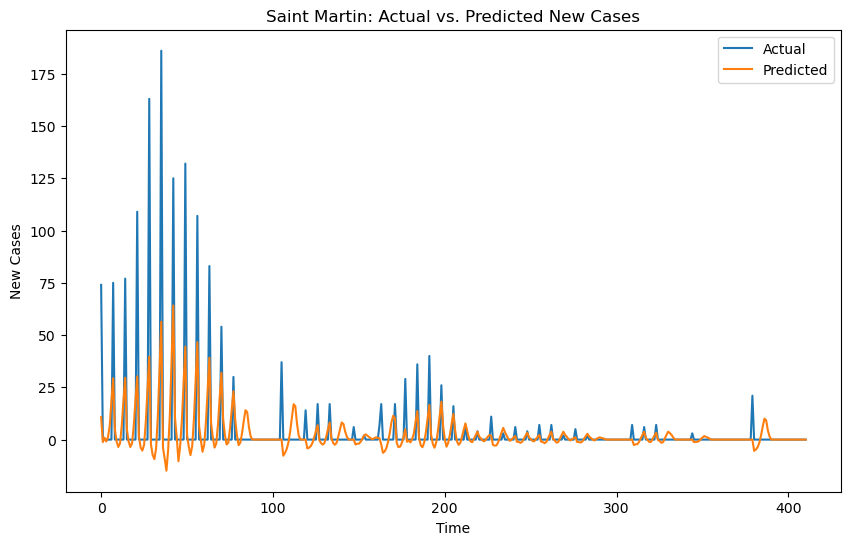

Epoch 1/50
22/22 - 0s - loss: 0.0028 - val_loss: 21.5890 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0026 - val_loss: 21.5386 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0025 - val_loss: 21.6595 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0024 - val_loss: 21.8226 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0024 - val_loss: 22.1037 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0024 - val_loss: 22.1237 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0024 - val_loss: 22.0254 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0024 - val_loss: 22.6436 - 45ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0023 - val_loss: 22.3684 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0023 - val_loss: 22.4879 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0023 - val_loss: 22.5347 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0023 - val_loss: 22.5064 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s 

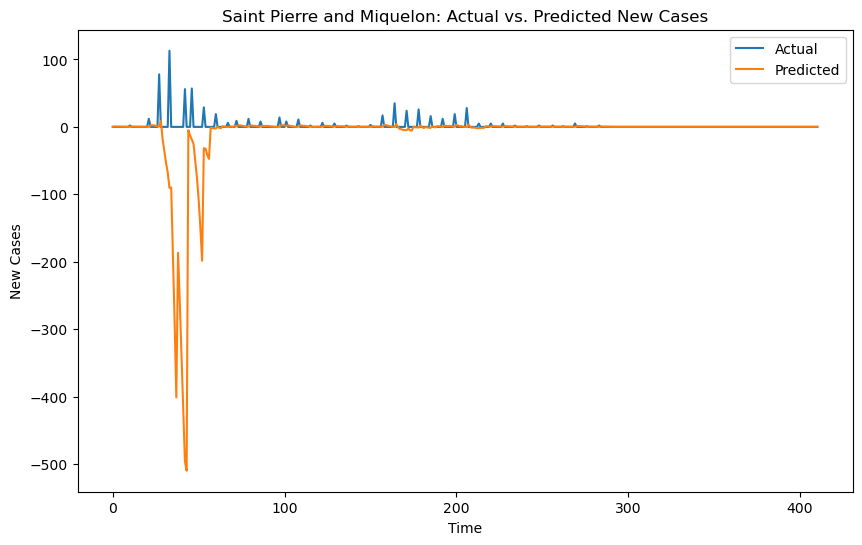

Epoch 1/50
22/22 - 0s - loss: 0.0215 - val_loss: 0.0842 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0154 - val_loss: 0.0683 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0113 - val_loss: 0.0670 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0105 - val_loss: 0.0634 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0100 - val_loss: 0.0638 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0097 - val_loss: 0.0624 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0094 - val_loss: 0.0620 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0093 - val_loss: 0.0619 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0091 - val_loss: 0.0607 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0089 - val_loss: 0.0605 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0091 - val_loss: 0.0605 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0089 - val_loss: 0.0596 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

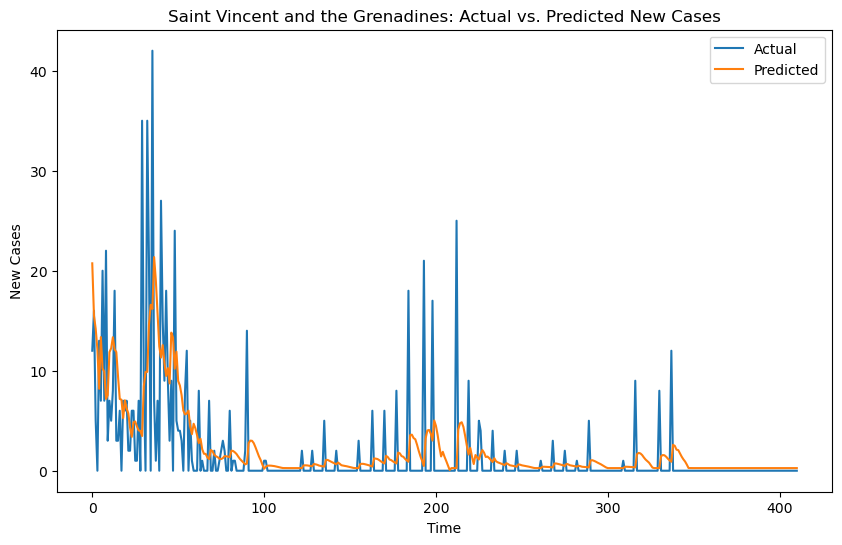

Epoch 1/50
22/22 - 0s - loss: 0.0014 - val_loss: 56033.9453 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0014 - val_loss: 56473.0000 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0014 - val_loss: 56504.8555 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0014 - val_loss: 56485.2969 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0014 - val_loss: 56276.1094 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0014 - val_loss: 56554.8984 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0014 - val_loss: 56455.0859 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0014 - val_loss: 56558.1133 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0014 - val_loss: 56459.3477 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0014 - val_loss: 56410.6328 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0014 - val_loss: 56496.3555 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0014 - val_loss: 56442.9453 - 41ms/epoc

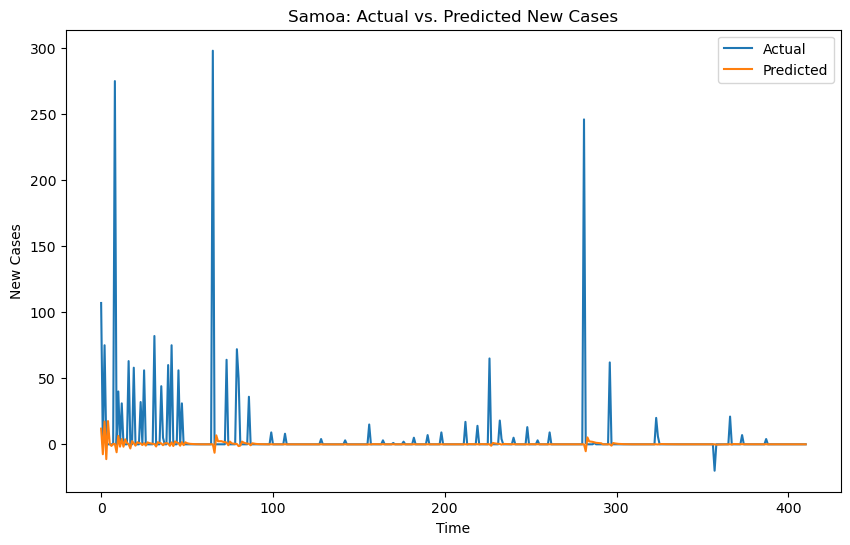

Epoch 1/50
22/22 - 0s - loss: 0.0443 - val_loss: 0.7500 - 393ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0308 - val_loss: 1.1484 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0267 - val_loss: 9.3942 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0268 - val_loss: 12.1082 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0260 - val_loss: 2.9274 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0261 - val_loss: 2.9503 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0257 - val_loss: 3.0795 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0259 - val_loss: 1.6203 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0261 - val_loss: 1.6404 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0256 - val_loss: 1.4875 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0255 - val_loss: 1.1485 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0255 - val_loss: 0.9854 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.0

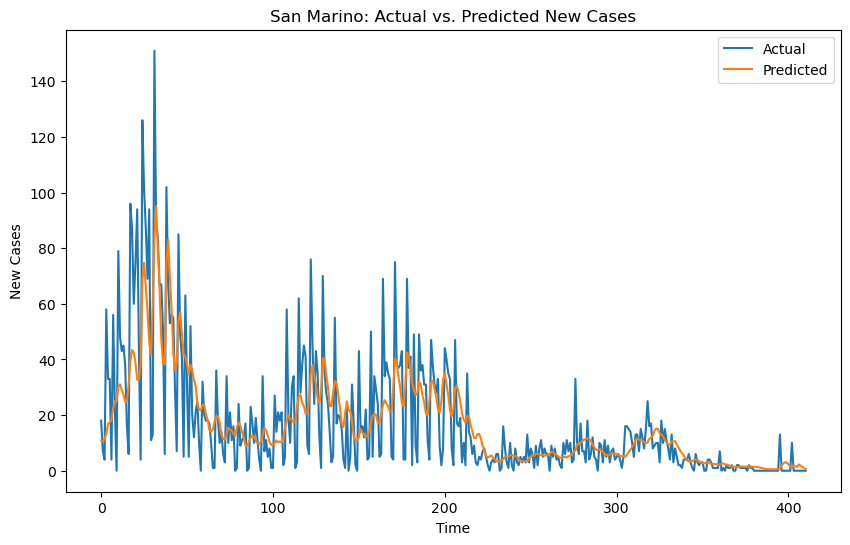

Epoch 1/50
22/22 - 0s - loss: 0.0092 - val_loss: 0.0778 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0084 - val_loss: 0.0706 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0080 - val_loss: 0.0623 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0077 - val_loss: 0.0648 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0076 - val_loss: 0.0859 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0076 - val_loss: 0.0830 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0076 - val_loss: 0.0833 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0076 - val_loss: 0.0757 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0075 - val_loss: 0.0733 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0075 - val_loss: 0.0733 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0075 - val_loss: 0.0693 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0075 - val_loss: 0.0724 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

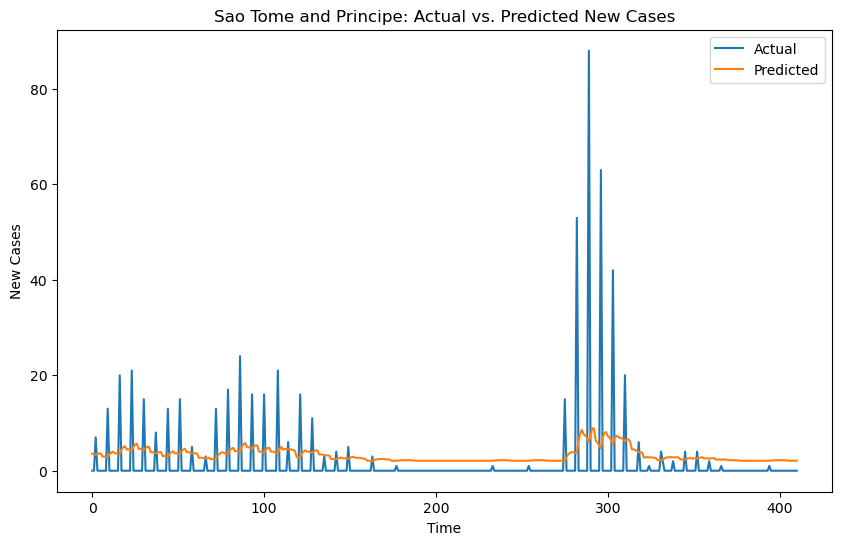

Epoch 1/50
22/22 - 0s - loss: 0.0462 - val_loss: 0.1004 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0143 - val_loss: 0.0202 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0271 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.0183 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0166 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0020 - val_loss: 0.0166 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0158 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0135 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0139 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0117 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0016 - val_loss: 0.0106 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0107 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

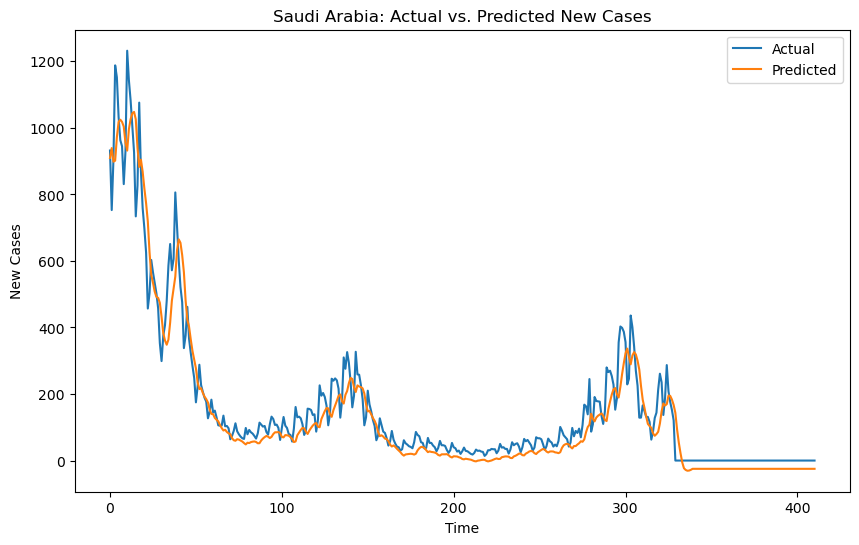

Epoch 1/50
22/22 - 0s - loss: 0.0106 - val_loss: 0.0067 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0061 - val_loss: 0.0045 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0036 - val_loss: 0.0033 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0033 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0032 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0032 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0032 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0031 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0031 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0030 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0029 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0029 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

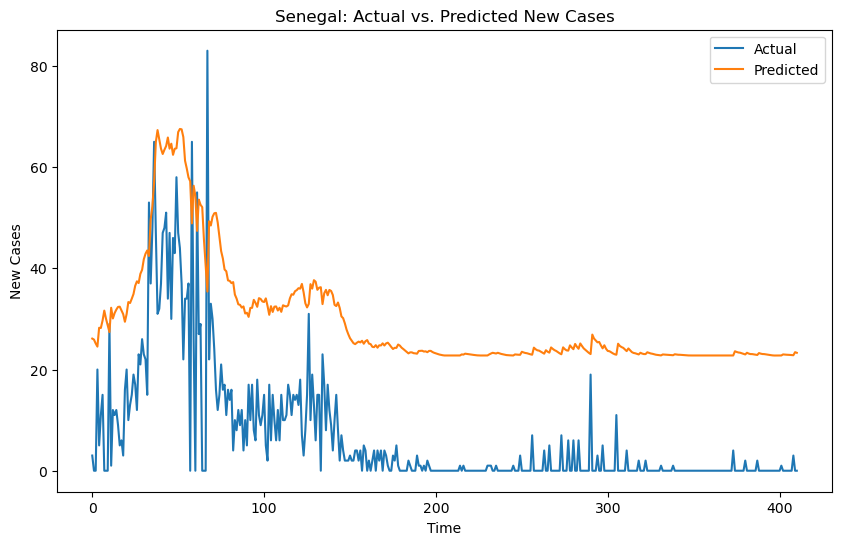

Epoch 1/50
22/22 - 0s - loss: 0.0722 - val_loss: 0.2661 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0173 - val_loss: 0.2301 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0056 - val_loss: 0.5245 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0048 - val_loss: 0.2191 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0044 - val_loss: 0.1956 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0043 - val_loss: 0.0887 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0042 - val_loss: 0.1104 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.0829 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0560 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0707 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0608 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0036 - val_loss: 0.0527 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

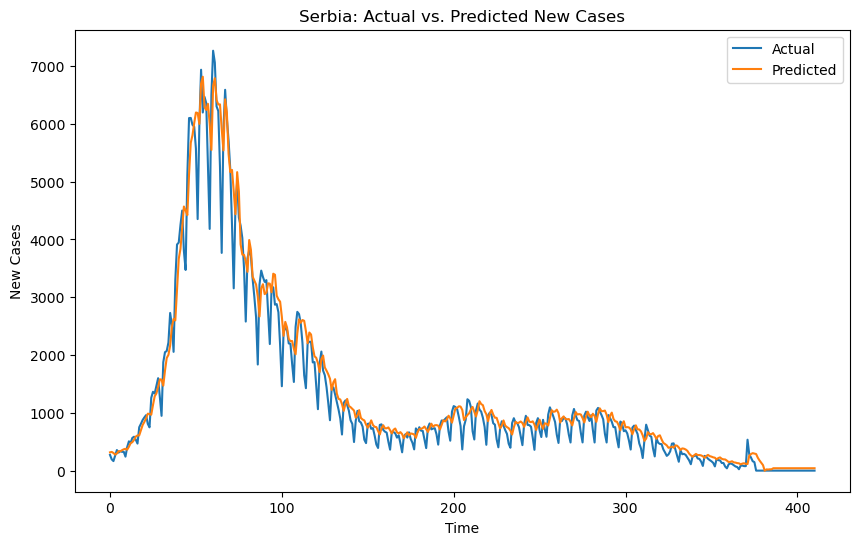

Epoch 1/50
22/22 - 0s - loss: 0.0129 - val_loss: 0.0795 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0083 - val_loss: 0.0510 - 40ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0061 - val_loss: 0.0530 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0056 - val_loss: 0.0460 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.0431 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.0418 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.0406 - 46ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0053 - val_loss: 0.0411 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0053 - val_loss: 0.0398 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0053 - val_loss: 0.0396 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0052 - val_loss: 0.0392 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0052 - val_loss: 0.0386 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

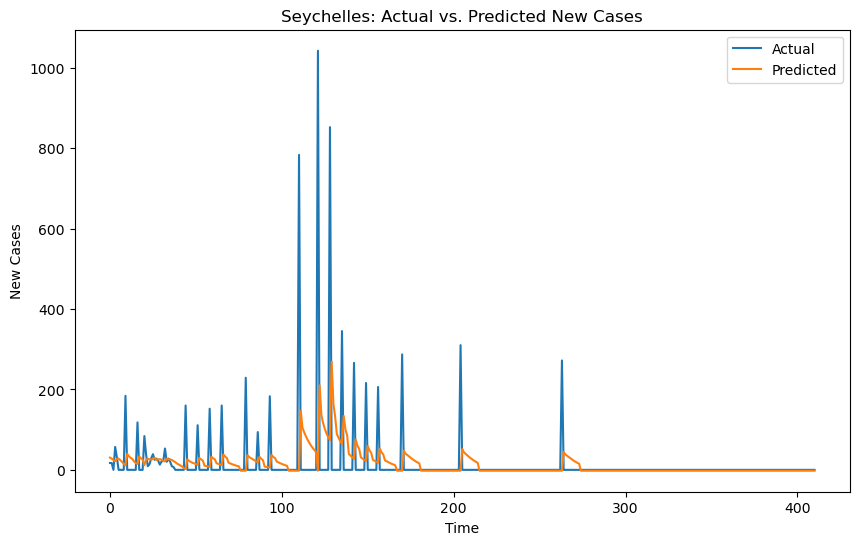

Epoch 1/50
22/22 - 0s - loss: 0.0119 - val_loss: 0.0155 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0083 - val_loss: 0.0126 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0064 - val_loss: 0.0117 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0116 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0057 - val_loss: 0.0116 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.0116 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0056 - val_loss: 0.0114 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0055 - val_loss: 0.0114 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0055 - val_loss: 0.0114 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0055 - val_loss: 0.0113 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0053 - val_loss: 0.0112 - 39ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0052 - val_loss: 0.0111 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

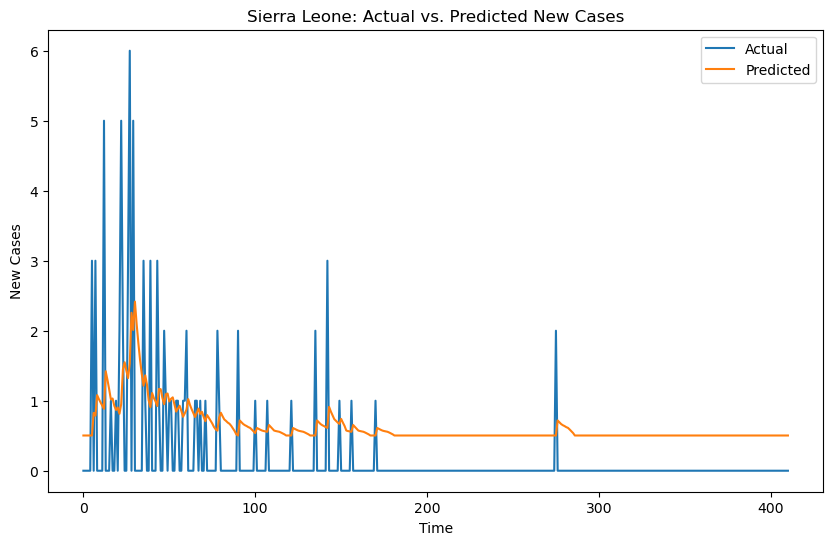

Epoch 1/50
22/22 - 0s - loss: 0.0153 - val_loss: 0.4261 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0038 - val_loss: 25.4910 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0018 - val_loss: 8.2765 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0018 - val_loss: 8.9301 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0017 - val_loss: 6.5015 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0018 - val_loss: 4.3360 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0018 - val_loss: 4.4014 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0017 - val_loss: 3.2532 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0017 - val_loss: 2.8047 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0017 - val_loss: 2.5127 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0017 - val_loss: 1.6727 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0016 - val_loss: 1.4556 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.0

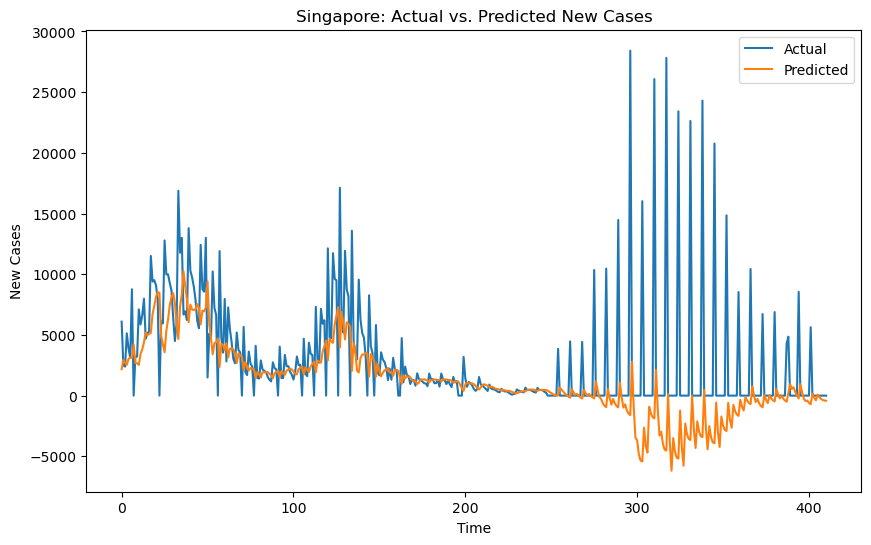

Epoch 1/50
22/22 - 0s - loss: 0.1692 - val_loss: 0.7274 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0295 - val_loss: 0.5680 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0028 - val_loss: 0.5591 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0010 - val_loss: 0.5566 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 9.0235e-04 - val_loss: 0.5568 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 8.9489e-04 - val_loss: 0.5562 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 8.9246e-04 - val_loss: 0.5564 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 8.9593e-04 - val_loss: 0.5561 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 8.9997e-04 - val_loss: 0.5561 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 8.8908e-04 - val_loss: 0.5562 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 8.8618e-04 - val_loss: 0.5559 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 8.9676e-04 - val_loss: 0.5563 - 41ms/epoch - 2ms/step
Epo

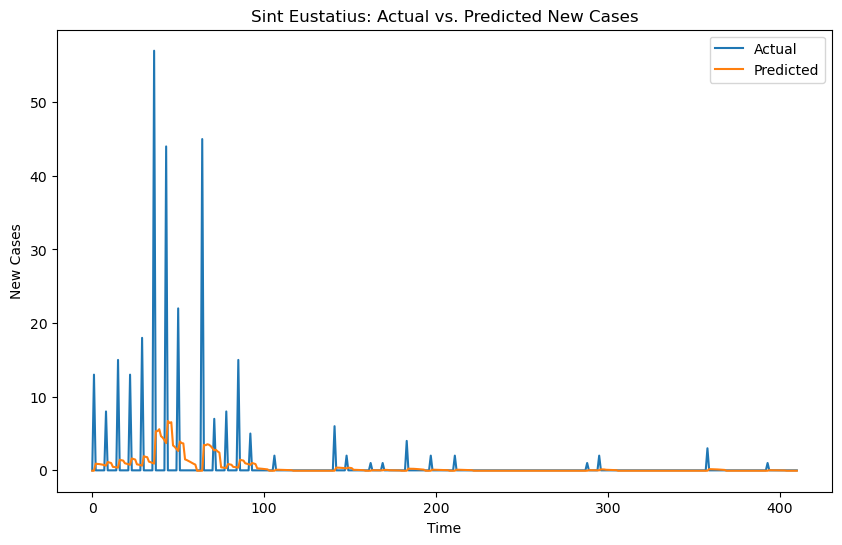

Epoch 1/50
22/22 - 0s - loss: 0.0186 - val_loss: 1.3811 - 396ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0139 - val_loss: 1.4309 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0126 - val_loss: 2.8175 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0124 - val_loss: 5.7268 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0121 - val_loss: 4.2196 - 39ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0122 - val_loss: 5.3325 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0119 - val_loss: 12.2386 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0120 - val_loss: 14.8647 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0118 - val_loss: 17.3173 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0119 - val_loss: 26.6971 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0118 - val_loss: 24.1202 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0117 - val_loss: 50.6543 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss

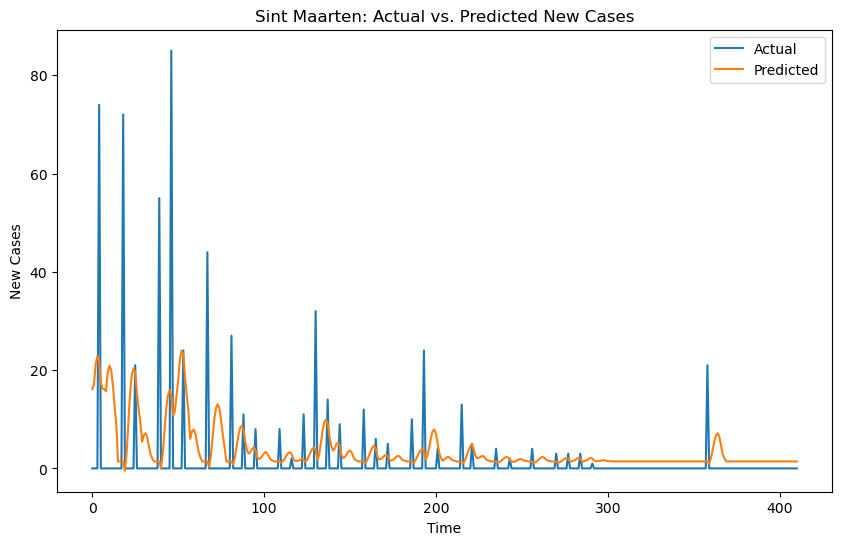

Epoch 1/50
22/22 - 0s - loss: 0.0090 - val_loss: 0.0630 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.1696 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.0537 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0577 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0663 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0502 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0556 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0509 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0481 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0457 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0415 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0533 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

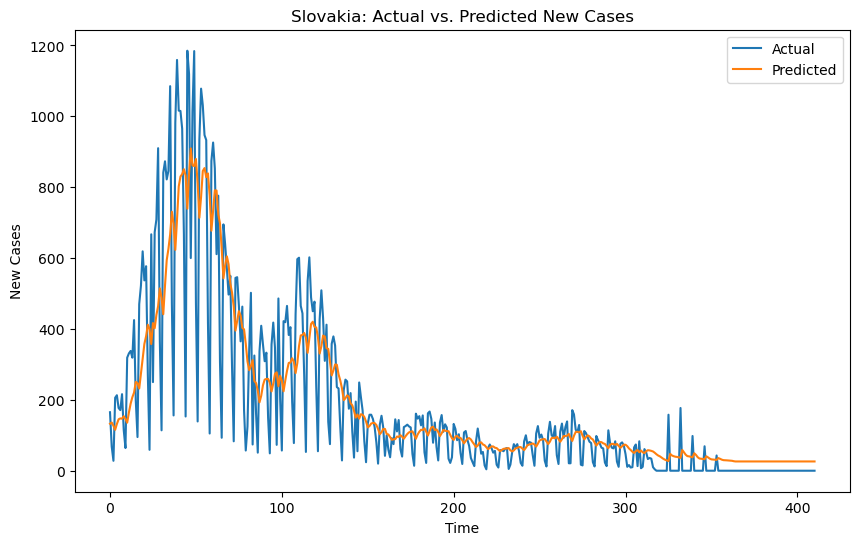

Epoch 1/50
22/22 - 0s - loss: 0.0124 - val_loss: 0.3563 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0120 - val_loss: 0.3506 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0119 - val_loss: 0.3477 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0116 - val_loss: 0.3316 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0113 - val_loss: 0.3181 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0107 - val_loss: 0.2940 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0105 - val_loss: 0.3863 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0099 - val_loss: 3.2326 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0089 - val_loss: 73.5871 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0085 - val_loss: 136.1254 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0071 - val_loss: 279.8168 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0068 - val_loss: 200.8353 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - los

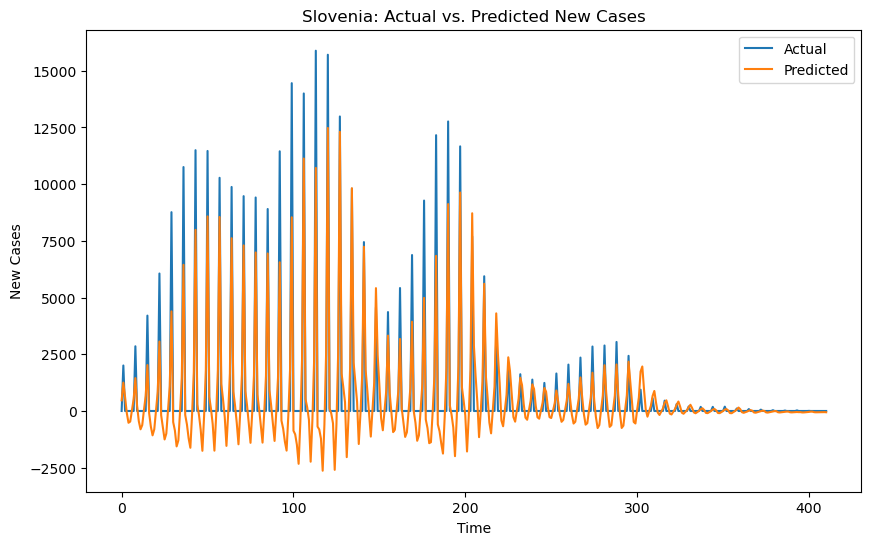

Epoch 1/50
22/22 - 0s - loss: 0.0033 - val_loss: 4207.1299 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0033 - val_loss: 4191.7612 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0033 - val_loss: 4196.1987 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0033 - val_loss: 4220.6123 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0032 - val_loss: 4280.8345 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0033 - val_loss: 4318.7363 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0032 - val_loss: 4288.8101 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0032 - val_loss: 4318.2969 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0032 - val_loss: 4497.2837 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0032 - val_loss: 8222.9473 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0032 - val_loss: 17947.0859 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0031 - val_loss: 63035.2969 - 41ms/epoch - 2ms/st

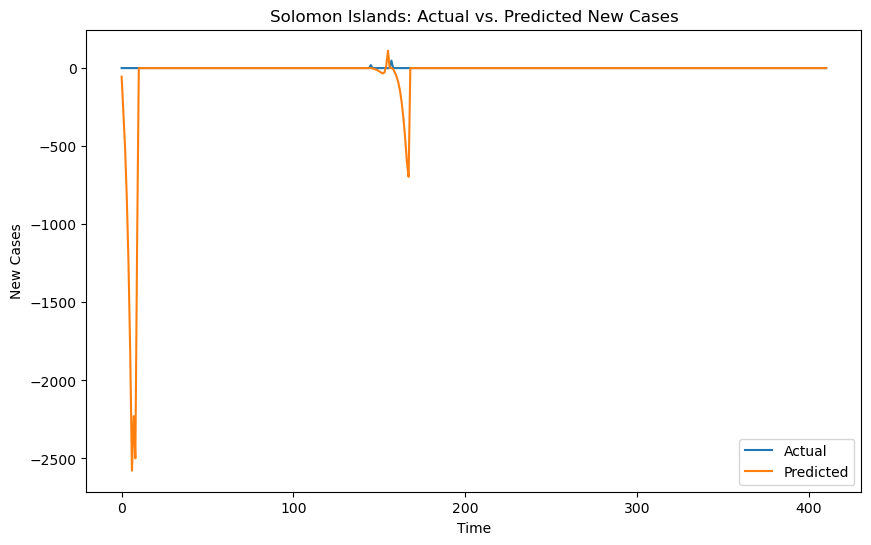

Epoch 1/50
22/22 - 0s - loss: 0.0109 - val_loss: 0.0254 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0098 - val_loss: 0.0254 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0094 - val_loss: 0.0256 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0091 - val_loss: 0.0262 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0089 - val_loss: 0.0268 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0088 - val_loss: 0.0274 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0088 - val_loss: 0.0270 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0088 - val_loss: 0.0271 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0087 - val_loss: 0.0273 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0087 - val_loss: 0.0280 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0086 - val_loss: 0.0274 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0087 - val_loss: 0.0269 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

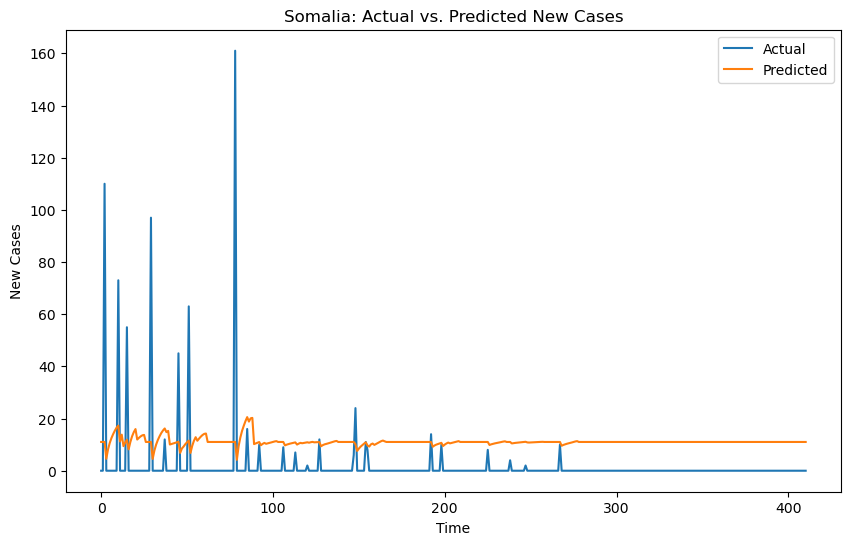

Epoch 1/50
22/22 - 0s - loss: 0.0402 - val_loss: 0.0196 - 402ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0166 - val_loss: 0.0087 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0069 - val_loss: 0.0105 - 40ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0065 - val_loss: 0.0095 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0063 - val_loss: 0.0098 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0061 - val_loss: 0.0103 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0061 - val_loss: 0.0108 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0101 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0093 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.0094 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.0094 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.0092 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

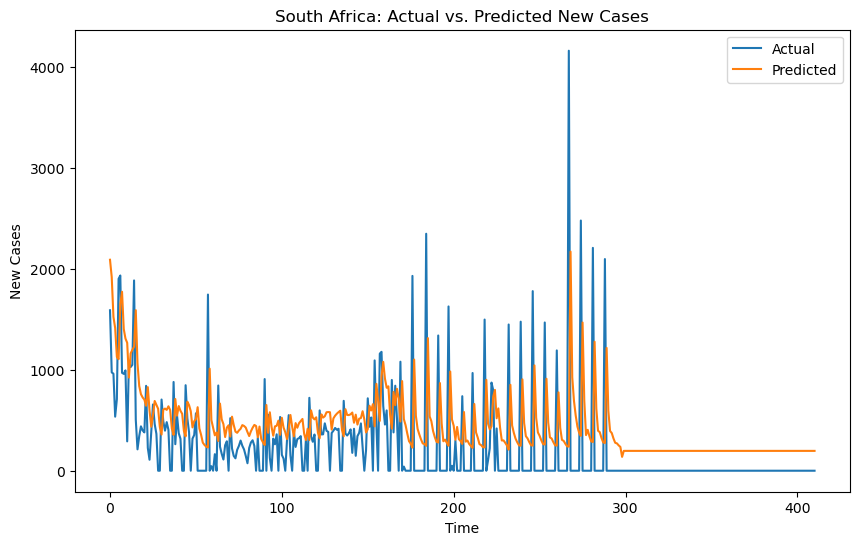

Epoch 1/50
22/22 - 0s - loss: 0.0077 - val_loss: 0.0252 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.0239 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.0244 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.0238 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.0238 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0236 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0236 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0236 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0237 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0236 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0237 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0235 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

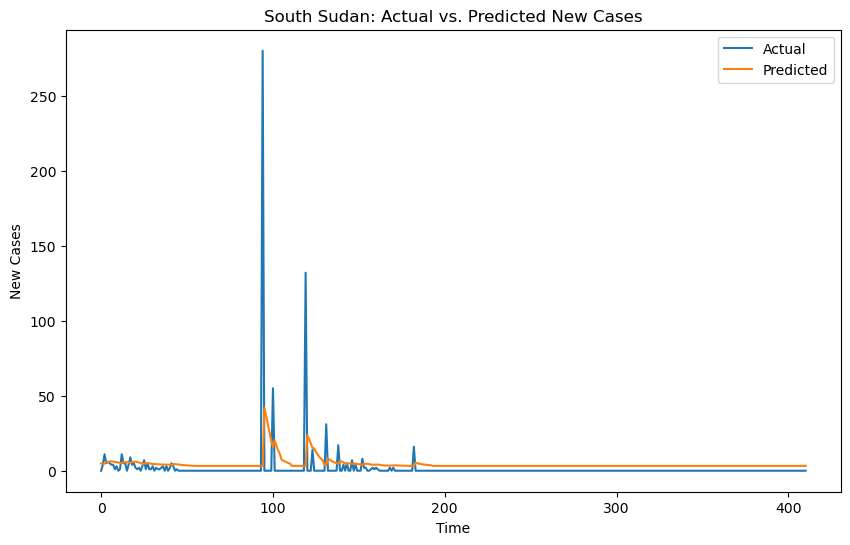

Epoch 1/50
22/22 - 0s - loss: 0.0128 - val_loss: 0.4019 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0125 - val_loss: 0.4030 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0123 - val_loss: 0.3992 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0123 - val_loss: 0.3941 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0120 - val_loss: 0.3873 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0118 - val_loss: 0.3745 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0115 - val_loss: 0.3472 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0109 - val_loss: 0.3208 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0102 - val_loss: 3.8468 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0095 - val_loss: 31.3174 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0086 - val_loss: 181.5311 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0079 - val_loss: 298.6759 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss:

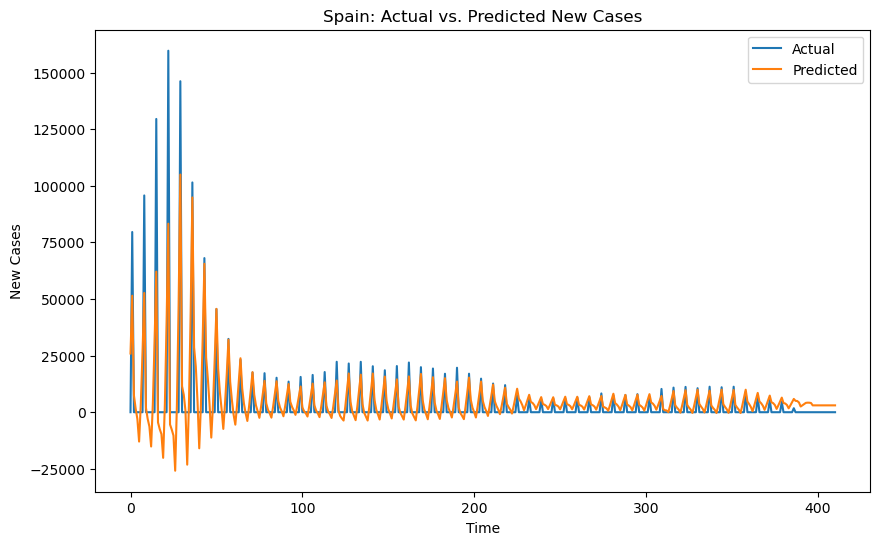

Epoch 1/50
22/22 - 0s - loss: 0.0123 - val_loss: 0.0033 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0013 - 40ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0026 - val_loss: 9.0488e-04 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0026 - val_loss: 8.9030e-04 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0025 - val_loss: 8.5792e-04 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0025 - val_loss: 8.6217e-04 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0025 - val_loss: 8.8326e-04 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0025 - val_loss: 8.5666e-04 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0026 - val_loss: 8.7039e-04 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0025 - val_loss: 8.7962e-04 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0025 - val_loss: 8.6130e-04 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0026 - val_loss: 9.7436e-04 - 41ms/epoch - 2ms/

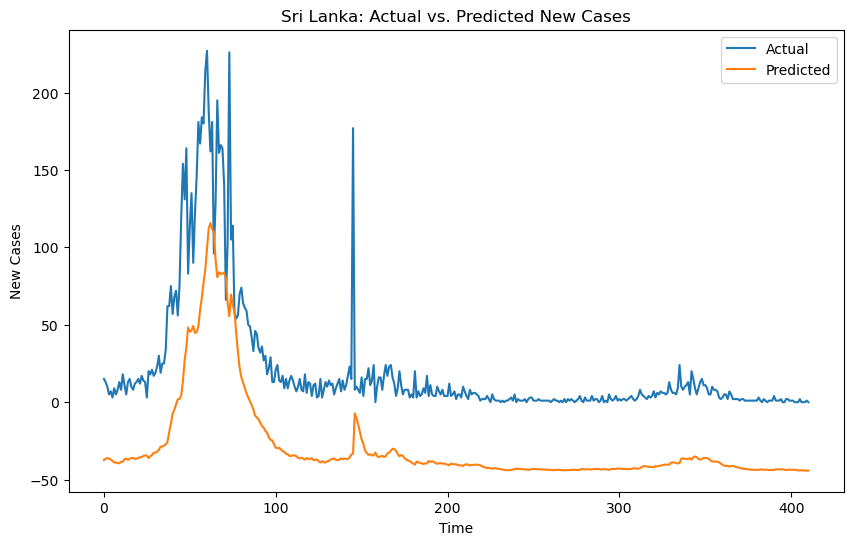

Epoch 1/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0259 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0048 - val_loss: 0.0227 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0042 - val_loss: 0.0210 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0219 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0211 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0217 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0213 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0213 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0211 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0210 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0210 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0210 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

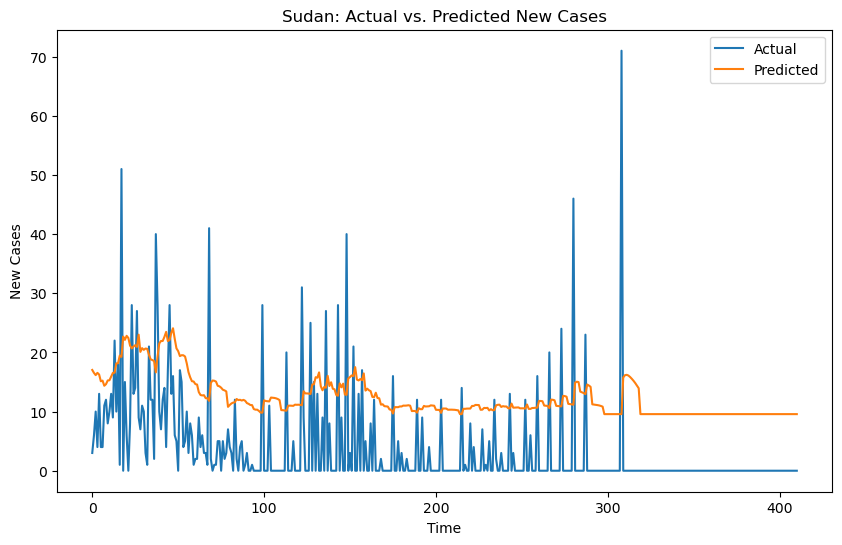

Epoch 1/50
22/22 - 0s - loss: 0.0350 - val_loss: 0.2113 - 392ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0175 - val_loss: 0.1057 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0085 - val_loss: 0.1247 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.1159 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.1026 - 42ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.0993 - 42ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0057 - val_loss: 0.0877 - 43ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0055 - val_loss: 0.0903 - 42ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0056 - val_loss: 0.0953 - 42ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0057 - val_loss: 0.0903 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0055 - val_loss: 0.0836 - 42ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0054 - val_loss: 0.0815 - 42ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

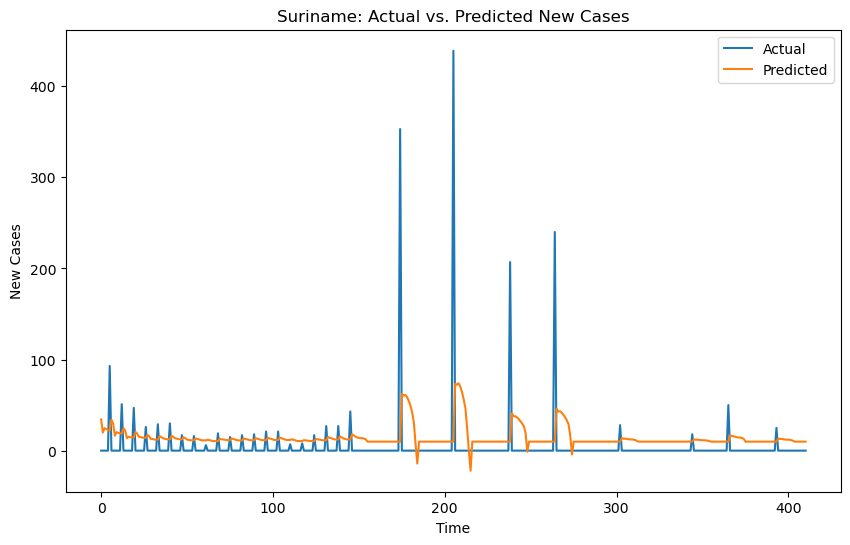

Epoch 1/50
22/22 - 0s - loss: 0.0319 - val_loss: 0.2953 - 395ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0138 - val_loss: 14.1079 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0108 - val_loss: 33.1303 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0104 - val_loss: 7.4840 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0104 - val_loss: 13.9632 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0103 - val_loss: 11.3493 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0101 - val_loss: 7.6736 - 42ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0101 - val_loss: 6.1496 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0100 - val_loss: 6.0172 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0100 - val_loss: 5.4307 - 39ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0100 - val_loss: 2.1630 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0104 - val_loss: 1.9546 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 

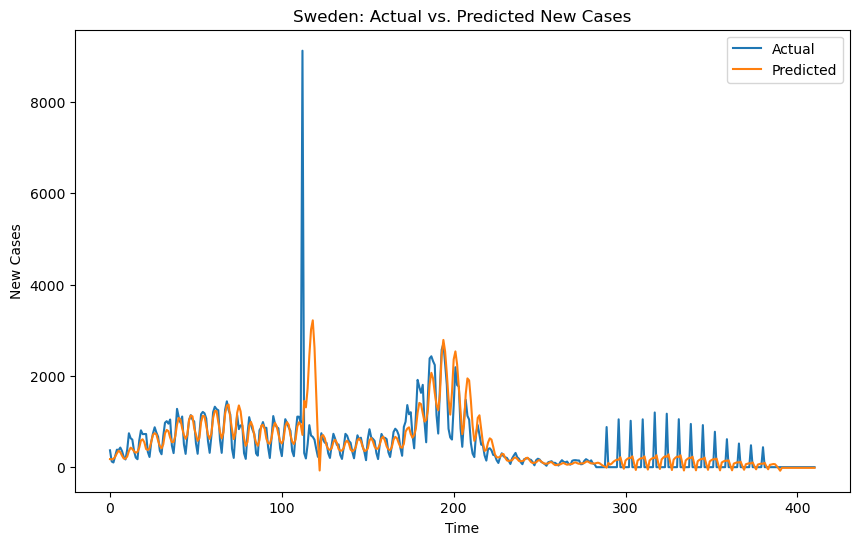

Epoch 1/50
22/22 - 0s - loss: 0.0202 - val_loss: 0.3953 - 407ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0078 - val_loss: 6.0231 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0063 - val_loss: 2.2875 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0062 - val_loss: 1.8994 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0062 - val_loss: 1.7118 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0061 - val_loss: 1.0135 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0062 - val_loss: 1.1539 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.7488 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.9198 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0061 - val_loss: 0.6696 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.7549 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.5362 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

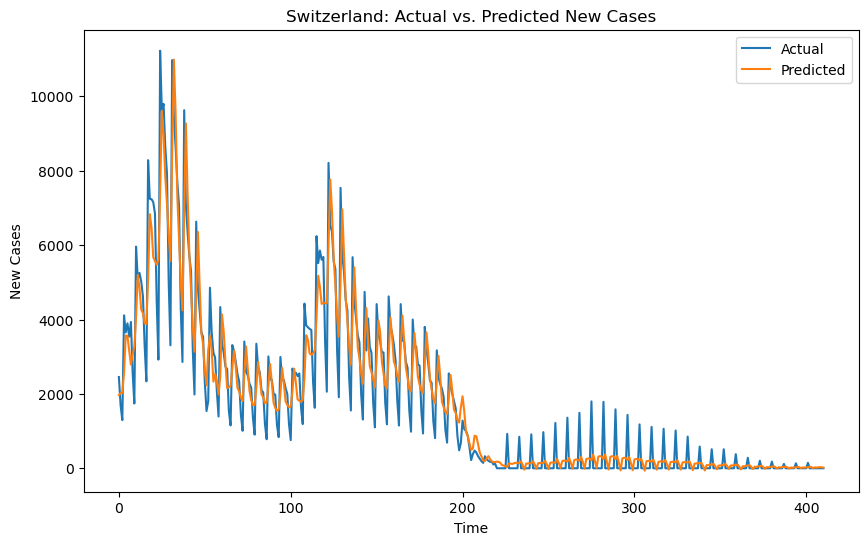

Epoch 1/50
22/22 - 0s - loss: 0.0070 - val_loss: 0.0021 - 394ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0024 - val_loss: 3.7148e-04 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0019 - val_loss: 4.7110e-04 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0019 - val_loss: 3.1944e-04 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0018 - val_loss: 2.6201e-04 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0017 - val_loss: 3.5241e-04 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0018 - val_loss: 2.8373e-04 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0017 - val_loss: 2.3772e-04 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0017 - val_loss: 2.3197e-04 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0017 - val_loss: 2.5065e-04 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0017 - val_loss: 2.4754e-04 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0016 - val_loss: 2.7983e-04 - 41ms/epoch - 

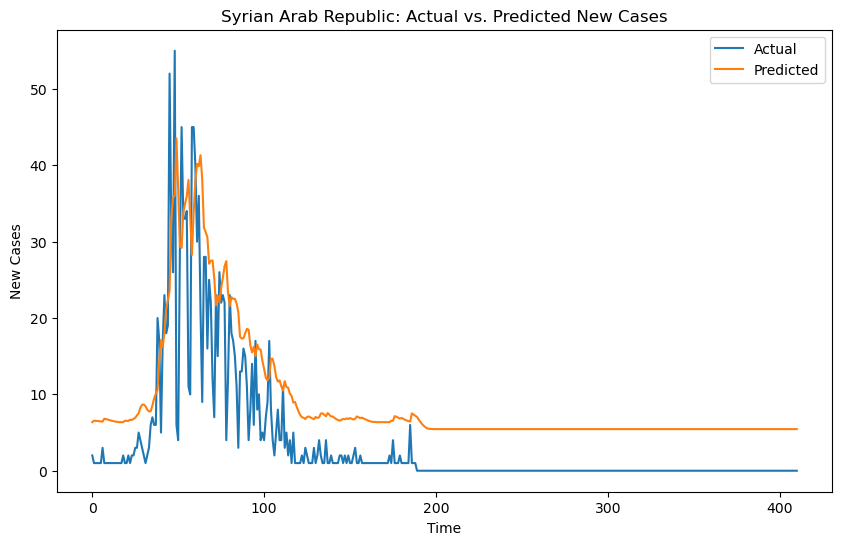

Epoch 1/50
22/22 - 0s - loss: 0.0087 - val_loss: 0.0024 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0048 - val_loss: 0.0014 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0027 - val_loss: 2.7214e-04 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0022 - val_loss: 1.2084e-04 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0021 - val_loss: 1.3447e-04 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0021 - val_loss: 1.8097e-04 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0021 - val_loss: 1.5986e-04 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0021 - val_loss: 1.6871e-04 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0021 - val_loss: 1.1921e-04 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0021 - val_loss: 1.8055e-04 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0021 - val_loss: 1.2031e-04 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0020 - val_loss: 1.4846e-04 - 40ms/epoch - 2ms/

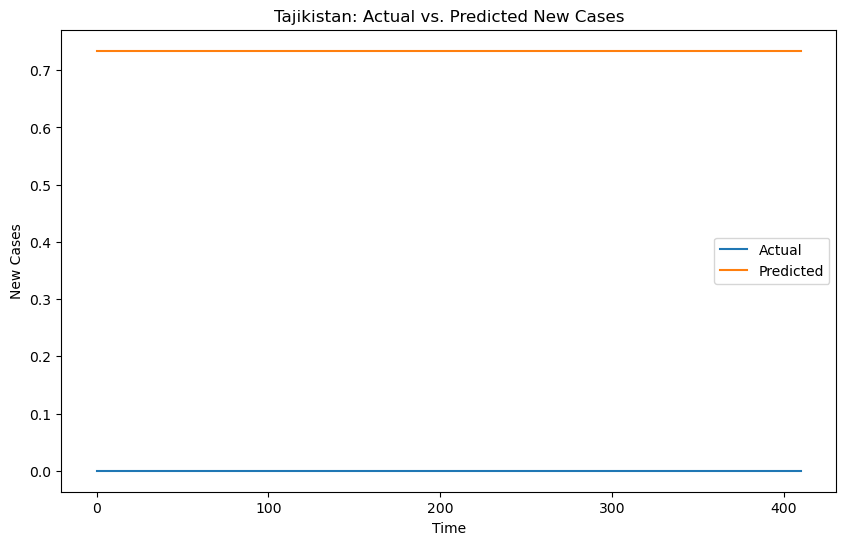

Epoch 1/50
22/22 - 0s - loss: 0.0385 - val_loss: 0.1156 - 393ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0096 - val_loss: 0.0125 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0018 - val_loss: 0.0202 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0015 - val_loss: 0.0122 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0014 - val_loss: 0.0109 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0014 - val_loss: 0.0105 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0014 - val_loss: 0.0122 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0013 - val_loss: 0.0101 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0013 - val_loss: 0.0100 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0012 - val_loss: 0.0100 - 42ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0012 - val_loss: 0.0101 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0013 - val_loss: 0.0096 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

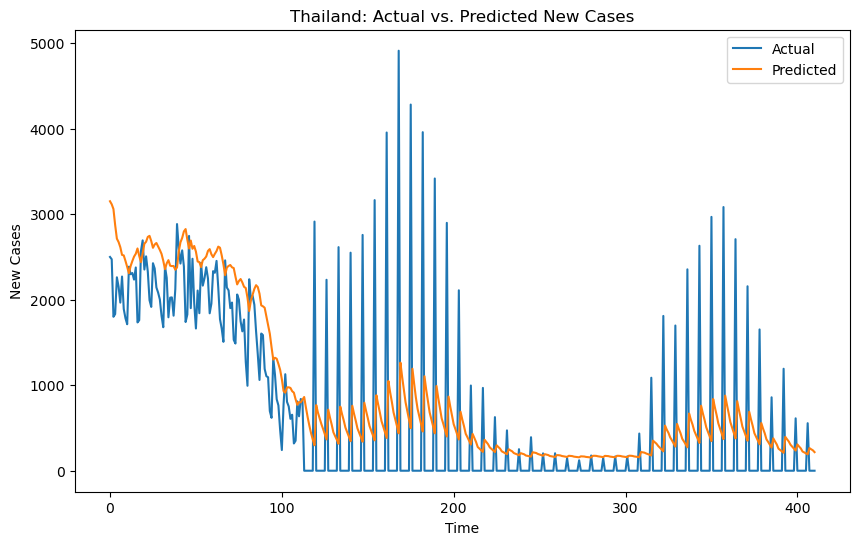

Epoch 1/50
22/22 - 0s - loss: 0.0435 - val_loss: 0.3333 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0069 - val_loss: 1.0435 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0043 - val_loss: 0.3032 - 37ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.3003 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.2025 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.1868 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.1364 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.1440 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.1187 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.1158 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0036 - val_loss: 0.1118 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0036 - val_loss: 0.1055 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

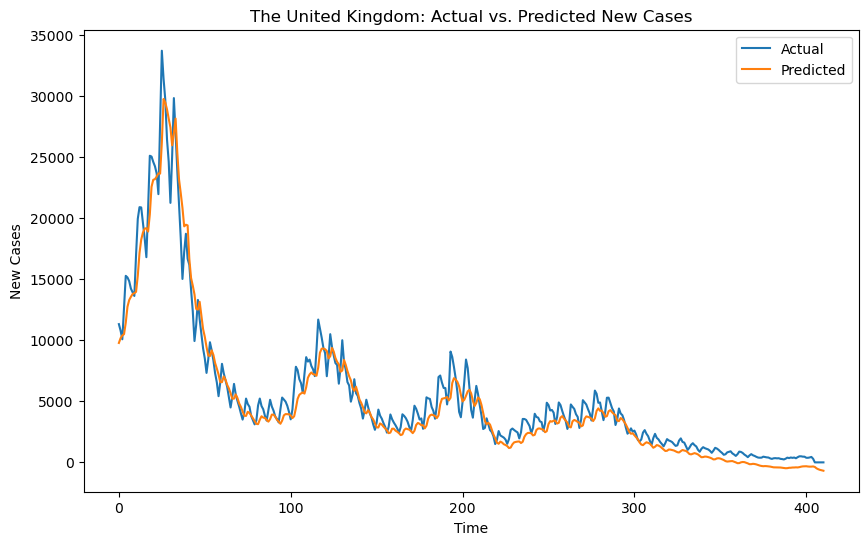

Epoch 1/50
22/22 - 0s - loss: 0.0085 - val_loss: 0.0044 - 394ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0031 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.0029 - 38ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0028 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0028 - 42ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0027 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0026 - 42ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0029 - 42ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0026 - val_loss: 0.0026 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0026 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0026 - 42ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0025 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

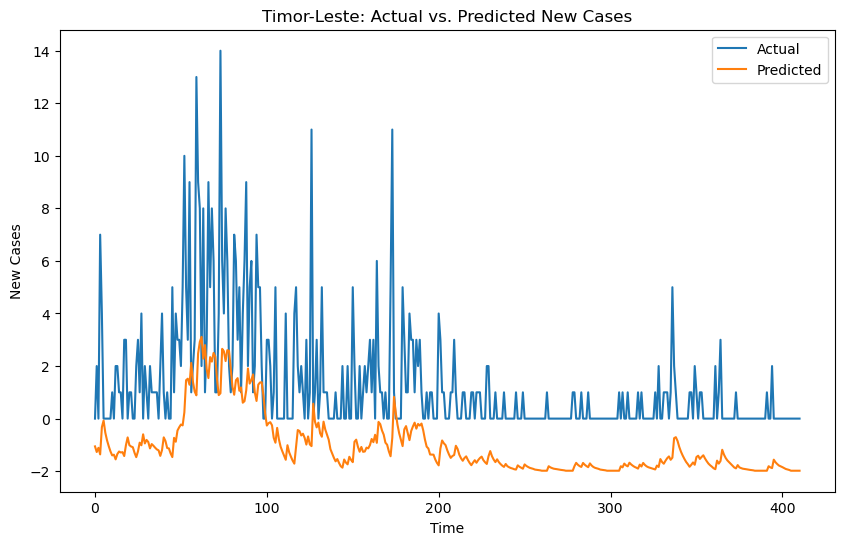

Epoch 1/50
22/22 - 0s - loss: 0.0293 - val_loss: 0.1179 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0154 - val_loss: 0.0677 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0089 - val_loss: 0.0524 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0061 - val_loss: 0.0769 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0061 - val_loss: 0.0601 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0063 - val_loss: 0.0643 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0061 - val_loss: 0.0586 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0497 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0493 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0488 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0468 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0490 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

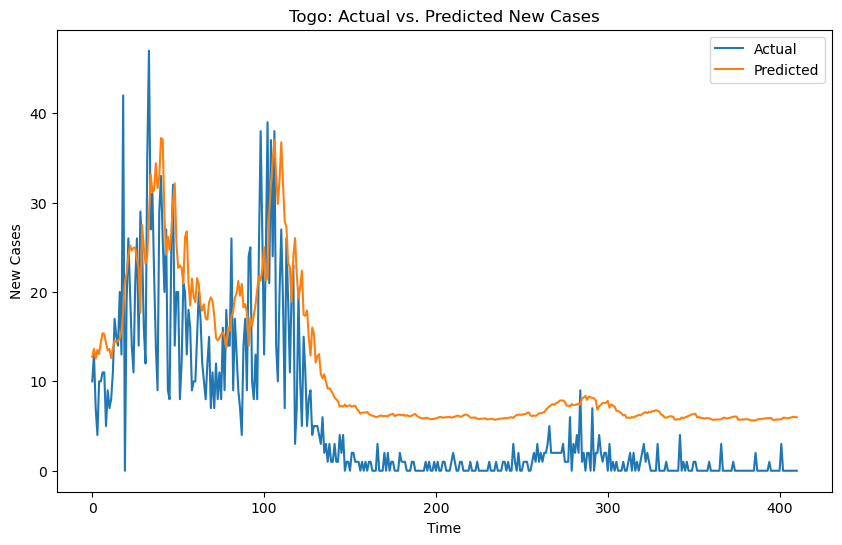

Epoch 1/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 40ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 40ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - los

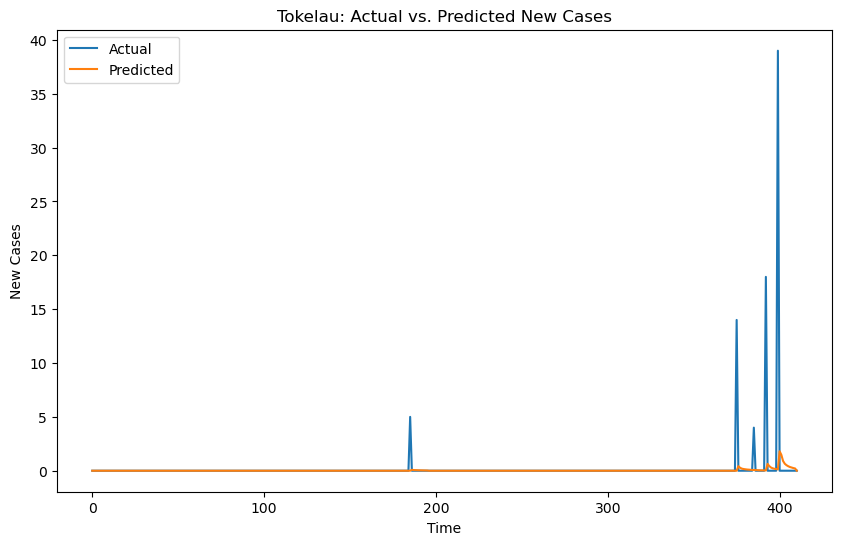

Epoch 1/50
22/22 - 0s - loss: 0.0014 - val_loss: 19209.4453 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0014 - val_loss: 19559.8730 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0014 - val_loss: 19414.2656 - 40ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0014 - val_loss: 19530.3125 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0014 - val_loss: 19623.9551 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0014 - val_loss: 19468.9062 - 42ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0014 - val_loss: 19742.3613 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0014 - val_loss: 19594.6348 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0014 - val_loss: 19574.1191 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0014 - val_loss: 20169.1621 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0014 - val_loss: 19308.2988 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0014 - val_loss: 20068.8340 - 39ms/epoc

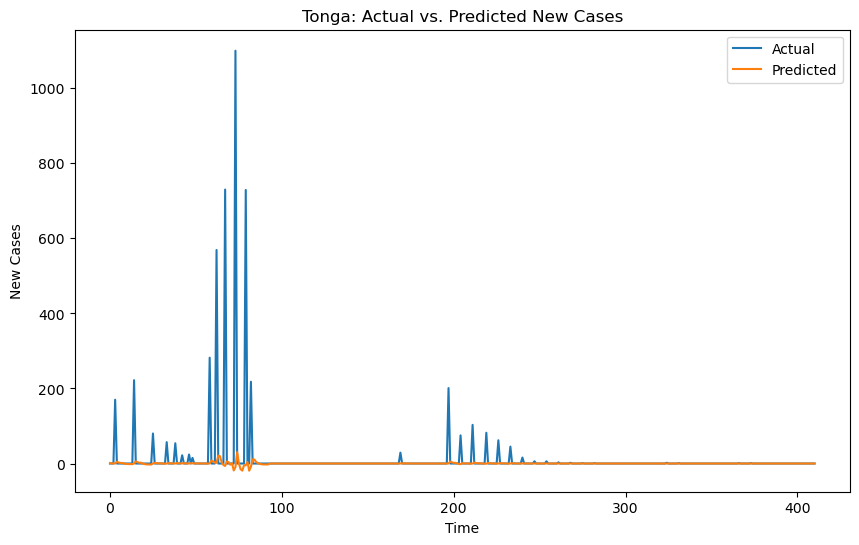

Epoch 1/50
22/22 - 0s - loss: 0.0178 - val_loss: 0.1245 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0078 - val_loss: 0.1146 - 40ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0051 - val_loss: 0.1210 - 40ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.1184 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.1199 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.1183 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.1180 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0051 - val_loss: 0.1146 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.1177 - 42ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0050 - val_loss: 0.1162 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0052 - val_loss: 0.1165 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.1172 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

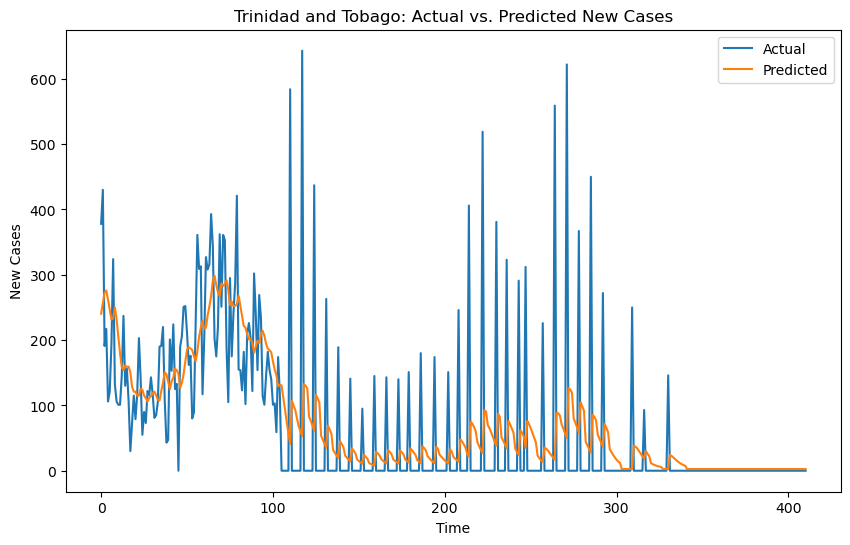

Epoch 1/50
22/22 - 0s - loss: 0.0162 - val_loss: 0.0457 - 394ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0085 - val_loss: 0.0347 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0063 - val_loss: 0.0359 - 40ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0061 - val_loss: 0.0333 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0334 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0326 - 42ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0328 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0321 - 42ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0323 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0322 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0057 - val_loss: 0.0318 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0318 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

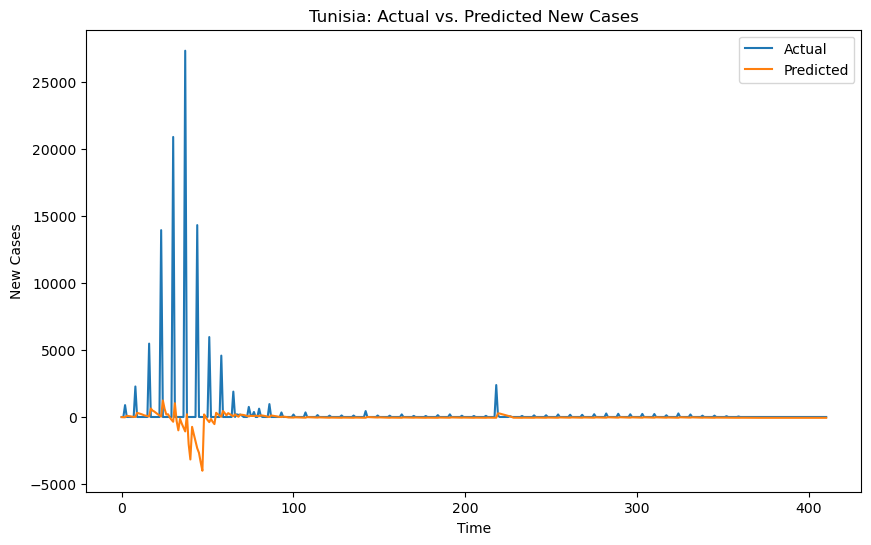

Epoch 1/50
22/22 - 0s - loss: 0.0561 - val_loss: 0.1938 - 391ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0102 - val_loss: 0.0618 - 40ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.1420 - 40ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0034 - val_loss: 0.0750 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0029 - val_loss: 0.0455 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0337 - 42ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0298 - 42ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.0250 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0203 - 42ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0021 - val_loss: 0.0186 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0019 - val_loss: 0.0151 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0017 - val_loss: 0.0153 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

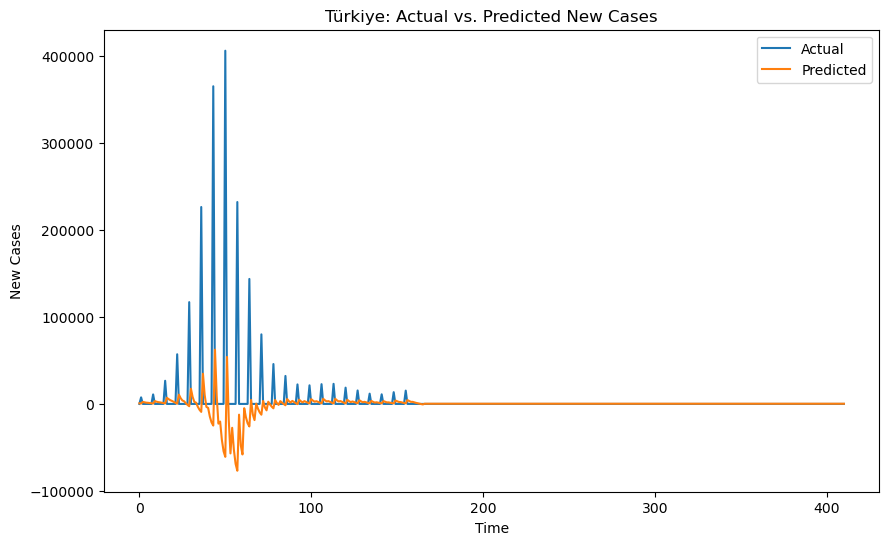

Epoch 1/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 466ms/epoch - 21ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0000e+00 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - los

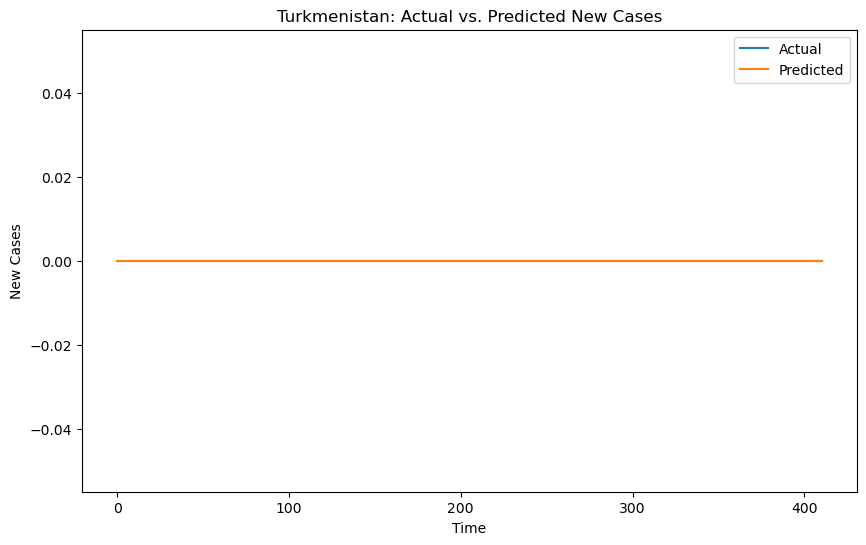

Epoch 1/50
22/22 - 0s - loss: 0.0142 - val_loss: 0.3497 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0113 - val_loss: 0.2948 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0099 - val_loss: 0.4607 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0091 - val_loss: 0.7770 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0090 - val_loss: 0.6834 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0093 - val_loss: 0.4289 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0091 - val_loss: 0.5849 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0091 - val_loss: 0.4657 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0090 - val_loss: 0.4985 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0092 - val_loss: 0.4426 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0090 - val_loss: 0.5459 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0090 - val_loss: 0.5178 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

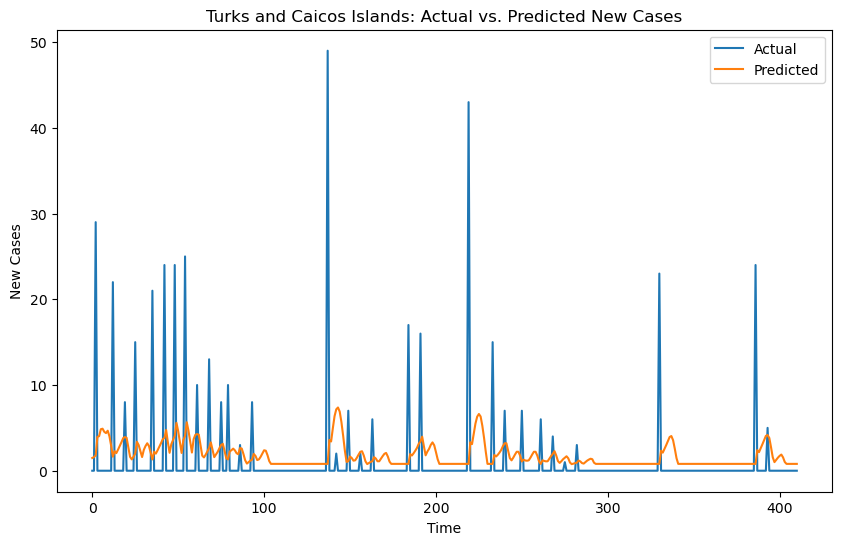

Epoch 1/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0543 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0543 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0543 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0543 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0543 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0543 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0543 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0543 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0543 - 40ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0543 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0543 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0000e+00 - val_loss: 0.0543 - 40ms/epoc

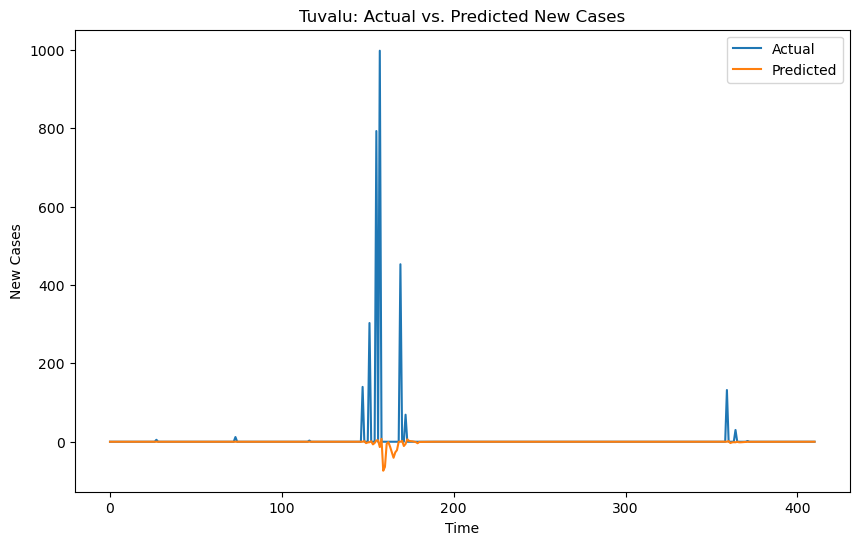

Epoch 1/50
22/22 - 0s - loss: 0.0016 - val_loss: 3.8706e-04 - 393ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0015 - val_loss: 3.6974e-04 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0015 - val_loss: 3.3989e-04 - 40ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0015 - val_loss: 3.2600e-04 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0015 - val_loss: 2.8403e-04 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0015 - val_loss: 2.6195e-04 - 45ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0015 - val_loss: 2.6933e-04 - 42ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0015 - val_loss: 2.5196e-04 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0015 - val_loss: 2.5781e-04 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0015 - val_loss: 2.5980e-04 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0015 - val_loss: 2.3973e-04 - 42ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0015 - val_loss: 2.3679e-04 - 41ms/epoc

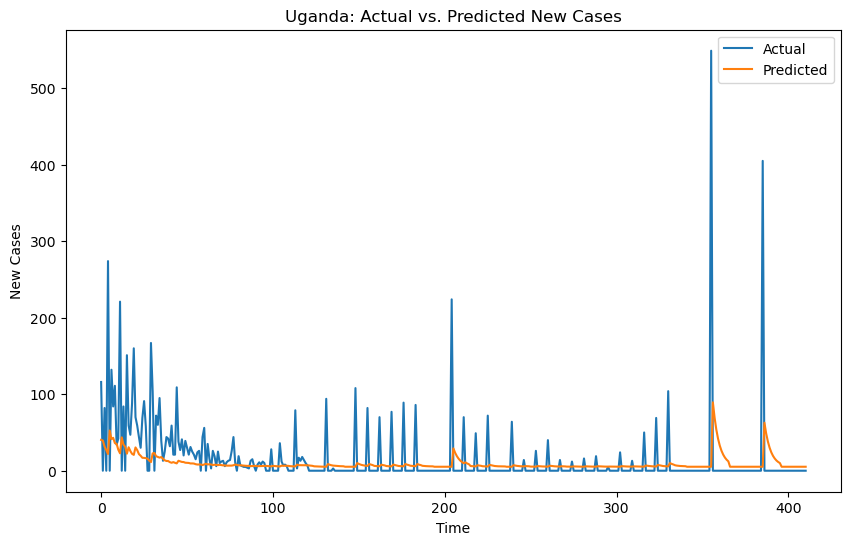

Epoch 1/50
22/22 - 0s - loss: 0.0162 - val_loss: 0.0546 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0156 - val_loss: 0.0543 - 40ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0155 - val_loss: 0.0536 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0150 - val_loss: 0.0512 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0145 - val_loss: 0.0481 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0137 - val_loss: 0.0457 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0124 - val_loss: 0.0411 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0107 - val_loss: 0.0393 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0094 - val_loss: 0.0388 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0085 - val_loss: 0.0625 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0087 - val_loss: 0.0345 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0081 - val_loss: 0.0435 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

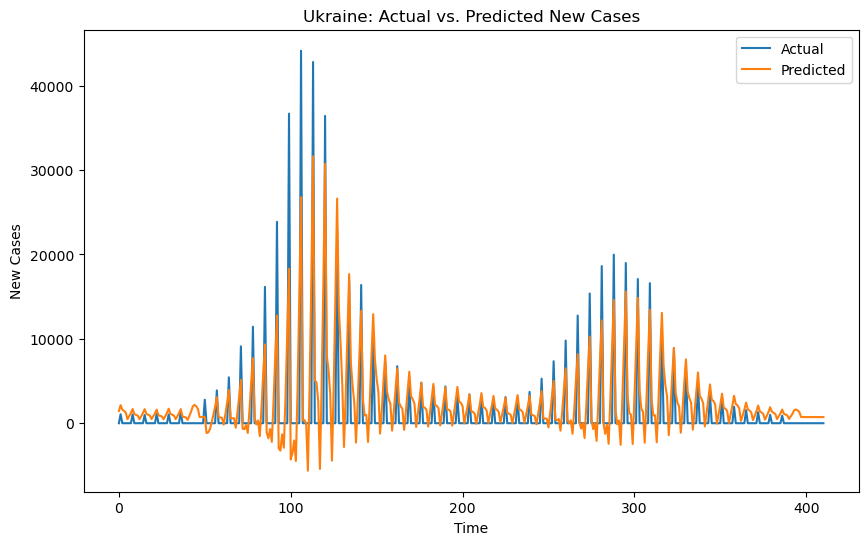

Epoch 1/50
22/22 - 0s - loss: 0.0475 - val_loss: 0.0097 - 390ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0060 - val_loss: 0.0068 - 40ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0057 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.0055 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0027 - val_loss: 0.0053 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.0052 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.0050 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0048 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0049 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0047 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0045 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0046 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

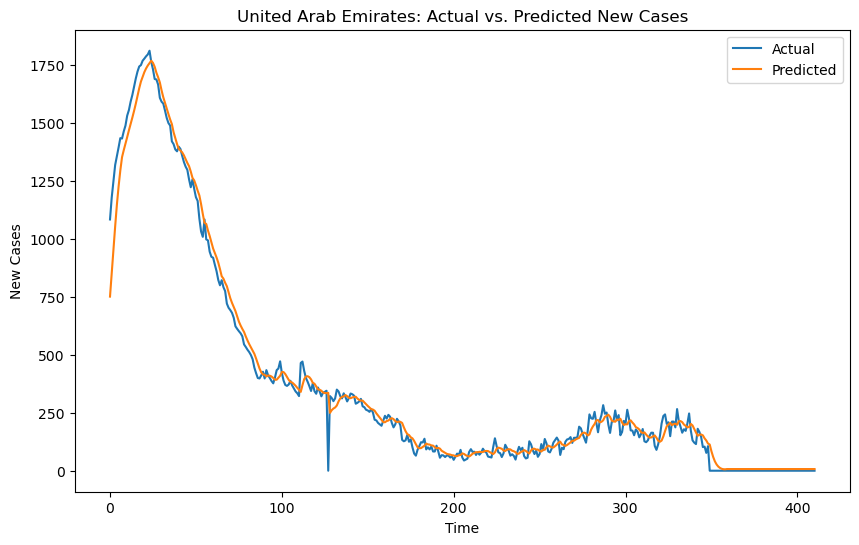

Epoch 1/50
22/22 - 0s - loss: 0.0014 - val_loss: 1.7575e-04 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0014 - val_loss: 1.8173e-04 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0014 - val_loss: 1.7463e-04 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0014 - val_loss: 1.7460e-04 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0014 - val_loss: 1.7503e-04 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0014 - val_loss: 1.7452e-04 - 40ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0014 - val_loss: 1.7510e-04 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0014 - val_loss: 1.7473e-04 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0015 - val_loss: 1.9468e-04 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0014 - val_loss: 1.7685e-04 - 46ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0014 - val_loss: 1.7617e-04 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0014 - val_loss: 1.7447e-04 - 40ms/epoc

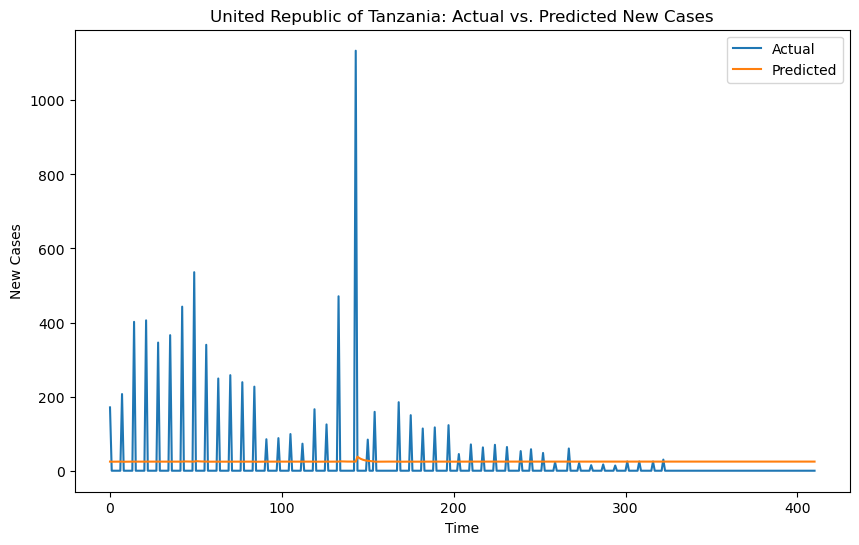

Epoch 1/50
22/22 - 0s - loss: 0.0356 - val_loss: 0.2185 - 386ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0058 - val_loss: 2.0879 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0046 - val_loss: 1.1791 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0046 - val_loss: 0.8646 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0043 - val_loss: 0.6587 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0043 - val_loss: 0.4939 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0042 - val_loss: 0.4045 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0044 - val_loss: 0.4009 - 42ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.4011 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0042 - val_loss: 0.3617 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0042 - val_loss: 0.3212 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.3156 - 39ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

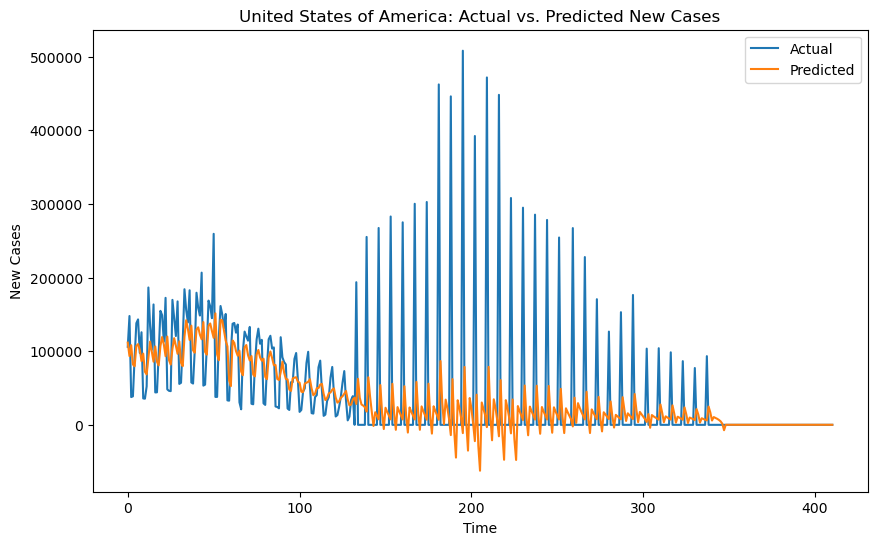

Epoch 1/50
22/22 - 0s - loss: 0.0172 - val_loss: 0.6112 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0116 - val_loss: 0.6131 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0108 - val_loss: 1.0200 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0102 - val_loss: 3.8277 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0101 - val_loss: 7.1195 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0100 - val_loss: 8.0986 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0101 - val_loss: 4.8034 - 39ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0102 - val_loss: 5.4001 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0103 - val_loss: 3.8797 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0103 - val_loss: 3.1593 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0104 - val_loss: 2.7251 - 40ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0098 - val_loss: 2.7473 - 40ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

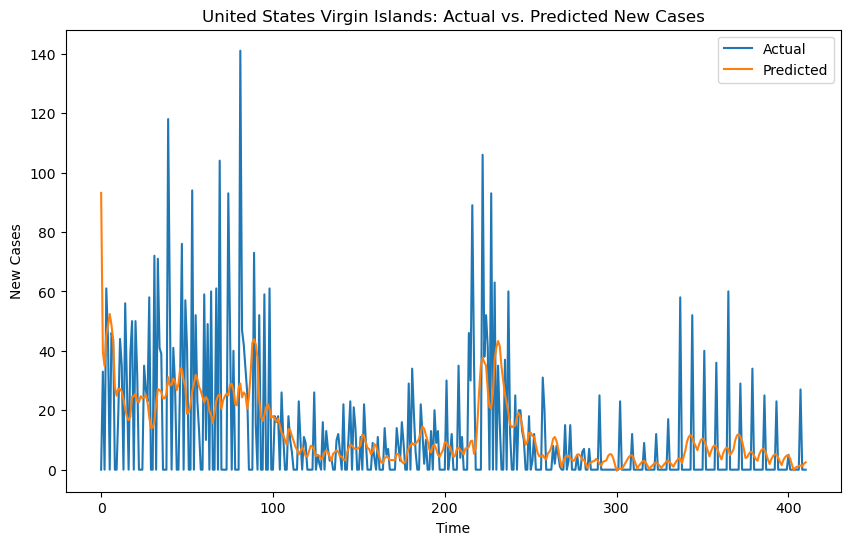

Epoch 1/50
22/22 - 0s - loss: 0.0172 - val_loss: 0.2060 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0090 - val_loss: 0.0710 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.7553 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0025 - val_loss: 0.2096 - 37ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.2837 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.2004 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0024 - val_loss: 0.1678 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.1561 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.1270 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0023 - val_loss: 0.1065 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.1040 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0022 - val_loss: 0.0993 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

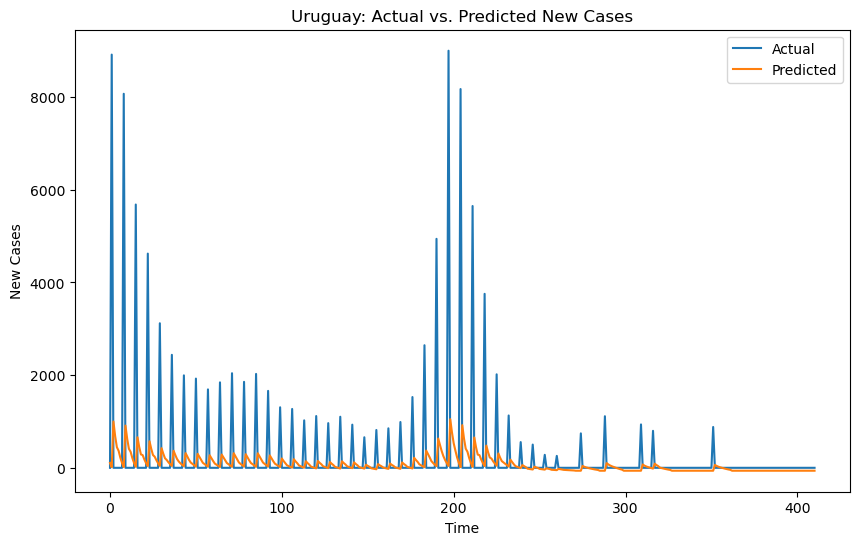

Epoch 1/50
22/22 - 3s - loss: 0.0146 - val_loss: 0.0337 - 3s/epoch - 114ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0143 - val_loss: 0.0333 - 40ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0141 - val_loss: 0.0328 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0137 - val_loss: 0.0318 - 38ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0132 - val_loss: 0.0306 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0128 - val_loss: 0.0294 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0122 - val_loss: 0.0285 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0117 - val_loss: 0.0269 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0110 - val_loss: 0.0259 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0097 - val_loss: 0.0251 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0082 - val_loss: 0.0254 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0073 - val_loss: 0.0346 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.0066

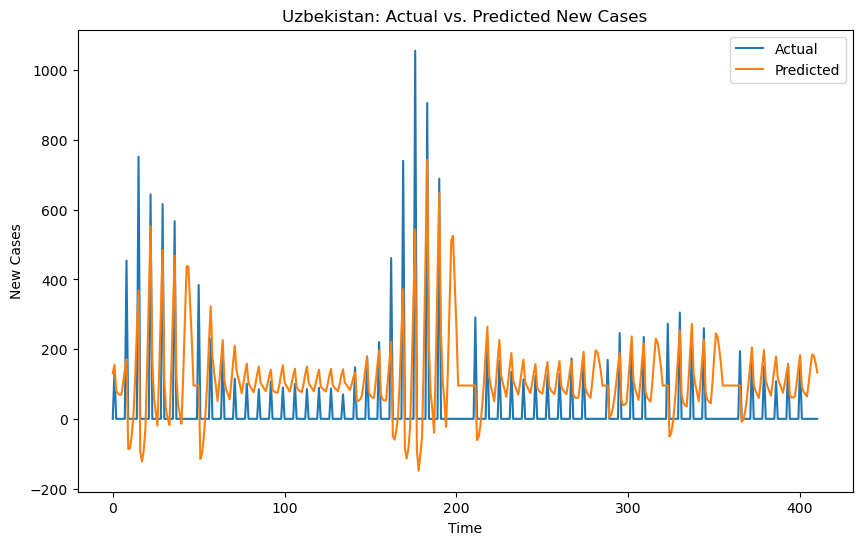

Epoch 1/50
22/22 - 0s - loss: 0.0033 - val_loss: 5355.6001 - 389ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0032 - val_loss: 5683.9683 - 40ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0032 - val_loss: 5631.7114 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0032 - val_loss: 5326.5845 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0032 - val_loss: 5659.5830 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0032 - val_loss: 5476.0044 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0032 - val_loss: 5412.9458 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0032 - val_loss: 5471.1094 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0032 - val_loss: 5375.4678 - 42ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0032 - val_loss: 5497.5576 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0032 - val_loss: 5429.1982 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0032 - val_loss: 5396.8350 - 41ms/epoch - 2ms/step

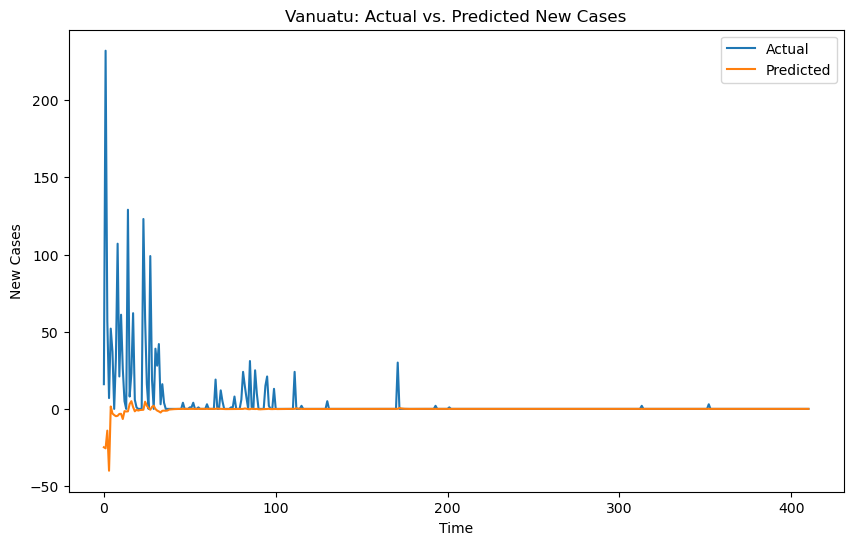

Epoch 1/50
22/22 - 0s - loss: 0.0831 - val_loss: 0.0430 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0116 - val_loss: 0.0207 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0066 - val_loss: 0.0214 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0059 - val_loss: 0.0197 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0058 - val_loss: 0.0199 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0057 - val_loss: 0.0195 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0057 - val_loss: 0.0191 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0055 - val_loss: 0.0195 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0055 - val_loss: 0.0191 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0056 - val_loss: 0.0198 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0055 - val_loss: 0.0188 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0055 - val_loss: 0.0184 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

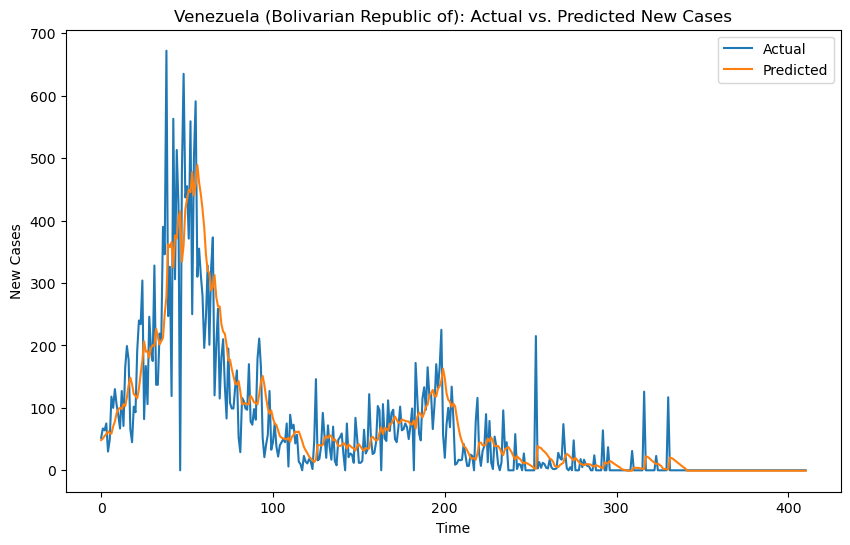

Epoch 1/50
22/22 - 0s - loss: 0.0075 - val_loss: 1.6981 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0029 - val_loss: 344.0773 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0012 - val_loss: 1136.6470 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0012 - val_loss: 439.7896 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0012 - val_loss: 346.4839 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0012 - val_loss: 192.9161 - 46ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0012 - val_loss: 154.7337 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0012 - val_loss: 115.9342 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0012 - val_loss: 72.5960 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0012 - val_loss: 75.6340 - 40ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0012 - val_loss: 25.9305 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0011 - val_loss: 23.2620 - 41ms/epoch - 2ms/step
Epoch 13/50
22/2

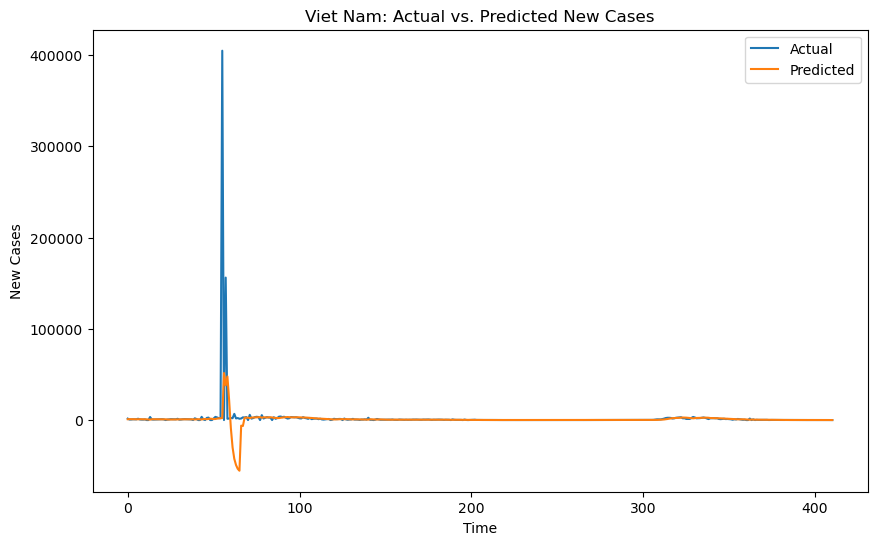

Epoch 1/50
22/22 - 0s - loss: 0.0050 - val_loss: 1.5018e-04 - 391ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0042 - val_loss: 9.8332e-06 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0036 - val_loss: 3.9530e-06 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0034 - val_loss: 2.5435e-05 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0033 - val_loss: 8.4490e-05 - 42ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0033 - val_loss: 4.8327e-05 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0034 - val_loss: 4.1321e-05 - 40ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0033 - val_loss: 5.2622e-06 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0033 - val_loss: 4.3630e-05 - 39ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0032 - val_loss: 3.1085e-06 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0032 - val_loss: 4.6997e-06 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0033 - val_loss: 1.4625e-05 - 41ms/epoc

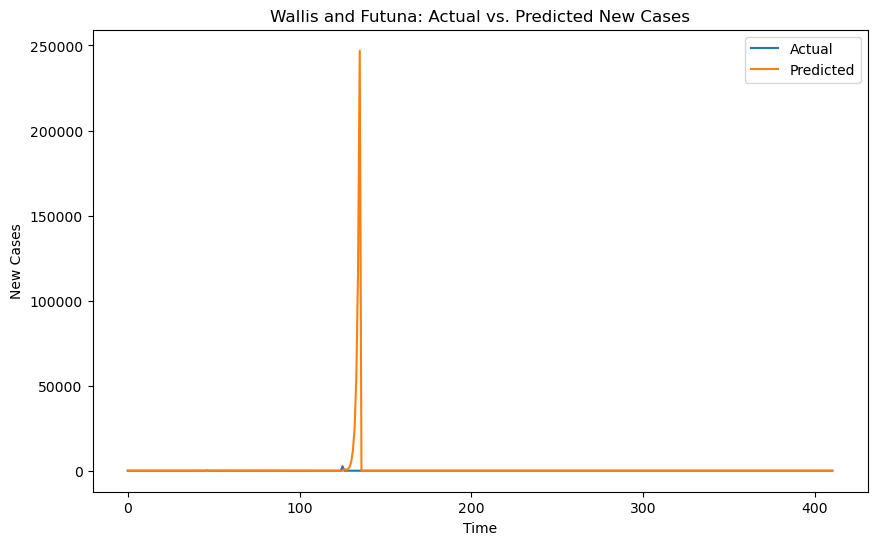

Epoch 1/50
22/22 - 0s - loss: 0.0138 - val_loss: 0.0299 - 388ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0073 - val_loss: 0.0274 - 38ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0044 - val_loss: 0.0276 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0042 - val_loss: 0.0272 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.0275 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.0270 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.0270 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.0269 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0271 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0270 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0268 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0038 - val_loss: 0.0268 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

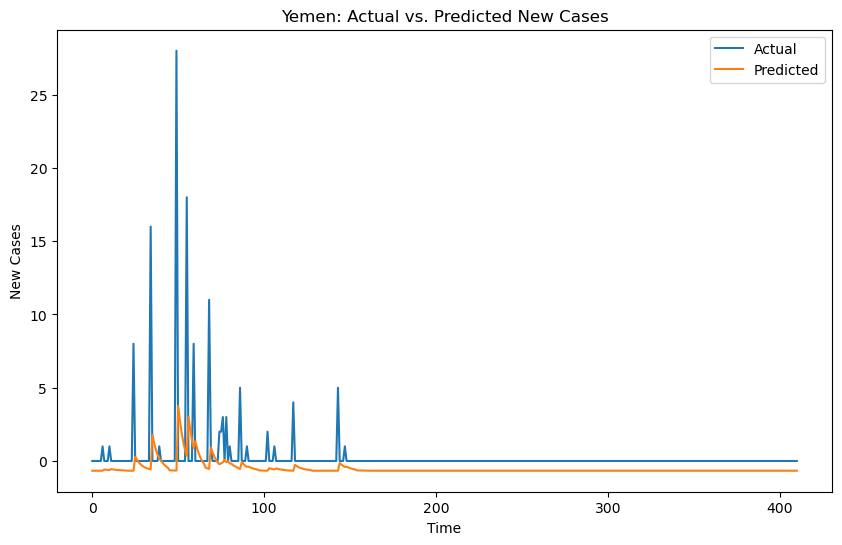

Epoch 1/50
22/22 - 0s - loss: 0.0253 - val_loss: 0.0767 - 385ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0098 - val_loss: 0.0386 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0048 - val_loss: 0.0435 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0047 - val_loss: 0.0417 - 39ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0049 - val_loss: 0.0389 - 40ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0045 - val_loss: 0.0361 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.0389 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.0354 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.0369 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0041 - val_loss: 0.0346 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0040 - val_loss: 0.0338 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0039 - val_loss: 0.0349 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

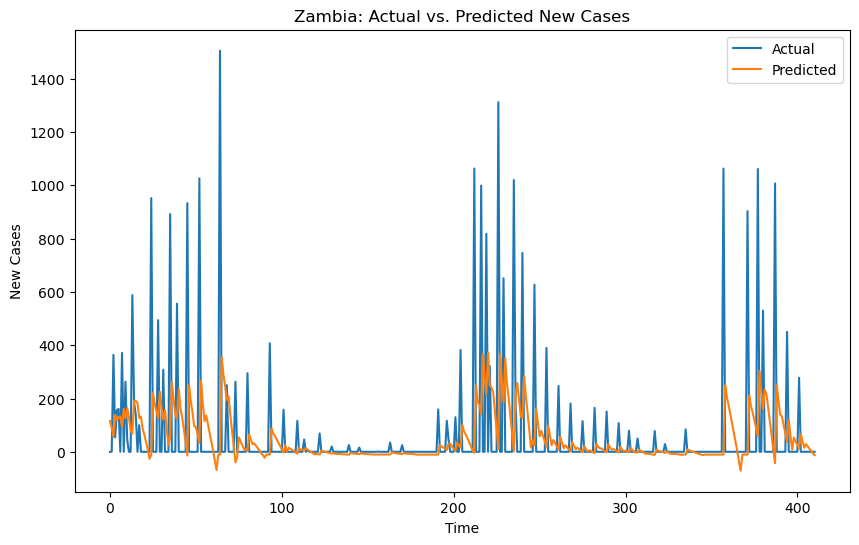

Epoch 1/50
22/22 - 0s - loss: 0.0114 - val_loss: 0.0130 - 387ms/epoch - 18ms/step
Epoch 2/50
22/22 - 0s - loss: 0.0071 - val_loss: 0.0051 - 39ms/epoch - 2ms/step
Epoch 3/50
22/22 - 0s - loss: 0.0037 - val_loss: 0.0418 - 39ms/epoch - 2ms/step
Epoch 4/50
22/22 - 0s - loss: 0.0033 - val_loss: 0.0113 - 40ms/epoch - 2ms/step
Epoch 5/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.0140 - 41ms/epoch - 2ms/step
Epoch 6/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.0148 - 41ms/epoch - 2ms/step
Epoch 7/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.0137 - 41ms/epoch - 2ms/step
Epoch 8/50
22/22 - 0s - loss: 0.0032 - val_loss: 0.0150 - 41ms/epoch - 2ms/step
Epoch 9/50
22/22 - 0s - loss: 0.0033 - val_loss: 0.0126 - 41ms/epoch - 2ms/step
Epoch 10/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.0167 - 41ms/epoch - 2ms/step
Epoch 11/50
22/22 - 0s - loss: 0.0031 - val_loss: 0.0118 - 41ms/epoch - 2ms/step
Epoch 12/50
22/22 - 0s - loss: 0.0030 - val_loss: 0.0114 - 41ms/epoch - 2ms/step
Epoch 13/50
22/22 - 0s - loss: 0.00

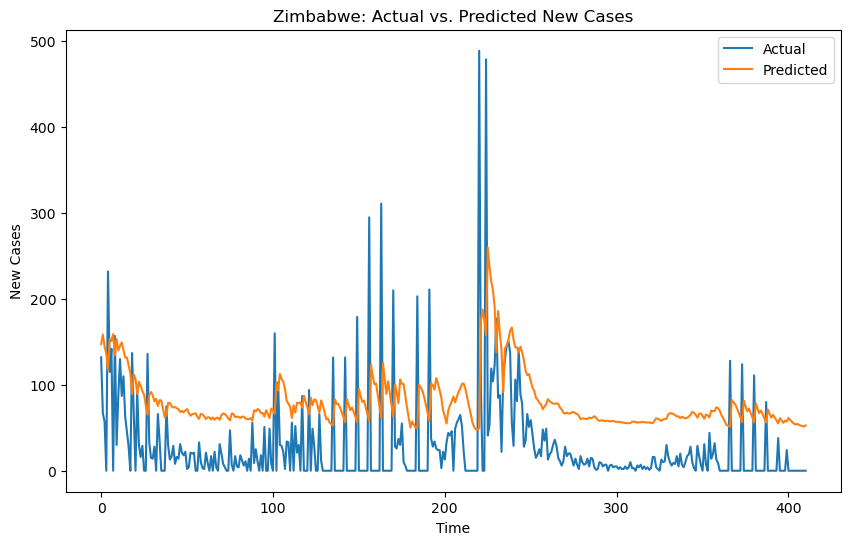

In [27]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming you have a DataFrame named 'covid_data' with columns like 'Month_Year', 'Country', and 'New_cases'

def train_and_predict_for_countries(countries, sequence_length=10, epochs=50, batch_size=32):
    results = []

    for country in countries:
        train_test_data = covid_data[(covid_data['Month_Year'] < '2022-06') & (covid_data['Country'] == country)]

        # Split the data into training and testing sets (80:20 ratio)
        train_data, test_data = train_test_split(train_test_data, test_size=0.2, shuffle=False)

        # Filter data for validation (greater than or equal to '2023-06')
        validation_data = covid_data[(covid_data['Month_Year'] >= '2022-06') & (covid_data['Country'] == country)]

        # Normalize the data
        scaler = MinMaxScaler()
        train_data_normalized = scaler.fit_transform(train_data[['New_cases']])
        test_data_normalized = scaler.transform(test_data[['New_cases']])
        validation_data_normalized = scaler.transform(validation_data[['New_cases']])

        # Create sequences for LSTM
        X_train, y_train = create_sequences(train_data_normalized, sequence_length)
        X_test, y_test = create_sequences(test_data_normalized, sequence_length)
        X_validation, y_validation = create_sequences(validation_data_normalized, sequence_length)

        # Build the LSTM model
        model = Sequential()
        model.add(LSTM(50, activation='relu', input_shape=(sequence_length, 1)))
        model.add(Dense(1))
        model.compile(optimizer='adam', loss='mean_squared_error')

        # Train the model
        model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, validation_data=(X_test, y_test), verbose=2)

        # Evaluate the model on the validation data
        validation_loss = model.evaluate(X_validation, y_validation, verbose=2)
        print(f'Validation Loss for {country}: {validation_loss}')

        # Make predictions using the trained model on the validation data
        validation_predictions = model.predict(X_validation)

        # Inverse transform the predictions and the original data
        validation_predictions = scaler.inverse_transform(validation_predictions)
        y_validation_actual = scaler.inverse_transform(y_validation.reshape(-1, 1))

        # Calculate and print the mean absolute error (MAE) or any other metric you're interested in
        mae = mean_absolute_error(y_validation_actual, validation_predictions)
        mse = mean_squared_error(y_validation_actual, validation_predictions)
        rmse = mean_squared_error(y_validation_actual, validation_predictions, squared=False)
        r_squared = r2_score(y_validation_actual, validation_predictions)

        # Calculate the number of observations and predictors
        n_observations = len(y_validation_actual)
        n_predictors = X_validation.shape[1]
        adjusted_r_squared = 1 - (1 - r_squared) * (n_observations - 1) / (n_observations - n_predictors - 1)

        print(f'Mean Squared Error on Validation Data for {country}: {mse}')
        print(f'Root Mean Squared Error on Validation Data for {country}: {rmse}')
        print(f'Mean Absolute Error on Validation Data for {country}: {mae}')
        print(f'R-squared on Validation Data for {country}: {r_squared}')
        print(f'Adjusted R-squared on Validation Data for {country}: {adjusted_r_squared}')

        # Save results in a DataFrame
        result_entry = {
            'Country': country,
            'Mean Squared Error': mse,
            'Root Mean Squared Error': rmse,
            'Mean Absolute Error': mae,
            'R-squared': r_squared,
            'Adjusted R-squared': adjusted_r_squared
        }
        results.append(result_entry)

        # Plot the predictions
        plt.figure(figsize=(10, 6))
        plt.plot(y_validation_actual, label='Actual')
        plt.plot(validation_predictions, label='Predicted')
        plt.title(f'{country}: Actual vs. Predicted New Cases')
        plt.xlabel('Time')
        plt.ylabel('New Cases')
        plt.legend()
        plt.show()

    # Create a DataFrame from the results
    results_df = pd.DataFrame(results)
    return results_df

# # List of countries to analyze
# column1_list = covid_data['Country'].tolist()
countries_to_analyze = covid_data['Country'].unique().tolist()

# Run the function
results_dataframe = train_and_predict_for_countries(countries_to_analyze)

# Save the results to a CSV file
#results_dataframe.to_csv('covid_prediction_results.csv', index=False)


In [28]:
results_dataframe

,Country,Mean Squared Error,Root Mean Squared Error,Mean Absolute Error,R-squared,Adjusted R-squared
0,Afghanistan,4.195195e+03,64.770327,44.595731,0.535612,0.524002
1,Albania,2.063849e+04,143.661028,58.026465,0.800020,0.795020
2,Algeria,9.813254e+01,9.906187,6.416465,0.877816,0.874761
3,American Samoa,1.643185e+03,40.536213,5.328383,-0.011777,-0.037071
4,Andorra,3.315040e+03,57.576383,27.287346,-0.147429,-0.176115
...,...,...,...,...,...,...
232,Viet Nam,4.723530e+08,21733.684325,2538.264490,-0.037745,-0.063689
233,Wallis and Futuna,1.903913e+08,13798.234970,1136.789339,-11077.255712,-11354.212105
234,Yemen,4.861251e+00,2.204824,0.929038,-0.189136,-0.218864
235,Zambia,5.232267e+04,228.741498,107.303626,-0.172187,-0.201492


In [25]:
countries_to_analyze = covid_data['Country'].unique().tolist()

In [29]:
results_dataframe[results_dataframe['R-squared']>0.9]

,Country,Mean Squared Error,Root Mean Squared Error,Mean Absolute Error,R-squared,Adjusted R-squared
15,Bahrain,1.300832e+04,114.054030,57.781789,0.936180,0.934584
54,Democratic People's Republic of Korea,0.000000e+00,0.000000,0.000000,1.000000,1.000000
102,Israel,7.086975e+05,841.841738,497.328830,0.900196,0.897701
108,Kazakhstan,2.595230e+04,161.097163,91.692259,0.921813,0.919858
175,Russian Federation,8.383033e+06,2895.346703,1808.034525,0.954104,0.952957
188,Saudi Arabia,4.237772e+03,65.098172,44.453364,0.920468,0.918480
190,Serbia,1.183495e+05,344.019566,210.627268,0.950119,0.948872
211,The United Kingdom,1.765412e+06,1328.688015,949.420087,0.949807,0.948552
219,Turkmenistan,0.000000e+00,0.000000,0.000000,1.000000,1.000000
224,United Arab Emirates,2.817600e+03,53.081067,33.282269,0.987630,0.987320
